In [26]:
import pickle
import matplotlib.pyplot as plt
import numpy as np
from sklearn.neighbors import KNeighborsClassifier
import show_img as si
import pandas as pd 

data = pickle.load(open('data0.pickle', 'rb'))

In [27]:
x_train = data['x_train']
y_train = data['y_train']
x_valid = data['x_validation']
y_valid = data['x_validation']
x_test = data['x_test']
y_test = data['y_test']

In [28]:
x_valid.shape

(4410, 3, 32, 32)

In [29]:
# reshape the data to a vector
x_train = x_train.reshape(86989, 3072)
x_test = x_test.reshape(12630, 3072)
x_valid = x_valid.reshape(4410, 3072)

In [9]:
label_name = pd.read_csv('label_names.csv')
index = 0
meta = {}
for i in label_name['SignName']:
    meta[index] = i
    index += 1
    
# all class information
meta

{0: 'Speed limit (20km/h)',
 1: 'Speed limit (30km/h)',
 2: 'Speed limit (50km/h)',
 3: 'Speed limit (60km/h)',
 4: 'Speed limit (70km/h)',
 5: 'Speed limit (80km/h)',
 6: 'End of speed limit (80km/h)',
 7: 'Speed limit (100km/h)',
 8: 'Speed limit (120km/h)',
 9: 'No passing',
 10: 'No passing for vehicles over 3.5 metric tons',
 11: 'Right-of-way at the next intersection',
 12: 'Priority road',
 13: 'Yield',
 14: 'Stop',
 15: 'No vehicles',
 16: 'Vehicles over 3.5 metric tons prohibited',
 17: 'No entry',
 18: 'General caution',
 19: 'Dangerous curve to the left',
 20: 'Dangerous curve to the right',
 21: 'Double curve',
 22: 'Bumpy road',
 23: 'Slippery road',
 24: 'Road narrows on the right',
 25: 'Road work',
 26: 'Traffic signals',
 27: 'Pedestrians',
 28: 'Children crossing',
 29: 'Bicycles crossing',
 30: 'Beware of ice/snow',
 31: 'Wild animals crossing',
 32: 'End of all speed and passing limits',
 33: 'Turn right ahead',
 34: 'Turn left ahead',
 35: 'Ahead only',
 36: 'Go st

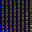

Road work::Speed limit (80km/h)


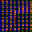

Right-of-way at the next intersection::Beware of ice/snow


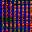

Keep right::Roundabout mandatory


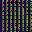

Speed limit (120km/h)::Speed limit (80km/h)


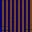

Keep right::Speed limit (60km/h)


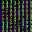

Priority road::End of all speed and passing limits


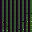

Road work::Dangerous curve to the right


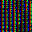

Right-of-way at the next intersection::Children crossing


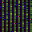

Stop::Speed limit (80km/h)


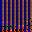

Speed limit (100km/h)::Speed limit (120km/h)


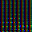

Speed limit (100km/h)::Speed limit (120km/h)


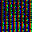

Yield::Speed limit (50km/h)


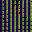

Road work::Road narrows on the right


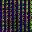

Keep right::Bicycles crossing


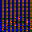

Speed limit (30km/h)::Speed limit (80km/h)


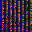

Priority road::General caution


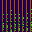

Speed limit (120km/h)::Speed limit (30km/h)


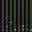

Speed limit (100km/h)::Speed limit (80km/h)


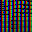

General caution::End of all speed and passing limits


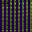

End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


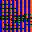

No entry::Speed limit (70km/h)


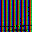

End of all speed and passing limits::End of speed limit (80km/h)


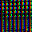

Speed limit (100km/h)::Wild animals crossing


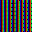

Wild animals crossing::Speed limit (80km/h)


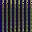

Speed limit (80km/h)::Speed limit (30km/h)


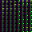

Pedestrians::Right-of-way at the next intersection


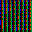

Double curve::Dangerous curve to the left


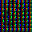

Speed limit (70km/h)::Speed limit (20km/h)


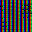

Speed limit (70km/h)::Speed limit (60km/h)


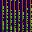

Speed limit (120km/h)::Speed limit (100km/h)


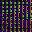

Ahead only::Yield


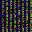

Speed limit (120km/h)::End of all speed and passing limits


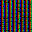

Children crossing::No vehicles


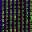

Right-of-way at the next intersection::General caution


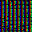

Speed limit (50km/h)::Dangerous curve to the right


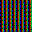

Priority road::Wild animals crossing


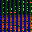

Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


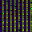

No passing::No vehicles


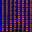

Road work::General caution


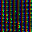

Speed limit (50km/h)::Speed limit (100km/h)


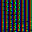

Speed limit (30km/h)::No passing


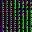

Dangerous curve to the right::Speed limit (120km/h)


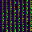

No vehicles::No passing


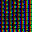

Speed limit (30km/h)::Speed limit (20km/h)


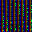

Speed limit (50km/h)::Speed limit (70km/h)


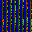

Double curve::Road work


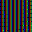

Right-of-way at the next intersection::Slippery road


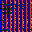

Wild animals crossing::Bicycles crossing


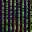

Speed limit (50km/h)::Speed limit (80km/h)


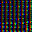

Road work::Bicycles crossing


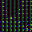

Turn right ahead::Keep right


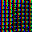

Traffic signals::Wild animals crossing


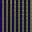

Speed limit (80km/h)::Speed limit (60km/h)


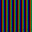

Speed limit (60km/h)::Ahead only


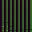

Speed limit (80km/h)::Speed limit (50km/h)


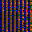

Right-of-way at the next intersection::Children crossing


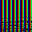

Speed limit (120km/h)::Speed limit (60km/h)


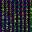

Speed limit (70km/h)::Roundabout mandatory


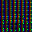

Stop::Bumpy road


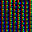

Road narrows on the right::Speed limit (50km/h)


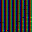

Traffic signals::General caution


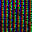

Speed limit (50km/h)::Speed limit (30km/h)


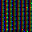

Right-of-way at the next intersection::General caution


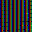

Right-of-way at the next intersection::Slippery road


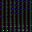

Speed limit (60km/h)::No vehicles


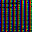

Yield::Priority road


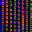

Right-of-way at the next intersection::Speed limit (80km/h)


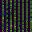

Ahead only::Turn left ahead


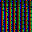

Keep right::Go straight or right


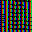

Wild animals crossing::General caution


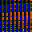

Speed limit (30km/h)::Speed limit (80km/h)


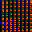

Speed limit (60km/h)::Keep right


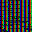

Speed limit (50km/h)::Speed limit (60km/h)


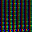

End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


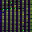

Speed limit (70km/h)::No passing


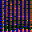

Road work::Speed limit (70km/h)


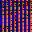

No passing for vehicles over 3.5 metric tons::Turn left ahead


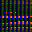

Speed limit (30km/h)::Bumpy road


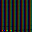

Speed limit (120km/h)::Speed limit (80km/h)


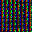

Speed limit (50km/h)::Speed limit (100km/h)


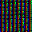

Priority road::Children crossing


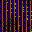

Slippery road::Road narrows on the right


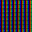

Speed limit (120km/h)::Speed limit (100km/h)


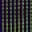

Ahead only::Keep right


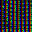

Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


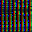

Speed limit (20km/h)::Speed limit (50km/h)


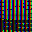

Yield::Wild animals crossing


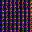

Speed limit (100km/h)::Speed limit (120km/h)


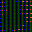

Priority road::Speed limit (70km/h)


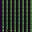

Speed limit (120km/h)::Speed limit (80km/h)


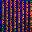

Priority road::Wild animals crossing


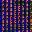

Speed limit (80km/h)::Speed limit (70km/h)


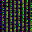

General caution::Traffic signals


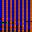

Speed limit (80km/h)::End of speed limit (80km/h)


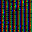

Turn left ahead::Ahead only


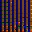

Speed limit (60km/h)::Speed limit (120km/h)


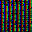

No passing::General caution


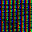

Speed limit (80km/h)::Speed limit (60km/h)


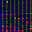

Go straight or right::Roundabout mandatory


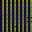

Speed limit (70km/h)::Speed limit (100km/h)


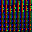

Speed limit (30km/h)::Yield


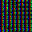

Keep right::Speed limit (50km/h)


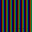

Dangerous curve to the right::Road work


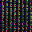

Dangerous curve to the left::Speed limit (70km/h)


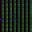

Beware of ice/snow::Speed limit (80km/h)


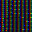

Right-of-way at the next intersection::General caution


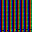

Turn right ahead::Ahead only


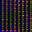

Speed limit (70km/h)::Speed limit (100km/h)


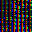

Keep right::Speed limit (70km/h)


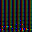

Speed limit (100km/h)::Speed limit (120km/h)


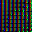

Pedestrians::Bumpy road


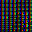

Right-of-way at the next intersection::General caution


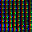

Speed limit (120km/h)::Speed limit (70km/h)


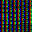

Right-of-way at the next intersection::Beware of ice/snow


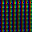

Speed limit (120km/h)::Speed limit (100km/h)


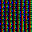

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


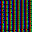

No vehicles::Speed limit (100km/h)


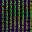

Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


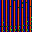

End of speed limit (80km/h)::Speed limit (80km/h)


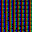

Road work::Dangerous curve to the left


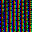

Speed limit (30km/h)::Speed limit (80km/h)


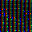

Bumpy road::Pedestrians


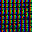

Keep right::Ahead only


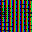

Wild animals crossing::General caution


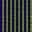

Speed limit (100km/h)::Speed limit (80km/h)


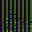

Speed limit (100km/h)::Speed limit (80km/h)


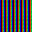

Turn right ahead::General caution


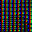

Right-of-way at the next intersection::General caution


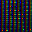

Speed limit (50km/h)::Speed limit (70km/h)


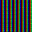

Wild animals crossing::Road work


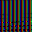

Keep right::Turn left ahead


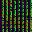

Speed limit (30km/h)::Speed limit (100km/h)


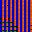

Wild animals crossing::General caution


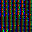

Speed limit (30km/h)::Speed limit (70km/h)


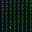

Speed limit (70km/h)::Go straight or right


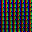

Speed limit (80km/h)::No vehicles


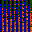

Speed limit (120km/h)::Speed limit (100km/h)


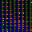

Speed limit (50km/h)::Speed limit (30km/h)


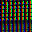

Speed limit (100km/h)::Speed limit (30km/h)


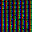

Road work::Right-of-way at the next intersection


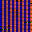

Speed limit (70km/h)::Dangerous curve to the left


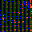

Keep right::No vehicles


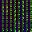

Stop::No passing for vehicles over 3.5 metric tons


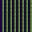

No passing for vehicles over 3.5 metric tons::Road work


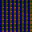

Keep right::Priority road


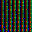

Roundabout mandatory::Speed limit (70km/h)


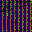

No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


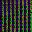

Double curve::Dangerous curve to the left


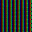

Speed limit (80km/h)::Speed limit (120km/h)


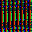

Speed limit (60km/h)::No passing


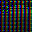

Traffic signals::Speed limit (50km/h)


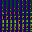

Speed limit (120km/h)::Speed limit (80km/h)


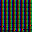

Speed limit (100km/h)::Speed limit (120km/h)


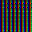

Speed limit (100km/h)::Speed limit (80km/h)


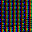

No passing::No vehicles


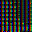

Slippery road::Priority road


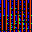

Priority road::General caution


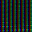

Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


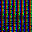

Stop::Speed limit (80km/h)


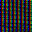

No passing::Speed limit (50km/h)


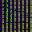

No passing for vehicles over 3.5 metric tons::Speed limit (20km/h)


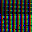

Speed limit (30km/h)::Speed limit (100km/h)


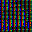

Speed limit (60km/h)::Speed limit (80km/h)


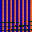

Speed limit (80km/h)::Speed limit (70km/h)


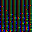

Speed limit (70km/h)::Speed limit (60km/h)


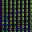

Speed limit (100km/h)::Speed limit (120km/h)


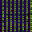

Road work::Speed limit (50km/h)


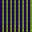

Speed limit (60km/h)::Wild animals crossing


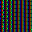

Right-of-way at the next intersection::General caution


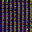

Right-of-way at the next intersection::Dangerous curve to the left


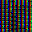

Road work::General caution


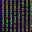

Speed limit (70km/h)::Right-of-way at the next intersection


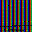

End of all speed and passing limits::End of speed limit (80km/h)


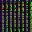

Go straight or right::Speed limit (50km/h)


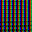

Keep right::Go straight or left


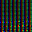

Speed limit (80km/h)::Speed limit (70km/h)


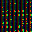

Speed limit (70km/h)::Go straight or right


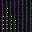

Priority road::Speed limit (50km/h)


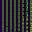

Road work::Dangerous curve to the left


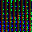

Speed limit (80km/h)::Speed limit (30km/h)


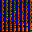

Speed limit (70km/h)::End of all speed and passing limits


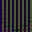

Turn right ahead::Speed limit (60km/h)


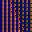

Speed limit (120km/h)::Speed limit (70km/h)


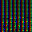

Speed limit (80km/h)::Speed limit (70km/h)


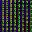

General caution::Speed limit (100km/h)


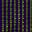

Road work::General caution


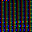

Speed limit (70km/h)::Speed limit (30km/h)


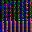

Slippery road::Speed limit (80km/h)


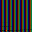

Keep right::Speed limit (60km/h)


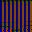

Keep right::Ahead only


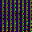

Priority road::Speed limit (60km/h)


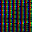

Slippery road::Children crossing


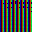

End of speed limit (80km/h)::Speed limit (60km/h)


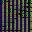

Speed limit (50km/h)::Speed limit (70km/h)


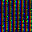

Slippery road::Bicycles crossing


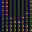

Turn right ahead::No passing for vehicles over 3.5 metric tons


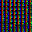

Keep right::Speed limit (80km/h)


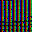

Speed limit (50km/h)::Speed limit (80km/h)


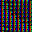

No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


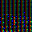

Bumpy road::Pedestrians


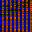

No passing::Speed limit (50km/h)


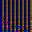

Speed limit (120km/h)::Speed limit (80km/h)


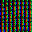

Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


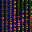

Right-of-way at the next intersection::Children crossing


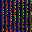

Speed limit (70km/h)::Speed limit (80km/h)


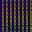

No passing::Speed limit (80km/h)


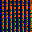

No vehicles::Speed limit (50km/h)


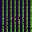

Keep left::Dangerous curve to the right


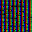

Speed limit (80km/h)::Speed limit (60km/h)


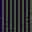

Dangerous curve to the right::Slippery road


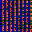

Priority road::Keep right


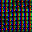

Speed limit (60km/h)::End of speed limit (80km/h)


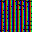

Road work::Road narrows on the right


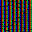

Children crossing::General caution


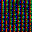

Dangerous curve to the left::Speed limit (70km/h)


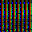

Speed limit (30km/h)::Speed limit (50km/h)


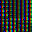

Slippery road::Road narrows on the right


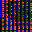

End of no passing by vehicles over 3.5 metric tons::Speed limit (20km/h)


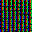

Speed limit (120km/h)::Speed limit (100km/h)


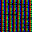

Road work::Speed limit (50km/h)


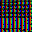

Speed limit (30km/h)::Speed limit (100km/h)


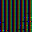

Road work::Dangerous curve to the right


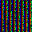

Speed limit (30km/h)::Speed limit (50km/h)


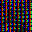

Traffic signals::Children crossing


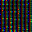

Bumpy road::Slippery road


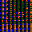

Yield::Speed limit (70km/h)


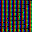

Speed limit (50km/h)::No vehicles


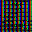

End of all speed and passing limits::End of no passing


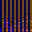

Speed limit (70km/h)::Speed limit (60km/h)


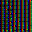

Speed limit (60km/h)::Speed limit (80km/h)


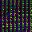

Keep right::End of no passing


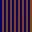

Speed limit (100km/h)::Speed limit (60km/h)


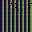

Yield::No vehicles


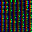

Vehicles over 3.5 metric tons prohibited::Yield


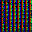

Keep right::Speed limit (80km/h)


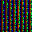

Speed limit (70km/h)::Speed limit (20km/h)


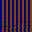

Keep right::Turn left ahead


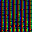

Speed limit (50km/h)::Speed limit (80km/h)


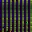

No passing for vehicles over 3.5 metric tons::No passing


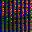

Turn left ahead::Keep right


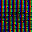

Speed limit (80km/h)::Speed limit (30km/h)


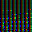

Speed limit (70km/h)::Speed limit (120km/h)


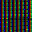

Right-of-way at the next intersection::General caution


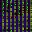

Speed limit (30km/h)::Speed limit (80km/h)


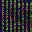

Speed limit (100km/h)::Speed limit (80km/h)


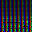

Keep right::Go straight or right


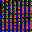

Speed limit (50km/h)::Speed limit (60km/h)


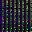

Keep right::No vehicles


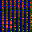

Speed limit (30km/h)::Speed limit (100km/h)


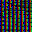

Beware of ice/snow::Traffic signals


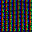

No vehicles::No passing


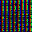

Speed limit (20km/h)::No vehicles


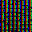

Speed limit (70km/h)::Speed limit (30km/h)


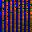

Wild animals crossing::Speed limit (70km/h)


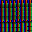

Beware of ice/snow::Speed limit (80km/h)


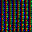

Keep right::Go straight or right


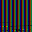

Speed limit (100km/h)::Speed limit (50km/h)


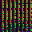

Bicycles crossing::Road work


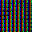

Go straight or left::Speed limit (60km/h)


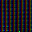

Dangerous curve to the left::Bicycles crossing


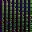

Slippery road::Beware of ice/snow


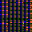

Slippery road::Children crossing


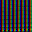

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


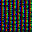

Dangerous curve to the left::Speed limit (70km/h)


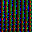

Keep right::Vehicles over 3.5 metric tons prohibited


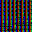

End of no passing by vehicles over 3.5 metric tons::End of no passing


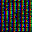

Dangerous curve to the left::Speed limit (70km/h)


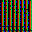

No vehicles::Speed limit (80km/h)


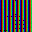

No passing::No vehicles


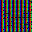

Speed limit (60km/h)::No passing


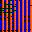

Speed limit (60km/h)::Speed limit (50km/h)


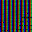

Beware of ice/snow::General caution


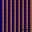

General caution::Dangerous curve to the right


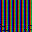

Wild animals crossing::General caution


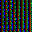

Ahead only::Priority road


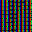

Roundabout mandatory::Go straight or right


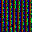

Ahead only::End of no passing


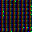

Priority road::No vehicles


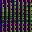

End of speed limit (80km/h)::Yield


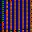

No vehicles::No passing


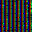

Bumpy road::Road work


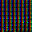

No passing for vehicles over 3.5 metric tons::No passing


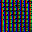

Speed limit (120km/h)::Double curve


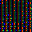

Road narrows on the right::Dangerous curve to the right


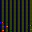

Road work::General caution


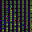

Speed limit (60km/h)::Speed limit (80km/h)


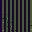

Beware of ice/snow::Dangerous curve to the left


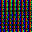

End of speed limit (80km/h)::Speed limit (60km/h)


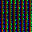

General caution::Pedestrians


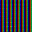

Priority road::Yield


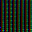

Beware of ice/snow::Speed limit (80km/h)


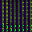

Stop::No passing for vehicles over 3.5 metric tons


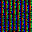

Speed limit (50km/h)::Speed limit (60km/h)


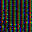

Ahead only::Speed limit (80km/h)


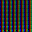

No passing for vehicles over 3.5 metric tons::No passing


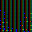

Slippery road::Dangerous curve to the right


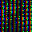

End of no passing by vehicles over 3.5 metric tons::End of no passing


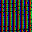

Speed limit (50km/h)::Speed limit (60km/h)


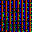

Speed limit (70km/h)::Speed limit (100km/h)


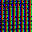

Priority road::No passing for vehicles over 3.5 metric tons


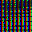

Keep right::Speed limit (50km/h)


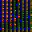

Yield::Dangerous curve to the right


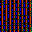

Speed limit (70km/h)::Speed limit (100km/h)


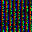

Pedestrians::Slippery road


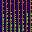

End of speed limit (80km/h)::Speed limit (80km/h)


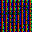

Speed limit (70km/h)::Beware of ice/snow


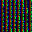

Speed limit (70km/h)::Speed limit (80km/h)


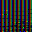

Speed limit (50km/h)::Speed limit (60km/h)


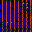

Speed limit (70km/h)::Speed limit (100km/h)


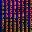

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


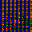

Speed limit (30km/h)::Keep right


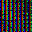

Keep right::Roundabout mandatory


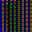

Road work::No entry


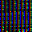

Speed limit (30km/h)::Speed limit (50km/h)


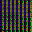

Double curve::Dangerous curve to the left


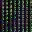

Stop::No passing for vehicles over 3.5 metric tons


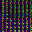

Right-of-way at the next intersection::General caution


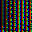

Children crossing::Speed limit (30km/h)


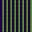

No passing for vehicles over 3.5 metric tons::Road work


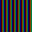

Keep right::Speed limit (60km/h)


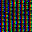

Ahead only::Yield


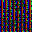

Speed limit (70km/h)::Speed limit (100km/h)


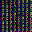

No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


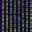

Road work::Speed limit (50km/h)


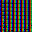

Traffic signals::Children crossing


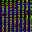

Speed limit (30km/h)::Speed limit (50km/h)


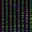

Speed limit (70km/h)::Speed limit (30km/h)


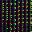

Priority road::Right-of-way at the next intersection


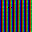

Speed limit (50km/h)::Go straight or right


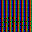

No entry::Road work


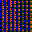

Speed limit (70km/h)::Wild animals crossing


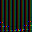

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


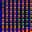

No entry::Priority road


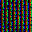

Speed limit (70km/h)::Speed limit (30km/h)


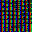

Speed limit (70km/h)::Speed limit (30km/h)


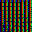

No vehicles::Speed limit (50km/h)


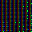

Dangerous curve to the left::Slippery road


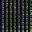

Speed limit (70km/h)::Speed limit (60km/h)


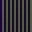

Speed limit (60km/h)::Speed limit (50km/h)


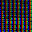

No passing::Speed limit (50km/h)


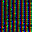

Stop::Speed limit (60km/h)


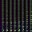

Speed limit (60km/h)::Speed limit (80km/h)


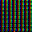

Speed limit (100km/h)::Speed limit (60km/h)


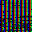

Speed limit (50km/h)::Speed limit (100km/h)


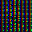

No entry::Stop


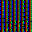

No passing::Speed limit (30km/h)


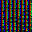

Priority road::Turn left ahead


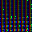

Speed limit (80km/h)::Speed limit (60km/h)


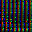

Keep right::End of no passing


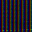

End of speed limit (80km/h)::End of all speed and passing limits


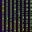

No vehicles::Speed limit (70km/h)


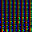

Speed limit (80km/h)::Speed limit (60km/h)


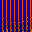

End of speed limit (80km/h)::Beware of ice/snow


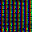

Speed limit (70km/h)::Speed limit (60km/h)


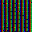

Slippery road::Double curve


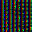

Road work::Roundabout mandatory


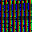

Go straight or left::Keep left


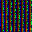

Speed limit (50km/h)::Speed limit (70km/h)


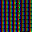

General caution::Bumpy road


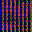

Double curve::Dangerous curve to the left


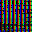

Yield::Wild animals crossing


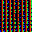

Priority road::Speed limit (70km/h)


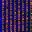

Double curve::Slippery road


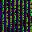

Road work::Road narrows on the right


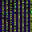

Double curve::Dangerous curve to the left


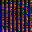

Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


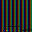

Speed limit (100km/h)::No vehicles


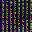

Speed limit (70km/h)::Wild animals crossing


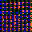

Bumpy road::Slippery road


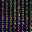

No passing::No passing for vehicles over 3.5 metric tons


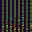

Speed limit (50km/h)::Vehicles over 3.5 metric tons prohibited


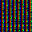

No passing::No vehicles


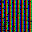

Road work::Road narrows on the right


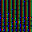

Speed limit (60km/h)::Speed limit (30km/h)


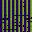

No entry::Speed limit (70km/h)


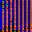

Speed limit (50km/h)::Speed limit (80km/h)


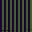

Speed limit (100km/h)::Speed limit (60km/h)


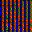

Road work::General caution


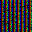

Speed limit (30km/h)::Speed limit (70km/h)


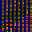

General caution::Road work


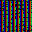

Road work::Slippery road


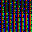

Speed limit (100km/h)::Speed limit (120km/h)


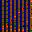

Speed limit (60km/h)::Speed limit (120km/h)


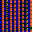

Keep right::Priority road


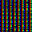

No passing::No vehicles


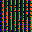

Speed limit (50km/h)::Speed limit (70km/h)


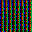

Double curve::Wild animals crossing


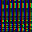

Speed limit (80km/h)::Speed limit (60km/h)


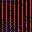

Slippery road::Road narrows on the right


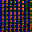

Keep right::Go straight or right


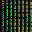

Stop::Speed limit (100km/h)


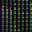

Speed limit (60km/h)::Speed limit (70km/h)


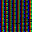

Children crossing::Bumpy road


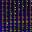

Speed limit (30km/h)::Speed limit (50km/h)


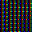

Turn left ahead::Speed limit (80km/h)


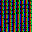

Dangerous curve to the right::Children crossing


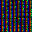

Turn right ahead::Roundabout mandatory


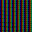

Priority road::Speed limit (30km/h)


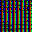

Priority road::No passing for vehicles over 3.5 metric tons


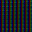

Speed limit (70km/h)::Go straight or right


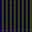

No passing for vehicles over 3.5 metric tons::End of speed limit (80km/h)


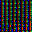

Ahead only::Speed limit (120km/h)


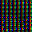

Slippery road::Speed limit (120km/h)


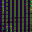

End of no passing by vehicles over 3.5 metric tons::Priority road


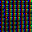

Road work::Children crossing


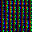

Right-of-way at the next intersection::Pedestrians


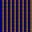

Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


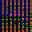

No vehicles::No passing for vehicles over 3.5 metric tons


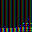

Wild animals crossing::General caution


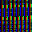

Speed limit (30km/h)::Speed limit (80km/h)


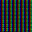

General caution::Slippery road


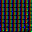

Right-of-way at the next intersection::Children crossing


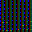

Slippery road::Wild animals crossing


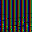

Stop::Speed limit (120km/h)


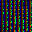

General caution::No vehicles


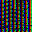

Speed limit (30km/h)::Speed limit (80km/h)


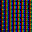

Speed limit (60km/h)::Speed limit (20km/h)


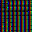

General caution::Wild animals crossing


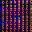

Turn right ahead::End of no passing


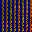

Keep left::Keep right


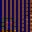

Road work::Wild animals crossing


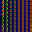

Right-of-way at the next intersection::General caution


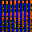

Speed limit (30km/h)::Speed limit (80km/h)


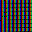

Speed limit (70km/h)::Speed limit (100km/h)


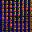

Stop::Bumpy road


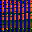

Speed limit (80km/h)::Speed limit (30km/h)


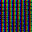

Speed limit (30km/h)::Speed limit (50km/h)


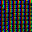

Roundabout mandatory::Turn right ahead


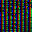

Dangerous curve to the left::General caution


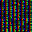

Speed limit (50km/h)::Speed limit (100km/h)


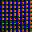

Keep right::Yield


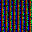

Slippery road::Right-of-way at the next intersection


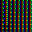

Right-of-way at the next intersection::General caution


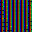

Children crossing::No passing for vehicles over 3.5 metric tons


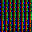

Keep right::Priority road


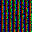

Speed limit (30km/h)::Speed limit (70km/h)


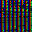

Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


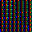

Ahead only::Keep right


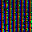

Slippery road::Bicycles crossing


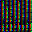

Road work::Speed limit (30km/h)


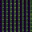

Keep right::Road work


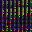

Speed limit (30km/h)::Yield


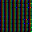

Speed limit (70km/h)::Speed limit (60km/h)


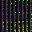

Speed limit (50km/h)::Speed limit (80km/h)


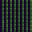

General caution::Slippery road


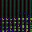

Speed limit (100km/h)::End of all speed and passing limits


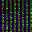

Speed limit (70km/h)::Speed limit (80km/h)


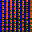

General caution::Speed limit (100km/h)


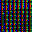

Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


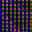

Speed limit (60km/h)::Speed limit (80km/h)


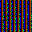

Priority road::No vehicles


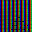

Beware of ice/snow::Bicycles crossing


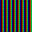

General caution::Dangerous curve to the right


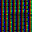

Right-of-way at the next intersection::General caution


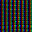

No passing::Wild animals crossing


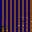

Road work::Slippery road


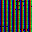

Speed limit (120km/h)::Speed limit (100km/h)


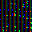

No passing::Priority road


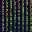

Speed limit (70km/h)::Speed limit (120km/h)


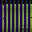

Wild animals crossing::Speed limit (120km/h)


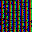

Road narrows on the right::Bicycles crossing


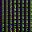

Road work::Roundabout mandatory


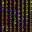

Priority road::No vehicles


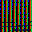

Speed limit (50km/h)::Speed limit (60km/h)


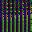

Slippery road::Speed limit (80km/h)


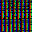

Yield::End of all speed and passing limits


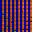

General caution::Traffic signals


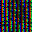

Roundabout mandatory::End of all speed and passing limits


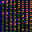

Right-of-way at the next intersection::General caution


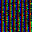

Double curve::Slippery road


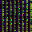

No vehicles::Speed limit (80km/h)


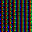

Priority road::Speed limit (80km/h)


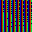

End of speed limit (80km/h)::Speed limit (80km/h)


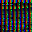

Speed limit (50km/h)::Speed limit (20km/h)


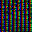

Dangerous curve to the left::Road work


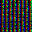

Speed limit (70km/h)::Speed limit (30km/h)


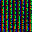

Speed limit (30km/h)::Speed limit (60km/h)


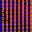

Keep right::Speed limit (100km/h)


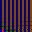

Turn right ahead::Speed limit (60km/h)


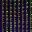

Speed limit (50km/h)::Vehicles over 3.5 metric tons prohibited


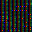

Road narrows on the right::Road work


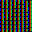

Go straight or right::Dangerous curve to the right


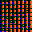

Wild animals crossing::General caution


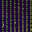

Dangerous curve to the right::Slippery road


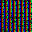

Keep right::Go straight or right


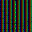

Priority road::Speed limit (50km/h)


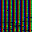

Speed limit (100km/h)::Speed limit (120km/h)


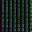

No passing::No passing for vehicles over 3.5 metric tons


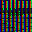

Speed limit (30km/h)::Speed limit (80km/h)


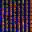

Keep right::Turn left ahead


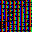

Speed limit (30km/h)::Speed limit (100km/h)


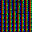

No passing::No vehicles


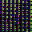

Keep right::Turn left ahead


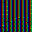

Turn right ahead::Speed limit (70km/h)


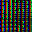

General caution::Bicycles crossing


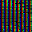

Speed limit (30km/h)::Speed limit (50km/h)


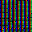

Speed limit (60km/h)::Speed limit (120km/h)


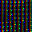

Road work::Speed limit (80km/h)


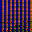

Speed limit (100km/h)::Speed limit (80km/h)


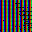

Beware of ice/snow::Children crossing


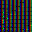

General caution::Speed limit (60km/h)


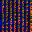

Ahead only::Beware of ice/snow


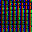

Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


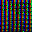

No entry::Speed limit (100km/h)


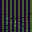

No passing::Speed limit (120km/h)


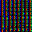

No vehicles::Speed limit (60km/h)


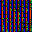

No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


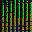

Speed limit (50km/h)::Speed limit (60km/h)


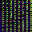

General caution::Right-of-way at the next intersection


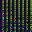

Speed limit (100km/h)::Speed limit (60km/h)


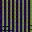

Wild animals crossing::General caution


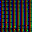

Speed limit (30km/h)::Speed limit (70km/h)


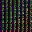

Ahead only::Speed limit (120km/h)


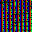

No passing for vehicles over 3.5 metric tons::No vehicles


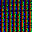

No vehicles::General caution


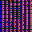

No passing for vehicles over 3.5 metric tons::Beware of ice/snow


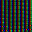

Priority road::End of speed limit (80km/h)


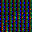

Speed limit (70km/h)::Speed limit (120km/h)


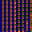

General caution::Yield


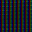

Speed limit (70km/h)::Go straight or right


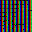

Priority road::Speed limit (50km/h)


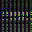

Speed limit (30km/h)::Bumpy road


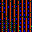

Slippery road::Road narrows on the right


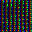

Keep right::End of no passing


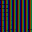

Dangerous curve to the right::Road work


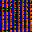

Road work::Dangerous curve to the left


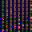

General caution::Road work


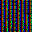

Bicycles crossing::General caution


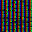

Speed limit (50km/h)::Speed limit (60km/h)


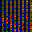

Priority road::Speed limit (80km/h)


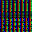

Speed limit (20km/h)::Speed limit (120km/h)


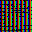

Speed limit (60km/h)::Speed limit (50km/h)


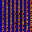

Priority road::Speed limit (80km/h)


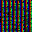

Speed limit (20km/h)::Keep right


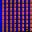

Speed limit (70km/h)::Speed limit (80km/h)


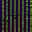

No vehicles::No passing


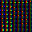

General caution::Keep right


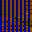

Speed limit (30km/h)::Speed limit (50km/h)


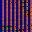

Speed limit (100km/h)::Speed limit (80km/h)


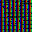

Beware of ice/snow::Speed limit (80km/h)


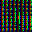

Speed limit (30km/h)::Speed limit (80km/h)


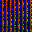

Ahead only::End of no passing


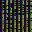

Speed limit (100km/h)::Speed limit (50km/h)


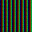

No passing for vehicles over 3.5 metric tons::Wild animals crossing


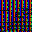

Speed limit (30km/h)::Speed limit (80km/h)


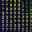

Speed limit (120km/h)::Speed limit (80km/h)


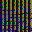

Speed limit (120km/h)::Speed limit (100km/h)


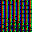

Speed limit (50km/h)::Speed limit (80km/h)


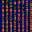

No passing::Speed limit (60km/h)


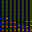

Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


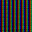

Keep right::Ahead only


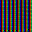

Vehicles over 3.5 metric tons prohibited::Speed limit (80km/h)


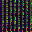

Yield::Go straight or right


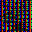

Traffic signals::Children crossing


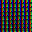

Speed limit (80km/h)::No vehicles


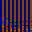

Speed limit (70km/h)::Speed limit (60km/h)


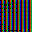

Speed limit (50km/h)::No vehicles


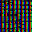

Yield::Bumpy road


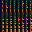

Speed limit (60km/h)::Yield


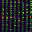

Speed limit (50km/h)::Speed limit (80km/h)


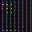

Priority road::No passing


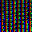

Children crossing::Road work


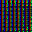

No vehicles::Wild animals crossing


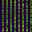

Speed limit (30km/h)::Speed limit (50km/h)


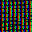

Speed limit (80km/h)::Speed limit (60km/h)


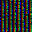

Speed limit (70km/h)::Speed limit (80km/h)


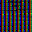

No passing::Speed limit (50km/h)


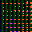

Wild animals crossing::General caution


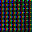

Speed limit (70km/h)::Children crossing


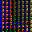

Speed limit (30km/h)::Speed limit (50km/h)


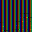

General caution::Slippery road


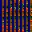

Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


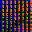

Keep right::Yield


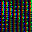

End of no passing by vehicles over 3.5 metric tons::End of no passing


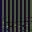

No passing::Speed limit (120km/h)


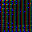

Speed limit (70km/h)::Speed limit (100km/h)


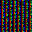

No passing::Speed limit (60km/h)


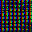

Slippery road::General caution


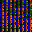

Ahead only::Speed limit (120km/h)


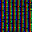

Stop::No passing


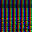

Speed limit (60km/h)::Speed limit (50km/h)


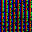

Ahead only::Speed limit (120km/h)


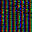

Turn left ahead::Ahead only


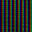

Priority road::Speed limit (50km/h)


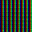

Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


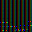

Speed limit (120km/h)::Speed limit (80km/h)


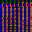

Speed limit (30km/h)::No vehicles


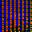

Road work::Double curve


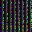

Speed limit (70km/h)::Speed limit (30km/h)


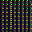

Right-of-way at the next intersection::General caution


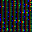

Keep right::No vehicles


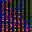

Speed limit (80km/h)::Speed limit (70km/h)


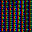

Keep right::Speed limit (80km/h)


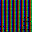

Beware of ice/snow::General caution


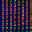

Speed limit (50km/h)::Right-of-way at the next intersection


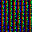

Speed limit (70km/h)::Speed limit (30km/h)


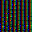

Ahead only::Turn left ahead


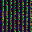

Speed limit (50km/h)::Speed limit (70km/h)


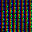

Stop::No vehicles


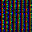

Traffic signals::End of all speed and passing limits


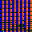

Keep right::Ahead only


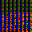

Keep right::Go straight or right


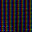

Dangerous curve to the left::Children crossing


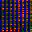

Speed limit (50km/h)::Speed limit (30km/h)


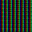

No passing for vehicles over 3.5 metric tons::Road work


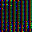

Ahead only::Go straight or left


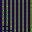

Children crossing::No passing for vehicles over 3.5 metric tons


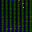

No passing::Priority road


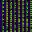

Keep right::End of no passing


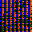

Speed limit (60km/h)::Speed limit (80km/h)


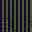

Road work::Wild animals crossing


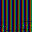

No entry::Speed limit (60km/h)


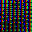

Keep right::Turn left ahead


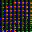

Wild animals crossing::Speed limit (120km/h)


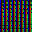

End of speed limit (80km/h)::Bumpy road


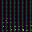

End of no passing::End of all speed and passing limits


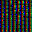

Turn left ahead::Ahead only


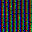

Roundabout mandatory::Speed limit (70km/h)


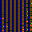

Right-of-way at the next intersection::Road work


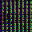

Speed limit (50km/h)::Double curve


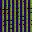

Priority road::Go straight or right


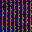

No passing for vehicles over 3.5 metric tons::Roundabout mandatory


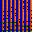

Speed limit (80km/h)::Speed limit (70km/h)


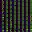

Ahead only::Turn left ahead


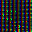

Speed limit (50km/h)::Speed limit (100km/h)


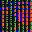

Right-of-way at the next intersection::Double curve


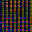

Roundabout mandatory::Speed limit (80km/h)


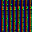

Speed limit (50km/h)::Speed limit (20km/h)


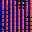

Road work::Road narrows on the right


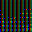

Speed limit (70km/h)::Speed limit (60km/h)


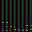

Speed limit (100km/h)::Speed limit (80km/h)


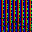

Speed limit (120km/h)::Speed limit (80km/h)


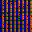

Beware of ice/snow::Speed limit (80km/h)


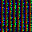

Speed limit (50km/h)::No passing


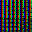

General caution::Speed limit (100km/h)


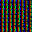

No vehicles::General caution


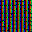

Road work::Road narrows on the right


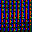

Priority road::Speed limit (70km/h)


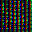

Yield::Speed limit (70km/h)


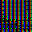

Yield::Wild animals crossing


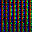

Keep right::Turn right ahead


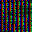

Speed limit (70km/h)::Speed limit (100km/h)


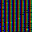

General caution::Right-of-way at the next intersection


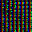

Speed limit (50km/h)::Speed limit (30km/h)


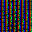

Bicycles crossing::General caution


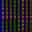

Wild animals crossing::Pedestrians


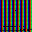

Speed limit (80km/h)::Speed limit (60km/h)


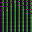

Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


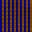

Bumpy road::General caution


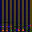

Speed limit (100km/h)::Speed limit (120km/h)


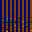

Speed limit (100km/h)::Speed limit (50km/h)


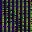

Speed limit (50km/h)::Speed limit (30km/h)


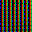

Keep right::Speed limit (100km/h)


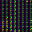

Bicycles crossing::Slippery road


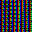

Priority road::Speed limit (80km/h)


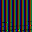

Speed limit (70km/h)::Speed limit (80km/h)


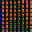

Stop::General caution


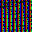

No passing for vehicles over 3.5 metric tons::Turn left ahead


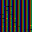

Children crossing::Traffic signals


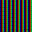

General caution::Dangerous curve to the right


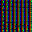

No vehicles::No passing


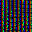

Bicycles crossing::General caution


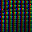

Dangerous curve to the left::General caution


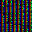

Yield::No vehicles


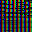

General caution::Bumpy road


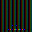

No passing for vehicles over 3.5 metric tons::Road work


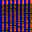

No vehicles::Speed limit (50km/h)


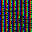

Speed limit (60km/h)::Speed limit (20km/h)


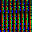

Speed limit (30km/h)::Speed limit (50km/h)


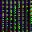

Vehicles over 3.5 metric tons prohibited::Speed limit (60km/h)


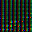

Speed limit (100km/h)::Speed limit (120km/h)


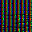

No entry::Bumpy road


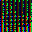

Speed limit (50km/h)::Dangerous curve to the left


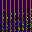

Speed limit (120km/h)::Speed limit (80km/h)


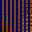

Road work::Dangerous curve to the left


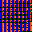

No entry::Speed limit (70km/h)


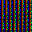

Speed limit (50km/h)::Speed limit (30km/h)


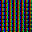

Go straight or left::General caution


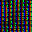

No entry::Speed limit (50km/h)


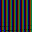

Turn right ahead::Speed limit (60km/h)


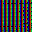

Speed limit (120km/h)::Speed limit (100km/h)


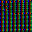

No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


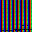

Turn right ahead::General caution


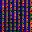

Speed limit (50km/h)::Speed limit (100km/h)


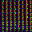

End of no passing by vehicles over 3.5 metric tons::End of no passing


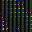

No passing for vehicles over 3.5 metric tons::Beware of ice/snow


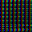

Speed limit (60km/h)::Speed limit (80km/h)


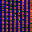

Ahead only::Go straight or left


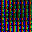

Right-of-way at the next intersection::Road narrows on the right


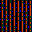

Slippery road::Road narrows on the right


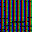

Speed limit (50km/h)::Speed limit (80km/h)


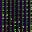

Speed limit (50km/h)::Speed limit (70km/h)


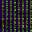

Keep left::Ahead only


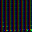

End of no passing::End of all speed and passing limits


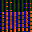

Yield::Speed limit (30km/h)


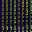

Speed limit (30km/h)::Speed limit (60km/h)


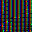

End of no passing by vehicles over 3.5 metric tons::Speed limit (50km/h)


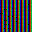

Priority road::Go straight or right


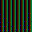

Priority road::Speed limit (50km/h)


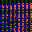

Speed limit (100km/h)::End of all speed and passing limits


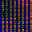

Speed limit (60km/h)::Speed limit (30km/h)


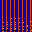

Speed limit (120km/h)::Speed limit (80km/h)


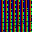

Speed limit (120km/h)::Speed limit (100km/h)


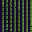

Slippery road::Road work


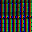

Beware of ice/snow::Speed limit (80km/h)


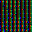

Roundabout mandatory::Speed limit (80km/h)


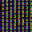

Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


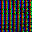

No entry::End of all speed and passing limits


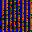

Speed limit (100km/h)::Speed limit (120km/h)


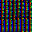

Go straight or left::Speed limit (70km/h)


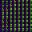

Speed limit (60km/h)::Speed limit (80km/h)


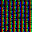

Speed limit (50km/h)::Speed limit (80km/h)


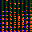

End of no passing::End of no passing by vehicles over 3.5 metric tons


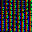

General caution::Bicycles crossing


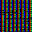

Road work::Speed limit (50km/h)


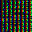

Stop::Speed limit (100km/h)


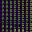

Speed limit (60km/h)::Yield


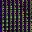

No passing for vehicles over 3.5 metric tons::Double curve


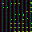

Wild animals crossing::General caution


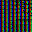

Keep right::Speed limit (50km/h)


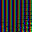

Road work::Speed limit (60km/h)


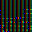

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


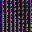

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


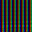

Yield::Keep right


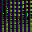

General caution::Keep right


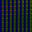

Speed limit (70km/h)::Go straight or right


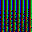

Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


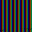

Dangerous curve to the right::Road work


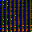

Speed limit (50km/h)::Speed limit (80km/h)


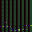

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


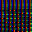

Ahead only::Yield


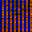

No passing::Speed limit (50km/h)


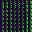

Priority road::Speed limit (80km/h)


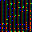

Speed limit (60km/h)::Speed limit (50km/h)


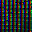

Dangerous curve to the left::General caution


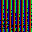

No passing::Speed limit (120km/h)


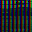

Speed limit (30km/h)::Priority road


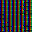

Right-of-way at the next intersection::Children crossing


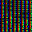

No vehicles::Speed limit (30km/h)


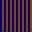

Dangerous curve to the right::Road work


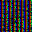

Bicycles crossing::General caution


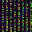

Pedestrians::Road narrows on the right


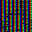

Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


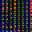

Keep right::Ahead only


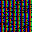

Road narrows on the right::Bicycles crossing


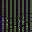

Stop::Speed limit (80km/h)


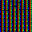

No passing::No vehicles


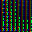

Speed limit (50km/h)::Speed limit (60km/h)


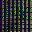

No entry::Speed limit (50km/h)


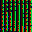

Speed limit (80km/h)::Speed limit (70km/h)


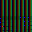

Speed limit (80km/h)::Speed limit (50km/h)


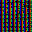

Right-of-way at the next intersection::Road work


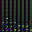

Speed limit (100km/h)::Speed limit (120km/h)


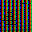

Keep right::Speed limit (100km/h)


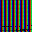

Speed limit (80km/h)::Speed limit (100km/h)


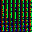

Speed limit (80km/h)::Speed limit (60km/h)


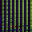

Speed limit (100km/h)::Speed limit (70km/h)


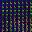

Speed limit (120km/h)::Speed limit (100km/h)


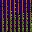

Keep right::Roundabout mandatory


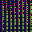

Speed limit (80km/h)::Speed limit (60km/h)


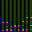

Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


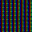

Keep right::Road work


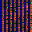

Stop::Turn right ahead


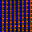

Speed limit (30km/h)::Speed limit (70km/h)


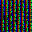

Road work::Road narrows on the right


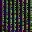

Priority road::Traffic signals


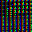

Speed limit (100km/h)::Wild animals crossing


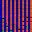

General caution::Traffic signals


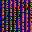

Road narrows on the right::Bicycles crossing


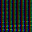

Speed limit (60km/h)::Speed limit (80km/h)


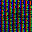

Speed limit (70km/h)::Speed limit (80km/h)


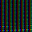

Speed limit (60km/h)::Road work


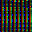

Speed limit (20km/h)::Speed limit (50km/h)


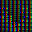

Speed limit (60km/h)::Speed limit (80km/h)


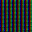

General caution::Slippery road


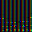

No passing::Speed limit (80km/h)


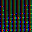

Speed limit (70km/h)::Speed limit (80km/h)


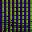

Keep right::Ahead only


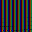

Keep right::Speed limit (60km/h)


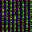

Speed limit (60km/h)::Speed limit (70km/h)


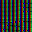

End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


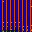

Speed limit (120km/h)::Speed limit (80km/h)


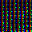

Priority road::End of all speed and passing limits


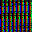

Speed limit (30km/h)::Speed limit (50km/h)


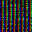

Ahead only::No vehicles


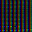

Speed limit (100km/h)::Speed limit (120km/h)


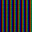

Speed limit (80km/h)::Speed limit (100km/h)


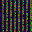

Speed limit (30km/h)::Speed limit (70km/h)


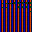

End of speed limit (80km/h)::Speed limit (80km/h)


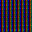

Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


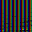

Dangerous curve to the right::General caution


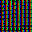

Speed limit (50km/h)::No passing


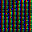

Wild animals crossing::Speed limit (80km/h)


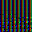

Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


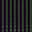

No passing for vehicles over 3.5 metric tons::End of speed limit (80km/h)


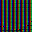

Speed limit (100km/h)::Speed limit (120km/h)


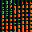

End of no passing::End of all speed and passing limits


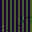

General caution::Slippery road


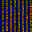

Road work::Speed limit (80km/h)


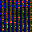

Speed limit (30km/h)::Speed limit (100km/h)


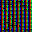

No entry::Speed limit (80km/h)


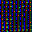

Speed limit (60km/h)::Speed limit (70km/h)


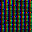

Wild animals crossing::Speed limit (80km/h)


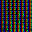

Speed limit (60km/h)::Keep right


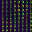

Turn right ahead::No vehicles


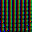

General caution::Wild animals crossing


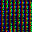

Stop::Dangerous curve to the left


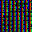

Beware of ice/snow::No passing for vehicles over 3.5 metric tons


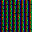

Road work::General caution


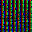

Stop::No passing


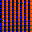

Keep right::Speed limit (100km/h)


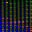

Speed limit (70km/h)::Speed limit (30km/h)


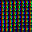

Speed limit (80km/h)::Speed limit (120km/h)


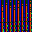

End of speed limit (80km/h)::Speed limit (80km/h)


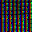

Priority road::Children crossing


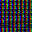

Keep right::Speed limit (50km/h)


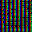

Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


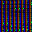

Speed limit (30km/h)::Speed limit (80km/h)


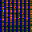

No passing::Speed limit (60km/h)


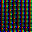

Speed limit (60km/h)::Speed limit (70km/h)


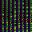

Speed limit (60km/h)::Speed limit (100km/h)


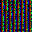

Speed limit (50km/h)::Speed limit (80km/h)


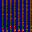

Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


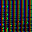

Speed limit (50km/h)::Speed limit (20km/h)


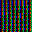

Double curve::Wild animals crossing


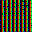

Go straight or right::Ahead only


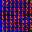

No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


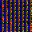

Priority road::Road work


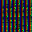

Speed limit (50km/h)::Speed limit (30km/h)


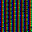

Children crossing::Bumpy road


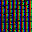

Yield::Speed limit (70km/h)


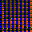

No passing::Speed limit (50km/h)


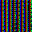

Road work::Road narrows on the right


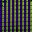

Keep right::Roundabout mandatory


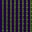

Speed limit (120km/h)::Speed limit (100km/h)


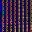

Keep left::Keep right


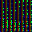

Speed limit (80km/h)::Speed limit (120km/h)


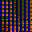

Slippery road::Road narrows on the right


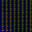

Dangerous curve to the left::Bicycles crossing


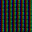

End of speed limit (80km/h)::Speed limit (80km/h)


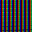

Speed limit (80km/h)::Speed limit (100km/h)


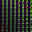

Speed limit (80km/h)::No vehicles


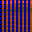

Speed limit (30km/h)::Speed limit (50km/h)


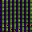

Speed limit (70km/h)::Speed limit (80km/h)


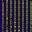

Double curve::Dangerous curve to the left


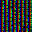

Beware of ice/snow::No passing for vehicles over 3.5 metric tons


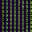

Speed limit (50km/h)::Speed limit (80km/h)


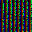

Speed limit (50km/h)::Speed limit (70km/h)


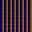

No passing for vehicles over 3.5 metric tons::Wild animals crossing


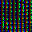

Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


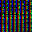

Go straight or right::Keep right


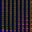

No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


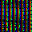

Speed limit (30km/h)::Speed limit (100km/h)


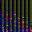

No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


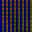

General caution::Slippery road


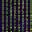

No vehicles::Speed limit (30km/h)


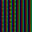

Priority road::Yield


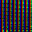

Yield::Keep right


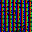

Road work::Slippery road


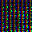

Priority road::Speed limit (70km/h)


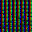

Speed limit (100km/h)::Speed limit (120km/h)


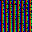

Priority road::Keep right


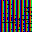

No entry::Priority road


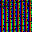

No passing for vehicles over 3.5 metric tons::Turn left ahead


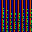

Speed limit (120km/h)::Speed limit (30km/h)


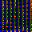

Speed limit (50km/h)::Speed limit (60km/h)


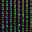

Speed limit (100km/h)::Speed limit (120km/h)


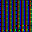

No passing::Speed limit (120km/h)


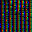

Turn left ahead::Turn right ahead


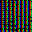

Dangerous curve to the right::Children crossing


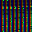

Speed limit (50km/h)::Speed limit (20km/h)


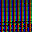

Keep right::Turn left ahead


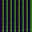

Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


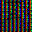

Priority road::Speed limit (60km/h)


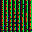

Speed limit (80km/h)::Speed limit (70km/h)


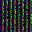

Speed limit (50km/h)::Speed limit (70km/h)


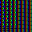

Right-of-way at the next intersection::General caution


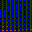

Speed limit (60km/h)::Speed limit (70km/h)


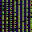

Traffic signals::Children crossing


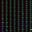

General caution::Bumpy road


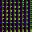

Speed limit (30km/h)::No passing


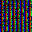

No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


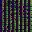

Priority road::End of speed limit (80km/h)


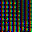

Slippery road::Road work


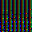

Speed limit (70km/h)::Speed limit (120km/h)


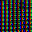

Speed limit (60km/h)::Speed limit (120km/h)


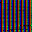

Turn right ahead::Ahead only


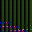

Speed limit (80km/h)::Speed limit (120km/h)


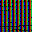

Speed limit (50km/h)::Speed limit (80km/h)


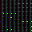

No passing::Speed limit (80km/h)


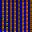

Road work::Speed limit (30km/h)


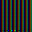

Speed limit (100km/h)::Speed limit (120km/h)


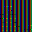

Children crossing::Bumpy road


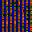

Stop::End of speed limit (80km/h)


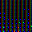

Speed limit (60km/h)::No vehicles


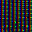

Speed limit (50km/h)::Speed limit (120km/h)


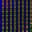

Keep right::Yield


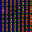

Priority road::General caution


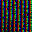

No passing::Speed limit (70km/h)


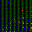

No passing::Priority road


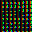

Wild animals crossing::General caution


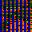

Traffic signals::Double curve


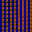

Road work::Dangerous curve to the left


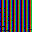

Wild animals crossing::General caution


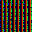

Bicycles crossing::Beware of ice/snow


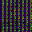

No entry::Stop


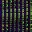

Speed limit (30km/h)::Speed limit (100km/h)


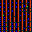

Slippery road::Road narrows on the right


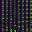

Speed limit (50km/h)::Speed limit (100km/h)


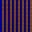

Speed limit (80km/h)::Speed limit (100km/h)


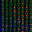

No passing::No passing for vehicles over 3.5 metric tons


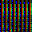

Speed limit (30km/h)::Speed limit (80km/h)


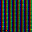

Priority road::Vehicles over 3.5 metric tons prohibited


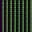

No passing for vehicles over 3.5 metric tons::Dangerous curve to the right


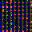

Road work::Bicycles crossing


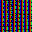

Beware of ice/snow::Wild animals crossing


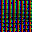

Speed limit (120km/h)::Speed limit (100km/h)


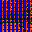

No entry::Priority road


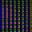

Keep right::Speed limit (50km/h)


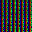

Keep left::Keep right


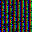

Speed limit (100km/h)::Speed limit (70km/h)


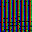

Speed limit (50km/h)::Speed limit (80km/h)


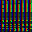

Speed limit (80km/h)::Speed limit (60km/h)


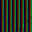

Priority road::Speed limit (50km/h)


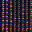

Keep right::Turn left ahead


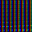

Speed limit (120km/h)::Speed limit (100km/h)


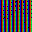

Speed limit (50km/h)::Go straight or right


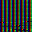

Speed limit (100km/h)::Speed limit (120km/h)


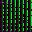

Priority road::End of all speed and passing limits


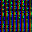

Speed limit (30km/h)::Speed limit (20km/h)


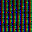

Ahead only::Speed limit (80km/h)


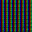

General caution::Slippery road


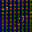

General caution::Speed limit (50km/h)


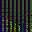

Speed limit (100km/h)::End of all speed and passing limits


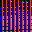

Speed limit (120km/h)::Speed limit (100km/h)


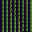

Speed limit (120km/h)::Speed limit (70km/h)


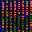

Speed limit (30km/h)::Speed limit (20km/h)


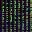

General caution::Right-of-way at the next intersection


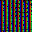

Speed limit (80km/h)::Speed limit (120km/h)


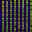

Go straight or right::End of all speed and passing limits


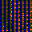

Road work::Dangerous curve to the left


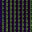

Right-of-way at the next intersection::Road narrows on the right


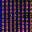

Ahead only::Keep right


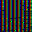

No vehicles::No passing


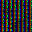

Speed limit (70km/h)::Speed limit (80km/h)


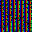

Speed limit (120km/h)::Speed limit (100km/h)


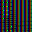

End of no passing by vehicles over 3.5 metric tons::End of no passing


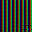

General caution::Dangerous curve to the right


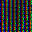

Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


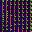

Road work::Speed limit (80km/h)


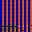

Speed limit (60km/h)::Speed limit (30km/h)


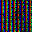

Keep right::Turn right ahead


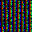

Beware of ice/snow::Traffic signals


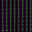

Dangerous curve to the left::Bicycles crossing


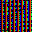

Priority road::General caution


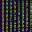

Road work::Bicycles crossing


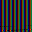

Keep right::Speed limit (60km/h)


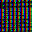

Road work::Children crossing


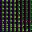

Turn left ahead::Roundabout mandatory


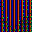

Priority road::Roundabout mandatory


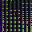

Keep right::Speed limit (70km/h)


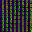

Speed limit (70km/h)::Right-of-way at the next intersection


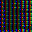

Priority road::Keep right


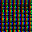

No vehicles::No passing for vehicles over 3.5 metric tons


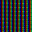

Slippery road::Yield


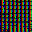

Speed limit (50km/h)::Speed limit (60km/h)


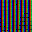

Beware of ice/snow::General caution


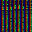

Speed limit (50km/h)::Speed limit (20km/h)


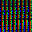

Speed limit (30km/h)::Speed limit (50km/h)


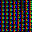

Traffic signals::Pedestrians


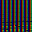

Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


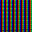

Speed limit (80km/h)::Speed limit (100km/h)


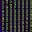

General caution::Speed limit (30km/h)


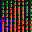

General caution::Wild animals crossing


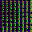

Dangerous curve to the right::Children crossing


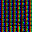

No passing::No vehicles


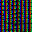

Keep right::Yield


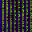

Bumpy road::Beware of ice/snow


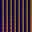

No passing for vehicles over 3.5 metric tons::Wild animals crossing


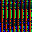

Speed limit (60km/h)::No passing


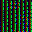

Dangerous curve to the right::Speed limit (120km/h)


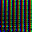

Speed limit (80km/h)::Speed limit (50km/h)


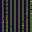

Right-of-way at the next intersection::Slippery road


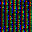

Beware of ice/snow::Keep right


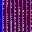

End of speed limit (80km/h)::Speed limit (80km/h)


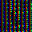

Keep right::Go straight or right


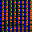

Stop::Bumpy road


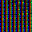

No passing::Speed limit (50km/h)


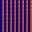

Speed limit (50km/h)::Go straight or right


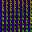

Priority road::Turn left ahead


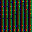

Turn left ahead::Ahead only


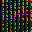

Keep right::Go straight or right


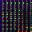

Ahead only::Yield


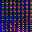

Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


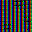

Speed limit (70km/h)::Speed limit (80km/h)


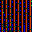

Slippery road::Road narrows on the right


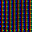

Speed limit (30km/h)::No vehicles


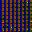

Right-of-way at the next intersection::Children crossing


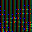

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


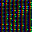

General caution::Traffic signals


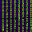

Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


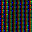

Right-of-way at the next intersection::Dangerous curve to the left


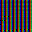

Speed limit (50km/h)::Speed limit (60km/h)


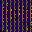

No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


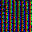

Ahead only::Keep right


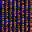

Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


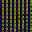

No vehicles::Speed limit (70km/h)


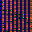

Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


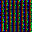

Speed limit (70km/h)::Speed limit (80km/h)


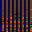

No passing::Speed limit (80km/h)


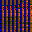

Right-of-way at the next intersection::No vehicles


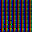

Go straight or right::No vehicles


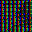

Keep right::Turn left ahead


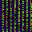

Road narrows on the right::Traffic signals


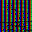

Speed limit (30km/h)::Speed limit (80km/h)


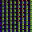

Children crossing::No vehicles


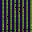

Speed limit (100km/h)::Speed limit (80km/h)


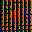

Speed limit (80km/h)::Speed limit (70km/h)


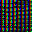

Vehicles over 3.5 metric tons prohibited::No passing for vehicles over 3.5 metric tons


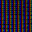

Dangerous curve to the right::Children crossing


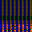

Speed limit (80km/h)::Speed limit (120km/h)


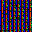

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


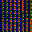

Keep right::No passing for vehicles over 3.5 metric tons


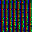

Speed limit (30km/h)::Speed limit (70km/h)


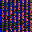

Road narrows on the right::Yield


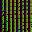

Go straight or right::Keep right


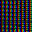

Speed limit (60km/h)::Yield


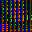

Speed limit (80km/h)::Speed limit (120km/h)


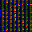

Road work::Keep right


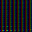

End of no passing::End of all speed and passing limits


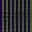

Speed limit (70km/h)::Speed limit (100km/h)


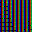

Children crossing::Wild animals crossing


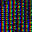

General caution::Traffic signals


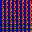

Speed limit (120km/h)::Speed limit (80km/h)


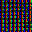

Road work::Slippery road


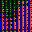

Speed limit (30km/h)::Speed limit (100km/h)


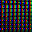

Speed limit (60km/h)::Beware of ice/snow


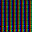

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


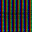

Speed limit (70km/h)::Speed limit (30km/h)


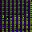

No passing::Speed limit (50km/h)


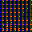

Speed limit (80km/h)::Speed limit (120km/h)


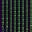

Priority road::Vehicles over 3.5 metric tons prohibited


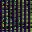

Road work::Traffic signals


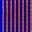

Speed limit (50km/h)::Go straight or right


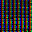

No passing::Speed limit (50km/h)


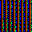

Priority road::Speed limit (30km/h)


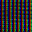

Ahead only::Keep right


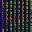

Speed limit (100km/h)::End of speed limit (80km/h)


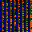

Pedestrians::Double curve


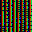

Priority road::Right-of-way at the next intersection


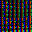

Right-of-way at the next intersection::Road narrows on the right


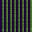

Speed limit (120km/h)::Traffic signals


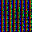

Priority road::Speed limit (60km/h)


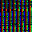

Go straight or left::Speed limit (20km/h)


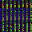

Go straight or left::Turn left ahead


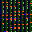

Keep right::Go straight or right


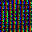

Bicycles crossing::Children crossing


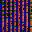

Speed limit (100km/h)::Speed limit (50km/h)


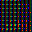

Speed limit (30km/h)::Speed limit (70km/h)


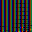

Road work::Speed limit (60km/h)


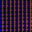

Traffic signals::Right-of-way at the next intersection


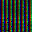

Road work::Traffic signals


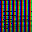

General caution::Speed limit (100km/h)


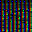

No vehicles::Speed limit (20km/h)


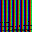

Speed limit (80km/h)::Speed limit (100km/h)


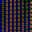

Road work::No entry


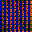

Speed limit (60km/h)::Speed limit (100km/h)


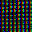

Keep right::Ahead only


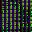

End of no passing by vehicles over 3.5 metric tons::End of no passing


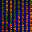

Right-of-way at the next intersection::Bumpy road


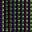

Turn left ahead::Roundabout mandatory


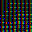

Wild animals crossing::Speed limit (80km/h)


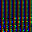

Speed limit (80km/h)::Speed limit (100km/h)


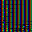

Stop::Speed limit (80km/h)


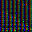

Road work::Speed limit (80km/h)


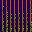

Keep right::Roundabout mandatory


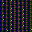

Speed limit (60km/h)::Yield


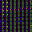

Right-of-way at the next intersection::Dangerous curve to the left


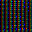

No passing::No vehicles


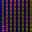

Bumpy road::Children crossing


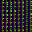

Speed limit (30km/h)::No passing


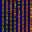

Dangerous curve to the right::Bumpy road


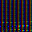

End of speed limit (80km/h)::End of all speed and passing limits


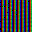

Speed limit (70km/h)::No vehicles


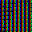

Go straight or left::Speed limit (30km/h)


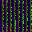

Speed limit (50km/h)::Speed limit (70km/h)


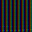

No passing for vehicles over 3.5 metric tons::Vehicles over 3.5 metric tons prohibited


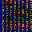

Pedestrians::Slippery road


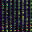

Speed limit (50km/h)::Keep right


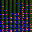

Speed limit (70km/h)::Speed limit (120km/h)


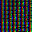

Speed limit (70km/h)::Speed limit (100km/h)


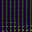

Speed limit (120km/h)::Speed limit (100km/h)


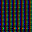

Keep right::Wild animals crossing


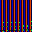

Speed limit (120km/h)::Speed limit (80km/h)


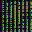

Right-of-way at the next intersection::Double curve


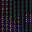

Keep right::Speed limit (30km/h)


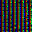

No vehicles::No passing


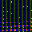

Speed limit (80km/h)::Speed limit (50km/h)


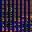

Speed limit (50km/h)::Speed limit (80km/h)


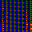

Road narrows on the right::Dangerous curve to the left


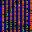

Speed limit (50km/h)::Speed limit (60km/h)


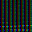

Speed limit (60km/h)::Road work


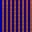

Speed limit (80km/h)::Speed limit (100km/h)


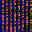

Road narrows on the right::Road work


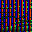

Wild animals crossing::Bicycles crossing


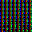

Ahead only::Speed limit (60km/h)


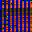

No vehicles::No passing


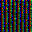

Road narrows on the right::Beware of ice/snow


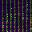

Go straight or right::Keep right


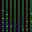

Slippery road::Beware of ice/snow


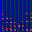

Speed limit (120km/h)::Speed limit (80km/h)


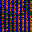

Speed limit (100km/h)::Speed limit (120km/h)


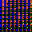

Turn right ahead::Keep right


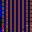

Right-of-way at the next intersection::Slippery road


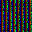

Ahead only::End of all speed and passing limits


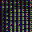

Traffic signals::Priority road


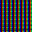

Speed limit (80km/h)::Speed limit (60km/h)


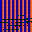

No entry::Speed limit (70km/h)


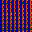

Speed limit (120km/h)::Speed limit (80km/h)


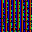

Slippery road::Road narrows on the right


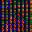

No passing::No vehicles


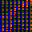

Right-of-way at the next intersection::Beware of ice/snow


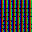

Priority road::Wild animals crossing


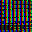

Yield::Wild animals crossing


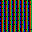

Speed limit (50km/h)::No vehicles


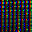

Turn right ahead::Keep right


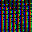

Speed limit (70km/h)::Speed limit (120km/h)


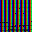

Speed limit (80km/h)::Speed limit (50km/h)


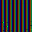

Beware of ice/snow::Bumpy road


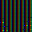

Road work::Slippery road


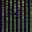

Turn left ahead::Turn right ahead


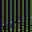

Stop::Speed limit (80km/h)


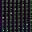

General caution::Right-of-way at the next intersection


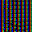

Road work::Dangerous curve to the left


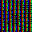

Right-of-way at the next intersection::Road narrows on the right


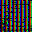

Speed limit (80km/h)::Speed limit (100km/h)


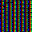

Road work::Right-of-way at the next intersection


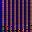

Speed limit (100km/h)::Speed limit (120km/h)


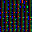

Keep right::No vehicles


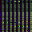

Speed limit (60km/h)::Speed limit (50km/h)


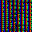

Ahead only::Turn left ahead


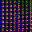

Traffic signals::Pedestrians


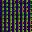

Right-of-way at the next intersection::Road narrows on the right


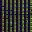

Road work::Speed limit (50km/h)


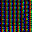

No passing::No vehicles


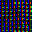

Speed limit (60km/h)::Speed limit (70km/h)


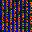

Road narrows on the right::Speed limit (80km/h)


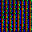

General caution::Traffic signals


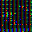

Yield::Speed limit (80km/h)


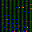

No passing::Speed limit (70km/h)


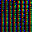

Turn left ahead::Keep right


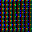

Speed limit (70km/h)::Speed limit (60km/h)


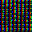

General caution::Road work


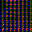

No passing::Vehicles over 3.5 metric tons prohibited


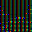

No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


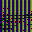

No entry::Speed limit (70km/h)


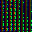

Speed limit (50km/h)::Speed limit (70km/h)


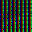

Keep left::Keep right


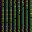

Turn left ahead::Ahead only


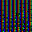

Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


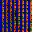

Keep right::Roundabout mandatory


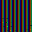

Beware of ice/snow::Road work


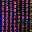

Keep right::Go straight or right


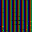

Dangerous curve to the right::Road work


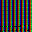

No passing for vehicles over 3.5 metric tons::No vehicles


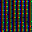

Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


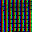

Speed limit (70km/h)::Speed limit (100km/h)


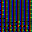

No passing::No passing for vehicles over 3.5 metric tons


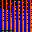

Speed limit (120km/h)::Speed limit (100km/h)


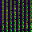

Speed limit (30km/h)::Wild animals crossing


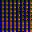

Slippery road::Dangerous curve to the left


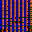

Speed limit (50km/h)::Speed limit (70km/h)


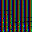

Speed limit (60km/h)::Speed limit (120km/h)


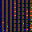

Right-of-way at the next intersection::Road work


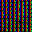

Speed limit (70km/h)::No vehicles


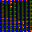

Speed limit (70km/h)::Speed limit (30km/h)


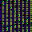

Speed limit (30km/h)::Speed limit (80km/h)


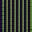

General caution::Dangerous curve to the right


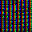

Ahead only::Yield


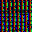

Speed limit (60km/h)::Speed limit (70km/h)


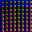

Turn left ahead::General caution


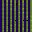

Priority road::Go straight or right


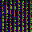

Beware of ice/snow::End of all speed and passing limits


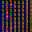

Road work::Pedestrians


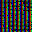

Beware of ice/snow::Speed limit (50km/h)


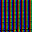

Speed limit (50km/h)::Speed limit (100km/h)


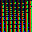

End of no passing::Speed limit (60km/h)


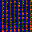

Turn right ahead::Ahead only


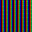

Speed limit (80km/h)::Speed limit (50km/h)


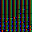

Speed limit (60km/h)::Vehicles over 3.5 metric tons prohibited


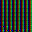

Speed limit (120km/h)::Speed limit (80km/h)


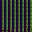

Speed limit (100km/h)::Speed limit (80km/h)


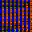

Speed limit (50km/h)::Speed limit (30km/h)


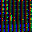

Yield::Speed limit (80km/h)


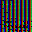

Speed limit (60km/h)::No passing


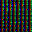

Ahead only::No passing for vehicles over 3.5 metric tons


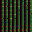

Turn left ahead::Ahead only


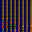

Speed limit (120km/h)::Speed limit (80km/h)


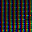

Speed limit (60km/h)::Speed limit (100km/h)


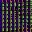

No passing for vehicles over 3.5 metric tons::Speed limit (60km/h)


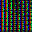

General caution::Slippery road


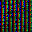

Speed limit (60km/h)::Speed limit (80km/h)


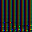

Speed limit (100km/h)::Speed limit (120km/h)


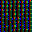

Roundabout mandatory::Priority road


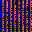

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


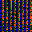

Speed limit (70km/h)::Speed limit (30km/h)


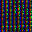

Turn right ahead::Ahead only


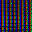

No passing::Turn left ahead


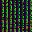

Speed limit (30km/h)::Speed limit (60km/h)


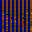

No passing::Speed limit (60km/h)


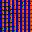

Right-of-way at the next intersection::Double curve


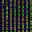

Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


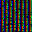

Speed limit (30km/h)::Speed limit (70km/h)


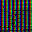

No passing::Speed limit (80km/h)


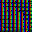

Speed limit (120km/h)::Speed limit (70km/h)


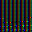

Speed limit (100km/h)::Speed limit (60km/h)


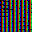

Beware of ice/snow::General caution


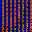

Speed limit (50km/h)::Speed limit (100km/h)


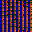

Speed limit (70km/h)::Speed limit (80km/h)


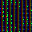

Traffic signals::Road narrows on the right


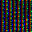

Right-of-way at the next intersection::Bumpy road


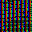

Speed limit (60km/h)::Speed limit (50km/h)


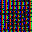

Speed limit (30km/h)::Speed limit (80km/h)


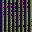

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


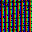

No passing for vehicles over 3.5 metric tons::Vehicles over 3.5 metric tons prohibited


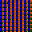

Go straight or left::Keep right


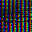

Speed limit (60km/h)::Speed limit (120km/h)


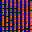

Speed limit (80km/h)::Speed limit (70km/h)


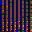

Roundabout mandatory::Speed limit (60km/h)


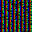

Speed limit (70km/h)::Speed limit (30km/h)


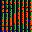

Speed limit (50km/h)::Speed limit (70km/h)


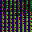

Speed limit (70km/h)::Speed limit (60km/h)


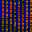

Vehicles over 3.5 metric tons prohibited::Speed limit (60km/h)


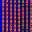

Traffic signals::Children crossing


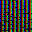

Speed limit (50km/h)::Speed limit (60km/h)


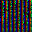

Yield::Ahead only


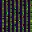

Traffic signals::Right-of-way at the next intersection


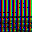

Keep right::Turn left ahead


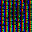

Right-of-way at the next intersection::Dangerous curve to the left


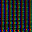

Keep right::Speed limit (50km/h)


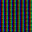

General caution::Slippery road


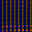

Speed limit (120km/h)::Speed limit (100km/h)


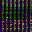

Ahead only::Beware of ice/snow


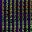

End of no passing by vehicles over 3.5 metric tons::End of speed limit (80km/h)


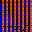

Speed limit (50km/h)::Speed limit (80km/h)


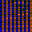

No passing::Speed limit (50km/h)


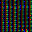

No vehicles::Ahead only


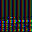

No passing::Speed limit (80km/h)


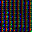

No passing::No vehicles


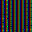

Right-of-way at the next intersection::Road work


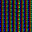

Road work::Bicycles crossing


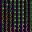

Ahead only::Keep right


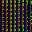

General caution::Keep right


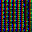

Speed limit (30km/h)::Speed limit (80km/h)


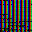

Speed limit (50km/h)::Speed limit (70km/h)


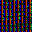

Speed limit (70km/h)::Speed limit (100km/h)


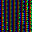

Road work::Bumpy road


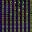

No passing::Speed limit (50km/h)


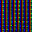

Speed limit (30km/h)::Speed limit (60km/h)


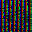

No passing::Speed limit (60km/h)


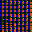

Stop::Speed limit (20km/h)


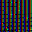

No vehicles::No passing


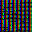

Road work::Children crossing


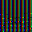

Speed limit (100km/h)::Speed limit (80km/h)


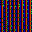

Priority road::Speed limit (80km/h)


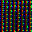

General caution::Ahead only


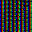

Road work::Bicycles crossing


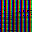

General caution::Speed limit (100km/h)


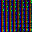

Speed limit (30km/h)::Speed limit (80km/h)


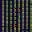

Speed limit (80km/h)::Speed limit (60km/h)


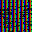

Road narrows on the right::Dangerous curve to the right


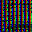

Road work::Dangerous curve to the left


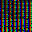

No entry::Stop


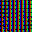

Beware of ice/snow::Speed limit (80km/h)


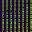

Speed limit (60km/h)::Speed limit (20km/h)


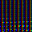

Speed limit (120km/h)::Speed limit (100km/h)


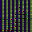

No passing::Speed limit (80km/h)


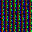

Speed limit (50km/h)::Speed limit (70km/h)


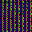

No passing for vehicles over 3.5 metric tons::Roundabout mandatory


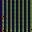

Speed limit (50km/h)::Speed limit (70km/h)


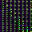

Pedestrians::Wild animals crossing


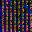

Speed limit (70km/h)::Speed limit (20km/h)


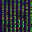

Speed limit (30km/h)::Speed limit (70km/h)


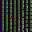

Road work::Bumpy road


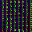

Turn right ahead::Ahead only


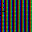

Wild animals crossing::Road work


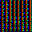

End of no passing by vehicles over 3.5 metric tons::End of no passing


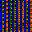

Keep right::Bicycles crossing


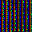

Stop::Speed limit (30km/h)


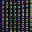

Right-of-way at the next intersection::Children crossing


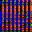

Speed limit (30km/h)::Speed limit (80km/h)


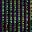

Slippery road::Beware of ice/snow


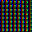

Turn left ahead::General caution


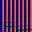

Speed limit (100km/h)::Speed limit (120km/h)


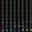

Speed limit (60km/h)::Speed limit (80km/h)


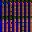

Beware of ice/snow::Speed limit (80km/h)


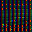

Speed limit (60km/h)::No vehicles


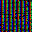

Speed limit (50km/h)::Speed limit (80km/h)


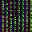

Right-of-way at the next intersection::Beware of ice/snow


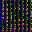

Speed limit (80km/h)::Speed limit (120km/h)


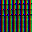

Speed limit (120km/h)::Beware of ice/snow


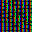

Road work::Road narrows on the right


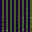

General caution::Slippery road


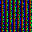

Speed limit (50km/h)::Ahead only


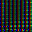

End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


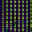

Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


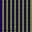

No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


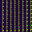

Speed limit (30km/h)::Speed limit (70km/h)


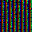

Children crossing::No passing for vehicles over 3.5 metric tons


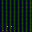

End of no passing::End of all speed and passing limits


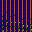

Speed limit (120km/h)::Speed limit (100km/h)


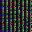

Beware of ice/snow::Right-of-way at the next intersection


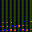

Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


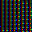

Turn left ahead::Speed limit (80km/h)


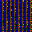

Speed limit (50km/h)::Speed limit (70km/h)


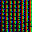

Go straight or right::Ahead only


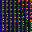

Pedestrians::Road work


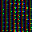

Speed limit (120km/h)::Speed limit (100km/h)


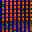

Speed limit (100km/h)::Wild animals crossing


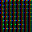

Speed limit (70km/h)::Road narrows on the right


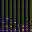

Speed limit (70km/h)::Speed limit (80km/h)


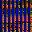

Go straight or left::Turn left ahead


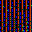

Slippery road::Wild animals crossing


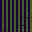

Road work::Slippery road


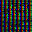

No passing::General caution


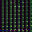

End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


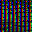

End of no passing::End of all speed and passing limits


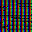

Yield::Speed limit (60km/h)


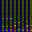

Speed limit (70km/h)::Speed limit (80km/h)


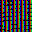

Beware of ice/snow::General caution


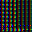

Turn left ahead::Roundabout mandatory


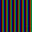

Dangerous curve to the right::Road work


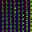

Road narrows on the right::Speed limit (50km/h)


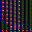

Speed limit (30km/h)::No vehicles


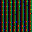

Turn left ahead::Ahead only


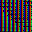

Speed limit (120km/h)::Speed limit (100km/h)


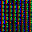

Right-of-way at the next intersection::Speed limit (30km/h)


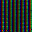

Priority road::Vehicles over 3.5 metric tons prohibited


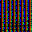

Speed limit (50km/h)::Speed limit (70km/h)


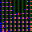

Turn right ahead::Ahead only


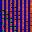

Wild animals crossing::General caution


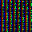

Slippery road::Wild animals crossing


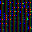

No passing::Priority road


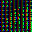

Speed limit (30km/h)::Speed limit (50km/h)


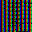

Keep right::Roundabout mandatory


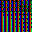

Speed limit (60km/h)::Yield


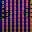

Keep right::Speed limit (100km/h)


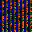

Pedestrians::Slippery road


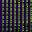

End of speed limit (80km/h)::End of all speed and passing limits


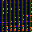

Speed limit (80km/h)::Speed limit (120km/h)


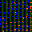

Keep right::No vehicles


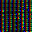

Traffic signals::Dangerous curve to the left


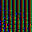

Speed limit (80km/h)::Speed limit (60km/h)


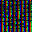

Right-of-way at the next intersection::Bumpy road


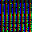

Go straight or left::Turn left ahead


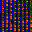

No passing::Speed limit (60km/h)


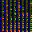

Stop::Speed limit (60km/h)


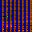

Turn right ahead::Ahead only


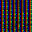

Speed limit (30km/h)::Yield


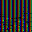

Stop::Speed limit (80km/h)


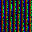

Speed limit (50km/h)::Speed limit (70km/h)


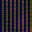

Priority road::Speed limit (50km/h)


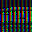

Turn right ahead::Go straight or left


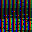

Yield::Speed limit (20km/h)


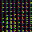

End of no passing::End of all speed and passing limits


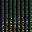

Speed limit (80km/h)::Speed limit (70km/h)


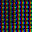

Speed limit (30km/h)::Speed limit (60km/h)


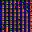

Speed limit (70km/h)::Speed limit (80km/h)


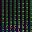

End of speed limit (80km/h)::End of no passing


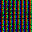

Speed limit (30km/h)::Yield


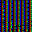

No passing::Speed limit (70km/h)


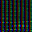

Speed limit (60km/h)::End of speed limit (80km/h)


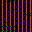

Slippery road::Road narrows on the right


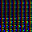

Speed limit (80km/h)::Speed limit (70km/h)


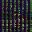

Keep right::End of all speed and passing limits


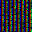

Double curve::Slippery road


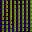

Go straight or right::Speed limit (30km/h)


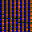

Road work::Wild animals crossing


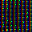

Right-of-way at the next intersection::Pedestrians


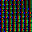

Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


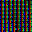

Wild animals crossing::Speed limit (120km/h)


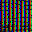

Speed limit (80km/h)::Speed limit (100km/h)


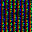

Pedestrians::Double curve


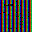

Priority road::Go straight or right


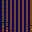

Beware of ice/snow::Speed limit (30km/h)


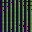

Speed limit (70km/h)::Priority road


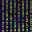

Stop::Speed limit (50km/h)


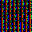

Dangerous curve to the left::Speed limit (70km/h)


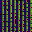

Road work::Wild animals crossing


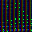

Speed limit (80km/h)::Speed limit (60km/h)


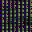

Speed limit (30km/h)::Yield


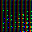

No passing::Vehicles over 3.5 metric tons prohibited


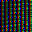

Ahead only::Turn left ahead


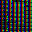

Speed limit (100km/h)::Speed limit (80km/h)


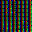

Road work::Pedestrians


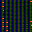

General caution::Wild animals crossing


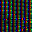

Slippery road::Children crossing


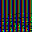

Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


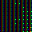

Pedestrians::Bicycles crossing


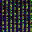

Speed limit (30km/h)::Speed limit (80km/h)


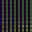

No passing for vehicles over 3.5 metric tons::No passing


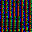

Speed limit (70km/h)::Speed limit (120km/h)


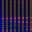

Speed limit (30km/h)::Speed limit (100km/h)


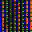

Children crossing::Bumpy road


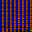

Road work::Speed limit (30km/h)


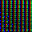

Speed limit (80km/h)::Speed limit (60km/h)


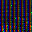

Go straight or right::Keep right


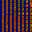

No vehicles::No passing


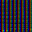

General caution::Wild animals crossing


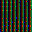

Turn left ahead::Ahead only


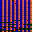

Speed limit (50km/h)::Speed limit (80km/h)


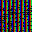

Road narrows on the right::Dangerous curve to the right


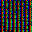

Speed limit (70km/h)::Speed limit (120km/h)


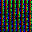

Stop::No entry


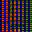

Speed limit (60km/h)::Ahead only


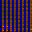

General caution::Speed limit (100km/h)


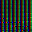

Speed limit (120km/h)::Speed limit (80km/h)


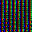

Priority road::End of speed limit (80km/h)


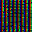

Speed limit (30km/h)::Speed limit (60km/h)


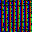

Speed limit (100km/h)::Speed limit (120km/h)


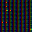

General caution::Yield


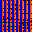

No entry::Priority road


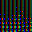

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


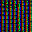

Slippery road::Dangerous curve to the left


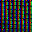

Speed limit (70km/h)::Speed limit (120km/h)


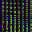

Ahead only::Keep right


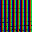

Speed limit (100km/h)::End of all speed and passing limits


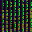

Speed limit (30km/h)::Speed limit (100km/h)


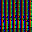

Right-of-way at the next intersection::Speed limit (50km/h)


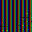

Road work::Slippery road


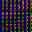

Pedestrians::Bumpy road


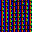

Road work::Bicycles crossing


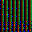

Keep right::Beware of ice/snow


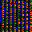

Speed limit (60km/h)::Speed limit (80km/h)


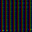

End of no passing::End of all speed and passing limits


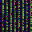

Priority road::Speed limit (60km/h)


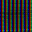

Speed limit (70km/h)::Speed limit (30km/h)


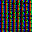

No entry::Priority road


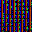

Slippery road::Road narrows on the right


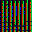

Speed limit (50km/h)::Speed limit (60km/h)


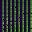

Keep left::Speed limit (60km/h)


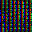

Speed limit (80km/h)::Speed limit (30km/h)


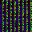

Bicycles crossing::Wild animals crossing


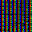

Road work::Road narrows on the right


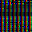

Speed limit (60km/h)::Speed limit (20km/h)


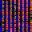

General caution::Wild animals crossing


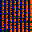

Speed limit (50km/h)::Speed limit (100km/h)


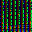

Speed limit (80km/h)::Speed limit (60km/h)


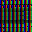

Beware of ice/snow::Speed limit (80km/h)


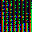

Speed limit (50km/h)::Speed limit (60km/h)


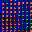

Speed limit (60km/h)::Speed limit (70km/h)


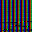

Speed limit (120km/h)::Speed limit (50km/h)


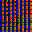

Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


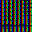

Yield::Road work


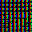

Speed limit (80km/h)::Speed limit (70km/h)


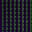

General caution::Yield


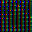

Speed limit (70km/h)::Speed limit (80km/h)


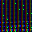

Speed limit (80km/h)::Speed limit (30km/h)


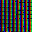

Speed limit (70km/h)::Speed limit (80km/h)


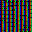

Dangerous curve to the right::Children crossing


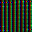

Beware of ice/snow::Dangerous curve to the right


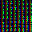

Speed limit (60km/h)::Speed limit (50km/h)


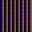

No passing for vehicles over 3.5 metric tons::Wild animals crossing


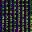

Beware of ice/snow::Road work


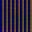

Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


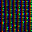

Speed limit (50km/h)::Speed limit (70km/h)


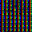

No passing::No vehicles


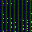

Speed limit (80km/h)::Speed limit (100km/h)


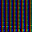

Speed limit (120km/h)::Speed limit (100km/h)


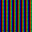

Speed limit (80km/h)::Wild animals crossing


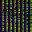

Speed limit (30km/h)::Speed limit (20km/h)


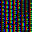

Children crossing::Road work


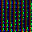

Speed limit (50km/h)::Speed limit (60km/h)


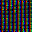

Speed limit (70km/h)::Speed limit (100km/h)


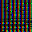

No vehicles::No passing for vehicles over 3.5 metric tons


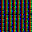

Road work::Speed limit (50km/h)


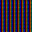

No entry::Road work


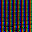

Double curve::Dangerous curve to the left


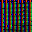

Speed limit (30km/h)::No vehicles


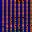

No passing::No passing for vehicles over 3.5 metric tons


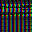

Speed limit (30km/h)::No vehicles


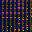

No entry::Bumpy road


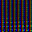

Speed limit (120km/h)::Speed limit (100km/h)


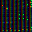

Speed limit (120km/h)::Speed limit (100km/h)


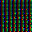

Keep left::Traffic signals


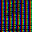

End of speed limit (80km/h)::End of all speed and passing limits


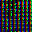

Speed limit (30km/h)::Speed limit (80km/h)


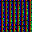

No passing::No passing for vehicles over 3.5 metric tons


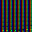

Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


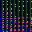

Speed limit (120km/h)::Speed limit (100km/h)


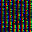

Speed limit (50km/h)::Speed limit (100km/h)


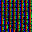

Priority road::Turn left ahead


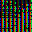

Speed limit (50km/h)::Speed limit (120km/h)


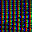

Road work::Road narrows on the right


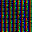

Priority road::Children crossing


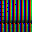

Wild animals crossing::Speed limit (120km/h)


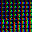

Go straight or right::No vehicles


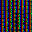

Bicycles crossing::General caution


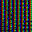

Priority road::Right-of-way at the next intersection


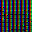

No passing::Speed limit (30km/h)


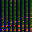

Speed limit (100km/h)::Speed limit (80km/h)


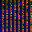

Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


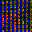

No passing for vehicles over 3.5 metric tons::Double curve


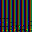

Speed limit (70km/h)::Speed limit (80km/h)


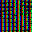

Right-of-way at the next intersection::Bicycles crossing


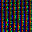

No passing::Speed limit (80km/h)


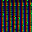

Speed limit (50km/h)::Speed limit (20km/h)


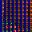

Speed limit (120km/h)::Speed limit (80km/h)


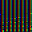

No passing::Speed limit (80km/h)


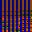

Right-of-way at the next intersection::Bicycles crossing


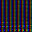

Speed limit (120km/h)::Speed limit (100km/h)


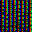

Keep right::Go straight or right


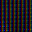

Dangerous curve to the left::Bicycles crossing


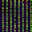

Speed limit (30km/h)::Speed limit (50km/h)


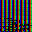

Speed limit (50km/h)::Speed limit (70km/h)


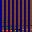

Speed limit (120km/h)::Speed limit (60km/h)


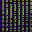

Speed limit (100km/h)::Speed limit (60km/h)


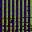

Speed limit (80km/h)::Speed limit (70km/h)


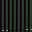

Speed limit (120km/h)::Speed limit (80km/h)


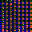

Speed limit (30km/h)::Speed limit (60km/h)


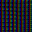

General caution::Wild animals crossing


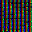

No vehicles::No passing


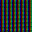

General caution::Slippery road


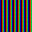

No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


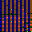

Stop::No passing


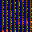

Speed limit (50km/h)::Speed limit (70km/h)


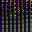

General caution::Road work


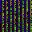

Speed limit (100km/h)::Speed limit (120km/h)


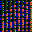

Bumpy road::Pedestrians


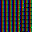

General caution::Dangerous curve to the left


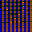

No passing::Speed limit (50km/h)


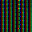

Beware of ice/snow::Traffic signals


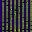

Speed limit (50km/h)::Speed limit (70km/h)


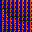

No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


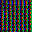

Double curve::Dangerous curve to the left


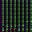

Speed limit (100km/h)::Speed limit (80km/h)


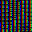

Yield::Speed limit (50km/h)


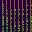

Speed limit (120km/h)::Speed limit (30km/h)


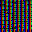

Ahead only::Go straight or right


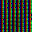

Speed limit (100km/h)::Speed limit (60km/h)


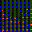

Speed limit (70km/h)::Speed limit (60km/h)


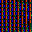

Speed limit (70km/h)::Speed limit (100km/h)


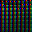

Dangerous curve to the left::General caution


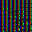

No entry::Bumpy road


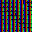

Speed limit (120km/h)::Speed limit (100km/h)


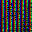

Speed limit (60km/h)::Speed limit (80km/h)


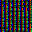

Wild animals crossing::Speed limit (60km/h)


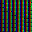

Slippery road::No passing for vehicles over 3.5 metric tons


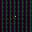

End of no passing::Speed limit (70km/h)


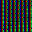

Keep left::Keep right


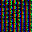

Pedestrians::Right-of-way at the next intersection


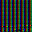

Speed limit (80km/h)::Speed limit (120km/h)


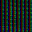

No passing::No passing for vehicles over 3.5 metric tons


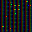

Speed limit (120km/h)::Speed limit (100km/h)


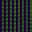

Keep right::Road work


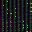

Speed limit (120km/h)::Ahead only


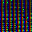

End of all speed and passing limits::No vehicles


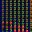

Speed limit (60km/h)::Keep right


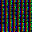

Priority road::Road work


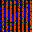

Children crossing::General caution


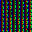

Priority road::Speed limit (80km/h)


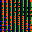

Speed limit (50km/h)::Speed limit (70km/h)


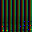

Speed limit (80km/h)::Speed limit (50km/h)


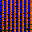

Speed limit (50km/h)::Speed limit (30km/h)


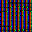

No entry::Wild animals crossing


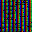

Speed limit (80km/h)::Speed limit (70km/h)


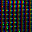

No passing::Speed limit (70km/h)


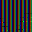

General caution::Traffic signals


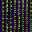

Right-of-way at the next intersection::Children crossing


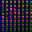

Dangerous curve to the left::General caution


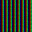

No passing for vehicles over 3.5 metric tons::Wild animals crossing


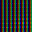

Yield::Speed limit (80km/h)


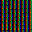

Road work::Children crossing


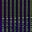

Speed limit (30km/h)::Speed limit (100km/h)


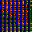

Ahead only::Yield


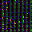

Keep right::No vehicles


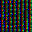

Speed limit (100km/h)::Speed limit (70km/h)


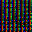

Dangerous curve to the left::Speed limit (70km/h)


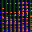

Turn right ahead::Road work


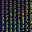

Keep right::Turn right ahead


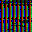

Speed limit (60km/h)::Speed limit (80km/h)


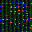

No passing::Priority road


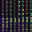

Right-of-way at the next intersection::Bumpy road


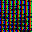

Keep right::Go straight or right


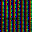

Right-of-way at the next intersection::Speed limit (30km/h)


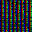

Speed limit (70km/h)::Speed limit (80km/h)


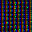

Dangerous curve to the right::Children crossing


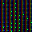

Dangerous curve to the left::Bicycles crossing


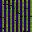

Priority road::Go straight or right


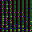

Speed limit (80km/h)::Speed limit (100km/h)


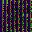

Speed limit (70km/h)::Speed limit (100km/h)


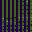

Speed limit (30km/h)::Speed limit (50km/h)


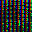

Speed limit (30km/h)::Speed limit (50km/h)


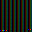

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


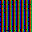

Speed limit (50km/h)::No vehicles


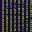

Road work::Speed limit (50km/h)


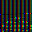

Speed limit (60km/h)::No passing


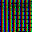

Speed limit (70km/h)::Speed limit (100km/h)


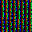

Speed limit (70km/h)::Speed limit (30km/h)


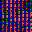

Ahead only::Go straight or right


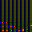

Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


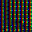

Speed limit (60km/h)::Speed limit (100km/h)


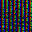

Speed limit (70km/h)::Speed limit (80km/h)


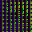

Speed limit (50km/h)::Speed limit (120km/h)


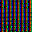

Double curve::Dangerous curve to the left


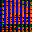

Yield::Wild animals crossing


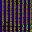

No entry::Wild animals crossing


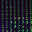

Speed limit (30km/h)::Speed limit (80km/h)


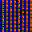

Road work::Road narrows on the right


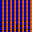

Speed limit (60km/h)::No vehicles


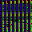

Go straight or left::Turn left ahead


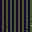

Beware of ice/snow::Bumpy road


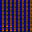

General caution::Speed limit (100km/h)


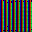

Beware of ice/snow::Traffic signals


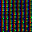

No vehicles::Speed limit (30km/h)


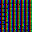

Speed limit (80km/h)::Speed limit (50km/h)


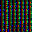

Ahead only::No passing for vehicles over 3.5 metric tons


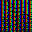

Keep right::Go straight or right


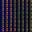

End of speed limit (80km/h)::Speed limit (80km/h)


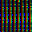

Speed limit (20km/h)::Speed limit (50km/h)


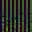

Stop::Speed limit (80km/h)


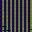

Wild animals crossing::General caution


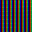

Speed limit (80km/h)::Yield


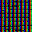

Speed limit (60km/h)::Speed limit (20km/h)


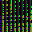

Speed limit (50km/h)::Dangerous curve to the left


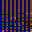

Speed limit (60km/h)::Vehicles over 3.5 metric tons prohibited


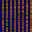

Right-of-way at the next intersection::Children crossing


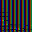

Speed limit (70km/h)::Speed limit (60km/h)


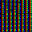

No passing::Speed limit (70km/h)


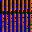

Speed limit (60km/h)::Speed limit (50km/h)


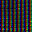

Traffic signals::Road narrows on the right


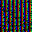

Speed limit (100km/h)::Speed limit (60km/h)


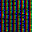

Right-of-way at the next intersection::Children crossing


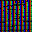

Go straight or right::Keep right


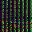

Road work::Bumpy road


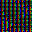

Speed limit (60km/h)::Speed limit (80km/h)


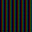

Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


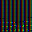

No passing::Speed limit (80km/h)


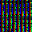

Go straight or left::Keep left


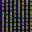

Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


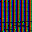

Speed limit (50km/h)::Speed limit (60km/h)


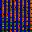

Speed limit (60km/h)::Speed limit (80km/h)


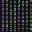

Right-of-way at the next intersection::Beware of ice/snow


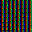

Road work::Children crossing


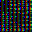

Speed limit (30km/h)::General caution


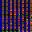

No vehicles::Speed limit (30km/h)


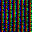

Ahead only::Beware of ice/snow


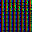

No vehicles::Speed limit (80km/h)


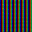

Priority road::Yield


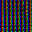

No passing::Turn left ahead


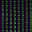

Keep right::Speed limit (50km/h)


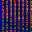

Speed limit (60km/h)::Speed limit (80km/h)


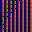

End of speed limit (80km/h)::Priority road


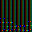

Speed limit (80km/h)::Speed limit (120km/h)


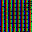

Speed limit (70km/h)::Speed limit (100km/h)


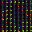

General caution::Keep right


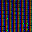

Dangerous curve to the right::Slippery road


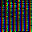

Right-of-way at the next intersection::Bumpy road


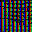

Speed limit (100km/h)::Speed limit (120km/h)


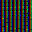

Right-of-way at the next intersection::General caution


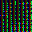

Dangerous curve to the right::Speed limit (120km/h)


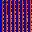

End of speed limit (80km/h)::Speed limit (80km/h)


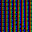

Road work::Dangerous curve to the left


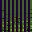

No passing::Speed limit (50km/h)


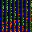

Go straight or right::Keep right


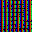

Beware of ice/snow::Speed limit (70km/h)


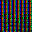

Speed limit (30km/h)::Speed limit (50km/h)


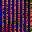

Ahead only::Roundabout mandatory


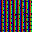

Road work::Children crossing


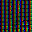

Speed limit (60km/h)::Speed limit (80km/h)


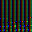

Speed limit (70km/h)::Speed limit (80km/h)


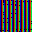

No passing::No vehicles


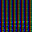

Speed limit (30km/h)::Speed limit (100km/h)


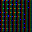

Speed limit (70km/h)::Speed limit (30km/h)


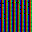

Speed limit (70km/h)::No vehicles


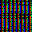

Speed limit (30km/h)::Speed limit (50km/h)


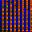

No passing::Speed limit (70km/h)


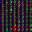

Bicycles crossing::Slippery road


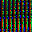

Speed limit (30km/h)::Speed limit (50km/h)


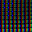

General caution::Road work


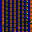

Children crossing::Bumpy road


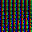

Speed limit (100km/h)::Speed limit (60km/h)


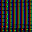

Speed limit (30km/h)::Speed limit (70km/h)


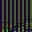

Speed limit (70km/h)::Speed limit (80km/h)


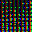

Speed limit (60km/h)::Speed limit (50km/h)


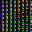

General caution::Priority road


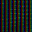

Priority road::Keep right


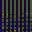

Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


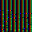

Speed limit (80km/h)::Speed limit (60km/h)


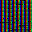

Speed limit (80km/h)::Speed limit (60km/h)


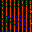

Slippery road::Road narrows on the right


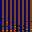

Speed limit (70km/h)::Speed limit (60km/h)


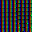

General caution::Bumpy road


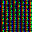

Stop::Beware of ice/snow


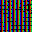

Beware of ice/snow::Right-of-way at the next intersection


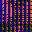

Priority road::Bicycles crossing


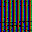

Speed limit (50km/h)::Speed limit (80km/h)


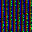

Double curve::Wild animals crossing


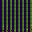

Speed limit (100km/h)::Speed limit (120km/h)


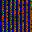

Children crossing::Wild animals crossing


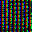

End of no passing by vehicles over 3.5 metric tons::End of no passing


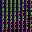

Ahead only::Speed limit (100km/h)


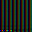

Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


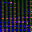

Speed limit (70km/h)::Speed limit (30km/h)


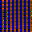

Speed limit (50km/h)::Speed limit (80km/h)


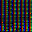

Right-of-way at the next intersection::Bumpy road


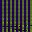

Speed limit (50km/h)::Speed limit (70km/h)


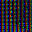

Speed limit (50km/h)::Speed limit (100km/h)


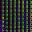

Speed limit (100km/h)::Speed limit (60km/h)


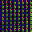

Speed limit (60km/h)::Speed limit (100km/h)


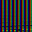

Speed limit (120km/h)::Speed limit (60km/h)


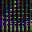

Roundabout mandatory::Beware of ice/snow


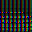

Speed limit (70km/h)::Speed limit (80km/h)


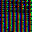

Stop::Wild animals crossing


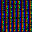

Turn right ahead::Keep left


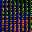

No passing::Vehicles over 3.5 metric tons prohibited


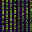

Traffic signals::End of all speed and passing limits


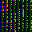

Priority road::End of all speed and passing limits


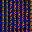

Ahead only::Turn left ahead


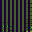

Road work::Dangerous curve to the left


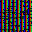

Road narrows on the right::Road work


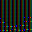

Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


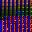

Speed limit (120km/h)::Speed limit (70km/h)


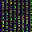

General caution::Road work


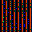

Slippery road::Road narrows on the right


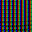

Keep right::Go straight or left


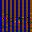

No passing::Speed limit (120km/h)


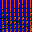

Speed limit (120km/h)::Speed limit (80km/h)


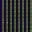

Keep right::Speed limit (100km/h)


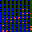

Speed limit (60km/h)::Speed limit (50km/h)


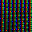

Slippery road::Beware of ice/snow


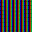

Priority road::Speed limit (100km/h)


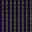

Speed limit (70km/h)::Speed limit (100km/h)


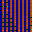

Children crossing::Speed limit (60km/h)


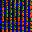

Speed limit (70km/h)::No passing


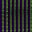

Speed limit (70km/h)::Speed limit (30km/h)


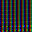

No passing for vehicles over 3.5 metric tons::No passing


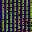

Beware of ice/snow::Children crossing


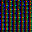

Road work::Speed limit (80km/h)


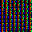

Speed limit (50km/h)::Speed limit (30km/h)


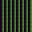

No passing for vehicles over 3.5 metric tons::Wild animals crossing


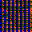

Speed limit (70km/h)::Speed limit (80km/h)


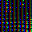

Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


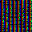

Yield::No vehicles


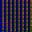

General caution::Traffic signals


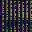

Road work::Dangerous curve to the left


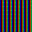

Speed limit (80km/h)::Speed limit (50km/h)


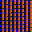

Go straight or right::Speed limit (60km/h)


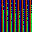

Wild animals crossing::Traffic signals


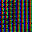

Keep right::Priority road


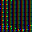

Speed limit (120km/h)::Speed limit (80km/h)


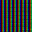

Speed limit (120km/h)::Traffic signals


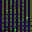

No vehicles::Speed limit (120km/h)


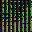

Speed limit (50km/h)::Speed limit (70km/h)


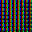

Go straight or left::General caution


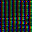

Speed limit (70km/h)::Speed limit (80km/h)


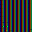

Beware of ice/snow::Speed limit (30km/h)


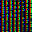

Speed limit (30km/h)::Speed limit (70km/h)


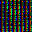

Priority road::End of no passing


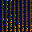

Speed limit (50km/h)::Speed limit (80km/h)


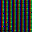

Priority road::Vehicles over 3.5 metric tons prohibited


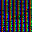

Keep right::Go straight or right


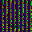

Speed limit (50km/h)::Speed limit (30km/h)


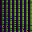

Speed limit (100km/h)::Speed limit (70km/h)


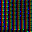

Right-of-way at the next intersection::Dangerous curve to the left


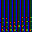

Speed limit (120km/h)::Speed limit (80km/h)


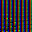

Double curve::Right-of-way at the next intersection


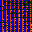

Road work::General caution


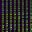

No passing for vehicles over 3.5 metric tons::No passing


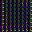

Turn left ahead::No vehicles


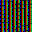

No vehicles::No passing


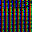

Go straight or right::Keep right


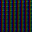

Speed limit (70km/h)::Go straight or right


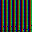

End of speed limit (80km/h)::Priority road


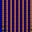

General caution::Dangerous curve to the right


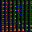

No vehicles::End of speed limit (80km/h)


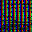

Road work::Dangerous curve to the left


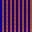

Turn right ahead::Speed limit (50km/h)


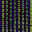

Speed limit (30km/h)::Speed limit (60km/h)


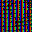

Road work::Slippery road


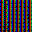

Right-of-way at the next intersection::Dangerous curve to the left


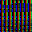

Speed limit (30km/h)::Speed limit (50km/h)


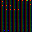

Keep right::General caution


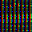

Speed limit (20km/h)::Speed limit (70km/h)


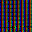

Road work::Double curve


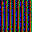

Children crossing::General caution


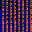

Speed limit (70km/h)::Speed limit (80km/h)


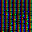

No vehicles::Speed limit (30km/h)


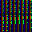

Speed limit (30km/h)::Yield


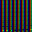

Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


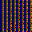

Keep left::Keep right


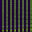

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


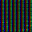

General caution::Slippery road


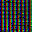

Speed limit (70km/h)::Speed limit (60km/h)


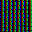

Speed limit (60km/h)::Speed limit (70km/h)


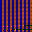

Turn right ahead::Ahead only


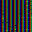

Right-of-way at the next intersection::Dangerous curve to the right


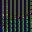

Turn right ahead::Speed limit (50km/h)


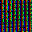

Speed limit (30km/h)::Priority road


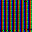

Vehicles over 3.5 metric tons prohibited::Speed limit (80km/h)


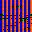

No entry::Speed limit (70km/h)


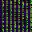

Pedestrians::Wild animals crossing


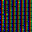

General caution::Speed limit (60km/h)


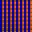

Speed limit (80km/h)::Speed limit (60km/h)


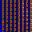

Road work::Dangerous curve to the left


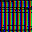

Yield::Speed limit (100km/h)


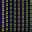

Right-of-way at the next intersection::Children crossing


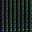

Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


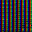

General caution::Wild animals crossing


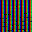

General caution::Traffic signals


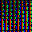

Speed limit (50km/h)::Speed limit (70km/h)


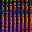

Speed limit (30km/h)::Speed limit (50km/h)


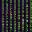

Road work::Dangerous curve to the right


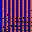

Speed limit (80km/h)::Speed limit (50km/h)


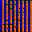

Speed limit (60km/h)::Speed limit (30km/h)


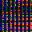

Keep right::Speed limit (70km/h)


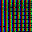

Speed limit (70km/h)::Speed limit (100km/h)


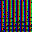

Speed limit (120km/h)::Speed limit (100km/h)


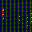

Dangerous curve to the right::Bicycles crossing


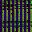

Yield::Priority road


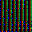

Keep right::Beware of ice/snow


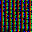

Road work::Road narrows on the right


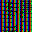

Right-of-way at the next intersection::Double curve


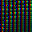

Dangerous curve to the left::General caution


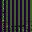

Stop::Speed limit (80km/h)


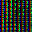

General caution::Right-of-way at the next intersection


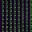

Keep right::Speed limit (50km/h)


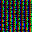

Dangerous curve to the right::Children crossing


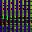

Yield::Wild animals crossing


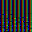

Speed limit (100km/h)::Speed limit (60km/h)


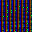

Speed limit (30km/h)::Speed limit (80km/h)


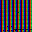

Turn right ahead::Wild animals crossing


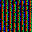

Children crossing::Speed limit (80km/h)


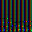

Speed limit (100km/h)::Speed limit (80km/h)


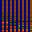

Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


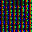

Priority road::No passing


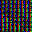

No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


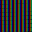

Speed limit (70km/h)::Speed limit (50km/h)


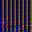

Speed limit (120km/h)::Speed limit (80km/h)


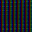

Speed limit (70km/h)::Go straight or right


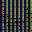

Speed limit (50km/h)::Speed limit (70km/h)


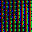

Ahead only::No passing for vehicles over 3.5 metric tons


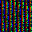

Pedestrians::Slippery road


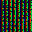

Speed limit (30km/h)::Speed limit (100km/h)


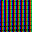

Keep right::Roundabout mandatory


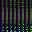

No passing::Speed limit (60km/h)


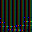

No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


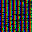

Road work::Traffic signals


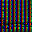

Road narrows on the right::Double curve


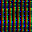

Speed limit (20km/h)::Speed limit (50km/h)


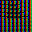

Keep right::Speed limit (100km/h)


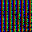

Priority road::Speed limit (80km/h)


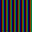

Keep right::Speed limit (60km/h)


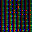

End of speed limit (80km/h)::End of no passing


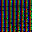

Priority road::Speed limit (60km/h)


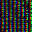

Stop::No passing


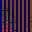

Children crossing::Bumpy road


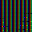

Road work::Dangerous curve to the right


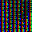

Children crossing::Road work


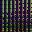

Speed limit (100km/h)::Speed limit (80km/h)


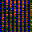

Turn left ahead::Keep right


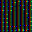

Roundabout mandatory::Speed limit (70km/h)


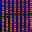

Road work::Speed limit (50km/h)


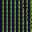

Speed limit (120km/h)::Speed limit (80km/h)


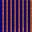

Speed limit (60km/h)::No passing


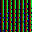

Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


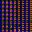

Speed limit (60km/h)::Yield


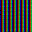

Speed limit (100km/h)::Speed limit (60km/h)


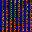

Turn right ahead::Ahead only


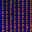

Dangerous curve to the right::Wild animals crossing


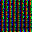

Keep right::Speed limit (70km/h)


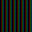

No passing for vehicles over 3.5 metric tons::General caution


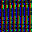

Speed limit (30km/h)::Speed limit (80km/h)


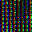

Ahead only::Go straight or left


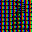

Traffic signals::Wild animals crossing


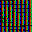

Speed limit (80km/h)::Speed limit (100km/h)


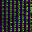

General caution::Road work


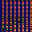

Speed limit (80km/h)::Speed limit (60km/h)


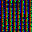

No vehicles::Speed limit (50km/h)


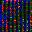

Keep right::No vehicles


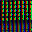

Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


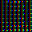

Ahead only::Keep right


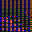

Speed limit (60km/h)::Speed limit (80km/h)


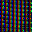

Right-of-way at the next intersection::General caution


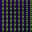

Ahead only::Yield


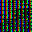

Speed limit (50km/h)::Speed limit (120km/h)


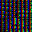

Right-of-way at the next intersection::Road work


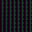

End of no passing::Speed limit (70km/h)


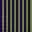

No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


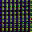

Keep right::Speed limit (50km/h)


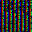

Speed limit (70km/h)::Speed limit (30km/h)


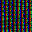

Wild animals crossing::No passing for vehicles over 3.5 metric tons


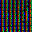

Speed limit (30km/h)::Speed limit (70km/h)


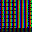

Speed limit (100km/h)::Speed limit (70km/h)


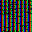

Dangerous curve to the right::Children crossing


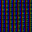

Speed limit (50km/h)::Yield


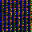

Slippery road::Right-of-way at the next intersection


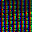

Speed limit (100km/h)::Speed limit (50km/h)


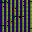

Speed limit (50km/h)::Go straight or right


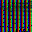

Speed limit (70km/h)::Speed limit (60km/h)


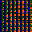

Stop::Speed limit (100km/h)


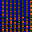

No passing::No passing for vehicles over 3.5 metric tons


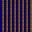

Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


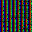

Keep left::Traffic signals


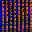

Road work::Beware of ice/snow


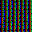

Ahead only::Turn left ahead


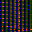

Speed limit (30km/h)::No vehicles


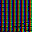

Speed limit (60km/h)::Speed limit (30km/h)


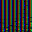

Traffic signals::Speed limit (80km/h)


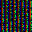

Pedestrians::Road work


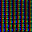

Speed limit (50km/h)::Speed limit (100km/h)


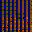

Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


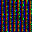

Turn right ahead::Keep left


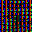

Speed limit (100km/h)::Speed limit (120km/h)


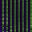

Priority road::Vehicles over 3.5 metric tons prohibited


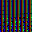

Keep right::Turn left ahead


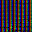

Road work::Dangerous curve to the left


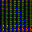

No passing::Wild animals crossing


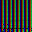

Speed limit (120km/h)::No passing


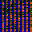

Right-of-way at the next intersection::Beware of ice/snow


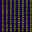

Road work::General caution


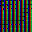

End of speed limit (80km/h)::Speed limit (80km/h)


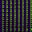

General caution::Double curve


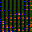

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


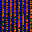

Bicycles crossing::General caution


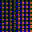

Speed limit (30km/h)::Speed limit (60km/h)


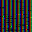

Bumpy road::Road work


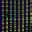

Slippery road::Road narrows on the right


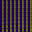

No entry::Wild animals crossing


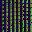

Keep right::Ahead only


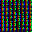

Speed limit (30km/h)::Speed limit (80km/h)


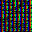

Bumpy road::Pedestrians


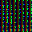

No passing::No passing for vehicles over 3.5 metric tons


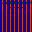

End of speed limit (80km/h)::Speed limit (80km/h)


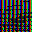

Keep right::Go straight or right


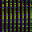

Speed limit (20km/h)::Speed limit (50km/h)


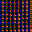

Speed limit (30km/h)::No passing


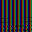

Keep right::Speed limit (60km/h)


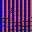

Speed limit (80km/h)::Speed limit (70km/h)


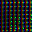

No passing::Speed limit (80km/h)


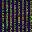

Slippery road::Bicycles crossing


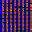

No vehicles::Speed limit (70km/h)


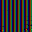

Dangerous curve to the right::Slippery road


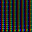

No passing for vehicles over 3.5 metric tons::No passing


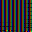

Road work::Wild animals crossing


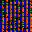

Road narrows on the right::Roundabout mandatory


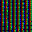

Priority road::No passing


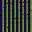

Double curve::Traffic signals


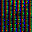

Turn left ahead::Keep right


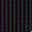

Wild animals crossing::General caution


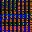

Speed limit (30km/h)::Speed limit (50km/h)


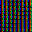

Speed limit (70km/h)::Right-of-way at the next intersection


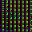

Speed limit (60km/h)::Keep right


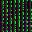

Priority road::Speed limit (70km/h)


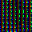

Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


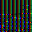

Speed limit (60km/h)::Vehicles over 3.5 metric tons prohibited


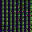

Priority road::End of speed limit (80km/h)


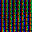

Speed limit (30km/h)::Speed limit (70km/h)


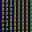

Go straight or left::Speed limit (30km/h)


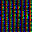

Speed limit (50km/h)::Speed limit (100km/h)


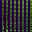

Yield::Keep right


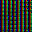

Speed limit (100km/h)::Speed limit (60km/h)


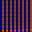

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


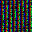

Traffic signals::Bicycles crossing


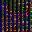

Speed limit (70km/h)::Speed limit (80km/h)


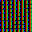

Go straight or right::Speed limit (30km/h)


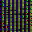

Speed limit (50km/h)::Speed limit (30km/h)


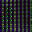

Speed limit (50km/h)::Speed limit (100km/h)


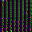

Ahead only::Go straight or left


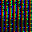

Yield::Bumpy road


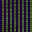

Ahead only::Keep right


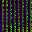

Speed limit (70km/h)::Speed limit (80km/h)


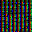

Speed limit (30km/h)::Speed limit (50km/h)


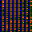

No vehicles::Speed limit (70km/h)


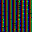

Right-of-way at the next intersection::Dangerous curve to the right


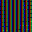

Right-of-way at the next intersection::Road work


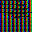

Keep right::Speed limit (100km/h)


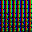

Speed limit (100km/h)::Speed limit (70km/h)


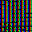

Speed limit (50km/h)::Speed limit (70km/h)


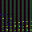

No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


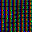

Priority road::General caution


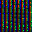

Speed limit (30km/h)::Speed limit (100km/h)


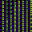

Road work::Wild animals crossing


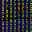

Go straight or left::Speed limit (70km/h)


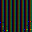

Road work::General caution


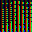

End of no passing::Speed limit (60km/h)


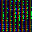

Speed limit (80km/h)::Speed limit (120km/h)


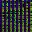

Go straight or right::Speed limit (50km/h)


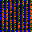

Speed limit (70km/h)::Speed limit (20km/h)


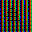

Keep right::Speed limit (100km/h)


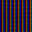

No entry::Road work


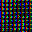

General caution::Traffic signals


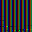

Speed limit (100km/h)::Speed limit (60km/h)


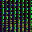

No passing::No passing for vehicles over 3.5 metric tons


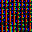

Speed limit (100km/h)::Speed limit (120km/h)


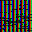

No passing::Dangerous curve to the right


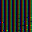

Road work::Slippery road


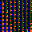

Speed limit (50km/h)::Speed limit (70km/h)


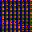

Speed limit (70km/h)::Speed limit (120km/h)


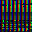

Speed limit (80km/h)::Speed limit (60km/h)


Keep right::Priority road


Road work::Bicycles crossing


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Traffic signals::Pedestrians


Priority road::No passing


Speed limit (50km/h)::Speed limit (70km/h)


Road work::General caution


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Beware of ice/snow


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (20km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Ahead only::Speed limit (70km/h)


Speed limit (100km/h)::Roundabout mandatory


No entry::Wild animals crossing


Speed limit (60km/h)::Speed limit (20km/h)


Road work::Beware of ice/snow


General caution::Traffic signals


Traffic signals::Wild animals crossing


Priority road::Road work


Beware of ice/snow::Speed limit (30km/h)


Turn left ahead::Roundabout mandatory


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Wild animals crossing::Right-of-way at the next intersection


Speed limit (80km/h)::End of speed limit (80km/h)


Speed limit (100km/h)::Speed limit (30km/h)


No passing for vehicles over 3.5 metric tons::No passing


Speed limit (30km/h)::Right-of-way at the next intersection


Speed limit (30km/h)::Children crossing


Speed limit (30km/h)::No vehicles


No passing::Speed limit (80km/h)


Right-of-way at the next intersection::Slippery road


Keep right::Turn left ahead


Right-of-way at the next intersection::Dangerous curve to the left


Speed limit (50km/h)::Speed limit (70km/h)


Road work::Children crossing


Speed limit (80km/h)::Speed limit (120km/h)


Turn right ahead::Ahead only


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (60km/h)


Priority road::Right-of-way at the next intersection


Bumpy road::General caution


Keep right::Speed limit (100km/h)


Keep right::Turn left ahead


Bumpy road::Pedestrians


No passing::No passing for vehicles over 3.5 metric tons


Keep right::Go straight or right


Beware of ice/snow::Dangerous curve to the left


Speed limit (120km/h)::Speed limit (100km/h)


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Right-of-way at the next intersection::General caution


Right-of-way at the next intersection::General caution


Keep right::Ahead only


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Roundabout mandatory::Speed limit (60km/h)


Ahead only::Go straight or left


Slippery road::Children crossing


Speed limit (100km/h)::Traffic signals


Ahead only::Speed limit (100km/h)


Wild animals crossing::Dangerous curve to the right


Speed limit (50km/h)::Speed limit (70km/h)


No passing::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Priority road::General caution


Ahead only::Yield


Speed limit (70km/h)::Speed limit (80km/h)


Priority road::Road work


Speed limit (60km/h)::Speed limit (80km/h)


Go straight or right::Roundabout mandatory


Speed limit (100km/h)::Speed limit (120km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Speed limit (50km/h)::End of speed limit (80km/h)


Turn right ahead::Roundabout mandatory


Dangerous curve to the right::General caution


Speed limit (70km/h)::Speed limit (80km/h)


End of speed limit (80km/h)::End of all speed and passing limits


Right-of-way at the next intersection::Double curve


Speed limit (80km/h)::Speed limit (50km/h)


Keep right::Ahead only


Priority road::End of all speed and passing limits


Go straight or right::Keep right


No passing::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Children crossing::Bumpy road


Turn right ahead::Turn left ahead


Speed limit (80km/h)::Speed limit (100km/h)


End of speed limit (80km/h)::End of all speed and passing limits


Speed limit (20km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Ahead only::Turn left ahead


Right-of-way at the next intersection::Children crossing


Children crossing::Bumpy road


Slippery road::Road narrows on the right


End of speed limit (80km/h)::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (20km/h)::Speed limit (100km/h)


Traffic signals::Children crossing


Right-of-way at the next intersection::General caution


Turn left ahead::Roundabout mandatory


Go straight or left::Turn left ahead


Stop::Speed limit (20km/h)


Priority road::Speed limit (30km/h)


Keep right::Ahead only


Ahead only::Keep right


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (50km/h)::No passing


Speed limit (50km/h)::Speed limit (80km/h)


No entry::Bumpy road


Stop::Speed limit (60km/h)


Keep right::Speed limit (60km/h)


Bicycles crossing::General caution


Keep right::Turn left ahead


Right-of-way at the next intersection::Speed limit (70km/h)


Right-of-way at the next intersection::Bumpy road


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Turn left ahead::Ahead only


Speed limit (30km/h)::Speed limit (80km/h)


Road narrows on the right::Keep right


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Children crossing::Bumpy road


Go straight or right::Keep right


Yield::Go straight or right


Speed limit (80km/h)::Speed limit (120km/h)


Ahead only::Keep right


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (60km/h)::Yield


Speed limit (100km/h)::Wild animals crossing


Priority road::Speed limit (100km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Road work::Right-of-way at the next intersection


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Dangerous curve to the right::Bumpy road


Bumpy road::Pedestrians


Right-of-way at the next intersection::General caution


Keep right::Go straight or right


Road work::Wild animals crossing


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Road work::General caution


Go straight or right::No vehicles


Road narrows on the right::End of all speed and passing limits


Speed limit (60km/h)::Speed limit (100km/h)


Ahead only::Keep right


End of no passing by vehicles over 3.5 metric tons::Speed limit (120km/h)


Ahead only::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (80km/h)


No passing::Vehicles over 3.5 metric tons prohibited


Priority road::Children crossing


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Beware of ice/snow::General caution


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (120km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Go straight or right::Speed limit (50km/h)


Right-of-way at the next intersection::Dangerous curve to the left


Dangerous curve to the right::Bicycles crossing


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Slippery road::Road narrows on the right


Turn left ahead::Keep right


Road narrows on the right::Right-of-way at the next intersection


Keep right::Ahead only


Speed limit (50km/h)::Speed limit (60km/h)


Road narrows on the right::General caution


Road narrows on the right::Right-of-way at the next intersection


Speed limit (50km/h)::Go straight or right


Speed limit (70km/h)::Go straight or right


No vehicles::Speed limit (70km/h)


Right-of-way at the next intersection::Dangerous curve to the right


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Keep right


Dangerous curve to the left::Double curve


Speed limit (80km/h)::Speed limit (30km/h)


Keep right::Speed limit (60km/h)


General caution::Traffic signals


Keep left::Ahead only


Priority road::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Slippery road::General caution


Bumpy road::Children crossing


Pedestrians::Bicycles crossing


Turn left ahead::Speed limit (120km/h)


Priority road::Keep right


Speed limit (70km/h)::Priority road


Ahead only::Roundabout mandatory


No passing::Vehicles over 3.5 metric tons prohibited


Right-of-way at the next intersection::General caution


Speed limit (30km/h)::Speed limit (70km/h)


General caution::Yield


Ahead only::Roundabout mandatory


Speed limit (70km/h)::Roundabout mandatory


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (70km/h)


No passing::Speed limit (50km/h)


General caution::Right-of-way at the next intersection


Speed limit (100km/h)::Speed limit (120km/h)


Right-of-way at the next intersection::Pedestrians


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Stop::Speed limit (80km/h)


Speed limit (100km/h)::Beware of ice/snow


Speed limit (70km/h)::Speed limit (20km/h)


Roundabout mandatory::Turn right ahead


Ahead only::Go straight or left


Speed limit (70km/h)::Ahead only


Speed limit (30km/h)::Speed limit (100km/h)


Road work::Speed limit (50km/h)


Slippery road::Road narrows on the right


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (80km/h)


General caution::Traffic signals


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Go straight or right


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (120km/h)


No passing::Speed limit (60km/h)


Ahead only::No passing


End of all speed and passing limits::End of speed limit (80km/h)


Priority road::Speed limit (80km/h)


Priority road::No passing


Roundabout mandatory::Priority road


No passing::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Turn left ahead::Ahead only


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Road work


Speed limit (50km/h)::Speed limit (70km/h)


Children crossing::No passing for vehicles over 3.5 metric tons


Right-of-way at the next intersection::Road narrows on the right


No passing::No vehicles


Speed limit (60km/h)::Keep right


Children crossing::Double curve


Go straight or right::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Traffic signals::Dangerous curve to the left


Priority road::No passing


No passing::Speed limit (100km/h)


Road work::Yield


Stop::End of speed limit (80km/h)


Stop::No passing for vehicles over 3.5 metric tons


Ahead only::Keep right


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Stop::Road work


General caution::Wild animals crossing


Speed limit (30km/h)::Speed limit (80km/h)


Double curve::Dangerous curve to the left


Road work::General caution


Road work::Dangerous curve to the left


Speed limit (50km/h)::Speed limit (30km/h)


Priority road::No passing


Stop::Road work


Slippery road::Right-of-way at the next intersection


Speed limit (50km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::Children crossing


Road work::General caution


Speed limit (70km/h)::Speed limit (100km/h)


Roundabout mandatory::Turn right ahead


Speed limit (30km/h)::Speed limit (80km/h)


Beware of ice/snow::Speed limit (80km/h)


Keep right::Vehicles over 3.5 metric tons prohibited


Ahead only::End of no passing by vehicles over 3.5 metric tons


No passing::Speed limit (60km/h)


Road narrows on the right::Bicycles crossing


General caution::Wild animals crossing


Stop::Right-of-way at the next intersection


Dangerous curve to the left::Speed limit (70km/h)


Stop::Speed limit (80km/h)


No vehicles::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Keep right::Go straight or left


Yield::Speed limit (30km/h)


Yield::Speed limit (80km/h)


Road work::Children crossing


Priority road::No passing for vehicles over 3.5 metric tons


End of no passing by vehicles over 3.5 metric tons::End of no passing


Priority road::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Traffic signals::Road narrows on the right


Speed limit (100km/h)::Speed limit (120km/h)


Dangerous curve to the right::Road work


Speed limit (80km/h)::Speed limit (30km/h)


Priority road::Ahead only


Keep right::Speed limit (50km/h)


Dangerous curve to the left::General caution


General caution::Slippery road


Road work::Children crossing


Right-of-way at the next intersection::Pedestrians


Road work::Bumpy road


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Beware of ice/snow::Speed limit (80km/h)


Roundabout mandatory::Speed limit (80km/h)


Yield::Speed limit (60km/h)


General caution::Wild animals crossing


Priority road::Keep right


Speed limit (50km/h)::Speed limit (70km/h)


End of no passing::End of no passing by vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Traffic signals::Children crossing


Traffic signals::Pedestrians


Speed limit (60km/h)::Turn right ahead


Speed limit (70km/h)::Speed limit (80km/h)


General caution::Wild animals crossing


Speed limit (30km/h)::Speed limit (100km/h)


Priority road::Keep right


Speed limit (60km/h)::Speed limit (20km/h)


Road work::Bicycles crossing


Right-of-way at the next intersection::Road work


Speed limit (120km/h)::Speed limit (80km/h)


Slippery road::Road work


Road work::Beware of ice/snow


Traffic signals::Road work


Turn right ahead::Speed limit (60km/h)


Double curve::Wild animals crossing


Right-of-way at the next intersection::Bumpy road


Speed limit (60km/h)::No passing


Speed limit (50km/h)::Speed limit (60km/h)


General caution::Wild animals crossing


Ahead only::End of no passing


Go straight or right::Roundabout mandatory


Speed limit (50km/h)::Road narrows on the right


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (50km/h)


Stop::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (120km/h)


Priority road::No passing for vehicles over 3.5 metric tons


Bicycles crossing::General caution


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (30km/h)::No passing


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Bumpy road::Pedestrians


Speed limit (50km/h)::Speed limit (60km/h)


Go straight or right::Turn left ahead


No passing::Vehicles over 3.5 metric tons prohibited


Stop::End of speed limit (80km/h)


Right-of-way at the next intersection::Pedestrians


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Children crossing::Bumpy road


General caution::Bumpy road


Speed limit (30km/h)::Speed limit (80km/h)


No entry::No passing for vehicles over 3.5 metric tons


Traffic signals::Pedestrians


Speed limit (120km/h)::Go straight or right


Ahead only::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (50km/h)::Speed limit (100km/h)


Beware of ice/snow::Traffic signals


Go straight or right::Keep right


Children crossing::Bumpy road


No passing::Wild animals crossing


Priority road::No passing


Keep right::Ahead only


Priority road::Go straight or right


Speed limit (50km/h)::Speed limit (60km/h)


Turn right ahead::Ahead only


Road work::Bicycles crossing


Keep right::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::General caution


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


No vehicles::No passing


No passing::Speed limit (30km/h)


Ahead only::No passing for vehicles over 3.5 metric tons


Yield::Priority road


Road work::Bumpy road


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Wild animals crossing::General caution


Slippery road::Beware of ice/snow


Speed limit (70km/h)::Speed limit (30km/h)


Turn right ahead::Ahead only


Beware of ice/snow::Traffic signals


Road work::Bumpy road


Speed limit (60km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (60km/h)


Priority road::Road work


Yield::Road work


Road work::Children crossing


Road work::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (60km/h)::Speed limit (100km/h)


Priority road::Speed limit (30km/h)


Priority road::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Turn right ahead::Speed limit (50km/h)


No entry::Priority road


Priority road::End of all speed and passing limits


Ahead only::Yield


Stop::No passing for vehicles over 3.5 metric tons


Children crossing::Road work


Speed limit (30km/h)::Speed limit (60km/h)


No vehicles::Priority road


Road work::General caution


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (120km/h)


No passing for vehicles over 3.5 metric tons::Vehicles over 3.5 metric tons prohibited


Speed limit (100km/h)::Speed limit (120km/h)


Dangerous curve to the right::Speed limit (120km/h)


Right-of-way at the next intersection::Dangerous curve to the left


Speed limit (50km/h)::Go straight or right


Speed limit (120km/h)::Speed limit (100km/h)


Dangerous curve to the right::Road work


General caution::Wild animals crossing


Turn left ahead::Speed limit (60km/h)


No passing for vehicles over 3.5 metric tons::No vehicles


Pedestrians::Double curve


End of speed limit (80km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (100km/h)


No passing::Speed limit (70km/h)


Double curve::Slippery road


No vehicles::No entry


Right-of-way at the next intersection::General caution


Speed limit (80km/h)::Speed limit (120km/h)


Turn left ahead::Turn right ahead


Speed limit (60km/h)::Speed limit (20km/h)


Keep right::Ahead only


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Beware of ice/snow::Traffic signals


Speed limit (30km/h)::Speed limit (80km/h)


Wild animals crossing::Speed limit (120km/h)


Road narrows on the right::Ahead only


Go straight or right::Keep right


Speed limit (30km/h)::Bumpy road


Bumpy road::Road work


Slippery road::Road narrows on the right


Speed limit (80km/h)::Speed limit (120km/h)


No passing::Speed limit (80km/h)


No passing::Vehicles over 3.5 metric tons prohibited


End of no passing::Priority road


End of speed limit (80km/h)::End of no passing


Speed limit (30km/h)::Speed limit (70km/h)


Roundabout mandatory::End of no passing


No passing for vehicles over 3.5 metric tons::Speed limit (50km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Yield


Speed limit (100km/h)::Speed limit (120km/h)


Turn right ahead::Ahead only


Speed limit (50km/h)::Speed limit (70km/h)


Dangerous curve to the right::Children crossing


Priority road::No vehicles


No passing::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Beware of ice/snow


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


Ahead only::Speed limit (70km/h)


Turn left ahead::Keep right


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (70km/h)


Keep right::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (50km/h)


End of no passing by vehicles over 3.5 metric tons::Priority road


Turn right ahead::Ahead only


Speed limit (70km/h)::Road narrows on the right


Speed limit (50km/h)::Speed limit (60km/h)


Road work::Speed limit (50km/h)


Keep right::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (50km/h)


Turn left ahead::Keep right


Speed limit (80km/h)::Speed limit (100km/h)


Roundabout mandatory::Speed limit (80km/h)


Roundabout mandatory::Turn right ahead


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (100km/h)::End of all speed and passing limits


Keep right::Ahead only


Bicycles crossing::Road work


Speed limit (50km/h)::Speed limit (100km/h)


Wild animals crossing::No passing for vehicles over 3.5 metric tons


No vehicles::Speed limit (30km/h)


Priority road::No vehicles


Ahead only::Speed limit (120km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::No passing


Speed limit (60km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Ahead only::Go straight or left


Road work::General caution


End of no passing by vehicles over 3.5 metric tons::End of no passing


Speed limit (100km/h)::Speed limit (60km/h)


Right-of-way at the next intersection::Road work


Speed limit (70km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Road work::Children crossing


Beware of ice/snow::Bumpy road


Speed limit (50km/h)::Speed limit (120km/h)


Double curve::Road work


Turn left ahead::Ahead only


Speed limit (50km/h)::Yield


Turn left ahead::Keep right


Speed limit (30km/h)::General caution


Stop::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Keep right::End of no passing


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (60km/h)::General caution


Speed limit (120km/h)::Speed limit (100km/h)


Priority road::Road work


Go straight or right::Keep right


Turn right ahead::Ahead only


Turn right ahead::No vehicles


End of no passing by vehicles over 3.5 metric tons::No passing


Children crossing::No vehicles


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (60km/h)::No passing


No entry::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Slippery road::Pedestrians


Speed limit (50km/h)::Speed limit (70km/h)


End of no passing by vehicles over 3.5 metric tons::Children crossing


Speed limit (30km/h)::Speed limit (80km/h)


Turn right ahead::Turn left ahead


Go straight or left::Keep left


Bumpy road::Wild animals crossing


Speed limit (50km/h)::Speed limit (60km/h)


End of speed limit (80km/h)::End of no passing


Children crossing::General caution


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Priority road::Children crossing


Speed limit (70km/h)::Speed limit (80km/h)


Ahead only::Dangerous curve to the right


Keep right::Go straight or right


Speed limit (70km/h)::Priority road


General caution::Road work


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Road work::No vehicles


Bicycles crossing::Slippery road


Turn right ahead::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Traffic signals::Wild animals crossing


Priority road::Speed limit (30km/h)


End of no passing by vehicles over 3.5 metric tons::Speed limit (20km/h)


No passing::Vehicles over 3.5 metric tons prohibited


No vehicles::Speed limit (70km/h)


Keep right::Speed limit (100km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Road narrows on the right::Dangerous curve to the left


No passing::No passing for vehicles over 3.5 metric tons


End of no passing::End of all speed and passing limits


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


General caution::Traffic signals


Speed limit (80km/h)::Priority road


Speed limit (60km/h)::Speed limit (30km/h)


No vehicles::Speed limit (20km/h)


Slippery road::Dangerous curve to the left


Turn left ahead::Turn right ahead


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Ahead only::Go straight or right


Double curve::Dangerous curve to the left


Traffic signals::Road narrows on the right


Yield::Keep right


Turn right ahead::Ahead only


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Bicycles crossing::General caution


General caution::Dangerous curve to the right


Speed limit (60km/h)::Keep right


Beware of ice/snow::Road work


Speed limit (80km/h)::Speed limit (100km/h)


No vehicles::General caution


Speed limit (30km/h)::No vehicles


Beware of ice/snow::Dangerous curve to the right


No passing for vehicles over 3.5 metric tons::Vehicles over 3.5 metric tons prohibited


General caution::Slippery road


Priority road::Beware of ice/snow


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (100km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::Pedestrians


Keep right::No vehicles


Bicycles crossing::General caution


Slippery road::Double curve


Traffic signals::Wild animals crossing


Priority road::Speed limit (80km/h)


Keep right::Yield


Speed limit (30km/h)::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Keep right::Turn left ahead


No entry::No passing for vehicles over 3.5 metric tons


No passing::Priority road


Speed limit (30km/h)::Speed limit (50km/h)


Stop::Speed limit (60km/h)


Keep right::Turn left ahead


Speed limit (50km/h)::Speed limit (70km/h)


General caution::Pedestrians


No passing::Speed limit (50km/h)


Speed limit (30km/h)::General caution


Road work::Dangerous curve to the left


General caution::Keep right


Keep right::End of all speed and passing limits


Speed limit (100km/h)::Speed limit (120km/h)


Keep right::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (50km/h)::No passing


Speed limit (60km/h)::Speed limit (70km/h)


No passing::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Yield


Speed limit (70km/h)::Speed limit (100km/h)


No passing::Speed limit (60km/h)


Stop::Road work


Keep right::Beware of ice/snow


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Yield


No passing::No vehicles


General caution::Dangerous curve to the right


Priority road::End of speed limit (80km/h)


Right-of-way at the next intersection::General caution


Beware of ice/snow::Wild animals crossing


Dangerous curve to the left::General caution


Priority road::Keep right


Ahead only::Keep right


Speed limit (60km/h)::Speed limit (100km/h)


Ahead only::Keep right


Speed limit (70km/h)::Speed limit (100km/h)


End of no passing by vehicles over 3.5 metric tons::Priority road


Traffic signals::General caution


Speed limit (30km/h)::Speed limit (80km/h)


Priority road::No passing


Speed limit (60km/h)::Speed limit (80km/h)


Turn left ahead::Keep right


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Beware of ice/snow::Bicycles crossing


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


End of speed limit (80km/h)::Speed limit (80km/h)


Children crossing::Bumpy road


Right-of-way at the next intersection::General caution


Children crossing::General caution


Keep right::Go straight or right


No passing for vehicles over 3.5 metric tons::Turn left ahead


Speed limit (80km/h)::No vehicles


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (60km/h)::Keep right


No passing::Speed limit (80km/h)


Keep right::No vehicles


Right-of-way at the next intersection::Wild animals crossing


No entry::Speed limit (60km/h)


Go straight or right::Keep right


Stop::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (50km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Priority road::Speed limit (30km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Traffic signals::End of all speed and passing limits


Turn left ahead::Ahead only


Speed limit (120km/h)::Speed limit (70km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (70km/h)


No vehicles::Speed limit (80km/h)


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Bumpy road::Double curve


Road work::Speed limit (80km/h)


Turn left ahead::Keep right


Right-of-way at the next intersection::Road work


Turn right ahead::Speed limit (60km/h)


Speed limit (70km/h)::No passing


Road work::Dangerous curve to the right


End of all speed and passing limits::End of speed limit (80km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (70km/h)


Bicycles crossing::General caution


Double curve::Road work


Traffic signals::Children crossing


Yield::Speed limit (30km/h)


No passing::Priority road


Keep left::Keep right


General caution::Dangerous curve to the right


Speed limit (50km/h)::Speed limit (100km/h)


Traffic signals::Pedestrians


Priority road::Speed limit (80km/h)


Speed limit (30km/h)::No vehicles


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Go straight or right::End of all speed and passing limits


No passing for vehicles over 3.5 metric tons::General caution


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (30km/h)::No vehicles


End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


Ahead only::Go straight or right


General caution::Road narrows on the right


Speed limit (70km/h)::Speed limit (50km/h)


Road work::Children crossing


Speed limit (120km/h)::Speed limit (70km/h)


Turn left ahead::Speed limit (80km/h)


Right-of-way at the next intersection::Traffic signals


Wild animals crossing::General caution


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (60km/h)::Speed limit (30km/h)


No passing::Speed limit (100km/h)


Go straight or right::Ahead only


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Road narrows on the right::Dangerous curve to the right


Road narrows on the right::No passing


General caution::Road work


Turn right ahead::End of no passing


No passing::Speed limit (70km/h)


No passing::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Road work::Children crossing


Slippery road::Dangerous curve to the left


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (70km/h)


General caution::Wild animals crossing


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Bumpy road::General caution


Speed limit (50km/h)::Speed limit (60km/h)


End of no passing::Speed limit (60km/h)


Speed limit (20km/h)::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Turn left ahead


Speed limit (30km/h)::Speed limit (100km/h)


Dangerous curve to the right::Wild animals crossing


Priority road::Speed limit (60km/h)


End of no passing::End of all speed and passing limits


Turn right ahead::Keep right


Speed limit (120km/h)::Priority road


No passing::No vehicles


Speed limit (60km/h)::Speed limit (80km/h)


General caution::Wild animals crossing


No vehicles::Speed limit (50km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


No vehicles::Speed limit (70km/h)


Priority road::Speed limit (50km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Go straight or right::Ahead only


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Beware of ice/snow::Go straight or left


Speed limit (120km/h)::Speed limit (80km/h)


Road work::Bumpy road


Children crossing::No passing for vehicles over 3.5 metric tons


End of speed limit (80km/h)::Speed limit (80km/h)


Dangerous curve to the right::Wild animals crossing


Speed limit (80km/h)::Speed limit (120km/h)


Ahead only::Keep right


Keep right::Speed limit (70km/h)


Ahead only::End of no passing


No passing::Speed limit (50km/h)


No passing::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Keep right::Turn left ahead


Roundabout mandatory::Right-of-way at the next intersection


Speed limit (50km/h)::Yield


Keep right::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Road narrows on the right::Keep right


Speed limit (30km/h)::Speed limit (120km/h)


Speed limit (20km/h)::Yield


End of speed limit (80km/h)::Speed limit (80km/h)


Road work::General caution


Speed limit (50km/h)::Yield


Road work::Wild animals crossing


Speed limit (50km/h)::Go straight or right


Speed limit (80km/h)::Speed limit (60km/h)


Stop::No passing for vehicles over 3.5 metric tons


Right-of-way at the next intersection::Pedestrians


No vehicles::Speed limit (60km/h)


No vehicles::Yield


End of no passing by vehicles over 3.5 metric tons::End of speed limit (80km/h)


Speed limit (80km/h)::Speed limit (30km/h)


End of speed limit (80km/h)::End of all speed and passing limits


Right-of-way at the next intersection::Road work


Traffic signals::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (80km/h)


No passing::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Children crossing::Dangerous curve to the left


Road work::Speed limit (50km/h)


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (80km/h)


General caution::Traffic signals


Keep right::Ahead only


Speed limit (20km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (70km/h)


End of no passing by vehicles over 3.5 metric tons::Vehicles over 3.5 metric tons prohibited


Speed limit (80km/h)::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Priority road::Road work


Speed limit (100km/h)::Speed limit (80km/h)


Turn right ahead::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Traffic signals::Pedestrians


Road work::Right-of-way at the next intersection


Go straight or right::Keep right


Speed limit (50km/h)::Speed limit (60km/h)


Turn right ahead::Keep right


Turn left ahead::Turn right ahead


Right-of-way at the next intersection::Road work


Speed limit (30km/h)::Speed limit (80km/h)


Pedestrians::Stop


Keep right::Go straight or right


Speed limit (30km/h)::Speed limit (70km/h)


Wild animals crossing::Speed limit (120km/h)


Turn left ahead::Ahead only


Ahead only::Go straight or right


Bicycles crossing::Bumpy road


Speed limit (100km/h)::Bicycles crossing


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Road work::Speed limit (30km/h)


No passing::No passing for vehicles over 3.5 metric tons


Yield::Speed limit (80km/h)


Road work::General caution


Speed limit (70km/h)::Speed limit (100km/h)


No entry::Stop


Turn left ahead::Keep right


Dangerous curve to the right::Pedestrians


No passing for vehicles over 3.5 metric tons::No vehicles


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (100km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Yield


No passing::No passing for vehicles over 3.5 metric tons


Stop::Dangerous curve to the left


No entry::Road work


Right-of-way at the next intersection::General caution


No passing::No vehicles


Speed limit (70km/h)::Speed limit (100km/h)


Bicycles crossing::Slippery road


Go straight or left::Speed limit (70km/h)


Ahead only::Speed limit (120km/h)


Right-of-way at the next intersection::Speed limit (30km/h)


General caution::Dangerous curve to the right


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (50km/h)::Speed limit (120km/h)


Keep right::Roundabout mandatory


Priority road::Vehicles over 3.5 metric tons prohibited


Speed limit (60km/h)::Yield


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Dangerous curve to the left


Speed limit (60km/h)::Keep right


Speed limit (80km/h)::Speed limit (60km/h)


No passing::Vehicles over 3.5 metric tons prohibited


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (50km/h)


Ahead only::Yield


General caution::Children crossing


Speed limit (80km/h)::Speed limit (50km/h)


No entry::Road work


General caution::Children crossing


Speed limit (70km/h)::Speed limit (100km/h)


Slippery road::Road narrows on the right


General caution::Bumpy road


Speed limit (100km/h)::Beware of ice/snow


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Right-of-way at the next intersection::General caution


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (50km/h)


No vehicles::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (100km/h)


No entry::Wild animals crossing


Beware of ice/snow::Wild animals crossing


Speed limit (70km/h)::Keep right


Road work::Bicycles crossing


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (60km/h)::Keep right


Speed limit (50km/h)::Speed limit (80km/h)


Go straight or right::No vehicles


Road work::Children crossing


Slippery road::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Keep right::Roundabout mandatory


Speed limit (50km/h)::Speed limit (70km/h)


Road narrows on the right::Traffic signals


Traffic signals::Pedestrians


Speed limit (50km/h)::Speed limit (30km/h)


Slippery road::General caution


General caution::Yield


Turn right ahead::Keep right


Keep right::End of no passing


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (50km/h)


Stop::Road work


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Priority road::Speed limit (70km/h)


Pedestrians::Bicycles crossing


Speed limit (80km/h)::Wild animals crossing


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Pedestrians::Road work


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Turn right ahead::Speed limit (60km/h)


Beware of ice/snow::Dangerous curve to the left


Keep right::Speed limit (120km/h)


Double curve::Road work


Go straight or left::Turn left ahead


Dangerous curve to the right::Bicycles crossing


Speed limit (120km/h)::Speed limit (70km/h)


Stop::Speed limit (70km/h)


Beware of ice/snow::Speed limit (80km/h)


Priority road::Vehicles over 3.5 metric tons prohibited


Road work::Yield


Road work::General caution


No vehicles::Speed limit (30km/h)


Keep right::Speed limit (20km/h)


Speed limit (70km/h)::End of speed limit (80km/h)


Keep right::Speed limit (100km/h)


Right-of-way at the next intersection::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (20km/h)


Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (30km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::Beware of ice/snow


Road narrows on the right::General caution


Road work::General caution


Beware of ice/snow::Dangerous curve to the left


Keep left::Keep right


Keep right::End of no passing


Speed limit (70km/h)::Speed limit (80km/h)


Ahead only::Turn left ahead


Ahead only::Speed limit (70km/h)


Road work::Speed limit (80km/h)


No vehicles::Priority road


Road work::Dangerous curve to the left


Right-of-way at the next intersection::Beware of ice/snow


Speed limit (80km/h)::Speed limit (70km/h)


Road work::Pedestrians


Speed limit (120km/h)::Speed limit (100km/h)


End of speed limit (80km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (60km/h)


Road work::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Wild animals crossing::Speed limit (80km/h)


Stop::General caution


Speed limit (50km/h)::Speed limit (30km/h)


Turn left ahead::Ahead only


Speed limit (60km/h)::End of all speed and passing limits


Speed limit (50km/h)::Bumpy road


Road narrows on the right::Road work


Speed limit (80km/h)::Speed limit (70km/h)


Ahead only::Priority road


Speed limit (60km/h)::Speed limit (80km/h)


Priority road::Road work


Ahead only::End of no passing


Speed limit (80km/h)::Speed limit (70km/h)


End of speed limit (80km/h)::Speed limit (60km/h)


Road narrows on the right::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Road work::General caution


Slippery road::Right-of-way at the next intersection


Speed limit (60km/h)::Ahead only


General caution::Pedestrians


Ahead only::Go straight or left


Stop::No passing


Right-of-way at the next intersection::General caution


Speed limit (60km/h)::Speed limit (100km/h)


Ahead only::No passing


End of speed limit (80km/h)::Speed limit (60km/h)


General caution::Speed limit (60km/h)


Keep right::Speed limit (80km/h)


Speed limit (60km/h)::Road narrows on the right


Right-of-way at the next intersection::Beware of ice/snow


General caution::Road work


Speed limit (120km/h)::Speed limit (80km/h)


Road work::Speed limit (80km/h)


Right-of-way at the next intersection::Children crossing


Speed limit (50km/h)::Speed limit (60km/h)


Traffic signals::End of all speed and passing limits


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Pedestrians::Stop


Dangerous curve to the right::Children crossing


Stop::Speed limit (80km/h)


Priority road::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Yield::Ahead only


Priority road::Road work


Keep right::General caution


Keep right::Speed limit (50km/h)


Beware of ice/snow::Dangerous curve to the right


Speed limit (50km/h)::Speed limit (80km/h)


Road work::General caution


Dangerous curve to the right::Children crossing


Speed limit (50km/h)::Speed limit (60km/h)


Stop::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Yield


Speed limit (80km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Turn left ahead


Speed limit (50km/h)::Speed limit (20km/h)


Speed limit (30km/h)::Yield


Speed limit (30km/h)::Speed limit (80km/h)


Keep right::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Turn right ahead::Speed limit (60km/h)


General caution::Bumpy road


Speed limit (70km/h)::Speed limit (120km/h)


Road work::Road narrows on the right


Speed limit (100km/h)::Speed limit (80km/h)


Slippery road::Double curve


Speed limit (80km/h)::Speed limit (30km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Turn right ahead::Ahead only


Speed limit (120km/h)::Speed limit (100km/h)


Keep right::Go straight or right


Stop::Speed limit (20km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::General caution


Speed limit (70km/h)::Speed limit (60km/h)


Speed limit (120km/h)::Wild animals crossing


Turn right ahead::Keep right


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Right-of-way at the next intersection::General caution


End of no passing by vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (70km/h)::Yield


Slippery road::Road narrows on the right


Speed limit (30km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Road work


Keep right::Go straight or right


End of no passing by vehicles over 3.5 metric tons::General caution


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Slippery road::Priority road


Speed limit (80km/h)::Speed limit (70km/h)


Slippery road::Wild animals crossing


Yield::End of all speed and passing limits


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Priority road


Traffic signals::Bicycles crossing


Traffic signals::Road narrows on the right


No entry::Speed limit (60km/h)


Stop::Dangerous curve to the left


Speed limit (100km/h)::Roundabout mandatory


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (50km/h)::No passing


Turn left ahead::Ahead only


Right-of-way at the next intersection::Children crossing


Speed limit (80km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (30km/h)


No vehicles::Speed limit (20km/h)


Speed limit (60km/h)::Speed limit (70km/h)


No passing::Priority road


Ahead only::Roundabout mandatory


Turn left ahead::Ahead only


Speed limit (30km/h)::Speed limit (50km/h)


Priority road::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Beware of ice/snow::Speed limit (30km/h)


Traffic signals::General caution


Keep right::Go straight or right


Turn left ahead::No passing for vehicles over 3.5 metric tons


No passing for vehicles over 3.5 metric tons::Speed limit (60km/h)


Speed limit (20km/h)::Yield


Pedestrians::Road work


Priority road::Children crossing


Speed limit (120km/h)::Speed limit (100km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Children crossing::Bumpy road


Keep right::Ahead only


Dangerous curve to the right::Right-of-way at the next intersection


Ahead only::Keep right


No vehicles::No passing for vehicles over 3.5 metric tons


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Pedestrians::No vehicles


Speed limit (70km/h)::Speed limit (120km/h)


Traffic signals::Pedestrians


Speed limit (50km/h)::Speed limit (80km/h)


General caution::Slippery road


Speed limit (30km/h)::Speed limit (100km/h)


Wild animals crossing::Beware of ice/snow


Speed limit (70km/h)::No vehicles


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (100km/h)::Speed limit (60km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Road work::Right-of-way at the next intersection


Roundabout mandatory::Priority road


Keep right::Go straight or right


Speed limit (50km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Roundabout mandatory::Turn right ahead


No passing::No passing for vehicles over 3.5 metric tons


Road work::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (50km/h)


Turn right ahead::Road work


Speed limit (30km/h)::Speed limit (100km/h)


Bicycles crossing::Slippery road


Keep left::Traffic signals


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Yield


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


Ahead only::Speed limit (120km/h)


Ahead only::Yield


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (60km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Road narrows on the right


Right-of-way at the next intersection::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Keep right::Turn left ahead


General caution::Pedestrians


No vehicles::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (50km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Right-of-way at the next intersection::Slippery road


Road work::Children crossing


Turn left ahead::Turn right ahead


No passing::Speed limit (120km/h)


Speed limit (100km/h)::Speed limit (70km/h)


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


Ahead only::Speed limit (70km/h)


Ahead only::Roundabout mandatory


Priority road::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Bicycles crossing::Slippery road


Turn left ahead::Turn right ahead


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::Children crossing


Keep right::General caution


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Road work::General caution


Road work::Speed limit (80km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Yield::Speed limit (50km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Road narrows on the right::Keep right


Speed limit (70km/h)::Speed limit (60km/h)


Right-of-way at the next intersection::Beware of ice/snow


Roundabout mandatory::Road work


Keep right::Priority road


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Ahead only::Go straight or left


Road work::Double curve


Ahead only::No passing


Right-of-way at the next intersection::General caution


No vehicles::Speed limit (20km/h)


Speed limit (50km/h)::Speed limit (70km/h)


End of no passing by vehicles over 3.5 metric tons::General caution


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Keep right::Turn right ahead


Beware of ice/snow::Traffic signals


No passing for vehicles over 3.5 metric tons::General caution


Speed limit (120km/h)::Speed limit (100km/h)


No vehicles::Speed limit (80km/h)


Turn left ahead::Roundabout mandatory


No passing::No vehicles


Slippery road::Priority road


Priority road::Speed limit (70km/h)


Keep right::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Stop::Speed limit (120km/h)


No passing::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (70km/h)


End of no passing by vehicles over 3.5 metric tons::End of no passing


No passing for vehicles over 3.5 metric tons::Speed limit (60km/h)


General caution::Bumpy road


No passing::Double curve


No passing::No passing for vehicles over 3.5 metric tons


Keep right::Priority road


Priority road::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Turn left ahead::Roundabout mandatory


Priority road::Go straight or right


Speed limit (100km/h)::Speed limit (60km/h)


Road narrows on the right::General caution


Right-of-way at the next intersection::Children crossing


Speed limit (30km/h)::Speed limit (100km/h)


Stop::Speed limit (80km/h)


Keep right::Ahead only


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Road work::Speed limit (50km/h)


Priority road::Keep right


Beware of ice/snow::Children crossing


No passing::Speed limit (60km/h)


Road narrows on the right::Road work


Pedestrians::Slippery road


Keep right::Turn left ahead


Keep right::Yield


No entry::Speed limit (60km/h)


Road work::Right-of-way at the next intersection


Traffic signals::Right-of-way at the next intersection


End of speed limit (80km/h)::Speed limit (80km/h)


No entry::Road work


Speed limit (100km/h)::Beware of ice/snow


No passing::Yield


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Double curve::Slippery road


Bumpy road::Road narrows on the right


Ahead only::No vehicles


Turn right ahead::General caution


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Turn right ahead::Keep right


Double curve::Speed limit (80km/h)


Road narrows on the right::Traffic signals


Slippery road::Wild animals crossing


General caution::Traffic signals


No passing for vehicles over 3.5 metric tons::Beware of ice/snow


Keep right::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (120km/h)::Ahead only


Speed limit (60km/h)::Keep right


Stop::Speed limit (60km/h)


Beware of ice/snow::Speed limit (30km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Bumpy road::Bicycles crossing


Speed limit (60km/h)::Dangerous curve to the right


Speed limit (100km/h)::Speed limit (120km/h)


Priority road::No vehicles


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (60km/h)


Children crossing::Road work


Speed limit (50km/h)::Speed limit (60km/h)


No passing::End of speed limit (80km/h)


General caution::Traffic signals


Go straight or left::Speed limit (60km/h)


No passing::Speed limit (80km/h)


No vehicles::No passing


Road work::Dangerous curve to the left


Priority road::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Turn right ahead::Turn left ahead


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Road work::Slippery road


No vehicles::Speed limit (100km/h)


Speed limit (30km/h)::No vehicles


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Children crossing::Dangerous curve to the left


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Traffic signals::Road narrows on the right


Speed limit (70km/h)::Speed limit (100km/h)


Wild animals crossing::Bicycles crossing


Road work::Turn left ahead


Roundabout mandatory::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Road work::Speed limit (80km/h)


Turn left ahead::Ahead only


Speed limit (120km/h)::Speed limit (80km/h)


Beware of ice/snow::Dangerous curve to the right


Road work::Bumpy road


Turn right ahead::Turn left ahead


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (60km/h)::General caution


Go straight or right::Roundabout mandatory


Roundabout mandatory::Priority road


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (70km/h)::No vehicles


General caution::Traffic signals


Pedestrians::Traffic signals


Speed limit (50km/h)::Speed limit (60km/h)


No passing::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Road work::Wild animals crossing


Speed limit (50km/h)::Speed limit (60km/h)


End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


Turn left ahead::Keep right


Ahead only::Turn left ahead


Ahead only::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::General caution


General caution::Bumpy road


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Priority road


Ahead only::Bicycles crossing


General caution::Ahead only


Ahead only::Go straight or right


Road work::Children crossing


Road work::Children crossing


Road work::Bicycles crossing


Priority road::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Dangerous curve to the right


Speed limit (100km/h)::Speed limit (120km/h)


No passing::Speed limit (60km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Keep right::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Stop::Speed limit (60km/h)


Right-of-way at the next intersection::General caution


Speed limit (100km/h)::End of no passing by vehicles over 3.5 metric tons


General caution::Wild animals crossing


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (20km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (60km/h)::Keep right


Keep right::Turn left ahead


Ahead only::Go straight or left


General caution::Dangerous curve to the right


Speed limit (70km/h)::Speed limit (80km/h)


Priority road::Road work


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Road work::Speed limit (80km/h)


Ahead only::Keep right


No passing::Speed limit (80km/h)


Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Double curve::Road work


Road work::Bumpy road


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (120km/h)::Ahead only


Slippery road::Wild animals crossing


Speed limit (50km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::General caution


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (100km/h)::Speed limit (80km/h)


Road work::Bumpy road


Road work::Road narrows on the right


Keep right::Speed limit (50km/h)


End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


Turn right ahead::Ahead only


Speed limit (120km/h)::Speed limit (50km/h)


Keep right::Turn left ahead


Speed limit (50km/h)::Speed limit (120km/h)


Ahead only::Go straight or right


Speed limit (70km/h)::No passing


Go straight or right::Keep right


Speed limit (70km/h)::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Beware of ice/snow::Bicycles crossing


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Priority road::No entry


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Ahead only::Yield


Speed limit (80km/h)::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::Pedestrians


No passing::No vehicles


No vehicles::No passing for vehicles over 3.5 metric tons


Wild animals crossing::Dangerous curve to the right


Speed limit (30km/h)::No passing


Ahead only::Speed limit (120km/h)


Priority road::Traffic signals


Speed limit (50km/h)::Speed limit (80km/h)


Priority road::Go straight or right


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Go straight or right::Keep right


Wild animals crossing::General caution


Speed limit (50km/h)::Speed limit (30km/h)


Go straight or left::Speed limit (20km/h)


Keep right::Turn left ahead


Right-of-way at the next intersection::General caution


Ahead only::Go straight or right


Roundabout mandatory::No passing for vehicles over 3.5 metric tons


Children crossing::Road work


Stop::Speed limit (60km/h)


Road work::General caution


Priority road::Right-of-way at the next intersection


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (50km/h)


No passing::Speed limit (100km/h)


Go straight or right::Keep right


Speed limit (30km/h)::Speed limit (80km/h)


Priority road::Road work


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Keep right::Speed limit (50km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::General caution


Road work::General caution


Speed limit (80km/h)::Speed limit (60km/h)


Road work::Speed limit (60km/h)


Slippery road::Right-of-way at the next intersection


Beware of ice/snow::Speed limit (30km/h)


Children crossing::Wild animals crossing


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (120km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::Traffic signals


Speed limit (120km/h)::Speed limit (100km/h)


Turn left ahead::Keep right


Keep left::No passing


Keep right::Speed limit (50km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Ahead only::Keep right


General caution::Right-of-way at the next intersection


Stop::Speed limit (60km/h)


Go straight or right::Keep right


Stop::Speed limit (60km/h)


No passing::No passing for vehicles over 3.5 metric tons


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::End of speed limit (80km/h)


Ahead only::Speed limit (70km/h)


Priority road::No passing


Speed limit (120km/h)::Speed limit (100km/h)


Wild animals crossing::General caution


Speed limit (60km/h)::Children crossing


No passing::Yield


Speed limit (50km/h)::Speed limit (60km/h)


Ahead only::Keep right


Beware of ice/snow::Speed limit (80km/h)


No passing::Speed limit (100km/h)


Go straight or right::No vehicles


Beware of ice/snow::Speed limit (80km/h)


Speed limit (30km/h)::Right-of-way at the next intersection


Speed limit (30km/h)::Speed limit (80km/h)


Stop::End of speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Yield


Speed limit (80km/h)::Speed limit (70km/h)


No entry::Speed limit (60km/h)


Right-of-way at the next intersection::Wild animals crossing


Ahead only::Priority road


No entry::Yield


Speed limit (80km/h)::Speed limit (50km/h)


Slippery road::Wild animals crossing


Traffic signals::Dangerous curve to the left


Stop::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (60km/h)


General caution::Yield


Turn left ahead::Keep right


Road narrows on the right::Dangerous curve to the left


Speed limit (30km/h)::Wild animals crossing


Keep right::General caution


Priority road::No passing for vehicles over 3.5 metric tons


General caution::Beware of ice/snow


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


End of no passing by vehicles over 3.5 metric tons::End of speed limit (80km/h)


Speed limit (60km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Road work


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Slippery road::Road narrows on the right


Speed limit (30km/h)::Yield


Double curve::Slippery road


Speed limit (100km/h)::Speed limit (80km/h)


Double curve::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Keep right::General caution


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (60km/h)


End of all speed and passing limits::End of no passing by vehicles over 3.5 metric tons


No passing::Speed limit (50km/h)


Road work::Dangerous curve to the left


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Road work::Speed limit (60km/h)


Keep right::Speed limit (60km/h)


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (50km/h)::Speed limit (100km/h)


Traffic signals::Slippery road


No passing::Speed limit (80km/h)


Double curve::Dangerous curve to the left


Speed limit (60km/h)::No passing


Go straight or left::Priority road


No passing for vehicles over 3.5 metric tons::Dangerous curve to the right


Speed limit (60km/h)::Speed limit (100km/h)


Speed limit (60km/h)::Keep right


No passing for vehicles over 3.5 metric tons::No vehicles


Priority road::Yield


Speed limit (50km/h)::Speed limit (60km/h)


Priority road::General caution


No vehicles::Speed limit (50km/h)


Speed limit (100km/h)::Speed limit (120km/h)


No entry::Speed limit (50km/h)


Speed limit (60km/h)::Priority road


Slippery road::Traffic signals


End of speed limit (80km/h)::Priority road


Yield::Road work


Dangerous curve to the right::Pedestrians


Beware of ice/snow::Dangerous curve to the right


Wild animals crossing::Speed limit (60km/h)


Road narrows on the right::Double curve


Bicycles crossing::General caution


Ahead only::Keep right


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


General caution::Keep right


Speed limit (120km/h)::Speed limit (60km/h)


Turn right ahead::Ahead only


No vehicles::Speed limit (20km/h)


Beware of ice/snow::Traffic signals


Stop::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (20km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Ahead only::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (60km/h)


Stop::Dangerous curve to the left


Children crossing::No passing for vehicles over 3.5 metric tons


Traffic signals::Speed limit (120km/h)


Yield::Speed limit (70km/h)


Ahead only::Beware of ice/snow


Dangerous curve to the right::Right-of-way at the next intersection


Ahead only::Roundabout mandatory


Priority road::No passing


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::Road work


Speed limit (120km/h)::Speed limit (100km/h)


Slippery road::Double curve


Beware of ice/snow::Road work


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (120km/h)


No vehicles::Speed limit (20km/h)


Speed limit (80km/h)::Speed limit (70km/h)


No vehicles::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Pedestrians::Dangerous curve to the left


Speed limit (100km/h)::Beware of ice/snow


Speed limit (50km/h)::Speed limit (80km/h)


Yield::Ahead only


General caution::Slippery road


Children crossing::Double curve


Keep right::Ahead only


Road narrows on the right::Dangerous curve to the left


Right-of-way at the next intersection::Slippery road


Speed limit (60km/h)::Speed limit (30km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Road work::Speed limit (120km/h)


Right-of-way at the next intersection::General caution


No vehicles::No passing


Keep right::General caution


No entry::Bumpy road


No passing for vehicles over 3.5 metric tons::Beware of ice/snow


Speed limit (30km/h)::Speed limit (70km/h)


Slippery road::General caution


Speed limit (80km/h)::Speed limit (30km/h)


Speed limit (60km/h)::Yield


Speed limit (60km/h)::Speed limit (20km/h)


Dangerous curve to the right::Road work


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Road work::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Keep right::Yield


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Dangerous curve to the right::Speed limit (120km/h)


Speed limit (70km/h)::Speed limit (60km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Priority road::Speed limit (100km/h)


Priority road::Speed limit (100km/h)


Road narrows on the right::Yield


Wild animals crossing::General caution


Speed limit (50km/h)::End of all speed and passing limits


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Road work::Beware of ice/snow


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (70km/h)


Traffic signals::Children crossing


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Wild animals crossing::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (70km/h)


Priority road::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (100km/h)


Children crossing::Road work


Speed limit (50km/h)::Speed limit (100km/h)


Dangerous curve to the left::Bicycles crossing


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Turn right ahead::General caution


Speed limit (60km/h)::Turn right ahead


Stop::Speed limit (80km/h)


Go straight or right::No vehicles


General caution::Children crossing


Speed limit (50km/h)::Speed limit (20km/h)


General caution::Wild animals crossing


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Priority road::Speed limit (50km/h)


No vehicles::No passing for vehicles over 3.5 metric tons


Turn left ahead::Roundabout mandatory


End of no passing by vehicles over 3.5 metric tons::Speed limit (60km/h)


Priority road::Speed limit (30km/h)


Children crossing::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (60km/h)


Priority road::Speed limit (30km/h)


Yield::Speed limit (30km/h)


No passing for vehicles over 3.5 metric tons::Roundabout mandatory


Keep right::Turn left ahead


Right-of-way at the next intersection::Speed limit (30km/h)


General caution::Traffic signals


No entry::Speed limit (70km/h)


Right-of-way at the next intersection::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (60km/h)


General caution::No entry


General caution::Right-of-way at the next intersection


Ahead only::Speed limit (120km/h)


Dangerous curve to the right::Slippery road


General caution::Bumpy road


Priority road::Keep right


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Go straight or right::Speed limit (50km/h)


Speed limit (80km/h)::No vehicles


Speed limit (60km/h)::Speed limit (50km/h)


No passing::Vehicles over 3.5 metric tons prohibited


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Bumpy road::No entry


Turn left ahead::Roundabout mandatory


Slippery road::Priority road


Speed limit (100km/h)::Speed limit (80km/h)


Vehicles over 3.5 metric tons prohibited::Speed limit (80km/h)


Ahead only::Turn left ahead


Ahead only::Keep right


Wild animals crossing::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (80km/h)


General caution::Traffic signals


Stop::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Road work


Priority road::General caution


Ahead only::Turn left ahead


Speed limit (70km/h)::Speed limit (120km/h)


End of speed limit (80km/h)::End of all speed and passing limits


Yield::Speed limit (30km/h)


Bumpy road::Wild animals crossing


Beware of ice/snow::Keep right


Speed limit (120km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (50km/h)::End of all speed and passing limits


Roundabout mandatory::Priority road


Speed limit (100km/h)::Speed limit (80km/h)


Slippery road::Traffic signals


End of no passing by vehicles over 3.5 metric tons::End of no passing


Speed limit (50km/h)::Speed limit (60km/h)


Ahead only::Turn right ahead


Speed limit (20km/h)::Speed limit (120km/h)


Ahead only::Speed limit (100km/h)


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Right-of-way at the next intersection::Children crossing


Keep right::Priority road


General caution::Wild animals crossing


Road work::Double curve


Roundabout mandatory::Right-of-way at the next intersection


Right-of-way at the next intersection::Children crossing


Speed limit (80km/h)::Keep right


Traffic signals::Speed limit (70km/h)


Bumpy road::General caution


Go straight or left::Turn left ahead


Road work::Keep right


Right-of-way at the next intersection::Beware of ice/snow


Bicycles crossing::Children crossing


Stop::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (60km/h)


Priority road::End of all speed and passing limits


Children crossing::Wild animals crossing


No passing for vehicles over 3.5 metric tons::No passing


Speed limit (70km/h)::Speed limit (120km/h)


No passing::No vehicles


Right-of-way at the next intersection::Road work


Speed limit (50km/h)::Speed limit (30km/h)


No passing::No vehicles


Speed limit (70km/h)::Speed limit (50km/h)


Wild animals crossing::Traffic signals


Keep right::Ahead only


Speed limit (70km/h)::Go straight or right


Ahead only::Traffic signals


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Go straight or right


No passing for vehicles over 3.5 metric tons::No passing


Speed limit (80km/h)::Speed limit (30km/h)


General caution::Slippery road


Speed limit (100km/h)::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::No vehicles


No passing for vehicles over 3.5 metric tons::No passing


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Go straight or right


Speed limit (120km/h)::Speed limit (80km/h)


No passing::No passing for vehicles over 3.5 metric tons


No passing::Speed limit (120km/h)


Priority road::Go straight or right


Children crossing::No passing


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Speed limit (100km/h)::Priority road


Ahead only::Speed limit (120km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Turn left ahead::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::General caution


Yield::Priority road


No passing::Yield


Stop::Speed limit (80km/h)


Speed limit (50km/h)::Go straight or right


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Keep left::Dangerous curve to the right


Slippery road::Road narrows on the right


General caution::Traffic signals


Speed limit (120km/h)::Roundabout mandatory


General caution::Speed limit (100km/h)


Dangerous curve to the left::General caution


Speed limit (50km/h)::Speed limit (70km/h)


Turn right ahead::No vehicles


Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


Wild animals crossing::General caution


Beware of ice/snow::Go straight or left


Speed limit (70km/h)::Speed limit (20km/h)


Speed limit (100km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Dangerous curve to the right::Speed limit (120km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


General caution::Wild animals crossing


General caution::Wild animals crossing


Speed limit (30km/h)::Speed limit (50km/h)


Priority road::Go straight or right


Ahead only::Go straight or right


Vehicles over 3.5 metric tons prohibited::Speed limit (50km/h)


No passing::Speed limit (80km/h)


Ahead only::Keep right


Speed limit (100km/h)::Right-of-way at the next intersection


General caution::Traffic signals


Speed limit (30km/h)::Speed limit (50km/h)


Dangerous curve to the right::Slippery road


Bicycles crossing::Slippery road


Speed limit (30km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Vehicles over 3.5 metric tons prohibited


Traffic signals::Children crossing


Speed limit (30km/h)::Speed limit (50km/h)


Turn left ahead::Keep right


Speed limit (60km/h)::Speed limit (120km/h)


Wild animals crossing::General caution


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Stop::No passing


Priority road::No entry


Roundabout mandatory::Priority road


Speed limit (50km/h)::Speed limit (70km/h)


General caution::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Children crossing::Road work


Keep right::Ahead only


Dangerous curve to the left::General caution


Children crossing::General caution


Beware of ice/snow::Children crossing


Road work::Road narrows on the right


End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


Keep right::Speed limit (100km/h)


Go straight or left::Speed limit (30km/h)


No passing::Speed limit (50km/h)


Turn left ahead::Ahead only


Wild animals crossing::General caution


Speed limit (120km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (60km/h)


Speed limit (120km/h)::Ahead only


General caution::Traffic signals


Priority road::Road work


No entry::Stop


Speed limit (60km/h)::End of speed limit (80km/h)


Speed limit (50km/h)::Double curve


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (60km/h)


General caution::Road narrows on the right


Keep right::Roundabout mandatory


No passing::Speed limit (80km/h)


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (60km/h)


Road narrows on the right::Speed limit (60km/h)


Keep right::Turn left ahead


Speed limit (50km/h)::No passing


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


General caution::Wild animals crossing


Ahead only::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (60km/h)::No passing


Stop::No passing


Children crossing::Wild animals crossing


Speed limit (80km/h)::Speed limit (100km/h)


End of no passing by vehicles over 3.5 metric tons::End of no passing


Keep right::Turn left ahead


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Priority road::Speed limit (80km/h)


Keep right::Turn left ahead


Speed limit (30km/h)::Speed limit (120km/h)


Road work::General caution


Speed limit (50km/h)::Speed limit (70km/h)


Keep right::Speed limit (60km/h)


Ahead only::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (70km/h)


General caution::Dangerous curve to the right


Speed limit (60km/h)::Speed limit (100km/h)


Dangerous curve to the left::General caution


Bicycles crossing::General caution


Speed limit (100km/h)::Speed limit (80km/h)


Priority road::Road work


Speed limit (70km/h)::Speed limit (80km/h)


Priority road::No vehicles


Right-of-way at the next intersection::Speed limit (100km/h)


Road work::Wild animals crossing


Stop::Speed limit (70km/h)


Speed limit (70km/h)::No vehicles


Keep right::General caution


Speed limit (30km/h)::No passing


Turn right ahead::Ahead only


Speed limit (100km/h)::Speed limit (80km/h)


Turn right ahead::Wild animals crossing


General caution::Wild animals crossing


Road work::Keep right


No passing::Speed limit (30km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::No passing


General caution::Speed limit (100km/h)


Priority road::End of all speed and passing limits


Speed limit (30km/h)::Speed limit (80km/h)


Slippery road::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Keep right::Ahead only


Road work::Speed limit (30km/h)


Right-of-way at the next intersection::Pedestrians


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Road narrows on the right::Yield


Speed limit (60km/h)::Yield


Speed limit (50km/h)::Stop


Wild animals crossing::Bicycles crossing


General caution::Yield


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (60km/h)


No entry::Speed limit (60km/h)


Speed limit (50km/h)::End of speed limit (80km/h)


Speed limit (60km/h)::Speed limit (70km/h)


End of speed limit (80km/h)::Speed limit (60km/h)


Priority road::Yield


Turn left ahead::Keep right


Beware of ice/snow::Road work


Speed limit (60km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Priority road::Go straight or left


Right-of-way at the next intersection::Wild animals crossing


Speed limit (100km/h)::End of all speed and passing limits


No passing::Vehicles over 3.5 metric tons prohibited


Road work::Children crossing


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Turn left ahead::Ahead only


No entry::Speed limit (70km/h)


Right-of-way at the next intersection::Beware of ice/snow


Speed limit (70km/h)::Children crossing


Right-of-way at the next intersection::General caution


Speed limit (100km/h)::Speed limit (80km/h)


No passing::Speed limit (80km/h)


End of no passing::End of no passing by vehicles over 3.5 metric tons


Go straight or left::Speed limit (20km/h)


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Keep right::Roundabout mandatory


Priority road::Right-of-way at the next intersection


Road work::General caution


Priority road::Go straight or right


Ahead only::End of no passing


Dangerous curve to the right::Bicycles crossing


Speed limit (60km/h)::Speed limit (80km/h)


Priority road::Children crossing


Speed limit (70km/h)::Speed limit (80km/h)


End of all speed and passing limits::Roundabout mandatory


Right-of-way at the next intersection::Road narrows on the right


Priority road::General caution


End of no passing::End of all speed and passing limits


No passing::Priority road


Keep right::Speed limit (70km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Ahead only::Speed limit (60km/h)


Bicycles crossing::General caution


Turn right ahead::Keep right


Ahead only::Speed limit (120km/h)


Speed limit (70km/h)::Priority road


Road narrows on the right::Roundabout mandatory


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


No entry::End of all speed and passing limits


Yield::Bumpy road


No passing::Speed limit (60km/h)


Keep right::Vehicles over 3.5 metric tons prohibited


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Right-of-way at the next intersection::Road work


Bumpy road::Bicycles crossing


Speed limit (50km/h)::Speed limit (70km/h)


Ahead only::No passing


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Right-of-way at the next intersection::Pedestrians


Keep left::Traffic signals


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Go straight or right


Dangerous curve to the left::Bicycles crossing


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


Keep left::Speed limit (120km/h)


Keep right::Go straight or right


Speed limit (60km/h)::No vehicles


Traffic signals::Right-of-way at the next intersection


No entry::Wild animals crossing


Right-of-way at the next intersection::General caution


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Go straight or right::Speed limit (30km/h)


No passing::Speed limit (80km/h)


General caution::Road work


Speed limit (60km/h)::Speed limit (20km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Bicycles crossing::General caution


Speed limit (50km/h)::Speed limit (70km/h)


Yield::Keep right


Priority road::Keep right


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


General caution::Slippery road


Turn right ahead::Turn left ahead


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Keep right::End of no passing


Right-of-way at the next intersection::General caution


Road work::Slippery road


Speed limit (30km/h)::Speed limit (50km/h)


Turn left ahead::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Beware of ice/snow::End of all speed and passing limits


Speed limit (120km/h)::Speed limit (100km/h)


No vehicles::General caution


Roundabout mandatory::Turn left ahead


Speed limit (50km/h)::Speed limit (30km/h)


Ahead only::Go straight or left


Stop::Speed limit (80km/h)


Bumpy road::Double curve


General caution::Speed limit (100km/h)


Stop::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (60km/h)


End of no passing by vehicles over 3.5 metric tons::End of no passing


Beware of ice/snow::Children crossing


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Ahead only::Turn left ahead


Traffic signals::Pedestrians


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Bicycles crossing::General caution


Keep right::General caution


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (30km/h)


No passing for vehicles over 3.5 metric tons::End of speed limit (80km/h)


Speed limit (60km/h)::Speed limit (120km/h)


Keep right::Keep left


Keep right::Speed limit (50km/h)


Road work::Dangerous curve to the left


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (100km/h)


No passing::Vehicles over 3.5 metric tons prohibited


Double curve::Slippery road


End of speed limit (80km/h)::End of no passing


Dangerous curve to the right::Road work


Dangerous curve to the right::Road work


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Beware of ice/snow::Speed limit (80km/h)


Keep left::Ahead only


Stop::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Beware of ice/snow::End of all speed and passing limits


Children crossing::Dangerous curve to the left


Speed limit (120km/h)::Traffic signals


Speed limit (30km/h)::Speed limit (80km/h)


Beware of ice/snow::Road work


Wild animals crossing::Speed limit (70km/h)


Slippery road::Road narrows on the right


Keep right::No vehicles


Turn left ahead::Roundabout mandatory


Speed limit (80km/h)::Road work


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Priority road::Speed limit (60km/h)


Wild animals crossing::General caution


Road work::Traffic signals


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


No entry::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Go straight or right::Turn left ahead


No passing::Speed limit (70km/h)


Priority road::Turn left ahead


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Go straight or right::No vehicles


Priority road::Road work


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (120km/h)


No vehicles::Speed limit (30km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (70km/h)::End of speed limit (80km/h)


Slippery road::Road narrows on the right


Speed limit (80km/h)::Speed limit (100km/h)


Ahead only::Go straight or right


No vehicles::Speed limit (50km/h)


Yield::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Priority road


End of no passing by vehicles over 3.5 metric tons::Priority road


Speed limit (50km/h)::Speed limit (70km/h)


No entry::Priority road


Speed limit (60km/h)::No vehicles


Speed limit (50km/h)::No vehicles


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Double curve::Wild animals crossing


Ahead only::Turn left ahead


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No passing::Speed limit (100km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Turn left ahead::Ahead only


Road work::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (60km/h)


No passing::Speed limit (60km/h)


General caution::Dangerous curve to the left


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Go straight or right


Priority road::Road work


Keep right::Ahead only


Traffic signals::Road work


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Beware of ice/snow::Right-of-way at the next intersection


Priority road::Road work


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Road work::General caution


Road work::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Road work::Children crossing


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (80km/h)


Dangerous curve to the right::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (80km/h)


No passing::Speed limit (30km/h)


Keep right::Turn left ahead


Road work::Wild animals crossing


Road work::Wild animals crossing


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


Bumpy road::Bicycles crossing


Yield::No vehicles


No vehicles::No passing


Speed limit (70km/h)::End of all speed and passing limits


No passing::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Road work


No vehicles::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Keep right::End of no passing


Road narrows on the right::Dangerous curve to the left


End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


No passing::Speed limit (70km/h)


Keep right::Ahead only


Speed limit (70km/h)::End of all speed and passing limits


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (30km/h)::Speed limit (20km/h)


Traffic signals::Children crossing


Speed limit (50km/h)::Road narrows on the right


Road work::Slippery road


Speed limit (70km/h)::Speed limit (30km/h)


Right-of-way at the next intersection::General caution


End of no passing::Speed limit (70km/h)


Priority road::No passing


Roundabout mandatory::Speed limit (80km/h)


No entry::Road work


Road work::General caution


Speed limit (50km/h)::Speed limit (30km/h)


End of speed limit (80km/h)::End of all speed and passing limits


Speed limit (50km/h)::Speed limit (100km/h)


Wild animals crossing::General caution


End of no passing by vehicles over 3.5 metric tons::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Road work::General caution


End of speed limit (80km/h)::End of all speed and passing limits


Speed limit (60km/h)::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Priority road::Road work


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Priority road::Children crossing


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Children crossing::No passing


Go straight or right::Roundabout mandatory


Stop::Speed limit (30km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Ahead only::Keep right


Speed limit (100km/h)::Speed limit (70km/h)


Speed limit (30km/h)::General caution


Bicycles crossing::Slippery road


Go straight or right::Ahead only


Beware of ice/snow::Road narrows on the right


No passing for vehicles over 3.5 metric tons::Speed limit (30km/h)


Dangerous curve to the right::Right-of-way at the next intersection


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Ahead only::Go straight or left


Speed limit (100km/h)::Speed limit (120km/h)


No passing::End of speed limit (80km/h)


Keep right::Turn left ahead


Road work::Traffic signals


Traffic signals::Pedestrians


End of speed limit (80km/h)::End of no passing


Keep right::General caution


Speed limit (80km/h)::Speed limit (50km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Keep right::Roundabout mandatory


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (20km/h)::Speed limit (50km/h)


Right-of-way at the next intersection::Wild animals crossing


Keep right::End of all speed and passing limits


Road work::Go straight or right


General caution::Traffic signals


Speed limit (50km/h)::Speed limit (60km/h)


Road work::Dangerous curve to the left


Turn left ahead::Ahead only


No passing::Speed limit (80km/h)


Keep right::Turn left ahead


Turn right ahead::Go straight or left


Speed limit (30km/h)::Speed limit (50km/h)


Dangerous curve to the right::Bumpy road


Speed limit (70km/h)::Speed limit (80km/h)


Priority road::Go straight or right


No passing::Priority road


Speed limit (60km/h)::Speed limit (30km/h)


Keep right::Beware of ice/snow


Right-of-way at the next intersection::Beware of ice/snow


Speed limit (60km/h)::Speed limit (70km/h)


Priority road::Go straight or right


End of no passing by vehicles over 3.5 metric tons::End of no passing


No vehicles::Yield


Ahead only::Dangerous curve to the right


Wild animals crossing::General caution


Children crossing::No passing for vehicles over 3.5 metric tons


Double curve::Wild animals crossing


Speed limit (60km/h)::Children crossing


General caution::Right-of-way at the next intersection


End of speed limit (80km/h)::Speed limit (80km/h)


Keep right::Go straight or right


Road narrows on the right::Children crossing


End of speed limit (80km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Right-of-way at the next intersection::Road narrows on the right


Slippery road::Road narrows on the right


Keep right::Go straight or right


Speed limit (100km/h)::Speed limit (120km/h)


Ahead only::Keep right


Keep right::Turn left ahead


Wild animals crossing::General caution


End of no passing by vehicles over 3.5 metric tons::End of speed limit (80km/h)


Yield::No vehicles


Speed limit (70km/h)::Speed limit (120km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Speed limit (60km/h)::End of speed limit (80km/h)


Right-of-way at the next intersection::Children crossing


Children crossing::General caution


Road narrows on the right::No passing


No vehicles::Speed limit (30km/h)


Go straight or right::Ahead only


Dangerous curve to the right::Wild animals crossing


Traffic signals::No vehicles


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Bicycles crossing::Slippery road


No entry::Bumpy road


Road narrows on the right::Go straight or right


Speed limit (30km/h)::Speed limit (80km/h)


Children crossing::Bumpy road


Speed limit (120km/h)::Speed limit (100km/h)


Keep right::Speed limit (50km/h)


Bumpy road::Pedestrians


Speed limit (50km/h)::Speed limit (80km/h)


Road narrows on the right::Traffic signals


Dangerous curve to the left::Slippery road


Stop::End of speed limit (80km/h)


Pedestrians::Dangerous curve to the right


Yield::Speed limit (30km/h)


Go straight or right::Speed limit (50km/h)


End of speed limit (80km/h)::Speed limit (80km/h)


Traffic signals::Bicycles crossing


Go straight or right::Speed limit (30km/h)


Speed limit (30km/h)::Speed limit (120km/h)


Priority road::Vehicles over 3.5 metric tons prohibited


Stop::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (120km/h)::Speed limit (60km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Priority road::Speed limit (100km/h)


No vehicles::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (60km/h)


Children crossing::Speed limit (80km/h)


Right-of-way at the next intersection::Pedestrians


Beware of ice/snow::Road work


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Yield::Bumpy road


No vehicles::Speed limit (80km/h)


Children crossing::Bumpy road


End of no passing::End of no passing by vehicles over 3.5 metric tons


End of no passing by vehicles over 3.5 metric tons::Ahead only


Right-of-way at the next intersection::Children crossing


End of speed limit (80km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Wild animals crossing


Keep right::Go straight or left


Slippery road::Children crossing


Speed limit (60km/h)::Speed limit (70km/h)


Keep left::Traffic signals


Speed limit (70km/h)::End of speed limit (80km/h)


Go straight or left::Speed limit (30km/h)


No passing for vehicles over 3.5 metric tons::Turn left ahead


Ahead only::Turn left ahead


Speed limit (80km/h)::Speed limit (70km/h)


Road narrows on the right::Speed limit (60km/h)


No entry::Speed limit (30km/h)


Speed limit (60km/h)::Speed limit (20km/h)


Road work::Double curve


Ahead only::Roundabout mandatory


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


General caution::Children crossing


Dangerous curve to the right::Road work


Beware of ice/snow::Dangerous curve to the right


Speed limit (50km/h)::Go straight or right


Speed limit (70km/h)::Dangerous curve to the left


No vehicles::Keep right


Speed limit (120km/h)::Speed limit (70km/h)


Priority road::Right-of-way at the next intersection


No passing::No passing for vehicles over 3.5 metric tons


No passing::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (100km/h)


General caution::Keep right


Children crossing::Bicycles crossing


Road narrows on the right::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (100km/h)


Dangerous curve to the left::General caution


Turn left ahead::Roundabout mandatory


Ahead only::Keep right


Keep right::General caution


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Wild animals crossing


Road work::Wild animals crossing


Go straight or right::Keep right


Ahead only::Speed limit (50km/h)


Priority road::Keep right


Pedestrians::Bumpy road


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (60km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (30km/h)


Right-of-way at the next intersection::General caution


Priority road::Vehicles over 3.5 metric tons prohibited


Keep right::Priority road


Speed limit (30km/h)::Speed limit (80km/h)


Keep right::Roundabout mandatory


No vehicles::Speed limit (80km/h)


Speed limit (60km/h)::No passing


Speed limit (50km/h)::Go straight or right


Road work::Children crossing


Priority road::No entry


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (60km/h)::Speed limit (100km/h)


Road narrows on the right::General caution


Speed limit (50km/h)::No passing


Turn left ahead::Ahead only


Ahead only::Speed limit (120km/h)


Beware of ice/snow::Dangerous curve to the right


Speed limit (70km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::No vehicles


Speed limit (80km/h)::Speed limit (70km/h)


Dangerous curve to the left::Bicycles crossing


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (20km/h)


Turn right ahead::Speed limit (100km/h)


General caution::Pedestrians


Speed limit (50km/h)::No passing


Slippery road::Wild animals crossing


Beware of ice/snow::Bicycles crossing


End of no passing::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Ahead only::Keep right


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Keep left::Children crossing


Keep right::Speed limit (50km/h)


Dangerous curve to the right::Speed limit (120km/h)


Stop::Speed limit (50km/h)


Road narrows on the right::Speed limit (80km/h)


General caution::Traffic signals


Speed limit (60km/h)::Speed limit (80km/h)


General caution::Wild animals crossing


Speed limit (120km/h)::Speed limit (100km/h)


No vehicles::Speed limit (30km/h)


Wild animals crossing::General caution


Right-of-way at the next intersection::General caution


Speed limit (70km/h)::Speed limit (80km/h)


Go straight or right::End of all speed and passing limits


No entry::Bumpy road


Priority road::Go straight or right


Beware of ice/snow::Speed limit (30km/h)


Speed limit (70km/h)::Slippery road


Turn right ahead::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Dangerous curve to the right::Bicycles crossing


Ahead only::Go straight or right


Right-of-way at the next intersection::Bumpy road


Dangerous curve to the right::Bicycles crossing


Ahead only::Go straight or right


Priority road::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Double curve::Dangerous curve to the left


Ahead only::Speed limit (120km/h)


Turn right ahead::Turn left ahead


Bumpy road::Pedestrians


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (100km/h)


No passing::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (60km/h)


Priority road::Wild animals crossing


Speed limit (50km/h)::Speed limit (60km/h)


No vehicles::Speed limit (30km/h)


Priority road::No vehicles


Priority road::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (50km/h)


No vehicles::General caution


General caution::Slippery road


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (30km/h)


No vehicles::Speed limit (70km/h)


Speed limit (20km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Keep right::Speed limit (60km/h)


Yield::End of all speed and passing limits


Speed limit (60km/h)::Speed limit (50km/h)


No vehicles::Speed limit (70km/h)


Wild animals crossing::General caution


Speed limit (60km/h)::Keep right


Speed limit (60km/h)::Speed limit (70km/h)


End of all speed and passing limits::End of speed limit (80km/h)


Right-of-way at the next intersection::Slippery road


Ahead only::Beware of ice/snow


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (30km/h)


No passing::Yield


Speed limit (30km/h)::Speed limit (60km/h)


Keep right::Turn left ahead


Beware of ice/snow::General caution


Priority road::Children crossing


Speed limit (70km/h)::Speed limit (80km/h)


No passing::Speed limit (50km/h)


Right-of-way at the next intersection::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (100km/h)


No passing::Speed limit (30km/h)


End of no passing::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (60km/h)::Wild animals crossing


Speed limit (100km/h)::Speed limit (120km/h)


Road work::Children crossing


Speed limit (60km/h)::No passing


No passing for vehicles over 3.5 metric tons::No passing


No vehicles::Speed limit (20km/h)


Children crossing::Dangerous curve to the left


Speed limit (20km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (50km/h)


Turn right ahead::Ahead only


Speed limit (70km/h)::Go straight or right


Speed limit (80km/h)::No vehicles


Speed limit (60km/h)::Speed limit (120km/h)


Ahead only::General caution


Speed limit (120km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Turn right ahead::Ahead only


Speed limit (80km/h)::Speed limit (70km/h)


Road work::Road narrows on the right


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (70km/h)::Vehicles over 3.5 metric tons prohibited


Go straight or left::Speed limit (20km/h)


Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


No passing::Speed limit (80km/h)


Children crossing::Wild animals crossing


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (100km/h)::Speed limit (70km/h)


General caution::Wild animals crossing


Pedestrians::Road work


End of all speed and passing limits::End of speed limit (80km/h)


Speed limit (60km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


No passing::Speed limit (80km/h)


Priority road::No passing


Turn left ahead::Speed limit (100km/h)


Speed limit (70km/h)::Speed limit (20km/h)


General caution::Bumpy road


Speed limit (100km/h)::Speed limit (120km/h)


End of no passing by vehicles over 3.5 metric tons::End of speed limit (80km/h)


General caution::Traffic signals


Wild animals crossing::Slippery road


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Slippery road::Dangerous curve to the right


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Stop::Speed limit (60km/h)


Speed limit (60km/h)::Ahead only


Yield::Speed limit (50km/h)


Speed limit (60km/h)::Keep right


Speed limit (100km/h)::Speed limit (70km/h)


Speed limit (80km/h)::General caution


Right-of-way at the next intersection::General caution


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Turn right ahead


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Keep right::Speed limit (80km/h)


Yield::Wild animals crossing


Speed limit (120km/h)::Speed limit (100km/h)


Dangerous curve to the left::General caution


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Yield::No passing for vehicles over 3.5 metric tons


General caution::Traffic signals


Speed limit (80km/h)::Speed limit (120km/h)


Road work::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Turn right ahead::Keep right


Speed limit (60km/h)::Speed limit (120km/h)


Right-of-way at the next intersection::Slippery road


No passing for vehicles over 3.5 metric tons::Road work


End of speed limit (80km/h)::End of all speed and passing limits


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


Road work::Speed limit (50km/h)


End of speed limit (80km/h)::End of all speed and passing limits


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (120km/h)


Right-of-way at the next intersection::General caution


Ahead only::Keep right


Road work::Keep left


Speed limit (30km/h)::Speed limit (80km/h)


Turn left ahead::General caution


Turn left ahead::General caution


Beware of ice/snow::Dangerous curve to the right


Speed limit (60km/h)::Speed limit (50km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (120km/h)::Speed limit (100km/h)


Vehicles over 3.5 metric tons prohibited::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Road narrows on the right::Bicycles crossing


Turn right ahead::Go straight or left


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Priority road::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


No passing::End of no passing


Speed limit (100km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::General caution


Speed limit (80km/h)::Speed limit (70km/h)


Ahead only::Keep right


Right-of-way at the next intersection::General caution


Children crossing::Slippery road


No entry::Bumpy road


Speed limit (120km/h)::Speed limit (80km/h)


Children crossing::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (120km/h)


No entry::Bumpy road


Road work::Speed limit (30km/h)


Road work::Children crossing


Speed limit (50km/h)::Go straight or right


Speed limit (70km/h)::Speed limit (100km/h)


No vehicles::Speed limit (70km/h)


Keep right::Go straight or left


Ahead only::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Double curve::Slippery road


Speed limit (30km/h)::Speed limit (20km/h)


No passing::End of all speed and passing limits


End of no passing by vehicles over 3.5 metric tons::End of no passing


Wild animals crossing::Dangerous curve to the right


Priority road::Yield


Speed limit (70km/h)::Speed limit (30km/h)


Ahead only::Roundabout mandatory


Speed limit (120km/h)::Speed limit (70km/h)


Priority road::Road work


Speed limit (70km/h)::Speed limit (100km/h)


Pedestrians::Traffic signals


Speed limit (70km/h)::Speed limit (120km/h)


Double curve::Slippery road


Speed limit (50km/h)::Speed limit (80km/h)


No entry::Speed limit (60km/h)


Right-of-way at the next intersection::Beware of ice/snow


Turn left ahead::Keep right


End of speed limit (80km/h)::End of all speed and passing limits


Speed limit (50km/h)::Speed limit (30km/h)


General caution::Traffic signals


Road narrows on the right::Priority road


Road narrows on the right::No vehicles


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (120km/h)::End of all speed and passing limits


Speed limit (30km/h)::No vehicles


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Go straight or right


Right-of-way at the next intersection::Pedestrians


Speed limit (50km/h)::Speed limit (80km/h)


No passing::No passing for vehicles over 3.5 metric tons


Road narrows on the right::Dangerous curve to the right


Speed limit (50km/h)::No vehicles


Right-of-way at the next intersection::Beware of ice/snow


Stop::Road work


Priority road::End of speed limit (80km/h)


Speed limit (60km/h)::Speed limit (120km/h)


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Keep right::Go straight or left


Speed limit (30km/h)::Speed limit (50km/h)


Stop::Speed limit (80km/h)


Speed limit (30km/h)::General caution


No entry::Speed limit (60km/h)


Pedestrians::Road narrows on the right


Roundabout mandatory::Priority road


Road work::General caution


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::Double curve


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Beware of ice/snow::Speed limit (80km/h)


General caution::Wild animals crossing


Slippery road::Wild animals crossing


Keep right::Turn left ahead


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Keep right::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Slippery road::Road narrows on the right


Speed limit (60km/h)::Speed limit (80km/h)


General caution::Traffic signals


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Speed limit (120km/h)::Speed limit (50km/h)


Wild animals crossing::General caution


Priority road::No passing for vehicles over 3.5 metric tons


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (100km/h)


General caution::Children crossing


Speed limit (60km/h)::Speed limit (70km/h)


No vehicles::End of speed limit (80km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Wild animals crossing::Speed limit (120km/h)


Right-of-way at the next intersection::Beware of ice/snow


Priority road::Road work


Keep right::Speed limit (50km/h)


Bumpy road::Slippery road


Keep right::Speed limit (100km/h)


Right-of-way at the next intersection::Pedestrians


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Bumpy road::Bicycles crossing


No vehicles::End of speed limit (80km/h)


Right-of-way at the next intersection::General caution


Keep left::Turn right ahead


Yield::Speed limit (30km/h)


General caution::Dangerous curve to the right


Keep right::Ahead only


No passing::Speed limit (120km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Priority road::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


No passing::Speed limit (80km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::No passing


Speed limit (80km/h)::Speed limit (30km/h)


Road work::Speed limit (50km/h)


General caution::Dangerous curve to the left


Speed limit (50km/h)::Speed limit (80km/h)


Dangerous curve to the right::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Keep right::Go straight or right


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (100km/h)::Dangerous curve to the right


Road work::Wild animals crossing


General caution::Wild animals crossing


Priority road::Keep right


Wild animals crossing::General caution


Road work::Speed limit (80km/h)


General caution::Right-of-way at the next intersection


Speed limit (70km/h)::Go straight or right


Turn right ahead::Keep left


Keep right::Turn left ahead


End of no passing by vehicles over 3.5 metric tons::End of no passing


Keep left::Turn right ahead


No entry::Road work


Keep right::Roundabout mandatory


Beware of ice/snow::Dangerous curve to the right


Children crossing::Bumpy road


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (80km/h)


No passing::No passing for vehicles over 3.5 metric tons


Bumpy road::General caution


Traffic signals::Children crossing


Speed limit (100km/h)::Speed limit (60km/h)


Dangerous curve to the right::Pedestrians


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (30km/h)::No passing


Speed limit (50km/h)::Speed limit (30km/h)


No passing::Speed limit (60km/h)


Road work::Speed limit (50km/h)


Children crossing::Road work


Speed limit (50km/h)::Speed limit (100km/h)


Road work::General caution


Right-of-way at the next intersection::Dangerous curve to the left


No passing::Speed limit (50km/h)


No passing for vehicles over 3.5 metric tons::No passing


Speed limit (80km/h)::Speed limit (120km/h)


No passing for vehicles over 3.5 metric tons::General caution


Turn left ahead::Keep right


Children crossing::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Road work::Right-of-way at the next intersection


Speed limit (30km/h)::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Beware of ice/snow


Turn right ahead::No vehicles


Speed limit (50km/h)::Speed limit (80km/h)


Ahead only::Keep right


Speed limit (100km/h)::Speed limit (120km/h)


No vehicles::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::No entry


Stop::Speed limit (80km/h)


Speed limit (80km/h)::Wild animals crossing


Road work::Children crossing


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Stop::Speed limit (20km/h)


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (60km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Speed limit (60km/h)::Slippery road


Speed limit (50km/h)::General caution


End of speed limit (80km/h)::Speed limit (80km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::End of speed limit (80km/h)


Wild animals crossing::Speed limit (80km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::Pedestrians


Speed limit (80km/h)::Speed limit (50km/h)


Speed limit (60km/h)::Keep right


Ahead only::Go straight or left


Speed limit (80km/h)::Bumpy road


Dangerous curve to the right::Children crossing


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Stop::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (120km/h)


No passing::Speed limit (60km/h)


Turn right ahead::Roundabout mandatory


Stop::General caution


Right-of-way at the next intersection::Bumpy road


Speed limit (30km/h)::Speed limit (80km/h)


Slippery road::Dangerous curve to the left


Right-of-way at the next intersection::General caution


Speed limit (60km/h)::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (120km/h)


Road narrows on the right::Go straight or right


General caution::Yield


Dangerous curve to the right::Wild animals crossing


Speed limit (80km/h)::Wild animals crossing


Ahead only::End of no passing


Speed limit (80km/h)::Speed limit (50km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


No passing::No vehicles


Speed limit (80km/h)::Speed limit (70km/h)


No passing::No vehicles


Roundabout mandatory::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Right-of-way at the next intersection::Pedestrians


No vehicles::Speed limit (30km/h)


Beware of ice/snow::Speed limit (80km/h)


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Go straight or left::Speed limit (70km/h)


No passing::Speed limit (100km/h)


Stop::Speed limit (80km/h)


Turn left ahead::General caution


Speed limit (50km/h)::Speed limit (30km/h)


Right-of-way at the next intersection::Road work


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (60km/h)


Keep right::Ahead only


Speed limit (70km/h)::Priority road


Speed limit (30km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Bumpy road::Pedestrians


Road narrows on the right::Road work


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Go straight or right


Speed limit (60km/h)::Speed limit (80km/h)


Turn right ahead::Speed limit (50km/h)


Speed limit (50km/h)::No passing


Priority road::Children crossing


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Traffic signals::Pedestrians


Speed limit (70km/h)::Speed limit (80km/h)


Go straight or right::Ahead only


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (30km/h)


Children crossing::Road work


Traffic signals::Children crossing


End of no passing by vehicles over 3.5 metric tons::Priority road


Priority road::No entry


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Bicycles crossing::General caution


Bumpy road::Road narrows on the right


Slippery road::Wild animals crossing


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No vehicles::Speed limit (80km/h)


Right-of-way at the next intersection::Bumpy road


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (120km/h)


General caution::Dangerous curve to the right


No passing::Speed limit (60km/h)


End of no passing by vehicles over 3.5 metric tons::Speed limit (80km/h)


Traffic signals::Pedestrians


Speed limit (80km/h)::Speed limit (60km/h)


Priority road::Road work


Slippery road::Dangerous curve to the right


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (60km/h)


Road work::Dangerous curve to the left


Speed limit (30km/h)::Speed limit (50km/h)


Children crossing::Traffic signals


Road work::Road narrows on the right


Turn right ahead::Ahead only


Speed limit (80km/h)::Vehicles over 3.5 metric tons prohibited


General caution::Bumpy road


Speed limit (100km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Yield::Wild animals crossing


General caution::Pedestrians


Ahead only::No passing


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


No entry::Priority road


Speed limit (100km/h)::Speed limit (80km/h)


General caution::Children crossing


Right-of-way at the next intersection::General caution


Ahead only::Turn left ahead


Right-of-way at the next intersection::Speed limit (30km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (50km/h)


Road work::General caution


Speed limit (30km/h)::Speed limit (20km/h)


Roundabout mandatory::Turn right ahead


No passing::Speed limit (70km/h)


End of speed limit (80km/h)::Speed limit (100km/h)


No passing::No passing for vehicles over 3.5 metric tons


No vehicles::Speed limit (70km/h)


Ahead only::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Wild animals crossing::General caution


General caution::Wild animals crossing


Road work::Children crossing


Speed limit (20km/h)::Speed limit (80km/h)


Ahead only::Keep right


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Turn left ahead::Keep right


Right-of-way at the next intersection::Children crossing


Speed limit (30km/h)::Priority road


Speed limit (60km/h)::Turn left ahead


No passing::Speed limit (100km/h)


Speed limit (70km/h)::Go straight or right


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Beware of ice/snow::Right-of-way at the next intersection


Ahead only::General caution


Road work::Dangerous curve to the left


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Wild animals crossing::Road work


Wild animals crossing::General caution


Wild animals crossing::Dangerous curve to the right


Speed limit (60km/h)::Priority road


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Speed limit (80km/h)


General caution::Dangerous curve to the right


Priority road::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (60km/h)


Right-of-way at the next intersection::Wild animals crossing


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Keep right::Speed limit (100km/h)


Speed limit (50km/h)::Go straight or right


Road work::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Go straight or right


Speed limit (50km/h)::No vehicles


Speed limit (50km/h)::Go straight or right


Road work::Slippery road


Priority road::No entry


Speed limit (80km/h)::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::No vehicles


General caution::Keep right


Yield::No vehicles


Speed limit (100km/h)::Speed limit (120km/h)


No vehicles::Speed limit (100km/h)


No entry::Speed limit (70km/h)


General caution::No passing


Speed limit (120km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (70km/h)


No vehicles::No passing for vehicles over 3.5 metric tons


Dangerous curve to the left::General caution


Keep right::Roundabout mandatory


Speed limit (50km/h)::Speed limit (80km/h)


Yield::No vehicles


Yield::Dangerous curve to the left


Right-of-way at the next intersection::General caution


No passing for vehicles over 3.5 metric tons::Turn left ahead


Speed limit (80km/h)::Speed limit (60km/h)


Traffic signals::Speed limit (30km/h)


Speed limit (120km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Ahead only


Keep right::Go straight or right


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Keep right::Roundabout mandatory


Speed limit (30km/h)::Speed limit (80km/h)


Slippery road::Road narrows on the right


Wild animals crossing::General caution


Pedestrians::Right-of-way at the next intersection


Speed limit (50km/h)::Speed limit (20km/h)


Road work::Children crossing


Speed limit (100km/h)::Yield


Speed limit (100km/h)::Speed limit (120km/h)


Road narrows on the right::Dangerous curve to the right


Ahead only::Turn left ahead


Slippery road::Dangerous curve to the left


Ahead only::Roundabout mandatory


Keep right::No passing for vehicles over 3.5 metric tons


Priority road::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Keep right::Turn left ahead


Ahead only::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Priority road


Speed limit (70km/h)::Speed limit (100km/h)


Yield::Keep right


Speed limit (50km/h)::Speed limit (60km/h)


Priority road::End of all speed and passing limits


Speed limit (120km/h)::Speed limit (100km/h)


Priority road::Ahead only


Speed limit (120km/h)::Speed limit (100km/h)


Pedestrians::Traffic signals


Speed limit (60km/h)::Speed limit (120km/h)


Keep right::Roundabout mandatory


Ahead only::Go straight or left


Road work::Speed limit (80km/h)


No passing::Speed limit (60km/h)


Keep right::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (80km/h)::Priority road


Go straight or right::Keep right


No vehicles::Speed limit (100km/h)


Ahead only::Go straight or right


Speed limit (30km/h)::Speed limit (100km/h)


Traffic signals::Speed limit (100km/h)


Right-of-way at the next intersection::Bumpy road


Speed limit (60km/h)::Speed limit (30km/h)


General caution::Dangerous curve to the left


Vehicles over 3.5 metric tons prohibited::Speed limit (80km/h)


General caution::Wild animals crossing


Road work::Wild animals crossing


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (70km/h)::Speed limit (60km/h)


Turn right ahead::Keep left


Speed limit (60km/h)::Speed limit (80km/h)


End of speed limit (80km/h)::No vehicles


Wild animals crossing::Road work


Speed limit (120km/h)::Speed limit (100km/h)


Ahead only::Priority road


Road work::General caution


Yield::Wild animals crossing


No vehicles::Speed limit (80km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Wild animals crossing::Dangerous curve to the left


Priority road::Go straight or right


Speed limit (50km/h)::Speed limit (70km/h)


Traffic signals::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (60km/h)


Dangerous curve to the left::Speed limit (70km/h)


Road work::Wild animals crossing


Speed limit (70km/h)::Speed limit (100km/h)


Double curve::Road work


Bumpy road::Pedestrians


Keep right::Roundabout mandatory


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (120km/h)


Right-of-way at the next intersection::General caution


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (60km/h)::No passing


Ahead only::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (60km/h)


No passing::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Road work::Children crossing


Bicycles crossing::General caution


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (50km/h)::End of all speed and passing limits


Speed limit (70km/h)::Speed limit (100km/h)


Keep right::Go straight or right


Speed limit (80km/h)::Speed limit (70km/h)


Slippery road::No passing for vehicles over 3.5 metric tons


No passing::Speed limit (70km/h)


Right-of-way at the next intersection::Road work


Speed limit (100km/h)::Speed limit (80km/h)


Turn left ahead::Keep right


Road narrows on the right::Road work


No passing for vehicles over 3.5 metric tons::Wild animals crossing


Speed limit (100km/h)::Speed limit (70km/h)


Roundabout mandatory::Ahead only


Go straight or left::Speed limit (20km/h)


Bicycles crossing::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Dangerous curve to the left


Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (60km/h)::No passing


Turn left ahead::Ahead only


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Priority road::No entry


No passing::Speed limit (60km/h)


No passing::Speed limit (80km/h)


End of no passing::End of all speed and passing limits


Go straight or right::Turn left ahead


Speed limit (60km/h)::Speed limit (20km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Road work::Children crossing


Speed limit (20km/h)::Speed limit (30km/h)


Speed limit (70km/h)::No vehicles


No passing for vehicles over 3.5 metric tons::End of speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::No passing


Speed limit (70km/h)::Speed limit (80km/h)


No passing::Speed limit (30km/h)


Beware of ice/snow::Right-of-way at the next intersection


Speed limit (70km/h)::Speed limit (80km/h)


Priority road::Speed limit (30km/h)


No passing::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Ahead only::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Dangerous curve to the right::Road work


Speed limit (60km/h)::Speed limit (100km/h)


No vehicles::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Priority road::End of all speed and passing limits


Double curve::Wild animals crossing


General caution::Speed limit (100km/h)


Slippery road::Right-of-way at the next intersection


Stop::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Right-of-way at the next intersection::Pedestrians


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Stop::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (100km/h)::Speed limit (30km/h)


Speed limit (30km/h)::Go straight or right


General caution::Bumpy road


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (20km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::Slippery road


No passing for vehicles over 3.5 metric tons::Turn right ahead


Speed limit (60km/h)::Speed limit (70km/h)


Road work::General caution


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Road work::Speed limit (30km/h)


Keep right::Turn left ahead


Speed limit (30km/h)::No vehicles


Speed limit (80km/h)::No passing


Wild animals crossing::Speed limit (80km/h)


Right-of-way at the next intersection::Road work


Dangerous curve to the right::Children crossing


Dangerous curve to the right::Dangerous curve to the left


Right-of-way at the next intersection::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Slippery road::Road narrows on the right


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Wild animals crossing::Beware of ice/snow


Traffic signals::Pedestrians


Children crossing::No passing for vehicles over 3.5 metric tons


Bumpy road::Slippery road


Speed limit (60km/h)::Road work


Road work::Bumpy road


Speed limit (100km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Roundabout mandatory::Speed limit (100km/h)


Priority road::No vehicles


Beware of ice/snow::End of all speed and passing limits


Stop::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (50km/h)


Keep right::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Beware of ice/snow::Speed limit (80km/h)


Traffic signals::Road narrows on the right


Speed limit (50km/h)::Speed limit (30km/h)


Double curve::Dangerous curve to the left


Roundabout mandatory::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (20km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Keep right::General caution


Turn left ahead::Ahead only


Yield::Speed limit (80km/h)


No passing::Priority road


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Stop::Speed limit (20km/h)


Speed limit (30km/h)::Speed limit (100km/h)


General caution::Speed limit (80km/h)


Stop::No entry


No vehicles::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (70km/h)


Stop::No entry


Keep right::Children crossing


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Ahead only::End of all speed and passing limits


No passing::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Dangerous curve to the left::General caution


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (120km/h)


Bicycles crossing::General caution


Children crossing::Beware of ice/snow


Go straight or right::Yield


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (70km/h)::Go straight or right


Children crossing::Double curve


Speed limit (100km/h)::General caution


Bumpy road::Pedestrians


Speed limit (60km/h)::Speed limit (100km/h)


Keep right::Turn left ahead


Keep right::Go straight or right


Priority road::Road work


Speed limit (50km/h)::Speed limit (70km/h)


General caution::Beware of ice/snow


Wild animals crossing::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (60km/h)


Speed limit (100km/h)::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (60km/h)


Speed limit (120km/h)::No passing


Keep right::End of no passing


Speed limit (50km/h)::Speed limit (70km/h)


Priority road::Speed limit (30km/h)


Speed limit (30km/h)::Speed limit (80km/h)


General caution::Bumpy road


Speed limit (60km/h)::Speed limit (50km/h)


Bicycles crossing::Wild animals crossing


Speed limit (80km/h)::Speed limit (60km/h)


Road work::Slippery road


End of all speed and passing limits::End of speed limit (80km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Turn right ahead::Speed limit (20km/h)


Right-of-way at the next intersection::Beware of ice/snow


Stop::Speed limit (50km/h)


Traffic signals::Wild animals crossing


No passing::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Road work::Children crossing


Beware of ice/snow::Traffic signals


No passing::Speed limit (80km/h)


Children crossing::Bumpy road


Ahead only::Beware of ice/snow


Yield::Speed limit (20km/h)


No vehicles::General caution


Speed limit (120km/h)::Vehicles over 3.5 metric tons prohibited


Go straight or right::Keep right


Priority road::End of all speed and passing limits


Children crossing::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (70km/h)


Double curve::Slippery road


Ahead only::Priority road


Speed limit (70km/h)::Speed limit (30km/h)


Keep right::Go straight or right


Traffic signals::General caution


Bumpy road::Children crossing


Keep right::Beware of ice/snow


Double curve::Wild animals crossing


Speed limit (50km/h)::Speed limit (70km/h)


No vehicles::Keep right


Turn right ahead::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (20km/h)::Speed limit (50km/h)


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (80km/h)


No passing::Speed limit (80km/h)


Priority road::Go straight or right


Speed limit (60km/h)::Slippery road


Ahead only::Turn left ahead


Speed limit (30km/h)::Wild animals crossing


Children crossing::Bumpy road


Speed limit (30km/h)::Speed limit (70km/h)


Turn right ahead::Ahead only


Right-of-way at the next intersection::Slippery road


Speed limit (120km/h)::Speed limit (70km/h)


Road work::General caution


Keep right::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Stop::Speed limit (50km/h)


Turn right ahead::Ahead only


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (20km/h)::Yield


Ahead only::Keep right


Beware of ice/snow::Dangerous curve to the left


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Turn right ahead


Speed limit (70km/h)::Speed limit (30km/h)


Slippery road::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (120km/h)


End of speed limit (80km/h)::End of all speed and passing limits


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (100km/h)


No vehicles::Speed limit (80km/h)


Children crossing::No passing


Stop::Speed limit (60km/h)


Priority road::Beware of ice/snow


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (50km/h)


Road work::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Keep right::Roundabout mandatory


Speed limit (80km/h)::Speed limit (70km/h)


No passing::Speed limit (60km/h)


Road work::Dangerous curve to the left


Speed limit (70km/h)::Speed limit (60km/h)


Road work::General caution


No passing::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (60km/h)


General caution::Bumpy road


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (100km/h)


End of no passing by vehicles over 3.5 metric tons::End of no passing


Right-of-way at the next intersection::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Road work::No vehicles


No passing::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Road work::Road narrows on the right


Slippery road::General caution


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (120km/h)


Children crossing::Bumpy road


Speed limit (50km/h)::No vehicles


No entry::Wild animals crossing


Speed limit (50km/h)::Speed limit (120km/h)


General caution::Slippery road


Speed limit (70km/h)::Speed limit (80km/h)


Road work::Children crossing


Speed limit (70km/h)::Yield


Speed limit (120km/h)::Speed limit (80km/h)


No passing::Speed limit (60km/h)


No vehicles::Speed limit (30km/h)


No passing::Speed limit (60km/h)


End of speed limit (80km/h)::Speed limit (80km/h)


Speed limit (30km/h)::No vehicles


Keep right::Turn left ahead


Keep right::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::Speed limit (50km/h)


Priority road::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (60km/h)::End of speed limit (80km/h)


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Priority road


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Right-of-way at the next intersection::General caution


Speed limit (50km/h)::Speed limit (80km/h)


Yield::Speed limit (30km/h)


Priority road::Go straight or right


End of no passing by vehicles over 3.5 metric tons::End of speed limit (80km/h)


Turn left ahead::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Wild animals crossing::Road work


Speed limit (120km/h)::Speed limit (100km/h)


Road work::General caution


Keep right::Turn left ahead


Dangerous curve to the right::Road work


Ahead only::Beware of ice/snow


Slippery road::Bicycles crossing


Pedestrians::Speed limit (100km/h)


Go straight or right::Keep right


General caution::Wild animals crossing


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (100km/h)


Keep right::End of no passing


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Go straight or right::Dangerous curve to the right


Priority road::Vehicles over 3.5 metric tons prohibited


Bicycles crossing::General caution


Road work::Speed limit (50km/h)


Speed limit (100km/h)::No vehicles


Right-of-way at the next intersection::General caution


Right-of-way at the next intersection::Pedestrians


Slippery road::Dangerous curve to the left


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (60km/h)::Vehicles over 3.5 metric tons prohibited


Traffic signals::Speed limit (80km/h)


Keep right::Speed limit (100km/h)


Traffic signals::Pedestrians


Road narrows on the right::Dangerous curve to the right


Bicycles crossing::Speed limit (80km/h)


Road narrows on the right::Ahead only


Road work::Children crossing


Priority road::Speed limit (20km/h)


Right-of-way at the next intersection::General caution


Speed limit (30km/h)::Speed limit (50km/h)


Stop::Speed limit (20km/h)


Turn left ahead::Ahead only


Speed limit (70km/h)::Priority road


Double curve::Dangerous curve to the left


Speed limit (30km/h)::Speed limit (100km/h)


Stop::No passing for vehicles over 3.5 metric tons


Road work::Beware of ice/snow


Priority road::Beware of ice/snow


General caution::Right-of-way at the next intersection


Speed limit (80km/h)::Speed limit (30km/h)


Go straight or right::Speed limit (30km/h)


Dangerous curve to the right::Bicycles crossing


Road work::Speed limit (60km/h)


Ahead only::Keep right


End of speed limit (80km/h)::End of all speed and passing limits


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Bumpy road::Pedestrians


Ahead only::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (20km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Keep right::Turn left ahead


Keep right::Turn left ahead


Speed limit (30km/h)::Speed limit (120km/h)


Double curve::Dangerous curve to the left


Turn left ahead::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (80km/h)


No passing::No passing for vehicles over 3.5 metric tons


Stop::No passing for vehicles over 3.5 metric tons


Bicycles crossing::General caution


No passing for vehicles over 3.5 metric tons::Vehicles over 3.5 metric tons prohibited


No vehicles::No passing


Speed limit (70km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::Beware of ice/snow


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Dangerous curve to the right::Slippery road


Wild animals crossing::Speed limit (120km/h)


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Road narrows on the right::Dangerous curve to the left


No passing::Vehicles over 3.5 metric tons prohibited


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (30km/h)


General caution::Road work


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Yield::No vehicles


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Go straight or right


Speed limit (80km/h)::Speed limit (30km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Keep right::Priority road


Double curve::Dangerous curve to the left


Stop::Speed limit (50km/h)


Yield::Priority road


Speed limit (50km/h)::Speed limit (60km/h)


Keep right::Turn left ahead


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (50km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


End of speed limit (80km/h)::End of no passing


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Children crossing


Double curve::Slippery road


Speed limit (50km/h)::Speed limit (30km/h)


General caution::Children crossing


No passing::Speed limit (50km/h)


Children crossing::No vehicles


Turn right ahead::Turn left ahead


Roundabout mandatory::Ahead only


End of no passing by vehicles over 3.5 metric tons::End of speed limit (80km/h)


Road work::Children crossing


Ahead only::Turn right ahead


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Road work::Dangerous curve to the left


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Priority road::Go straight or right


Keep right::Turn left ahead


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Children crossing::Dangerous curve to the left


Ahead only::End of no passing


Double curve::General caution


No passing::Vehicles over 3.5 metric tons prohibited


No passing::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Yield


Children crossing::Keep right


Stop::Speed limit (80km/h)


Dangerous curve to the right::Children crossing


Ahead only::No passing for vehicles over 3.5 metric tons


Children crossing::Bumpy road


Speed limit (50km/h)::Speed limit (60km/h)


Go straight or left::Turn left ahead


Right-of-way at the next intersection::Wild animals crossing


Children crossing::Traffic signals


End of speed limit (80km/h)::Speed limit (60km/h)


Keep left::Beware of ice/snow


Speed limit (70km/h)::Speed limit (120km/h)


Traffic signals::Dangerous curve to the left


Road narrows on the right::Slippery road


Road work::Children crossing


No vehicles::Speed limit (70km/h)


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (50km/h)


Bumpy road::No entry


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Priority road::Go straight or right


Keep right::Turn left ahead


Pedestrians::Slippery road


No passing::Speed limit (30km/h)


No vehicles::Speed limit (80km/h)


Go straight or left::Speed limit (20km/h)


No passing::Speed limit (50km/h)


Road narrows on the right::General caution


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Stop::Road work


Speed limit (120km/h)::Speed limit (100km/h)


Double curve::Traffic signals


Road narrows on the right::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


General caution::Wild animals crossing


No entry::Speed limit (60km/h)


Speed limit (100km/h)::Yield


Turn right ahead::Go straight or left


Dangerous curve to the right::Bumpy road


Right-of-way at the next intersection::General caution


Priority road::Go straight or right


Turn right ahead::Go straight or right


Bicycles crossing::General caution


Ahead only::End of no passing


Traffic signals::Right-of-way at the next intersection


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Road work::General caution


Yield::Speed limit (30km/h)


Speed limit (50km/h)::Go straight or right


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (60km/h)::No passing


Double curve::Dangerous curve to the left


No passing::Speed limit (70km/h)


Speed limit (30km/h)::No passing


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Children crossing::Bumpy road


Speed limit (30km/h)::Speed limit (50km/h)


Priority road::Speed limit (100km/h)


Ahead only::Speed limit (80km/h)


Stop::Speed limit (70km/h)


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (20km/h)


Slippery road::Road narrows on the right


Right-of-way at the next intersection::General caution


Speed limit (30km/h)::Speed limit (20km/h)


Slippery road::Speed limit (60km/h)


No passing::No passing for vehicles over 3.5 metric tons


General caution::Dangerous curve to the right


Speed limit (70km/h)::Speed limit (120km/h)


Beware of ice/snow::Bumpy road


General caution::Bumpy road


Bumpy road::General caution


Keep right::Turn left ahead


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Priority road::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Right-of-way at the next intersection::Children crossing


No vehicles::No passing


Priority road::No passing


Yield::Ahead only


Right-of-way at the next intersection::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::No vehicles


General caution::Wild animals crossing


Keep right::Roundabout mandatory


Speed limit (70km/h)::Dangerous curve to the left


No passing::No passing for vehicles over 3.5 metric tons


Beware of ice/snow::Children crossing


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (100km/h)


No passing::Yield


Turn left ahead::Ahead only


Stop::Speed limit (50km/h)


Wild animals crossing::Traffic signals


Speed limit (50km/h)::Go straight or right


Speed limit (60km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Road work::General caution


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Keep right


Speed limit (120km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::No passing


Speed limit (50km/h)::Speed limit (80km/h)


Keep right::End of no passing


Speed limit (30km/h)::Keep right


Wild animals crossing::General caution


Dangerous curve to the right::Right-of-way at the next intersection


No passing for vehicles over 3.5 metric tons::Wild animals crossing


Keep right::Priority road


Road narrows on the right::Speed limit (120km/h)


Speed limit (30km/h)::No vehicles


End of speed limit (80km/h)::End of all speed and passing limits


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


Dangerous curve to the right::Slippery road


No passing for vehicles over 3.5 metric tons::General caution


Bicycles crossing::General caution


Speed limit (50km/h)::Speed limit (20km/h)


Speed limit (60km/h)::No vehicles


Ahead only::Speed limit (120km/h)


Traffic signals::Pedestrians


Road work::Slippery road


Speed limit (100km/h)::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Wild animals crossing


Go straight or right::Keep right


Road work::Traffic signals


Speed limit (30km/h)::Speed limit (60km/h)


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (120km/h)::Speed limit (100km/h)


Priority road::Speed limit (50km/h)


Road narrows on the right::General caution


Keep right::Ahead only


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Ahead only::End of no passing


Keep right::Beware of ice/snow


Speed limit (50km/h)::Speed limit (30km/h)


Double curve::Slippery road


Speed limit (30km/h)::Speed limit (20km/h)


No entry::Speed limit (70km/h)


Turn right ahead::Ahead only


Stop::Road work


Turn left ahead::Keep right


Priority road::Right-of-way at the next intersection


Children crossing::Priority road


Speed limit (30km/h)::No vehicles


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Priority road::Speed limit (60km/h)


Right-of-way at the next intersection::Pedestrians


Turn right ahead::General caution


Speed limit (50km/h)::Go straight or right


Road work::Wild animals crossing


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (100km/h)


End of no passing::End of all speed and passing limits


Speed limit (80km/h)::Speed limit (100km/h)


Road work::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No entry::Speed limit (70km/h)


Road work::General caution


Speed limit (100km/h)::Double curve


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Children crossing::Wild animals crossing


Speed limit (30km/h)::Speed limit (50km/h)


Road work::Road narrows on the right


Dangerous curve to the left::Speed limit (70km/h)


Speed limit (30km/h)::No vehicles


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Children crossing::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Ahead only::Speed limit (60km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (30km/h)::Speed limit (50km/h)


No passing::Speed limit (50km/h)


Right-of-way at the next intersection::Road work


Right-of-way at the next intersection::Slippery road


Dangerous curve to the right::General caution


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


No entry::Priority road


Priority road::Speed limit (120km/h)


Road work::Right-of-way at the next intersection


Beware of ice/snow::Dangerous curve to the left


Keep right::General caution


Speed limit (60km/h)::Ahead only


Speed limit (50km/h)::Speed limit (60km/h)


No entry::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (60km/h)


No passing for vehicles over 3.5 metric tons::Roundabout mandatory


Keep right::Turn left ahead


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (60km/h)


Priority road::Vehicles over 3.5 metric tons prohibited


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Wild animals crossing


Go straight or right::Keep right


Priority road::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (80km/h)


No passing::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (120km/h)::Ahead only


Dangerous curve to the right::Road work


Slippery road::Keep right


Speed limit (30km/h)::Speed limit (70km/h)


Children crossing::Wild animals crossing


No vehicles::General caution


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (70km/h)::No vehicles


Speed limit (70km/h)::Speed limit (100km/h)


Traffic signals::Pedestrians


No vehicles::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::Traffic signals


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Road work::Bumpy road


Speed limit (100km/h)::Speed limit (30km/h)


Road work::General caution


Road work::Road narrows on the right


Speed limit (20km/h)::Yield


Speed limit (30km/h)::Speed limit (50km/h)


Ahead only::Priority road


Speed limit (50km/h)::No passing


Speed limit (80km/h)::Speed limit (60km/h)


No vehicles::End of all speed and passing limits


Priority road::Go straight or right


Wild animals crossing::General caution


General caution::Wild animals crossing


Road work::Wild animals crossing


Speed limit (60km/h)::Speed limit (70km/h)


Ahead only::End of no passing


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Beware of ice/snow::Dangerous curve to the right


Speed limit (30km/h)::Bicycles crossing


Ahead only::Dangerous curve to the right


Turn right ahead::Ahead only


Road work::Speed limit (50km/h)


Stop::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Road work::Dangerous curve to the right


Speed limit (80km/h)::Ahead only


Speed limit (100km/h)::Speed limit (80km/h)


Ahead only::Go straight or left


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::General caution


Speed limit (60km/h)::Speed limit (80km/h)


No entry::Speed limit (70km/h)


Wild animals crossing::Speed limit (120km/h)


Beware of ice/snow::Dangerous curve to the right


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Slippery road::Dangerous curve to the left


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Road work::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::Road work


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (100km/h)


End of no passing by vehicles over 3.5 metric tons::Priority road


Ahead only::Keep left


End of speed limit (80km/h)::Speed limit (80km/h)


No passing::Vehicles over 3.5 metric tons prohibited


General caution::Speed limit (100km/h)


Speed limit (100km/h)::Wild animals crossing


Speed limit (70km/h)::Priority road


End of speed limit (80km/h)::Speed limit (60km/h)


Right-of-way at the next intersection::General caution


Right-of-way at the next intersection::Double curve


Speed limit (100km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Ahead only::Turn left ahead


Keep right::Speed limit (60km/h)


No passing::Speed limit (30km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Road work::Slippery road


Road work::Children crossing


Priority road::Speed limit (70km/h)


Speed limit (60km/h)::Speed limit (20km/h)


Speed limit (50km/h)::Speed limit (70km/h)


No passing::No vehicles


Go straight or right::Keep right


Keep right::Turn left ahead


Right-of-way at the next intersection::Children crossing


Slippery road::End of no passing


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Roundabout mandatory::Priority road


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Double curve::Road work


Speed limit (80km/h)::Speed limit (50km/h)


End of no passing by vehicles over 3.5 metric tons::End of no passing


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (50km/h)


Road narrows on the right::Bicycles crossing


Speed limit (70km/h)::Speed limit (80km/h)


Priority road::Beware of ice/snow


Speed limit (60km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (80km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (60km/h)


No passing::Speed limit (120km/h)


Slippery road::Road narrows on the right


No entry::Speed limit (70km/h)


Road narrows on the right::Bicycles crossing


Speed limit (50km/h)::Speed limit (100km/h)


Turn left ahead::Ahead only


General caution::Traffic signals


Keep left::Turn right ahead


Speed limit (60km/h)::No passing


Priority road::Ahead only


Speed limit (100km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Slippery road::Dangerous curve to the left


Priority road::No vehicles


Yield::Wild animals crossing


Turn right ahead::Go straight or left


Pedestrians::No passing


Speed limit (70km/h)::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (20km/h)


Traffic signals::Yield


Children crossing::Wild animals crossing


Right-of-way at the next intersection::Road narrows on the right


Right-of-way at the next intersection::Children crossing


Beware of ice/snow::Wild animals crossing


Stop::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Turn right ahead::Go straight or right


Wild animals crossing::Traffic signals


Go straight or right::Keep right


Speed limit (80km/h)::Speed limit (30km/h)


Children crossing::Right-of-way at the next intersection


Speed limit (100km/h)::Roundabout mandatory


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::End of speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Stop::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (100km/h)


No vehicles::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Stop::Bumpy road


Road work::Children crossing


Keep left::Ahead only


Speed limit (70km/h)::No vehicles


Ahead only::Go straight or right


Turn left ahead::Ahead only


Right-of-way at the next intersection::Children crossing


Turn left ahead::Ahead only


Ahead only::Roundabout mandatory


Speed limit (70km/h)::Priority road


Beware of ice/snow::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (80km/h)


General caution::Road work


Speed limit (100km/h)::Speed limit (120km/h)


End of no passing::Speed limit (100km/h)


Traffic signals::Pedestrians


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Ahead only::Go straight or right


Speed limit (50km/h)::Speed limit (70km/h)


Dangerous curve to the right::Bicycles crossing


Wild animals crossing::General caution


Speed limit (30km/h)::Speed limit (50km/h)


Turn right ahead::Priority road


End of no passing by vehicles over 3.5 metric tons::End of speed limit (80km/h)


Turn left ahead::Keep right


End of speed limit (80km/h)::Speed limit (80km/h)


Slippery road::Dangerous curve to the left


Speed limit (70km/h)::Priority road


Speed limit (100km/h)::Speed limit (80km/h)


Road work::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (120km/h)


General caution::Yield


Speed limit (120km/h)::Speed limit (50km/h)


No vehicles::Speed limit (20km/h)


Pedestrians::Right-of-way at the next intersection


Speed limit (50km/h)::Speed limit (70km/h)


Ahead only::Keep right


Priority road::Go straight or right


End of no passing by vehicles over 3.5 metric tons::End of no passing


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Right-of-way at the next intersection::Road work


Road work::Traffic signals


Speed limit (120km/h)::Speed limit (100km/h)


Stop::Speed limit (80km/h)


No vehicles::No passing


No passing::No passing for vehicles over 3.5 metric tons


Priority road::Beware of ice/snow


No passing for vehicles over 3.5 metric tons::Speed limit (50km/h)


Right-of-way at the next intersection::Pedestrians


Speed limit (70km/h)::End of all speed and passing limits


No vehicles::Speed limit (60km/h)


Speed limit (60km/h)::Wild animals crossing


Speed limit (70km/h)::Speed limit (100km/h)


Turn right ahead::Go straight or right


Speed limit (60km/h)::Speed limit (80km/h)


Go straight or right::No vehicles


Turn right ahead::Ahead only


Speed limit (50km/h)::Speed limit (20km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (120km/h)::Speed limit (100km/h)


No passing::No vehicles


Turn right ahead::Ahead only


Speed limit (100km/h)::Speed limit (120km/h)


Road work::Children crossing


Turn left ahead::Ahead only


Right-of-way at the next intersection::Speed limit (30km/h)


Turn right ahead::Speed limit (50km/h)


General caution::Speed limit (70km/h)


Ahead only::Traffic signals


Right-of-way at the next intersection::Beware of ice/snow


No passing for vehicles over 3.5 metric tons::Turn left ahead


Priority road::Wild animals crossing


Speed limit (100km/h)::Speed limit (80km/h)


Road work::Road narrows on the right


Keep right::Ahead only


Speed limit (30km/h)::Speed limit (50km/h)


Road narrows on the right::Bumpy road


End of no passing::Priority road


Road work::Wild animals crossing


Road work::Go straight or right


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Children crossing::Road work


Go straight or right::No vehicles


Speed limit (80km/h)::Speed limit (70km/h)


Vehicles over 3.5 metric tons prohibited::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Ahead only::Go straight or right


Priority road::Road work


Speed limit (80km/h)::No vehicles


Stop::Road work


Yield::Speed limit (80km/h)


Keep right::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Go straight or right


Traffic signals::Wild animals crossing


Dangerous curve to the right::Speed limit (120km/h)


Speed limit (100km/h)::Speed limit (60km/h)


Priority road::End of all speed and passing limits


Go straight or left::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (80km/h)


No passing::Speed limit (80km/h)


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (100km/h)::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Wild animals crossing::Speed limit (80km/h)


Yield::Speed limit (50km/h)


General caution::Slippery road


Speed limit (30km/h)::Speed limit (80km/h)


Vehicles over 3.5 metric tons prohibited::Speed limit (80km/h)


No passing::Vehicles over 3.5 metric tons prohibited


Pedestrians::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Right-of-way at the next intersection::Slippery road


Speed limit (70km/h)::Go straight or right


Speed limit (30km/h)::Speed limit (70km/h)


Keep right::Speed limit (50km/h)


Bicycles crossing::Slippery road


Speed limit (80km/h)::Speed limit (60km/h)


Yield::Keep right


Slippery road::Road work


Road work::Slippery road


Road work::Slippery road


No passing for vehicles over 3.5 metric tons::Wild animals crossing


End of all speed and passing limits::End of speed limit (80km/h)


End of no passing::End of all speed and passing limits


Ahead only::Go straight or right


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Priority road::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (60km/h)


General caution::Speed limit (100km/h)


Speed limit (70km/h)::Go straight or right


Ahead only::Dangerous curve to the right


General caution::Traffic signals


No passing for vehicles over 3.5 metric tons::Wild animals crossing


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (50km/h)


Keep left::Ahead only


Speed limit (50km/h)::Speed limit (30km/h)


Road work::Wild animals crossing


Priority road::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Beware of ice/snow::Dangerous curve to the right


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (120km/h)


Priority road::Keep right


Beware of ice/snow::Keep right


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (70km/h)::Yield


Speed limit (70km/h)::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::No vehicles


Speed limit (120km/h)::Speed limit (70km/h)


End of no passing by vehicles over 3.5 metric tons::General caution


Speed limit (30km/h)::No vehicles


Speed limit (100km/h)::Speed limit (80km/h)


Wild animals crossing::Road work


Traffic signals::Children crossing


Bicycles crossing::General caution


Ahead only::No passing


General caution::Slippery road


Speed limit (30km/h)::Speed limit (50km/h)


Stop::Speed limit (100km/h)


Turn right ahead::Keep right


General caution::End of all speed and passing limits


No passing::Speed limit (70km/h)


Road work::Children crossing


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Yield


Keep right::Speed limit (30km/h)


Turn right ahead::Ahead only


Speed limit (60km/h)::Ahead only


Road narrows on the right::No passing for vehicles over 3.5 metric tons


Pedestrians::Right-of-way at the next intersection


Stop::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (120km/h)


Road work::Bicycles crossing


Bicycles crossing::Slippery road


Speed limit (120km/h)::Speed limit (80km/h)


Go straight or right::No vehicles


Beware of ice/snow::Right-of-way at the next intersection


No passing::Speed limit (20km/h)


Road work::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::Road work


Road work::General caution


Double curve::Wild animals crossing


Ahead only::Go straight or left


Turn right ahead::Go straight or right


Road work::Speed limit (70km/h)


Road work::Children crossing


Speed limit (60km/h)::Yield


Speed limit (50km/h)::Speed limit (70km/h)


Traffic signals::Wild animals crossing


Speed limit (30km/h)::Speed limit (120km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (120km/h)


Road work::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::Road work


Traffic signals::End of all speed and passing limits


Ahead only::Go straight or right


Slippery road::Beware of ice/snow


Ahead only::Traffic signals


Speed limit (50km/h)::Go straight or right


Children crossing::Slippery road


Road work::No passing


No vehicles::Speed limit (20km/h)


Turn right ahead::Ahead only


Speed limit (100km/h)::Speed limit (120km/h)


Traffic signals::Pedestrians


No vehicles::Speed limit (80km/h)


Speed limit (60km/h)::No passing


Children crossing::Dangerous curve to the left


Speed limit (30km/h)::Speed limit (50km/h)


Ahead only::Yield


Slippery road::Wild animals crossing


No passing::Speed limit (80km/h)


Road narrows on the right::Road work


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


General caution::Priority road


Children crossing::General caution


Priority road::Road work


Speed limit (60km/h)::Children crossing


Speed limit (100km/h)::Speed limit (80km/h)


Priority road::Right-of-way at the next intersection


Speed limit (70km/h)::Speed limit (100km/h)


Priority road::Speed limit (70km/h)


End of no passing::Speed limit (60km/h)


Speed limit (20km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (30km/h)


Road work::Slippery road


Yield::General caution


Road work::Speed limit (50km/h)


Right-of-way at the next intersection::Slippery road


Slippery road::Priority road


No vehicles::General caution


Speed limit (20km/h)::Speed limit (30km/h)


Speed limit (100km/h)::Speed limit (60km/h)


Turn right ahead::Road work


No vehicles::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Children crossing::Beware of ice/snow


Keep right::Go straight or right


General caution::Traffic signals


Speed limit (30km/h)::Speed limit (60km/h)


Keep right::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (30km/h)


Ahead only::Keep right


Keep right::Roundabout mandatory


General caution::Wild animals crossing


Keep right::Yield


Speed limit (50km/h)::No passing


Slippery road::General caution


Speed limit (120km/h)::Speed limit (80km/h)


Keep right::End of all speed and passing limits


Ahead only::Dangerous curve to the right


Yield::Speed limit (70km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (70km/h)


Yield::No vehicles


Go straight or right::Ahead only


Beware of ice/snow::End of all speed and passing limits


Ahead only::End of no passing


End of no passing::Speed limit (60km/h)


End of speed limit (80km/h)::Speed limit (80km/h)


No passing::Yield


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Stop::General caution


Keep right::Keep left


Speed limit (70km/h)::Speed limit (100km/h)


Turn right ahead::Ahead only


Speed limit (60km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::General caution


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (120km/h)


Priority road::No vehicles


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::End of speed limit (80km/h)


Speed limit (50km/h)::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Yield::Wild animals crossing


Wild animals crossing::Speed limit (120km/h)


Road work::General caution


Right-of-way at the next intersection::Pedestrians


Traffic signals::Pedestrians


Priority road::Speed limit (80km/h)


No passing::Speed limit (120km/h)


Speed limit (80km/h)::End of speed limit (80km/h)


Dangerous curve to the left::General caution


Speed limit (100km/h)::Speed limit (120km/h)


Roundabout mandatory::No passing for vehicles over 3.5 metric tons


End of all speed and passing limits::No vehicles


Dangerous curve to the right::Children crossing


Pedestrians::Dangerous curve to the right


Speed limit (30km/h)::Speed limit (70km/h)


Yield::Go straight or right


Slippery road::Road narrows on the right


Speed limit (100km/h)::Speed limit (50km/h)


Speed limit (50km/h)::General caution


Ahead only::Go straight or right


Speed limit (70km/h)::Speed limit (50km/h)


General caution::Slippery road


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (100km/h)


General caution::Road work


Right-of-way at the next intersection::General caution


Go straight or right::Keep right


Road work::Wild animals crossing


Dangerous curve to the right::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Keep right::Speed limit (70km/h)


Go straight or right::No vehicles


Speed limit (100km/h)::Speed limit (60km/h)


No passing::No passing for vehicles over 3.5 metric tons


Road work::Bumpy road


Speed limit (80km/h)::Speed limit (120km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (60km/h)


Traffic signals::Pedestrians


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Priority road::Road work


Speed limit (30km/h)::Speed limit (60km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (50km/h)


Beware of ice/snow::General caution


Right-of-way at the next intersection::Traffic signals


Speed limit (70km/h)::Speed limit (60km/h)


Road work::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (60km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Priority road::Speed limit (70km/h)


Turn right ahead::Ahead only


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No entry::Speed limit (70km/h)


No entry::Speed limit (70km/h)


Speed limit (120km/h)::Beware of ice/snow


Slippery road::End of no passing


Priority road::Go straight or left


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (120km/h)::Speed limit (50km/h)


Keep right::End of all speed and passing limits


Speed limit (50km/h)::Ahead only


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Go straight or right


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (120km/h)


Keep right::Speed limit (50km/h)


End of all speed and passing limits::End of speed limit (80km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Yield


Wild animals crossing::General caution


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (120km/h)


General caution::Slippery road


Traffic signals::Pedestrians


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (50km/h)


Road narrows on the right::No passing for vehicles over 3.5 metric tons


Ahead only::Keep right


Beware of ice/snow::Wild animals crossing


Children crossing::Bumpy road


Speed limit (50km/h)::Speed limit (60km/h)


Right-of-way at the next intersection::Slippery road


Double curve::Road work


Speed limit (50km/h)::Yield


Speed limit (120km/h)::Speed limit (60km/h)


No passing::No vehicles


Speed limit (70km/h)::Speed limit (30km/h)


End of speed limit (80km/h)::Speed limit (80km/h)


General caution::Dangerous curve to the right


General caution::Road narrows on the right


Speed limit (30km/h)::Speed limit (70km/h)


Keep right::Speed limit (100km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Road work::Children crossing


Speed limit (50km/h)::Speed limit (60km/h)


Slippery road::Road work


No passing for vehicles over 3.5 metric tons::No vehicles


Speed limit (60km/h)::No passing


Bumpy road::No entry


Speed limit (60km/h)::End of no passing by vehicles over 3.5 metric tons


Speed limit (70km/h)::Priority road


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


General caution::Pedestrians


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Yield::Speed limit (30km/h)


End of no passing::End of all speed and passing limits


Children crossing::Go straight or right


Speed limit (30km/h)::Speed limit (50km/h)


Turn left ahead::Ahead only


Wild animals crossing::Dangerous curve to the right


Priority road::Road work


Priority road::Vehicles over 3.5 metric tons prohibited


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


General caution::Dangerous curve to the right


General caution::Pedestrians


No vehicles::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (60km/h)::No passing


Road work::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Stop::No passing for vehicles over 3.5 metric tons


No passing for vehicles over 3.5 metric tons::No passing


Speed limit (120km/h)::Speed limit (80km/h)


Beware of ice/snow::Dangerous curve to the right


No entry::Keep right


Road work::Slippery road


Road work::General caution


Wild animals crossing::Dangerous curve to the right


Speed limit (30km/h)::No vehicles


Keep right::Speed limit (60km/h)


Speed limit (30km/h)::Wild animals crossing


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Speed limit (100km/h)::Speed limit (120km/h)


No vehicles::Speed limit (70km/h)


Road work::Slippery road


Right-of-way at the next intersection::Children crossing


Speed limit (80km/h)::Speed limit (120km/h)


Roundabout mandatory::Speed limit (60km/h)


No passing::Vehicles over 3.5 metric tons prohibited


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


Traffic signals::End of all speed and passing limits


Ahead only::Yield


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Priority road


Speed limit (50km/h)::Speed limit (20km/h)


Right-of-way at the next intersection::Road work


Right-of-way at the next intersection::Road work


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (60km/h)


Slippery road::Right-of-way at the next intersection


No entry::Wild animals crossing


Slippery road::No passing for vehicles over 3.5 metric tons


Ahead only::Speed limit (120km/h)


Traffic signals::Dangerous curve to the right


Keep right::End of no passing


Beware of ice/snow::Traffic signals


Road work::Beware of ice/snow


Speed limit (80km/h)::Speed limit (100km/h)


Priority road::Speed limit (30km/h)


Dangerous curve to the right::Road work


Stop::Speed limit (60km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (100km/h)::Dangerous curve to the right


Speed limit (70km/h)::Speed limit (100km/h)


General caution::Dangerous curve to the left


Speed limit (30km/h)::No vehicles


Speed limit (50km/h)::No passing


Priority road::No vehicles


Speed limit (60km/h)::Speed limit (80km/h)


General caution::Wild animals crossing


Keep right::No vehicles


Right-of-way at the next intersection::Priority road


Speed limit (30km/h)::Speed limit (70km/h)


End of speed limit (80km/h)::Speed limit (60km/h)


Turn left ahead::Ahead only


Speed limit (30km/h)::Speed limit (60km/h)


Go straight or right::Turn left ahead


Keep right::Go straight or right


Ahead only::Vehicles over 3.5 metric tons prohibited


Priority road::Vehicles over 3.5 metric tons prohibited


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Go straight or right::Dangerous curve to the right


Speed limit (60km/h)::Speed limit (120km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Priority road::No passing for vehicles over 3.5 metric tons


Priority road::Yield


Bumpy road::Double curve


Keep right::Roundabout mandatory


Go straight or left::Speed limit (60km/h)


Roundabout mandatory::End of all speed and passing limits


Keep right::Speed limit (80km/h)


Wild animals crossing::Dangerous curve to the right


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (20km/h)::Speed limit (100km/h)


Turn right ahead::Ahead only


No passing for vehicles over 3.5 metric tons::Beware of ice/snow


Dangerous curve to the left::Road work


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Keep right::Go straight or right


Speed limit (50km/h)::Speed limit (60km/h)


Right-of-way at the next intersection::Children crossing


Stop::Turn right ahead


Speed limit (50km/h)::Speed limit (30km/h)


Traffic signals::Children crossing


Keep right::Speed limit (50km/h)


Keep right::Go straight or right


Speed limit (70km/h)::Speed limit (80km/h)


Children crossing::Road work


Right-of-way at the next intersection::Beware of ice/snow


Right-of-way at the next intersection::General caution


No vehicles::No passing


Speed limit (30km/h)::Speed limit (100km/h)


End of no passing by vehicles over 3.5 metric tons::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Speed limit (100km/h)::Dangerous curve to the right


Slippery road::No passing for vehicles over 3.5 metric tons


Speed limit (100km/h)::Speed limit (120km/h)


Priority road::Speed limit (70km/h)


End of no passing by vehicles over 3.5 metric tons::End of no passing


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Road work


No entry::Bumpy road


Speed limit (50km/h)::Speed limit (60km/h)


Road work::Children crossing


Right-of-way at the next intersection::Double curve


Stop::Speed limit (70km/h)


Speed limit (50km/h)::General caution


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Right-of-way at the next intersection::Bumpy road


Speed limit (50km/h)::Speed limit (30km/h)


Right-of-way at the next intersection::Speed limit (50km/h)


No passing for vehicles over 3.5 metric tons::No passing


No passing::No passing for vehicles over 3.5 metric tons


Beware of ice/snow::Road work


No vehicles::Speed limit (120km/h)


Dangerous curve to the left::Speed limit (70km/h)


Bicycles crossing::General caution


Speed limit (80km/h)::Speed limit (70km/h)


Ahead only::Go straight or right


No passing::Speed limit (30km/h)


Yield::Speed limit (80km/h)


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::General caution


General caution::Slippery road


Go straight or right::Yield


Keep right::Ahead only


Double curve::Wild animals crossing


Speed limit (30km/h)::Yield


Keep right::Turn left ahead


Ahead only::Go straight or right


Ahead only::Go straight or left


No entry::Wild animals crossing


No passing for vehicles over 3.5 metric tons::Road work


No vehicles::Speed limit (100km/h)


Beware of ice/snow::Speed limit (30km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Turn left ahead::Ahead only


Speed limit (120km/h)::No vehicles


Speed limit (120km/h)::Speed limit (100km/h)


Yield::End of all speed and passing limits


No passing::Speed limit (80km/h)


No entry::Speed limit (60km/h)


Road narrows on the right::Bumpy road


Speed limit (30km/h)::Ahead only


Ahead only::Turn left ahead


Speed limit (60km/h)::Speed limit (80km/h)


Road work::Children crossing


No passing::Speed limit (50km/h)


Children crossing::Right-of-way at the next intersection


No passing::No passing for vehicles over 3.5 metric tons


Keep right::Turn left ahead


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Wild animals crossing::General caution


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


No passing::No passing for vehicles over 3.5 metric tons


Keep right::Turn left ahead


Speed limit (80km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (60km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (60km/h)


Turn right ahead::Ahead only


General caution::Right-of-way at the next intersection


Double curve::Wild animals crossing


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (60km/h)::Vehicles over 3.5 metric tons prohibited


Right-of-way at the next intersection::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Turn left ahead


Dangerous curve to the left::Double curve


No passing for vehicles over 3.5 metric tons::Speed limit (50km/h)


Keep right::End of no passing


Slippery road::Road narrows on the right


Keep right::Ahead only


Right-of-way at the next intersection::Bumpy road


Speed limit (60km/h)::No vehicles


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Priority road::Yield


Speed limit (30km/h)::Speed limit (80km/h)


Keep left::Ahead only


Turn left ahead::Keep right


Ahead only::Go straight or left


Priority road::Speed limit (60km/h)


General caution::Wild animals crossing


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Road narrows on the right::Bicycles crossing


Road work::Speed limit (60km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


No vehicles::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (100km/h)


Speed limit (100km/h)::Wild animals crossing


End of no passing::End of all speed and passing limits


Go straight or left::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Traffic signals


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Priority road::Traffic signals


Speed limit (50km/h)::Wild animals crossing


Wild animals crossing::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Priority road::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Dangerous curve to the right::Children crossing


Speed limit (50km/h)::Go straight or right


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Keep left::Beware of ice/snow


No passing for vehicles over 3.5 metric tons::Turn left ahead


Turn left ahead::Keep right


Ahead only::Keep right


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Yield::Speed limit (80km/h)


Road work::Slippery road


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Go straight or right


Pedestrians::Wild animals crossing


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Vehicles over 3.5 metric tons prohibited


Right-of-way at the next intersection::Slippery road


Speed limit (30km/h)::Speed limit (80km/h)


Priority road::No vehicles


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::General caution


Speed limit (60km/h)::Speed limit (20km/h)


Traffic signals::Bumpy road


Double curve::Dangerous curve to the left


Priority road::Road work


Priority road::Speed limit (60km/h)


General caution::Wild animals crossing


Right-of-way at the next intersection::Pedestrians


Road work::Slippery road


Dangerous curve to the left::Slippery road


Speed limit (50km/h)::Go straight or right


End of no passing::End of no passing by vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (70km/h)


End of all speed and passing limits::End of speed limit (80km/h)


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


No passing::Speed limit (30km/h)


General caution::Bumpy road


Priority road::Traffic signals


Keep right::Speed limit (60km/h)


Speed limit (30km/h)::Bumpy road


Speed limit (30km/h)::Priority road


Speed limit (30km/h)::Speed limit (20km/h)


Speed limit (70km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Vehicles over 3.5 metric tons prohibited::Speed limit (80km/h)


No vehicles::No passing


Keep left::Keep right


Speed limit (30km/h)::No passing


Speed limit (50km/h)::Go straight or right


Speed limit (60km/h)::Speed limit (70km/h)


Turn left ahead::Right-of-way at the next intersection


Turn left ahead::Turn right ahead


Speed limit (100km/h)::Speed limit (60km/h)


Beware of ice/snow::Bicycles crossing


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (70km/h)


No passing::Priority road


Speed limit (120km/h)::No passing


Speed limit (30km/h)::Speed limit (50km/h)


Beware of ice/snow::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No passing::No vehicles


No passing for vehicles over 3.5 metric tons::Road work


Go straight or right::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Slippery road::Children crossing


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Right-of-way at the next intersection::Beware of ice/snow


Speed limit (30km/h)::Speed limit (70km/h)


Ahead only::Roundabout mandatory


Turn right ahead::Keep right


Speed limit (80km/h)::Speed limit (50km/h)


Slippery road::General caution


No entry::Priority road


Children crossing::Wild animals crossing


Stop::Speed limit (80km/h)


Go straight or left::Speed limit (30km/h)


Right-of-way at the next intersection::Traffic signals


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Turn left ahead::Ahead only


Go straight or right::Ahead only


Speed limit (80km/h)::Speed limit (60km/h)


No passing for vehicles over 3.5 metric tons::No vehicles


Roundabout mandatory::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Priority road::Road work


Ahead only::Speed limit (120km/h)


Speed limit (60km/h)::End of speed limit (80km/h)


Double curve::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (120km/h)


Road work::Speed limit (80km/h)


Turn right ahead::Go straight or right


Road work::Children crossing


End of no passing by vehicles over 3.5 metric tons::End of all speed and passing limits


No vehicles::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Traffic signals::Children crossing


Road narrows on the right::Right-of-way at the next intersection


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (30km/h)


No passing for vehicles over 3.5 metric tons::Turn left ahead


Beware of ice/snow::Bumpy road


Speed limit (120km/h)::Traffic signals


Speed limit (80km/h)::Vehicles over 3.5 metric tons prohibited


Children crossing::Bumpy road


Road work::Double curve


Pedestrians::Slippery road


Ahead only::Keep right


Speed limit (80km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::Children crossing


End of speed limit (80km/h)::Speed limit (80km/h)


Traffic signals::Wild animals crossing


Priority road::Traffic signals


Dangerous curve to the right::Speed limit (120km/h)


Speed limit (80km/h)::No vehicles


Speed limit (30km/h)::No vehicles


Speed limit (80km/h)::No vehicles


Slippery road::Children crossing


Speed limit (70km/h)::Speed limit (20km/h)


Turn left ahead::Keep right


Right-of-way at the next intersection::General caution


General caution::Yield


Traffic signals::Children crossing


No vehicles::No passing for vehicles over 3.5 metric tons


Slippery road::Road narrows on the right


Right-of-way at the next intersection::Beware of ice/snow


No vehicles::End of speed limit (80km/h)


Slippery road::Wild animals crossing


No entry::Go straight or right


Keep right::Go straight or right


Speed limit (100km/h)::Speed limit (80km/h)


No passing::Vehicles over 3.5 metric tons prohibited


Right-of-way at the next intersection::Dangerous curve to the left


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Road work::Bicycles crossing


Road narrows on the right::Bicycles crossing


Right-of-way at the next intersection::Bumpy road


General caution::Slippery road


Speed limit (60km/h)::Yield


Speed limit (50km/h)::Speed limit (60km/h)


Yield::Speed limit (80km/h)


Speed limit (30km/h)::No passing


Speed limit (50km/h)::Speed limit (30km/h)


Children crossing::Keep right


Speed limit (100km/h)::Stop


No vehicles::Speed limit (20km/h)


Priority road::Wild animals crossing


Turn right ahead::Keep right


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


No passing::Yield


Speed limit (50km/h)::Speed limit (30km/h)


Right-of-way at the next intersection::General caution


No entry::Speed limit (60km/h)


Keep right::Roundabout mandatory


Bumpy road::Slippery road


Ahead only::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


General caution::Wild animals crossing


Right-of-way at the next intersection::General caution


General caution::Speed limit (60km/h)


Pedestrians::Bicycles crossing


Speed limit (70km/h)::Speed limit (60km/h)


Beware of ice/snow::Dangerous curve to the right


No passing::Speed limit (60km/h)


Keep right::Priority road


Road work::Speed limit (80km/h)


Speed limit (30km/h)::No passing


Speed limit (80km/h)::Speed limit (120km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


No passing::Speed limit (60km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Right-of-way at the next intersection::Road work


Speed limit (60km/h)::Speed limit (70km/h)


Stop::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Go straight or right::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Keep right::Speed limit (120km/h)


Road work::General caution


General caution::Wild animals crossing


Turn right ahead::End of all speed and passing limits


End of speed limit (80km/h)::Speed limit (80km/h)


Bicycles crossing::General caution


Keep right::Turn left ahead


Turn right ahead::Speed limit (60km/h)


Ahead only::Go straight or left


Priority road::Vehicles over 3.5 metric tons prohibited


End of no passing by vehicles over 3.5 metric tons::End of no passing


Children crossing::Bumpy road


Right-of-way at the next intersection::General caution


Speed limit (50km/h)::Speed limit (60km/h)


No entry::Speed limit (70km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Keep right::Go straight or right


Speed limit (80km/h)::Speed limit (20km/h)


Children crossing::End of all speed and passing limits


Speed limit (80km/h)::Speed limit (70km/h)


General caution::Wild animals crossing


Right-of-way at the next intersection::Traffic signals


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::General caution


Road narrows on the right::No entry


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


No passing::Speed limit (60km/h)


Keep right::General caution


Road work::Wild animals crossing


Speed limit (70km/h)::Speed limit (80km/h)


Dangerous curve to the left::General caution


Keep right::Go straight or right


Speed limit (30km/h)::General caution


Stop::Children crossing


Dangerous curve to the right::Road work


Speed limit (80km/h)::Speed limit (120km/h)


General caution::Pedestrians


Speed limit (120km/h)::Speed limit (50km/h)


Road work::Children crossing


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Speed limit (120km/h)


Stop::Speed limit (20km/h)


Speed limit (20km/h)::Speed limit (30km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No passing::End of all speed and passing limits


Dangerous curve to the left::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Ahead only


Vehicles over 3.5 metric tons prohibited::Speed limit (60km/h)


No vehicles::Speed limit (20km/h)


Traffic signals::Bicycles crossing


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (60km/h)


End of no passing::End of no passing by vehicles over 3.5 metric tons


Right-of-way at the next intersection::Dangerous curve to the left


Speed limit (50km/h)::Speed limit (100km/h)


End of speed limit (80km/h)::Speed limit (80km/h)


General caution::Road work


Bumpy road::General caution


Speed limit (80km/h)::Speed limit (50km/h)


Priority road::Speed limit (70km/h)


Speed limit (60km/h)::Speed limit (30km/h)


Right-of-way at the next intersection::Slippery road


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (50km/h)


Yield::Speed limit (80km/h)


Traffic signals::Dangerous curve to the right


No passing for vehicles over 3.5 metric tons::Wild animals crossing


Keep right::End of all speed and passing limits


Ahead only::End of no passing


Road work::Double curve


Road work::Dangerous curve to the left


Traffic signals::Pedestrians


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Bumpy road::Slippery road


Speed limit (30km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::Pedestrians


Speed limit (70km/h)::Speed limit (60km/h)


Pedestrians::No vehicles


Keep left::Keep right


Road work::General caution


Go straight or right::No vehicles


Priority road::Road work


Traffic signals::Speed limit (20km/h)


No entry::Wild animals crossing


Bicycles crossing::Road work


Speed limit (60km/h)::No vehicles


Beware of ice/snow::Dangerous curve to the right


Road work::Dangerous curve to the left


Turn left ahead::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Stop::Speed limit (50km/h)


Speed limit (60km/h)::Keep right


Traffic signals::Double curve


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Bicycles crossing::Children crossing


Right-of-way at the next intersection::General caution


Speed limit (60km/h)::Speed limit (80km/h)


Keep right::Turn left ahead


Speed limit (50km/h)::Speed limit (60km/h)


No passing::No passing for vehicles over 3.5 metric tons


No passing::Keep right


Priority road::Go straight or right


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


General caution::Speed limit (100km/h)


Keep right::Ahead only


Speed limit (50km/h)::Wild animals crossing


Priority road::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (120km/h)


Children crossing::No passing


Priority road::Beware of ice/snow


Speed limit (70km/h)::Speed limit (120km/h)


Bicycles crossing::Road work


Stop::Speed limit (80km/h)


Priority road::End of all speed and passing limits


General caution::Dangerous curve to the right


Right-of-way at the next intersection::Dangerous curve to the left


Speed limit (50km/h)::Speed limit (70km/h)


Dangerous curve to the right::Pedestrians


Traffic signals::Pedestrians


Wild animals crossing::Dangerous curve to the right


Yield::Keep right


Speed limit (60km/h)::Yield


End of speed limit (80km/h)::Speed limit (80km/h)


Keep right::End of no passing


Speed limit (50km/h)::Speed limit (100km/h)


Priority road::Ahead only


Right-of-way at the next intersection::General caution


No passing::No passing for vehicles over 3.5 metric tons


Priority road::Speed limit (60km/h)


Double curve::General caution


No entry::Speed limit (60km/h)


Ahead only::Go straight or right


Yield::Priority road


No entry::End of all speed and passing limits


Speed limit (50km/h)::Speed limit (70km/h)


General caution::No entry


Speed limit (50km/h)::Speed limit (120km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Road work::Bicycles crossing


Speed limit (60km/h)::Speed limit (120km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Children crossing::General caution


Dangerous curve to the right::Children crossing


General caution::Dangerous curve to the right


End of speed limit (80km/h)::End of all speed and passing limits


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Keep right::No vehicles


Speed limit (50km/h)::Speed limit (60km/h)


Turn left ahead::Keep right


Roundabout mandatory::Turn left ahead


Traffic signals::End of all speed and passing limits


Speed limit (50km/h)::Turn right ahead


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Priority road::Speed limit (120km/h)


Slippery road::Beware of ice/snow


Speed limit (70km/h)::Roundabout mandatory


Speed limit (60km/h)::Speed limit (20km/h)


Road narrows on the right::Bumpy road


Priority road::Road work


Speed limit (120km/h)::Speed limit (100km/h)


End of speed limit (80km/h)::Speed limit (60km/h)


Vehicles over 3.5 metric tons prohibited::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Roundabout mandatory::Speed limit (70km/h)


No entry::Speed limit (70km/h)


Beware of ice/snow::Dangerous curve to the right


Traffic signals::Bumpy road


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (30km/h)::Priority road


Ahead only::Keep right


Priority road::Go straight or right


Yield::No vehicles


Traffic signals::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (100km/h)


End of speed limit (80km/h)::End of all speed and passing limits


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Priority road::Speed limit (50km/h)


Ahead only::Go straight or right


Road work::Wild animals crossing


Speed limit (60km/h)::Speed limit (120km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Double curve::Dangerous curve to the left


Speed limit (60km/h)::Speed limit (100km/h)


Yield::Speed limit (50km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (80km/h)


Ahead only::Keep right


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


No passing::Speed limit (100km/h)


General caution::Priority road


Go straight or left::General caution


Road work::Speed limit (50km/h)


Priority road::Go straight or right


Speed limit (100km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (60km/h)


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Yield


No passing::Speed limit (60km/h)


Slippery road::Dangerous curve to the left


General caution::Traffic signals


Turn right ahead::Priority road


Go straight or right::Keep right


Keep right::Go straight or right


End of no passing::End of all speed and passing limits


No passing::Speed limit (50km/h)


Children crossing::Speed limit (30km/h)


Traffic signals::Children crossing


General caution::Slippery road


No passing::Speed limit (80km/h)


Right-of-way at the next intersection::Beware of ice/snow


Double curve::Slippery road


Speed limit (50km/h)::Speed limit (30km/h)


General caution::Speed limit (50km/h)


Bicycles crossing::General caution


Road work::Speed limit (50km/h)


No entry::Speed limit (70km/h)


Yield::Speed limit (30km/h)


General caution::Dangerous curve to the left


Speed limit (50km/h)::Speed limit (20km/h)


End of no passing by vehicles over 3.5 metric tons::End of speed limit (80km/h)


End of no passing::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Turn right ahead::General caution


Road narrows on the right::No passing


Pedestrians::Traffic signals


Traffic signals::Pedestrians


Speed limit (50km/h)::Speed limit (70km/h)


No passing::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Keep right::Speed limit (70km/h)


Beware of ice/snow::Dangerous curve to the right


Speed limit (100km/h)::Speed limit (120km/h)


Keep right::Roundabout mandatory


Keep right::Turn left ahead


Speed limit (70km/h)::Speed limit (50km/h)


No passing::Vehicles over 3.5 metric tons prohibited


Traffic signals::Priority road


Yield::Speed limit (20km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (20km/h)::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (80km/h)::No passing


Ahead only::Speed limit (120km/h)


Bumpy road::Slippery road


Bicycles crossing::Road narrows on the right


Road work::No entry


No passing::No passing for vehicles over 3.5 metric tons


General caution::Dangerous curve to the left


Speed limit (60km/h)::Dangerous curve to the right


Children crossing::Wild animals crossing


Speed limit (70km/h)::Speed limit (30km/h)


General caution::Right-of-way at the next intersection


No passing for vehicles over 3.5 metric tons::No vehicles


Keep right::Go straight or right


No vehicles::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Go straight or right::Keep right


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (70km/h)


Stop::No passing for vehicles over 3.5 metric tons


Pedestrians::Road work


Speed limit (70km/h)::Speed limit (20km/h)


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


No vehicles::No passing for vehicles over 3.5 metric tons


General caution::Dangerous curve to the right


Right-of-way at the next intersection::Road narrows on the right


Speed limit (70km/h)::Priority road


Right-of-way at the next intersection::Slippery road


Speed limit (120km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Go straight or right


Beware of ice/snow::Dangerous curve to the right


No passing for vehicles over 3.5 metric tons::Wild animals crossing


Stop::Road work


Turn right ahead::No passing for vehicles over 3.5 metric tons


Road work::Wild animals crossing


Keep right::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::No passing


Priority road::Speed limit (100km/h)


Slippery road::Speed limit (80km/h)


Road work::Beware of ice/snow


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Dangerous curve to the right::Road work


Speed limit (30km/h)::Speed limit (20km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (60km/h)


No passing::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::General caution


Bicycles crossing::Speed limit (80km/h)


Keep right::General caution


Double curve::Wild animals crossing


Right-of-way at the next intersection::Road work


General caution::Keep right


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (100km/h)


End of no passing::End of all speed and passing limits


Speed limit (70km/h)::Speed limit (80km/h)


Road work::Road narrows on the right


Wild animals crossing::Road work


Speed limit (80km/h)::Speed limit (70km/h)


Stop::Speed limit (50km/h)


No passing::No vehicles


Speed limit (50km/h)::Go straight or right


No passing::Wild animals crossing


Turn right ahead::Go straight or right


Priority road::General caution


Wild animals crossing::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (60km/h)


End of speed limit (80km/h)::No vehicles


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (80km/h)


No passing::Speed limit (70km/h)


General caution::Wild animals crossing


Double curve::Wild animals crossing


Double curve::Wild animals crossing


Road work::Slippery road


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Right-of-way at the next intersection


No passing::Keep right


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Right-of-way at the next intersection::General caution


Turn right ahead::Speed limit (100km/h)


Traffic signals::End of all speed and passing limits


No passing::Speed limit (80km/h)


Bicycles crossing::Wild animals crossing


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (20km/h)::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Priority road::Vehicles over 3.5 metric tons prohibited


Speed limit (100km/h)::Priority road


Speed limit (100km/h)::Speed limit (120km/h)


General caution::Slippery road


Speed limit (60km/h)::Speed limit (70km/h)


Beware of ice/snow::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Beware of ice/snow::Traffic signals


Bumpy road::General caution


Road work::Road narrows on the right


Bumpy road::General caution


Traffic signals::Pedestrians


Keep right::Yield


Priority road::Children crossing


Speed limit (30km/h)::Speed limit (120km/h)


No vehicles::No passing


End of speed limit (80km/h)::Priority road


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Priority road::Beware of ice/snow


Wild animals crossing::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Ahead only::Go straight or right


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Road work::General caution


Ahead only::Go straight or right


Yield::No vehicles


Priority road::Speed limit (30km/h)


End of no passing by vehicles over 3.5 metric tons::Speed limit (60km/h)


Road work::Traffic signals


General caution::Ahead only


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (100km/h)


No vehicles::No passing for vehicles over 3.5 metric tons


End of speed limit (80km/h)::End of no passing


Speed limit (70km/h)::Speed limit (100km/h)


No vehicles::Speed limit (20km/h)


Beware of ice/snow::Dangerous curve to the left


Ahead only::Keep right


Double curve::Wild animals crossing


Bicycles crossing::General caution


General caution::Wild animals crossing


Speed limit (50km/h)::Speed limit (70km/h)


Double curve::Dangerous curve to the left


Traffic signals::Right-of-way at the next intersection


Turn right ahead::Turn left ahead


Speed limit (50km/h)::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Road narrows on the right::Right-of-way at the next intersection


Priority road::Speed limit (60km/h)


Beware of ice/snow::Wild animals crossing


Speed limit (100km/h)::Speed limit (120km/h)


Priority road::No entry


Road work::Dangerous curve to the left


Road work::General caution


No passing::Yield


Speed limit (50km/h)::Speed limit (80km/h)


Double curve::Slippery road


Speed limit (30km/h)::No vehicles


Ahead only::Keep right


Traffic signals::Speed limit (50km/h)


Roundabout mandatory::Speed limit (80km/h)


Traffic signals::General caution


Speed limit (50km/h)::Speed limit (120km/h)


No passing::Speed limit (60km/h)


Wild animals crossing::Speed limit (80km/h)


Priority road::Speed limit (50km/h)


Traffic signals::Road narrows on the right


Beware of ice/snow::Dangerous curve to the right


No passing::Speed limit (70km/h)


Turn right ahead::Speed limit (50km/h)


Priority road::Road work


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (60km/h)


Ahead only::Turn left ahead


Keep left::Dangerous curve to the right


Keep right::Speed limit (50km/h)


No entry::Speed limit (70km/h)


Speed limit (70km/h)::Go straight or right


No passing::Speed limit (60km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (100km/h)::General caution


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Right-of-way at the next intersection::General caution


Speed limit (120km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Yield::Speed limit (50km/h)


Turn left ahead::Speed limit (80km/h)


Slippery road::Wild animals crossing


General caution::Traffic signals


Keep right::End of all speed and passing limits


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


No passing for vehicles over 3.5 metric tons::General caution


Children crossing::Speed limit (70km/h)


Speed limit (120km/h)::Keep right


Keep left::Ahead only


Dangerous curve to the right::Road work


Bumpy road::Wild animals crossing


Road work::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Turn right ahead::No vehicles


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (30km/h)


Traffic signals::Wild animals crossing


Slippery road::Beware of ice/snow


Speed limit (50km/h)::Speed limit (20km/h)


No passing::Speed limit (50km/h)


Slippery road::Speed limit (80km/h)


Vehicles over 3.5 metric tons prohibited::End of all speed and passing limits


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (20km/h)::Keep right


Vehicles over 3.5 metric tons prohibited::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (50km/h)


Children crossing::No passing for vehicles over 3.5 metric tons


Priority road::Go straight or right


Keep right::Turn left ahead


Ahead only::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (60km/h)


Priority road::No passing for vehicles over 3.5 metric tons


Right-of-way at the next intersection::Bicycles crossing


Speed limit (60km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Go straight or right


Speed limit (120km/h)::Speed limit (50km/h)


No passing::Speed limit (30km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (60km/h)::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No passing::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (30km/h)


General caution::Traffic signals


Speed limit (70km/h)::End of speed limit (80km/h)


Beware of ice/snow::Bumpy road


Speed limit (120km/h)::Speed limit (100km/h)


Go straight or right::Turn right ahead


Priority road::Road work


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (100km/h)


No vehicles::Speed limit (100km/h)


Yield::Speed limit (50km/h)


Turn right ahead::Ahead only


Turn left ahead::Ahead only


Speed limit (30km/h)::Speed limit (50km/h)


Children crossing::Bumpy road


Speed limit (60km/h)::Speed limit (30km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No passing::Speed limit (80km/h)


Speed limit (70km/h)::Yield


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Bicycles crossing::General caution


Speed limit (100km/h)::Beware of ice/snow


Stop::End of speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Vehicles over 3.5 metric tons prohibited


Speed limit (100km/h)::Speed limit (120km/h)


No vehicles::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (70km/h)


No passing::No vehicles


Turn left ahead::Keep right


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Keep right::Roundabout mandatory


Speed limit (120km/h)::Priority road


Turn left ahead::Keep right


No vehicles::Speed limit (60km/h)


Double curve::Wild animals crossing


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (30km/h)


Wild animals crossing::General caution


Road work::Speed limit (30km/h)


Children crossing::No passing


Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (50km/h)::Speed limit (70km/h)


Stop::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Pedestrians::Dangerous curve to the right


No passing for vehicles over 3.5 metric tons::Priority road


Speed limit (30km/h)::Speed limit (100km/h)


Double curve::Wild animals crossing


No vehicles::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (30km/h)::No passing


Beware of ice/snow::Slippery road


Stop::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (60km/h)


Bicycles crossing::Speed limit (80km/h)


No passing::Keep right


Ahead only::Speed limit (50km/h)


Roundabout mandatory::Speed limit (80km/h)


Keep right::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (80km/h)


No vehicles::Speed limit (20km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (60km/h)::Speed limit (50km/h)


Speed limit (20km/h)::Speed limit (100km/h)


Keep right::Speed limit (50km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


No passing::Speed limit (60km/h)


Stop::Wild animals crossing


Speed limit (70km/h)::Speed limit (120km/h)


Road work::Children crossing


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Go straight or right


Ahead only::Yield


Speed limit (20km/h)::Speed limit (50km/h)


Right-of-way at the next intersection::Children crossing


Speed limit (60km/h)::Speed limit (30km/h)


General caution::Speed limit (100km/h)


End of no passing by vehicles over 3.5 metric tons::End of no passing


Speed limit (120km/h)::Ahead only


Road work::Traffic signals


Wild animals crossing::General caution


Beware of ice/snow::Dangerous curve to the right


Bicycles crossing::Children crossing


Speed limit (50km/h)::No vehicles


No passing::Traffic signals


Speed limit (60km/h)::No vehicles


Speed limit (50km/h)::Speed limit (30km/h)


No passing::Speed limit (50km/h)


Ahead only::Keep right


Speed limit (80km/h)::Speed limit (70km/h)


Keep right::Ahead only


No vehicles::Speed limit (30km/h)


Speed limit (60km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Turn right ahead::Ahead only


Speed limit (30km/h)::Speed limit (70km/h)


Children crossing::Go straight or right


Speed limit (70km/h)::Speed limit (80km/h)


Ahead only::Go straight or left


Road narrows on the right::Bumpy road


Speed limit (80km/h)::Speed limit (30km/h)


Ahead only::Turn left ahead


General caution::Bumpy road


Speed limit (30km/h)::Speed limit (70km/h)


Children crossing::Bumpy road


Speed limit (120km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (30km/h)::No passing


Bumpy road::General caution


Keep right::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Traffic signals::Pedestrians


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (30km/h)


Right-of-way at the next intersection::Pedestrians


General caution::Slippery road


General caution::Slippery road


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::Pedestrians


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


No entry::Keep right


Children crossing::Wild animals crossing


Road narrows on the right::Bicycles crossing


Speed limit (100km/h)::Speed limit (80km/h)


Yield::Wild animals crossing


No passing::Speed limit (70km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (60km/h)::No passing


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Beware of ice/snow::Keep right


End of no passing by vehicles over 3.5 metric tons::End of no passing


Keep right::Ahead only


Right-of-way at the next intersection::General caution


Speed limit (70km/h)::Speed limit (60km/h)


Turn right ahead::Keep right


Turn right ahead::Keep left


Right-of-way at the next intersection::Wild animals crossing


Speed limit (70km/h)::Speed limit (100km/h)


Priority road::Roundabout mandatory


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


No vehicles::Speed limit (30km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Roundabout mandatory::Speed limit (70km/h)


General caution::Right-of-way at the next intersection


Turn right ahead::Speed limit (50km/h)


Slippery road::General caution


Turn right ahead::Go straight or right


Slippery road::Double curve


Children crossing::Bumpy road


Speed limit (30km/h)::Speed limit (20km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Traffic signals::Pedestrians


Yield::Speed limit (80km/h)


Keep right::Go straight or right


Bumpy road::Road work


Ahead only::Vehicles over 3.5 metric tons prohibited


No passing::Speed limit (50km/h)


Road work::Children crossing


Ahead only::Speed limit (60km/h)


Wild animals crossing::Dangerous curve to the right


No entry::Priority road


Children crossing::No vehicles


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (50km/h)


Pedestrians::Wild animals crossing


Speed limit (30km/h)::Speed limit (50km/h)


Road work::Children crossing


Speed limit (60km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (70km/h)


General caution::Slippery road


Speed limit (30km/h)::No passing


Speed limit (80km/h)::Speed limit (120km/h)


Stop::Speed limit (20km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Dangerous curve to the right::Bicycles crossing


Right-of-way at the next intersection::Children crossing


Right-of-way at the next intersection::Children crossing


Ahead only::Yield


Stop::Speed limit (50km/h)


General caution::Road narrows on the right


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (60km/h)::No passing


No passing::Speed limit (60km/h)


Right-of-way at the next intersection::Beware of ice/snow


Children crossing::Go straight or right


Road work::Road narrows on the right


No passing::Yield


Road work::Dangerous curve to the left


Speed limit (100km/h)::Speed limit (60km/h)


Traffic signals::Dangerous curve to the left


Speed limit (50km/h)::Speed limit (60km/h)


Wild animals crossing::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (20km/h)


No passing::Yield


Right-of-way at the next intersection::Children crossing


General caution::Vehicles over 3.5 metric tons prohibited


Road work::Wild animals crossing


Speed limit (60km/h)::No passing


Priority road::Yield


Speed limit (100km/h)::Speed limit (80km/h)


Beware of ice/snow::Speed limit (80km/h)


Stop::Speed limit (20km/h)


Speed limit (100km/h)::Speed limit (80km/h)


General caution::Slippery road


Speed limit (50km/h)::End of all speed and passing limits


Speed limit (100km/h)::Speed limit (60km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (60km/h)::No passing


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (30km/h)


No passing::Vehicles over 3.5 metric tons prohibited


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Road work::Slippery road


Speed limit (70km/h)::Speed limit (30km/h)


Dangerous curve to the right::Slippery road


Speed limit (80km/h)::Wild animals crossing


Dangerous curve to the right::Pedestrians


Speed limit (70km/h)::Speed limit (80km/h)


No vehicles::Speed limit (80km/h)


Turn right ahead::Speed limit (50km/h)


Yield::Wild animals crossing


Speed limit (60km/h)::Speed limit (100km/h)


Go straight or left::No passing


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (120km/h)


Go straight or right::Keep right


Ahead only::Go straight or right


No vehicles::No passing


End of speed limit (80km/h)::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (50km/h)


Speed limit (80km/h)::No vehicles


Beware of ice/snow::General caution


Speed limit (30km/h)::Speed limit (70km/h)


Traffic signals::Road narrows on the right


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (120km/h)::Speed limit (50km/h)


Priority road::Speed limit (100km/h)


Turn left ahead::Ahead only
The test accuracy is  0.4161520190023753


In [12]:
def pred_label_fn(i, original):
    return original + '::' + meta[predictions[i]]

# train classifer and make predictions on test data
nbrs = KNeighborsClassifier(n_neighbors=1, algorithm='brute').fit(x_train, y_train)
predictions = nbrs.predict(x_test)

# calculate accuracy and plot wrong predictions
total = 0
correct = 0
for i in range(len(predictions)):
    total += 1
    if predictions[i] == y_test[i]:
        correct += 1
        continue
    si.show_img(x_test, y_test, meta, i, label_fn=pred_label_fn)
print('The test accuracy is ', correct/total)

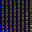

Road work::Speed limit (80km/h)


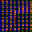

Right-of-way at the next intersection::Beware of ice/snow


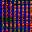

Keep right::Roundabout mandatory


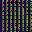

Speed limit (120km/h)::Speed limit (80km/h)


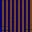

Keep right::Speed limit (60km/h)


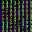

Priority road::End of all speed and passing limits


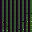

Road work::Dangerous curve to the right


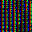

Right-of-way at the next intersection::Children crossing


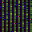

Stop::Speed limit (80km/h)


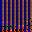

Speed limit (100km/h)::Speed limit (120km/h)


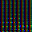

Speed limit (100km/h)::Speed limit (120km/h)


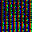

Yield::Speed limit (50km/h)


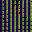

Road work::Road narrows on the right


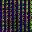

Keep right::Bicycles crossing


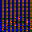

Speed limit (30km/h)::Speed limit (80km/h)


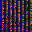

Priority road::General caution


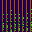

Speed limit (120km/h)::Speed limit (30km/h)


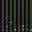

Speed limit (100km/h)::Speed limit (80km/h)


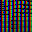

General caution::End of all speed and passing limits


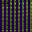

End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


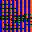

No entry::Speed limit (70km/h)


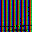

End of all speed and passing limits::End of speed limit (80km/h)


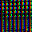

Speed limit (100km/h)::Wild animals crossing


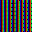

Wild animals crossing::Speed limit (80km/h)


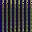

Speed limit (80km/h)::Speed limit (30km/h)


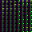

Pedestrians::Right-of-way at the next intersection


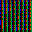

Double curve::Dangerous curve to the left


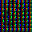

Speed limit (70km/h)::Speed limit (20km/h)


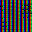

Speed limit (70km/h)::Speed limit (60km/h)


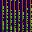

Speed limit (120km/h)::Speed limit (100km/h)


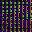

Ahead only::Yield


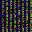

Speed limit (120km/h)::End of all speed and passing limits


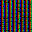

Children crossing::No vehicles


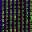

Right-of-way at the next intersection::General caution


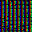

Speed limit (50km/h)::Dangerous curve to the right


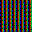

Priority road::Wild animals crossing


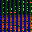

Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


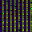

No passing::No vehicles


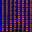

Road work::General caution


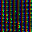

Speed limit (50km/h)::Speed limit (100km/h)


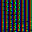

Speed limit (30km/h)::No passing


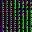

Dangerous curve to the right::Speed limit (120km/h)


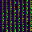

No vehicles::No passing


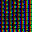

Speed limit (30km/h)::Speed limit (20km/h)


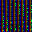

Speed limit (50km/h)::Speed limit (70km/h)


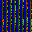

Double curve::Road work


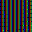

Right-of-way at the next intersection::Slippery road


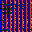

Wild animals crossing::Bicycles crossing


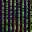

Speed limit (50km/h)::Speed limit (80km/h)


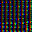

Road work::Bicycles crossing


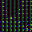

Turn right ahead::Keep right


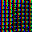

Traffic signals::Wild animals crossing


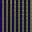

Speed limit (80km/h)::Speed limit (60km/h)


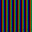

Speed limit (60km/h)::Ahead only


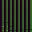

Speed limit (80km/h)::Speed limit (50km/h)


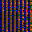

Right-of-way at the next intersection::Children crossing


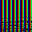

Speed limit (120km/h)::Speed limit (60km/h)


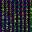

Speed limit (70km/h)::Roundabout mandatory


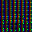

Stop::Bumpy road


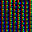

Road narrows on the right::Speed limit (50km/h)


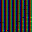

Traffic signals::General caution


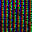

Speed limit (50km/h)::Speed limit (30km/h)


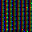

Right-of-way at the next intersection::General caution


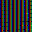

Right-of-way at the next intersection::Slippery road


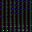

Speed limit (60km/h)::No vehicles


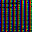

Yield::Priority road


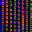

Right-of-way at the next intersection::Speed limit (80km/h)


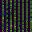

Ahead only::Turn left ahead


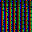

Keep right::Go straight or right


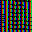

Wild animals crossing::General caution


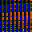

Speed limit (30km/h)::Speed limit (80km/h)


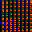

Speed limit (60km/h)::Keep right


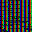

Speed limit (50km/h)::Speed limit (60km/h)


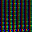

End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


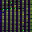

Speed limit (70km/h)::No passing


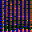

Road work::Speed limit (70km/h)


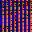

No passing for vehicles over 3.5 metric tons::Turn left ahead


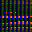

Speed limit (30km/h)::Bumpy road


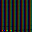

Speed limit (120km/h)::Speed limit (80km/h)


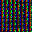

Speed limit (50km/h)::Speed limit (100km/h)


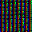

Priority road::Children crossing


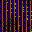

Slippery road::Road narrows on the right


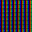

Speed limit (120km/h)::Speed limit (100km/h)


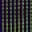

Ahead only::Keep right


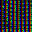

Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


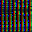

Speed limit (20km/h)::Speed limit (50km/h)


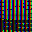

Yield::Wild animals crossing


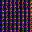

Speed limit (100km/h)::Speed limit (120km/h)


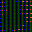

Priority road::Speed limit (70km/h)


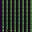

Speed limit (120km/h)::Speed limit (80km/h)


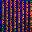

Priority road::Wild animals crossing


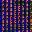

Speed limit (80km/h)::Speed limit (70km/h)


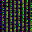

General caution::Traffic signals


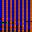

Speed limit (80km/h)::End of speed limit (80km/h)


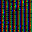

Turn left ahead::Ahead only


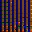

Speed limit (60km/h)::Speed limit (120km/h)


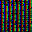

No passing::General caution


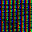

Speed limit (80km/h)::Speed limit (60km/h)


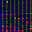

Go straight or right::Roundabout mandatory


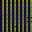

Speed limit (70km/h)::Speed limit (100km/h)


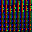

Speed limit (30km/h)::Yield


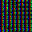

Keep right::Speed limit (50km/h)


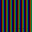

Dangerous curve to the right::Road work


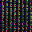

Dangerous curve to the left::Speed limit (70km/h)


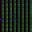

Beware of ice/snow::Speed limit (80km/h)


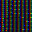

Right-of-way at the next intersection::General caution


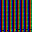

Turn right ahead::Ahead only


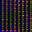

Speed limit (70km/h)::Speed limit (100km/h)


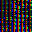

Keep right::Speed limit (70km/h)


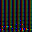

Speed limit (100km/h)::Speed limit (120km/h)


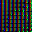

Pedestrians::Bumpy road


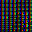

Right-of-way at the next intersection::General caution


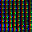

Speed limit (120km/h)::Speed limit (70km/h)


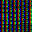

Right-of-way at the next intersection::Beware of ice/snow


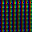

Speed limit (120km/h)::Speed limit (100km/h)


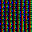

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


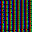

No vehicles::Speed limit (100km/h)


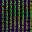

Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


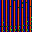

End of speed limit (80km/h)::Speed limit (80km/h)


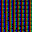

Road work::Dangerous curve to the left


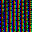

Speed limit (30km/h)::Speed limit (80km/h)


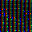

Bumpy road::Pedestrians


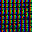

Keep right::Ahead only


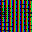

Wild animals crossing::General caution


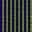

Speed limit (100km/h)::Speed limit (80km/h)


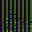

Speed limit (100km/h)::Speed limit (80km/h)


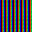

Turn right ahead::General caution


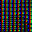

Right-of-way at the next intersection::General caution


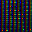

Speed limit (50km/h)::Speed limit (70km/h)


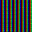

Wild animals crossing::Road work


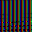

Keep right::Turn left ahead


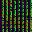

Speed limit (30km/h)::Speed limit (100km/h)


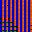

Wild animals crossing::General caution


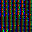

Speed limit (30km/h)::Speed limit (70km/h)


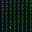

Speed limit (70km/h)::Go straight or right


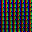

Speed limit (80km/h)::No vehicles


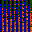

Speed limit (120km/h)::Speed limit (100km/h)


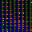

Speed limit (50km/h)::Speed limit (30km/h)


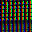

Speed limit (100km/h)::Speed limit (30km/h)


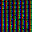

Road work::Right-of-way at the next intersection


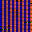

Speed limit (70km/h)::Dangerous curve to the left


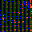

Keep right::No vehicles


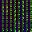

Stop::No passing for vehicles over 3.5 metric tons


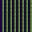

No passing for vehicles over 3.5 metric tons::Road work


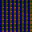

Keep right::Priority road


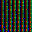

Roundabout mandatory::Speed limit (70km/h)


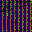

No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


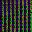

Double curve::Dangerous curve to the left


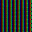

Speed limit (80km/h)::Speed limit (120km/h)


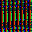

Speed limit (60km/h)::No passing


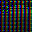

Traffic signals::Speed limit (50km/h)


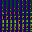

Speed limit (120km/h)::Speed limit (80km/h)


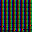

Speed limit (100km/h)::Speed limit (120km/h)


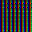

Speed limit (100km/h)::Speed limit (80km/h)


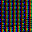

No passing::No vehicles


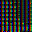

Slippery road::Priority road


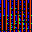

Priority road::General caution


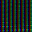

Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


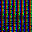

Stop::Speed limit (80km/h)


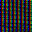

No passing::Speed limit (50km/h)


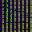

No passing for vehicles over 3.5 metric tons::Speed limit (20km/h)


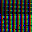

Speed limit (30km/h)::Speed limit (100km/h)


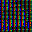

Speed limit (60km/h)::Speed limit (80km/h)


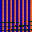

Speed limit (80km/h)::Speed limit (70km/h)


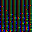

Speed limit (70km/h)::Speed limit (60km/h)


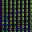

Speed limit (100km/h)::Speed limit (120km/h)


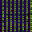

Road work::Speed limit (50km/h)


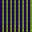

Speed limit (60km/h)::Wild animals crossing


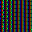

Right-of-way at the next intersection::General caution


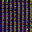

Right-of-way at the next intersection::Dangerous curve to the left


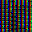

Road work::General caution


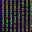

Speed limit (70km/h)::Right-of-way at the next intersection


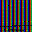

End of all speed and passing limits::End of speed limit (80km/h)


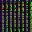

Go straight or right::Speed limit (50km/h)


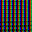

Keep right::Go straight or left


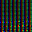

Speed limit (80km/h)::Speed limit (70km/h)


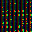

Speed limit (70km/h)::Go straight or right


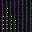

Priority road::Speed limit (50km/h)


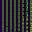

Road work::Dangerous curve to the left


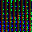

Speed limit (80km/h)::Speed limit (30km/h)


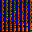

Speed limit (70km/h)::End of all speed and passing limits


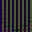

Turn right ahead::Speed limit (60km/h)


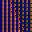

Speed limit (120km/h)::Speed limit (70km/h)


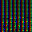

Speed limit (80km/h)::Speed limit (70km/h)


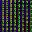

General caution::Speed limit (100km/h)


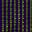

Road work::General caution


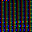

Speed limit (70km/h)::Speed limit (30km/h)


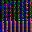

Slippery road::Speed limit (80km/h)


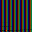

Keep right::Speed limit (60km/h)


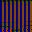

Keep right::Ahead only


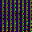

Priority road::Speed limit (60km/h)


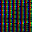

Slippery road::Children crossing


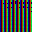

End of speed limit (80km/h)::Speed limit (60km/h)


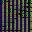

Speed limit (50km/h)::Speed limit (70km/h)


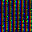

Slippery road::Bicycles crossing


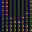

Turn right ahead::No passing for vehicles over 3.5 metric tons


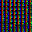

Keep right::Speed limit (80km/h)


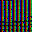

Speed limit (50km/h)::Speed limit (80km/h)


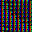

No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


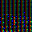

Bumpy road::Pedestrians


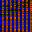

No passing::Speed limit (50km/h)


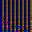

Speed limit (120km/h)::Speed limit (80km/h)


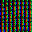

Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


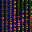

Right-of-way at the next intersection::Children crossing


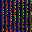

Speed limit (70km/h)::Speed limit (80km/h)


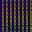

No passing::Speed limit (80km/h)


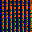

No vehicles::Speed limit (50km/h)


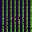

Keep left::Dangerous curve to the right


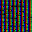

Speed limit (80km/h)::Speed limit (60km/h)


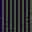

Dangerous curve to the right::Slippery road


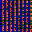

Priority road::Keep right


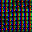

Speed limit (60km/h)::End of speed limit (80km/h)


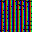

Road work::Road narrows on the right


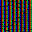

Children crossing::General caution


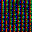

Dangerous curve to the left::Speed limit (70km/h)


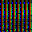

Speed limit (30km/h)::Speed limit (50km/h)


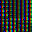

Slippery road::Road narrows on the right


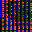

End of no passing by vehicles over 3.5 metric tons::Speed limit (20km/h)


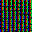

Speed limit (120km/h)::Speed limit (100km/h)


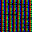

Road work::Speed limit (50km/h)


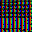

Speed limit (30km/h)::Speed limit (100km/h)


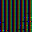

Road work::Dangerous curve to the right


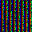

Speed limit (30km/h)::Speed limit (50km/h)


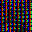

Traffic signals::Children crossing


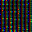

Bumpy road::Slippery road


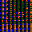

Yield::Speed limit (70km/h)


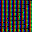

Speed limit (50km/h)::No vehicles


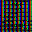

End of all speed and passing limits::End of no passing


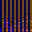

Speed limit (70km/h)::Speed limit (60km/h)


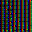

Speed limit (60km/h)::Speed limit (80km/h)


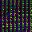

Keep right::End of no passing


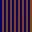

Speed limit (100km/h)::Speed limit (60km/h)


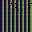

Yield::No vehicles


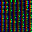

Vehicles over 3.5 metric tons prohibited::Yield


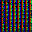

Keep right::Speed limit (80km/h)


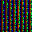

Speed limit (70km/h)::Speed limit (20km/h)


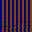

Keep right::Turn left ahead


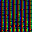

Speed limit (50km/h)::Speed limit (80km/h)


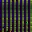

No passing for vehicles over 3.5 metric tons::No passing


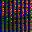

Turn left ahead::Keep right


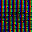

Speed limit (80km/h)::Speed limit (30km/h)


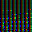

Speed limit (70km/h)::Speed limit (120km/h)


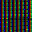

Right-of-way at the next intersection::General caution


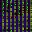

Speed limit (30km/h)::Speed limit (80km/h)


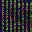

Speed limit (100km/h)::Speed limit (80km/h)


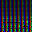

Keep right::Go straight or right


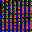

Speed limit (50km/h)::Speed limit (60km/h)


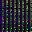

Keep right::No vehicles


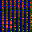

Speed limit (30km/h)::Speed limit (100km/h)


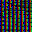

Beware of ice/snow::Traffic signals


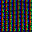

No vehicles::No passing


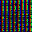

Speed limit (20km/h)::No vehicles


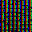

Speed limit (70km/h)::Speed limit (30km/h)


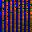

Wild animals crossing::Speed limit (70km/h)


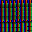

Beware of ice/snow::Speed limit (80km/h)


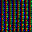

Keep right::Go straight or right


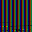

Speed limit (100km/h)::Speed limit (50km/h)


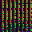

Bicycles crossing::Road work


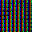

Go straight or left::Speed limit (60km/h)


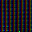

Dangerous curve to the left::Bicycles crossing


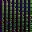

Slippery road::Beware of ice/snow


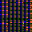

Slippery road::Children crossing


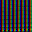

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


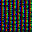

Dangerous curve to the left::Speed limit (70km/h)


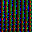

Keep right::Vehicles over 3.5 metric tons prohibited


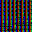

End of no passing by vehicles over 3.5 metric tons::End of no passing


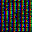

Dangerous curve to the left::Speed limit (70km/h)


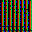

No vehicles::Speed limit (80km/h)


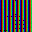

No passing::No vehicles


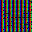

Speed limit (60km/h)::No passing


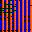

Speed limit (60km/h)::Speed limit (50km/h)


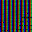

Beware of ice/snow::General caution


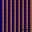

General caution::Dangerous curve to the right


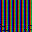

Wild animals crossing::General caution


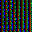

Ahead only::Priority road


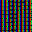

Roundabout mandatory::Go straight or right


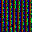

Ahead only::End of no passing


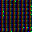

Priority road::No vehicles


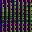

End of speed limit (80km/h)::Yield


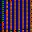

No vehicles::No passing


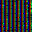

Bumpy road::Road work


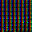

No passing for vehicles over 3.5 metric tons::No passing


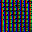

Speed limit (120km/h)::Double curve


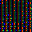

Road narrows on the right::Dangerous curve to the right


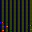

Road work::General caution


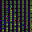

Speed limit (60km/h)::Speed limit (80km/h)


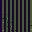

Beware of ice/snow::Dangerous curve to the left


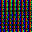

End of speed limit (80km/h)::Speed limit (60km/h)


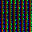

General caution::Pedestrians


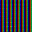

Priority road::Yield


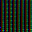

Beware of ice/snow::Speed limit (80km/h)


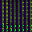

Stop::No passing for vehicles over 3.5 metric tons


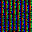

Speed limit (50km/h)::Speed limit (60km/h)


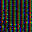

Ahead only::Speed limit (80km/h)


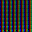

No passing for vehicles over 3.5 metric tons::No passing


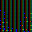

Slippery road::Dangerous curve to the right


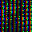

End of no passing by vehicles over 3.5 metric tons::End of no passing


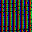

Speed limit (50km/h)::Speed limit (60km/h)


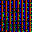

Speed limit (70km/h)::Speed limit (100km/h)


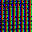

Priority road::No passing for vehicles over 3.5 metric tons


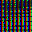

Keep right::Speed limit (50km/h)


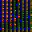

Yield::Dangerous curve to the right


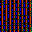

Speed limit (70km/h)::Speed limit (100km/h)


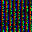

Pedestrians::Slippery road


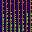

End of speed limit (80km/h)::Speed limit (80km/h)


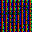

Speed limit (70km/h)::Beware of ice/snow


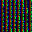

Speed limit (70km/h)::Speed limit (80km/h)


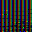

Speed limit (50km/h)::Speed limit (60km/h)


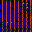

Speed limit (70km/h)::Speed limit (100km/h)


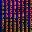

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


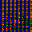

Speed limit (30km/h)::Keep right


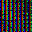

Keep right::Roundabout mandatory


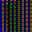

Road work::No entry


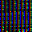

Speed limit (30km/h)::Speed limit (50km/h)


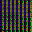

Double curve::Dangerous curve to the left


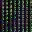

Stop::No passing for vehicles over 3.5 metric tons


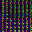

Right-of-way at the next intersection::General caution


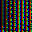

Children crossing::Speed limit (30km/h)


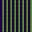

No passing for vehicles over 3.5 metric tons::Road work


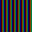

Keep right::Speed limit (60km/h)


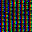

Ahead only::Yield


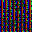

Speed limit (70km/h)::Speed limit (100km/h)


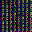

No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


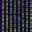

Road work::Speed limit (50km/h)


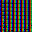

Traffic signals::Children crossing


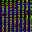

Speed limit (30km/h)::Speed limit (50km/h)


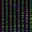

Speed limit (70km/h)::Speed limit (30km/h)


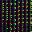

Priority road::Right-of-way at the next intersection


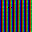

Speed limit (50km/h)::Go straight or right


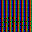

No entry::Road work


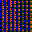

Speed limit (70km/h)::Wild animals crossing


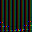

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


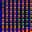

No entry::Priority road


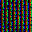

Speed limit (70km/h)::Speed limit (30km/h)


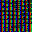

Speed limit (70km/h)::Speed limit (30km/h)


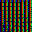

No vehicles::Speed limit (50km/h)


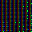

Dangerous curve to the left::Slippery road


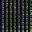

Speed limit (70km/h)::Speed limit (60km/h)


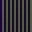

Speed limit (60km/h)::Speed limit (50km/h)


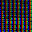

No passing::Speed limit (50km/h)


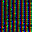

Stop::Speed limit (60km/h)


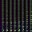

Speed limit (60km/h)::Speed limit (80km/h)


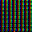

Speed limit (100km/h)::Speed limit (60km/h)


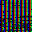

Speed limit (50km/h)::Speed limit (100km/h)


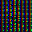

No entry::Stop


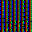

No passing::Speed limit (30km/h)


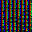

Priority road::Turn left ahead


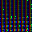

Speed limit (80km/h)::Speed limit (60km/h)


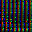

Keep right::End of no passing


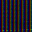

End of speed limit (80km/h)::End of all speed and passing limits


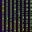

No vehicles::Speed limit (70km/h)


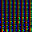

Speed limit (80km/h)::Speed limit (60km/h)


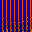

End of speed limit (80km/h)::Beware of ice/snow


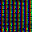

Speed limit (70km/h)::Speed limit (60km/h)


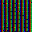

Slippery road::Double curve


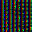

Road work::Roundabout mandatory


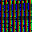

Go straight or left::Keep left


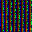

Speed limit (50km/h)::Speed limit (70km/h)


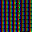

General caution::Bumpy road


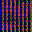

Double curve::Dangerous curve to the left


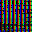

Yield::Wild animals crossing


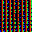

Priority road::Speed limit (70km/h)


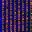

Double curve::Slippery road


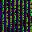

Road work::Road narrows on the right


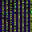

Double curve::Dangerous curve to the left


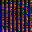

Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


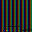

Speed limit (100km/h)::No vehicles


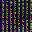

Speed limit (70km/h)::Wild animals crossing


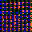

Bumpy road::Slippery road


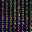

No passing::No passing for vehicles over 3.5 metric tons


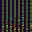

Speed limit (50km/h)::Vehicles over 3.5 metric tons prohibited


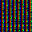

No passing::No vehicles


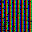

Road work::Road narrows on the right


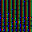

Speed limit (60km/h)::Speed limit (30km/h)


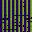

No entry::Speed limit (70km/h)


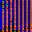

Speed limit (50km/h)::Speed limit (80km/h)


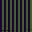

Speed limit (100km/h)::Speed limit (60km/h)


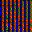

Road work::General caution


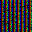

Speed limit (30km/h)::Speed limit (70km/h)


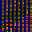

General caution::Road work


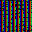

Road work::Slippery road


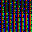

Speed limit (100km/h)::Speed limit (120km/h)


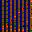

Speed limit (60km/h)::Speed limit (120km/h)


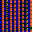

Keep right::Priority road


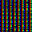

No passing::No vehicles


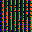

Speed limit (50km/h)::Speed limit (70km/h)


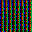

Double curve::Wild animals crossing


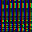

Speed limit (80km/h)::Speed limit (60km/h)


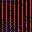

Slippery road::Road narrows on the right


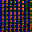

Keep right::Go straight or right


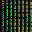

Stop::Speed limit (100km/h)


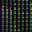

Speed limit (60km/h)::Speed limit (70km/h)


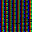

Children crossing::Bumpy road


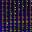

Speed limit (30km/h)::Speed limit (50km/h)


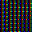

Turn left ahead::Speed limit (80km/h)


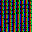

Dangerous curve to the right::Children crossing


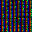

Turn right ahead::Roundabout mandatory


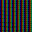

Priority road::Speed limit (30km/h)


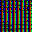

Priority road::No passing for vehicles over 3.5 metric tons


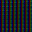

Speed limit (70km/h)::Go straight or right


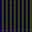

No passing for vehicles over 3.5 metric tons::End of speed limit (80km/h)


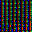

Ahead only::Speed limit (120km/h)


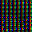

Slippery road::Speed limit (120km/h)


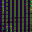

End of no passing by vehicles over 3.5 metric tons::Priority road


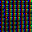

Road work::Children crossing


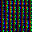

Right-of-way at the next intersection::Pedestrians


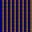

Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


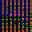

No vehicles::No passing for vehicles over 3.5 metric tons


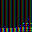

Wild animals crossing::General caution


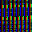

Speed limit (30km/h)::Speed limit (80km/h)


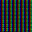

General caution::Slippery road


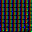

Right-of-way at the next intersection::Children crossing


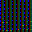

Slippery road::Wild animals crossing


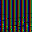

Stop::Speed limit (120km/h)


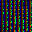

General caution::No vehicles


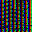

Speed limit (30km/h)::Speed limit (80km/h)


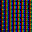

Speed limit (60km/h)::Speed limit (20km/h)


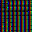

General caution::Wild animals crossing


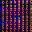

Turn right ahead::End of no passing


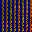

Keep left::Keep right


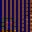

Road work::Wild animals crossing


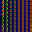

Right-of-way at the next intersection::General caution


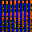

Speed limit (30km/h)::Speed limit (80km/h)


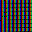

Speed limit (70km/h)::Speed limit (100km/h)


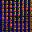

Stop::Bumpy road


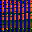

Speed limit (80km/h)::Speed limit (30km/h)


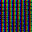

Speed limit (30km/h)::Speed limit (50km/h)


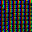

Roundabout mandatory::Turn right ahead


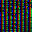

Dangerous curve to the left::General caution


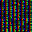

Speed limit (50km/h)::Speed limit (100km/h)


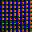

Keep right::Yield


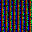

Slippery road::Right-of-way at the next intersection


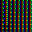

Right-of-way at the next intersection::General caution


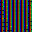

Children crossing::No passing for vehicles over 3.5 metric tons


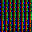

Keep right::Priority road


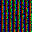

Speed limit (30km/h)::Speed limit (70km/h)


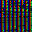

Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


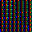

Ahead only::Keep right


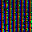

Slippery road::Bicycles crossing


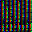

Road work::Speed limit (30km/h)


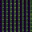

Keep right::Road work


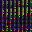

Speed limit (30km/h)::Yield


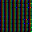

Speed limit (70km/h)::Speed limit (60km/h)


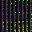

Speed limit (50km/h)::Speed limit (80km/h)


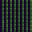

General caution::Slippery road


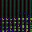

Speed limit (100km/h)::End of all speed and passing limits


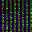

Speed limit (70km/h)::Speed limit (80km/h)


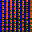

General caution::Speed limit (100km/h)


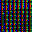

Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


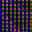

Speed limit (60km/h)::Speed limit (80km/h)


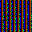

Priority road::No vehicles


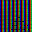

Beware of ice/snow::Bicycles crossing


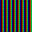

General caution::Dangerous curve to the right


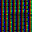

Right-of-way at the next intersection::General caution


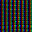

No passing::Wild animals crossing


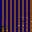

Road work::Slippery road


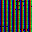

Speed limit (120km/h)::Speed limit (100km/h)


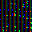

No passing::Priority road


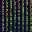

Speed limit (70km/h)::Speed limit (120km/h)


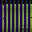

Wild animals crossing::Speed limit (120km/h)


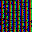

Road narrows on the right::Bicycles crossing


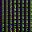

Road work::Roundabout mandatory


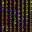

Priority road::No vehicles


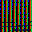

Speed limit (50km/h)::Speed limit (60km/h)


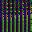

Slippery road::Speed limit (80km/h)


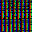

Yield::End of all speed and passing limits


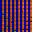

General caution::Traffic signals


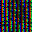

Roundabout mandatory::End of all speed and passing limits


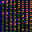

Right-of-way at the next intersection::General caution


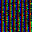

Double curve::Slippery road


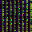

No vehicles::Speed limit (80km/h)


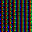

Priority road::Speed limit (80km/h)


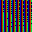

End of speed limit (80km/h)::Speed limit (80km/h)


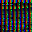

Speed limit (50km/h)::Speed limit (20km/h)


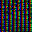

Dangerous curve to the left::Road work


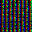

Speed limit (70km/h)::Speed limit (30km/h)


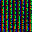

Speed limit (30km/h)::Speed limit (60km/h)


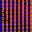

Keep right::Speed limit (100km/h)


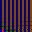

Turn right ahead::Speed limit (60km/h)


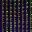

Speed limit (50km/h)::Vehicles over 3.5 metric tons prohibited


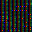

Road narrows on the right::Road work


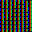

Go straight or right::Dangerous curve to the right


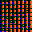

Wild animals crossing::General caution


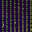

Dangerous curve to the right::Slippery road


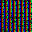

Keep right::Go straight or right


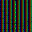

Priority road::Speed limit (50km/h)


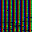

Speed limit (100km/h)::Speed limit (120km/h)


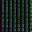

No passing::No passing for vehicles over 3.5 metric tons


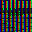

Speed limit (30km/h)::Speed limit (80km/h)


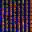

Keep right::Turn left ahead


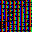

Speed limit (30km/h)::Speed limit (100km/h)


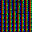

No passing::No vehicles


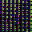

Keep right::Turn left ahead


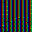

Turn right ahead::Speed limit (70km/h)


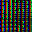

General caution::Bicycles crossing


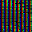

Speed limit (30km/h)::Speed limit (50km/h)


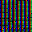

Speed limit (60km/h)::Speed limit (120km/h)


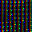

Road work::Speed limit (80km/h)


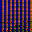

Speed limit (100km/h)::Speed limit (80km/h)


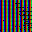

Beware of ice/snow::Children crossing


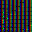

General caution::Speed limit (60km/h)


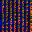

Ahead only::Beware of ice/snow


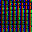

Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


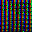

No entry::Speed limit (100km/h)


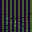

No passing::Speed limit (120km/h)


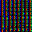

No vehicles::Speed limit (60km/h)


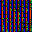

No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


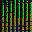

Speed limit (50km/h)::Speed limit (60km/h)


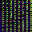

General caution::Right-of-way at the next intersection


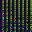

Speed limit (100km/h)::Speed limit (60km/h)


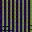

Wild animals crossing::General caution


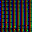

Speed limit (30km/h)::Speed limit (70km/h)


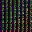

Ahead only::Speed limit (120km/h)


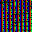

No passing for vehicles over 3.5 metric tons::No vehicles


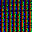

No vehicles::General caution


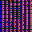

No passing for vehicles over 3.5 metric tons::Beware of ice/snow


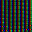

Priority road::End of speed limit (80km/h)


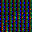

Speed limit (70km/h)::Speed limit (120km/h)


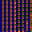

General caution::Yield


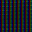

Speed limit (70km/h)::Go straight or right


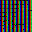

Priority road::Speed limit (50km/h)


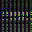

Speed limit (30km/h)::Bumpy road


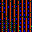

Slippery road::Road narrows on the right


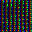

Keep right::End of no passing


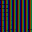

Dangerous curve to the right::Road work


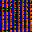

Road work::Dangerous curve to the left


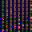

General caution::Road work


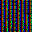

Bicycles crossing::General caution


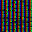

Speed limit (50km/h)::Speed limit (60km/h)


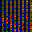

Priority road::Speed limit (80km/h)


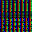

Speed limit (20km/h)::Speed limit (120km/h)


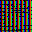

Speed limit (60km/h)::Speed limit (50km/h)


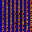

Priority road::Speed limit (80km/h)


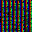

Speed limit (20km/h)::Keep right


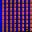

Speed limit (70km/h)::Speed limit (80km/h)


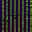

No vehicles::No passing


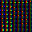

General caution::Keep right


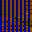

Speed limit (30km/h)::Speed limit (50km/h)


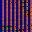

Speed limit (100km/h)::Speed limit (80km/h)


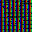

Beware of ice/snow::Speed limit (80km/h)


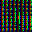

Speed limit (30km/h)::Speed limit (80km/h)


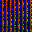

Ahead only::End of no passing


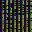

Speed limit (100km/h)::Speed limit (50km/h)


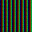

No passing for vehicles over 3.5 metric tons::Wild animals crossing


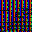

Speed limit (30km/h)::Speed limit (80km/h)


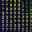

Speed limit (120km/h)::Speed limit (80km/h)


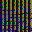

Speed limit (120km/h)::Speed limit (100km/h)


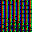

Speed limit (50km/h)::Speed limit (80km/h)


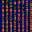

No passing::Speed limit (60km/h)


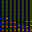

Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


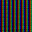

Keep right::Ahead only


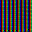

Vehicles over 3.5 metric tons prohibited::Speed limit (80km/h)


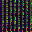

Yield::Go straight or right


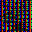

Traffic signals::Children crossing


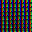

Speed limit (80km/h)::No vehicles


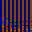

Speed limit (70km/h)::Speed limit (60km/h)


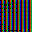

Speed limit (50km/h)::No vehicles


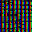

Yield::Bumpy road


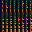

Speed limit (60km/h)::Yield


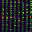

Speed limit (50km/h)::Speed limit (80km/h)


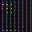

Priority road::No passing


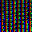

Children crossing::Road work


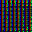

No vehicles::Wild animals crossing


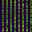

Speed limit (30km/h)::Speed limit (50km/h)


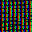

Speed limit (80km/h)::Speed limit (60km/h)


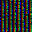

Speed limit (70km/h)::Speed limit (80km/h)


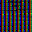

No passing::Speed limit (50km/h)


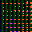

Wild animals crossing::General caution


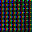

Speed limit (70km/h)::Children crossing


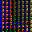

Speed limit (30km/h)::Speed limit (50km/h)


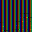

General caution::Slippery road


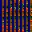

Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


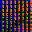

Keep right::Yield


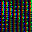

End of no passing by vehicles over 3.5 metric tons::End of no passing


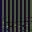

No passing::Speed limit (120km/h)


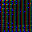

Speed limit (70km/h)::Speed limit (100km/h)


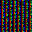

No passing::Speed limit (60km/h)


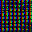

Slippery road::General caution


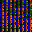

Ahead only::Speed limit (120km/h)


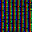

Stop::No passing


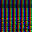

Speed limit (60km/h)::Speed limit (50km/h)


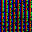

Ahead only::Speed limit (120km/h)


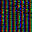

Turn left ahead::Ahead only


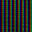

Priority road::Speed limit (50km/h)


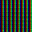

Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


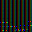

Speed limit (120km/h)::Speed limit (80km/h)


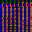

Speed limit (30km/h)::No vehicles


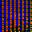

Road work::Double curve


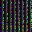

Speed limit (70km/h)::Speed limit (30km/h)


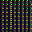

Right-of-way at the next intersection::General caution


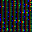

Keep right::No vehicles


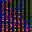

Speed limit (80km/h)::Speed limit (70km/h)


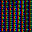

Keep right::Speed limit (80km/h)


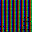

Beware of ice/snow::General caution


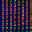

Speed limit (50km/h)::Right-of-way at the next intersection


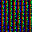

Speed limit (70km/h)::Speed limit (30km/h)


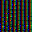

Ahead only::Turn left ahead


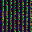

Speed limit (50km/h)::Speed limit (70km/h)


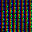

Stop::No vehicles


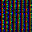

Traffic signals::End of all speed and passing limits


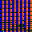

Keep right::Ahead only


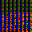

Keep right::Go straight or right


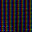

Dangerous curve to the left::Children crossing


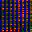

Speed limit (50km/h)::Speed limit (30km/h)


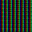

No passing for vehicles over 3.5 metric tons::Road work


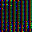

Ahead only::Go straight or left


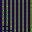

Children crossing::No passing for vehicles over 3.5 metric tons


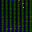

No passing::Priority road


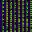

Keep right::End of no passing


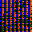

Speed limit (60km/h)::Speed limit (80km/h)


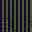

Road work::Wild animals crossing


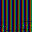

No entry::Speed limit (60km/h)


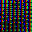

Keep right::Turn left ahead


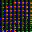

Wild animals crossing::Speed limit (120km/h)


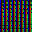

End of speed limit (80km/h)::Bumpy road


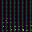

End of no passing::End of all speed and passing limits


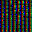

Turn left ahead::Ahead only


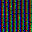

Roundabout mandatory::Speed limit (70km/h)


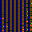

Right-of-way at the next intersection::Road work


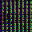

Speed limit (50km/h)::Double curve


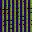

Priority road::Go straight or right


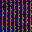

No passing for vehicles over 3.5 metric tons::Roundabout mandatory


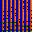

Speed limit (80km/h)::Speed limit (70km/h)


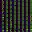

Ahead only::Turn left ahead


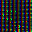

Speed limit (50km/h)::Speed limit (100km/h)


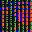

Right-of-way at the next intersection::Double curve


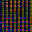

Roundabout mandatory::Speed limit (80km/h)


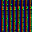

Speed limit (50km/h)::Speed limit (20km/h)


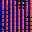

Road work::Road narrows on the right


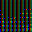

Speed limit (70km/h)::Speed limit (60km/h)


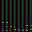

Speed limit (100km/h)::Speed limit (80km/h)


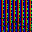

Speed limit (120km/h)::Speed limit (80km/h)


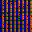

Beware of ice/snow::Speed limit (80km/h)


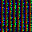

Speed limit (50km/h)::No passing


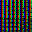

General caution::Speed limit (100km/h)


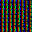

No vehicles::General caution


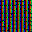

Road work::Road narrows on the right


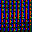

Priority road::Speed limit (70km/h)


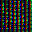

Yield::Speed limit (70km/h)


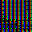

Yield::Wild animals crossing


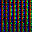

Keep right::Turn right ahead


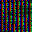

Speed limit (70km/h)::Speed limit (100km/h)


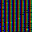

General caution::Right-of-way at the next intersection


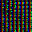

Speed limit (50km/h)::Speed limit (30km/h)


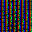

Bicycles crossing::General caution


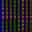

Wild animals crossing::Pedestrians


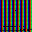

Speed limit (80km/h)::Speed limit (60km/h)


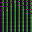

Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


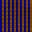

Bumpy road::General caution


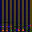

Speed limit (100km/h)::Speed limit (120km/h)


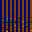

Speed limit (100km/h)::Speed limit (50km/h)


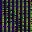

Speed limit (50km/h)::Speed limit (30km/h)


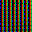

Keep right::Speed limit (100km/h)


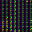

Bicycles crossing::Slippery road


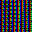

Priority road::Speed limit (80km/h)


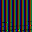

Speed limit (70km/h)::Speed limit (80km/h)


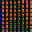

Stop::General caution


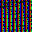

No passing for vehicles over 3.5 metric tons::Turn left ahead


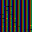

Children crossing::Traffic signals


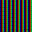

General caution::Dangerous curve to the right


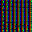

No vehicles::No passing


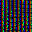

Bicycles crossing::General caution


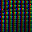

Dangerous curve to the left::General caution


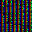

Yield::No vehicles


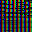

General caution::Bumpy road


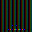

No passing for vehicles over 3.5 metric tons::Road work


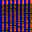

No vehicles::Speed limit (50km/h)


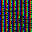

Speed limit (60km/h)::Speed limit (20km/h)


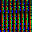

Speed limit (30km/h)::Speed limit (50km/h)


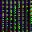

Vehicles over 3.5 metric tons prohibited::Speed limit (60km/h)


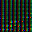

Speed limit (100km/h)::Speed limit (120km/h)


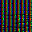

No entry::Bumpy road


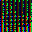

Speed limit (50km/h)::Dangerous curve to the left


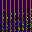

Speed limit (120km/h)::Speed limit (80km/h)


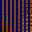

Road work::Dangerous curve to the left


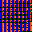

No entry::Speed limit (70km/h)


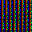

Speed limit (50km/h)::Speed limit (30km/h)


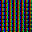

Go straight or left::General caution


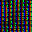

No entry::Speed limit (50km/h)


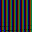

Turn right ahead::Speed limit (60km/h)


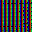

Speed limit (120km/h)::Speed limit (100km/h)


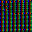

No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


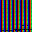

Turn right ahead::General caution


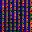

Speed limit (50km/h)::Speed limit (100km/h)


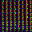

End of no passing by vehicles over 3.5 metric tons::End of no passing


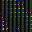

No passing for vehicles over 3.5 metric tons::Beware of ice/snow


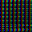

Speed limit (60km/h)::Speed limit (80km/h)


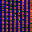

Ahead only::Go straight or left


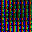

Right-of-way at the next intersection::Road narrows on the right


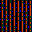

Slippery road::Road narrows on the right


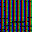

Speed limit (50km/h)::Speed limit (80km/h)


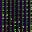

Speed limit (50km/h)::Speed limit (70km/h)


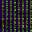

Keep left::Ahead only


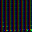

End of no passing::End of all speed and passing limits


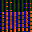

Yield::Speed limit (30km/h)


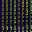

Speed limit (30km/h)::Speed limit (60km/h)


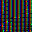

End of no passing by vehicles over 3.5 metric tons::Speed limit (50km/h)


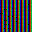

Priority road::Go straight or right


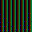

Priority road::Speed limit (50km/h)


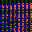

Speed limit (100km/h)::End of all speed and passing limits


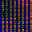

Speed limit (60km/h)::Speed limit (30km/h)


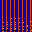

Speed limit (120km/h)::Speed limit (80km/h)


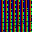

Speed limit (120km/h)::Speed limit (100km/h)


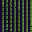

Slippery road::Road work


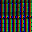

Beware of ice/snow::Speed limit (80km/h)


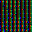

Roundabout mandatory::Speed limit (80km/h)


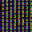

Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


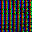

No entry::End of all speed and passing limits


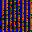

Speed limit (100km/h)::Speed limit (120km/h)


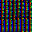

Go straight or left::Speed limit (70km/h)


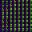

Speed limit (60km/h)::Speed limit (80km/h)


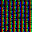

Speed limit (50km/h)::Speed limit (80km/h)


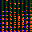

End of no passing::End of no passing by vehicles over 3.5 metric tons


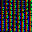

General caution::Bicycles crossing


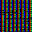

Road work::Speed limit (50km/h)


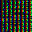

Stop::Speed limit (100km/h)


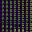

Speed limit (60km/h)::Yield


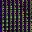

No passing for vehicles over 3.5 metric tons::Double curve


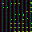

Wild animals crossing::General caution


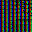

Keep right::Speed limit (50km/h)


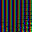

Road work::Speed limit (60km/h)


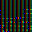

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


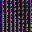

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


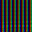

Yield::Keep right


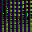

General caution::Keep right


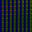

Speed limit (70km/h)::Go straight or right


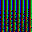

Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


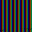

Dangerous curve to the right::Road work


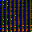

Speed limit (50km/h)::Speed limit (80km/h)


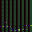

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


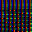

Ahead only::Yield


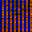

No passing::Speed limit (50km/h)


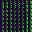

Priority road::Speed limit (80km/h)


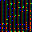

Speed limit (60km/h)::Speed limit (50km/h)


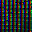

Dangerous curve to the left::General caution


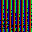

No passing::Speed limit (120km/h)


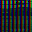

Speed limit (30km/h)::Priority road


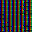

Right-of-way at the next intersection::Children crossing


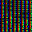

No vehicles::Speed limit (30km/h)


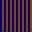

Dangerous curve to the right::Road work


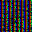

Bicycles crossing::General caution


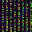

Pedestrians::Road narrows on the right


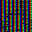

Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


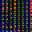

Keep right::Ahead only


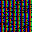

Road narrows on the right::Bicycles crossing


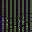

Stop::Speed limit (80km/h)


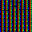

No passing::No vehicles


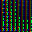

Speed limit (50km/h)::Speed limit (60km/h)


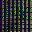

No entry::Speed limit (50km/h)


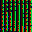

Speed limit (80km/h)::Speed limit (70km/h)


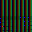

Speed limit (80km/h)::Speed limit (50km/h)


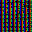

Right-of-way at the next intersection::Road work


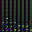

Speed limit (100km/h)::Speed limit (120km/h)


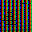

Keep right::Speed limit (100km/h)


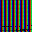

Speed limit (80km/h)::Speed limit (100km/h)


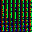

Speed limit (80km/h)::Speed limit (60km/h)


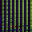

Speed limit (100km/h)::Speed limit (70km/h)


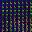

Speed limit (120km/h)::Speed limit (100km/h)


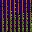

Keep right::Roundabout mandatory


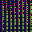

Speed limit (80km/h)::Speed limit (60km/h)


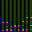

Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


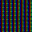

Keep right::Road work


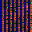

Stop::Turn right ahead


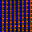

Speed limit (30km/h)::Speed limit (70km/h)


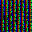

Road work::Road narrows on the right


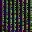

Priority road::Traffic signals


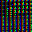

Speed limit (100km/h)::Wild animals crossing


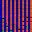

General caution::Traffic signals


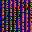

Road narrows on the right::Bicycles crossing


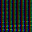

Speed limit (60km/h)::Speed limit (80km/h)


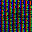

Speed limit (70km/h)::Speed limit (80km/h)


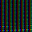

Speed limit (60km/h)::Road work


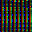

Speed limit (20km/h)::Speed limit (50km/h)


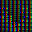

Speed limit (60km/h)::Speed limit (80km/h)


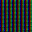

General caution::Slippery road


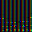

No passing::Speed limit (80km/h)


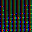

Speed limit (70km/h)::Speed limit (80km/h)


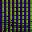

Keep right::Ahead only


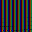

Keep right::Speed limit (60km/h)


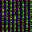

Speed limit (60km/h)::Speed limit (70km/h)


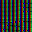

End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


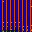

Speed limit (120km/h)::Speed limit (80km/h)


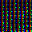

Priority road::End of all speed and passing limits


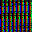

Speed limit (30km/h)::Speed limit (50km/h)


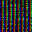

Ahead only::No vehicles


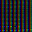

Speed limit (100km/h)::Speed limit (120km/h)


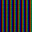

Speed limit (80km/h)::Speed limit (100km/h)


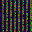

Speed limit (30km/h)::Speed limit (70km/h)


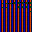

End of speed limit (80km/h)::Speed limit (80km/h)


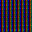

Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


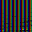

Dangerous curve to the right::General caution


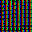

Speed limit (50km/h)::No passing


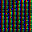

Wild animals crossing::Speed limit (80km/h)


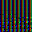

Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


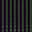

No passing for vehicles over 3.5 metric tons::End of speed limit (80km/h)


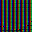

Speed limit (100km/h)::Speed limit (120km/h)


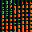

End of no passing::End of all speed and passing limits


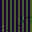

General caution::Slippery road


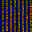

Road work::Speed limit (80km/h)


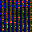

Speed limit (30km/h)::Speed limit (100km/h)


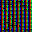

No entry::Speed limit (80km/h)


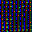

Speed limit (60km/h)::Speed limit (70km/h)


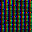

Wild animals crossing::Speed limit (80km/h)


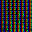

Speed limit (60km/h)::Keep right


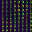

Turn right ahead::No vehicles


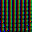

General caution::Wild animals crossing


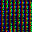

Stop::Dangerous curve to the left


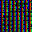

Beware of ice/snow::No passing for vehicles over 3.5 metric tons


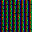

Road work::General caution


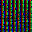

Stop::No passing


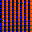

Keep right::Speed limit (100km/h)


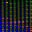

Speed limit (70km/h)::Speed limit (30km/h)


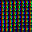

Speed limit (80km/h)::Speed limit (120km/h)


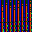

End of speed limit (80km/h)::Speed limit (80km/h)


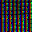

Priority road::Children crossing


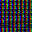

Keep right::Speed limit (50km/h)


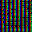

Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


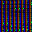

Speed limit (30km/h)::Speed limit (80km/h)


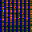

No passing::Speed limit (60km/h)


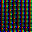

Speed limit (60km/h)::Speed limit (70km/h)


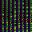

Speed limit (60km/h)::Speed limit (100km/h)


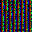

Speed limit (50km/h)::Speed limit (80km/h)


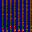

Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


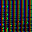

Speed limit (50km/h)::Speed limit (20km/h)


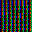

Double curve::Wild animals crossing


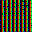

Go straight or right::Ahead only


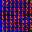

No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


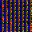

Priority road::Road work


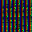

Speed limit (50km/h)::Speed limit (30km/h)


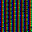

Children crossing::Bumpy road


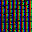

Yield::Speed limit (70km/h)


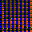

No passing::Speed limit (50km/h)


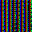

Road work::Road narrows on the right


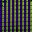

Keep right::Roundabout mandatory


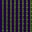

Speed limit (120km/h)::Speed limit (100km/h)


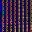

Keep left::Keep right


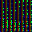

Speed limit (80km/h)::Speed limit (120km/h)


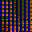

Slippery road::Road narrows on the right


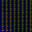

Dangerous curve to the left::Bicycles crossing


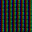

End of speed limit (80km/h)::Speed limit (80km/h)


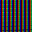

Speed limit (80km/h)::Speed limit (100km/h)


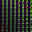

Speed limit (80km/h)::No vehicles


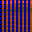

Speed limit (30km/h)::Speed limit (50km/h)


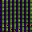

Speed limit (70km/h)::Speed limit (80km/h)


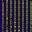

Double curve::Dangerous curve to the left


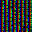

Beware of ice/snow::No passing for vehicles over 3.5 metric tons


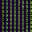

Speed limit (50km/h)::Speed limit (80km/h)


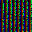

Speed limit (50km/h)::Speed limit (70km/h)


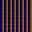

No passing for vehicles over 3.5 metric tons::Wild animals crossing


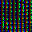

Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


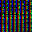

Go straight or right::Keep right


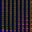

No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


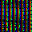

Speed limit (30km/h)::Speed limit (100km/h)


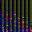

No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


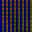

General caution::Slippery road


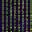

No vehicles::Speed limit (30km/h)


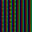

Priority road::Yield


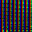

Yield::Keep right


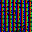

Road work::Slippery road


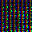

Priority road::Speed limit (70km/h)


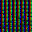

Speed limit (100km/h)::Speed limit (120km/h)


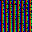

Priority road::Keep right


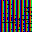

No entry::Priority road


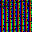

No passing for vehicles over 3.5 metric tons::Turn left ahead


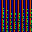

Speed limit (120km/h)::Speed limit (30km/h)


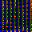

Speed limit (50km/h)::Speed limit (60km/h)


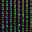

Speed limit (100km/h)::Speed limit (120km/h)


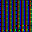

No passing::Speed limit (120km/h)


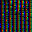

Turn left ahead::Turn right ahead


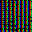

Dangerous curve to the right::Children crossing


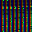

Speed limit (50km/h)::Speed limit (20km/h)


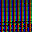

Keep right::Turn left ahead


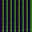

Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


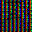

Priority road::Speed limit (60km/h)


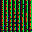

Speed limit (80km/h)::Speed limit (70km/h)


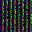

Speed limit (50km/h)::Speed limit (70km/h)


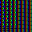

Right-of-way at the next intersection::General caution


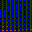

Speed limit (60km/h)::Speed limit (70km/h)


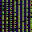

Traffic signals::Children crossing


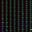

General caution::Bumpy road


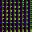

Speed limit (30km/h)::No passing


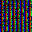

No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


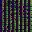

Priority road::End of speed limit (80km/h)


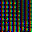

Slippery road::Road work


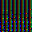

Speed limit (70km/h)::Speed limit (120km/h)


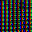

Speed limit (60km/h)::Speed limit (120km/h)


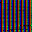

Turn right ahead::Ahead only


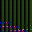

Speed limit (80km/h)::Speed limit (120km/h)


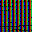

Speed limit (50km/h)::Speed limit (80km/h)


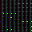

No passing::Speed limit (80km/h)


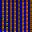

Road work::Speed limit (30km/h)


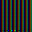

Speed limit (100km/h)::Speed limit (120km/h)


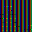

Children crossing::Bumpy road


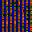

Stop::End of speed limit (80km/h)


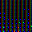

Speed limit (60km/h)::No vehicles


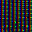

Speed limit (50km/h)::Speed limit (120km/h)


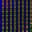

Keep right::Yield


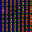

Priority road::General caution


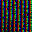

No passing::Speed limit (70km/h)


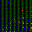

No passing::Priority road


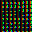

Wild animals crossing::General caution


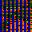

Traffic signals::Double curve


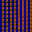

Road work::Dangerous curve to the left


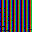

Wild animals crossing::General caution


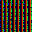

Bicycles crossing::Beware of ice/snow


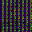

No entry::Stop


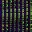

Speed limit (30km/h)::Speed limit (100km/h)


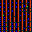

Slippery road::Road narrows on the right


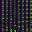

Speed limit (50km/h)::Speed limit (100km/h)


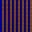

Speed limit (80km/h)::Speed limit (100km/h)


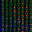

No passing::No passing for vehicles over 3.5 metric tons


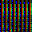

Speed limit (30km/h)::Speed limit (80km/h)


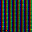

Priority road::Vehicles over 3.5 metric tons prohibited


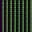

No passing for vehicles over 3.5 metric tons::Dangerous curve to the right


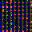

Road work::Bicycles crossing


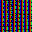

Beware of ice/snow::Wild animals crossing


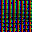

Speed limit (120km/h)::Speed limit (100km/h)


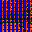

No entry::Priority road


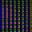

Keep right::Speed limit (50km/h)


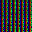

Keep left::Keep right


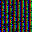

Speed limit (100km/h)::Speed limit (70km/h)


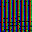

Speed limit (50km/h)::Speed limit (80km/h)


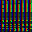

Speed limit (80km/h)::Speed limit (60km/h)


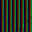

Priority road::Speed limit (50km/h)


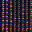

Keep right::Turn left ahead


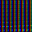

Speed limit (120km/h)::Speed limit (100km/h)


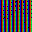

Speed limit (50km/h)::Go straight or right


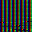

Speed limit (100km/h)::Speed limit (120km/h)


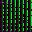

Priority road::End of all speed and passing limits


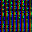

Speed limit (30km/h)::Speed limit (20km/h)


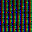

Ahead only::Speed limit (80km/h)


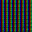

General caution::Slippery road


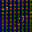

General caution::Speed limit (50km/h)


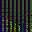

Speed limit (100km/h)::End of all speed and passing limits


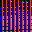

Speed limit (120km/h)::Speed limit (100km/h)


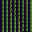

Speed limit (120km/h)::Speed limit (70km/h)


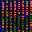

Speed limit (30km/h)::Speed limit (20km/h)


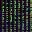

General caution::Right-of-way at the next intersection


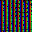

Speed limit (80km/h)::Speed limit (120km/h)


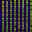

Go straight or right::End of all speed and passing limits


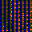

Road work::Dangerous curve to the left


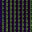

Right-of-way at the next intersection::Road narrows on the right


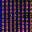

Ahead only::Keep right


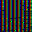

No vehicles::No passing


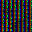

Speed limit (70km/h)::Speed limit (80km/h)


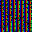

Speed limit (120km/h)::Speed limit (100km/h)


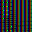

End of no passing by vehicles over 3.5 metric tons::End of no passing


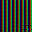

General caution::Dangerous curve to the right


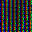

Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


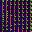

Road work::Speed limit (80km/h)


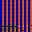

Speed limit (60km/h)::Speed limit (30km/h)


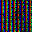

Keep right::Turn right ahead


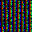

Beware of ice/snow::Traffic signals


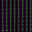

Dangerous curve to the left::Bicycles crossing


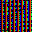

Priority road::General caution


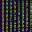

Road work::Bicycles crossing


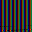

Keep right::Speed limit (60km/h)


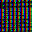

Road work::Children crossing


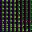

Turn left ahead::Roundabout mandatory


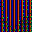

Priority road::Roundabout mandatory


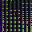

Keep right::Speed limit (70km/h)


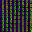

Speed limit (70km/h)::Right-of-way at the next intersection


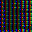

Priority road::Keep right


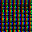

No vehicles::No passing for vehicles over 3.5 metric tons


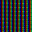

Slippery road::Yield


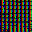

Speed limit (50km/h)::Speed limit (60km/h)


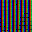

Beware of ice/snow::General caution


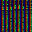

Speed limit (50km/h)::Speed limit (20km/h)


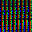

Speed limit (30km/h)::Speed limit (50km/h)


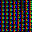

Traffic signals::Pedestrians


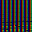

Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


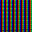

Speed limit (80km/h)::Speed limit (100km/h)


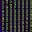

General caution::Speed limit (30km/h)


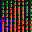

General caution::Wild animals crossing


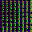

Dangerous curve to the right::Children crossing


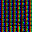

No passing::No vehicles


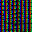

Keep right::Yield


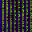

Bumpy road::Beware of ice/snow


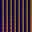

No passing for vehicles over 3.5 metric tons::Wild animals crossing


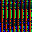

Speed limit (60km/h)::No passing


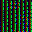

Dangerous curve to the right::Speed limit (120km/h)


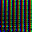

Speed limit (80km/h)::Speed limit (50km/h)


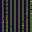

Right-of-way at the next intersection::Slippery road


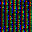

Beware of ice/snow::Keep right


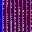

End of speed limit (80km/h)::Speed limit (80km/h)


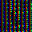

Keep right::Go straight or right


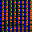

Stop::Bumpy road


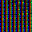

No passing::Speed limit (50km/h)


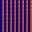

Speed limit (50km/h)::Go straight or right


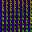

Priority road::Turn left ahead


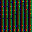

Turn left ahead::Ahead only


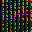

Keep right::Go straight or right


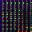

Ahead only::Yield


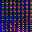

Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


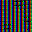

Speed limit (70km/h)::Speed limit (80km/h)


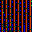

Slippery road::Road narrows on the right


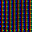

Speed limit (30km/h)::No vehicles


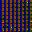

Right-of-way at the next intersection::Children crossing


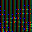

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


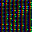

General caution::Traffic signals


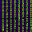

Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


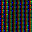

Right-of-way at the next intersection::Dangerous curve to the left


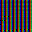

Speed limit (50km/h)::Speed limit (60km/h)


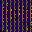

No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


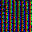

Ahead only::Keep right


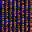

Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


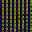

No vehicles::Speed limit (70km/h)


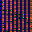

Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


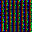

Speed limit (70km/h)::Speed limit (80km/h)


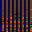

No passing::Speed limit (80km/h)


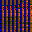

Right-of-way at the next intersection::No vehicles


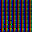

Go straight or right::No vehicles


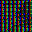

Keep right::Turn left ahead


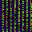

Road narrows on the right::Traffic signals


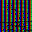

Speed limit (30km/h)::Speed limit (80km/h)


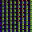

Children crossing::No vehicles


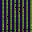

Speed limit (100km/h)::Speed limit (80km/h)


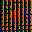

Speed limit (80km/h)::Speed limit (70km/h)


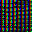

Vehicles over 3.5 metric tons prohibited::No passing for vehicles over 3.5 metric tons


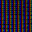

Dangerous curve to the right::Children crossing


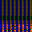

Speed limit (80km/h)::Speed limit (120km/h)


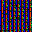

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


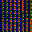

Keep right::No passing for vehicles over 3.5 metric tons


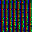

Speed limit (30km/h)::Speed limit (70km/h)


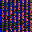

Road narrows on the right::Yield


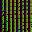

Go straight or right::Keep right


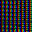

Speed limit (60km/h)::Yield


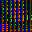

Speed limit (80km/h)::Speed limit (120km/h)


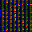

Road work::Keep right


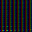

End of no passing::End of all speed and passing limits


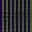

Speed limit (70km/h)::Speed limit (100km/h)


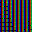

Children crossing::Wild animals crossing


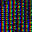

General caution::Traffic signals


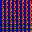

Speed limit (120km/h)::Speed limit (80km/h)


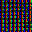

Road work::Slippery road


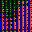

Speed limit (30km/h)::Speed limit (100km/h)


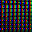

Speed limit (60km/h)::Beware of ice/snow


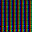

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


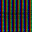

Speed limit (70km/h)::Speed limit (30km/h)


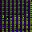

No passing::Speed limit (50km/h)


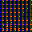

Speed limit (80km/h)::Speed limit (120km/h)


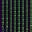

Priority road::Vehicles over 3.5 metric tons prohibited


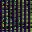

Road work::Traffic signals


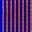

Speed limit (50km/h)::Go straight or right


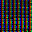

No passing::Speed limit (50km/h)


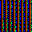

Priority road::Speed limit (30km/h)


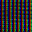

Ahead only::Keep right


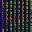

Speed limit (100km/h)::End of speed limit (80km/h)


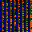

Pedestrians::Double curve


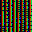

Priority road::Right-of-way at the next intersection


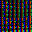

Right-of-way at the next intersection::Road narrows on the right


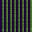

Speed limit (120km/h)::Traffic signals


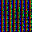

Priority road::Speed limit (60km/h)


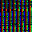

Go straight or left::Speed limit (20km/h)


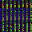

Go straight or left::Turn left ahead


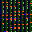

Keep right::Go straight or right


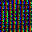

Bicycles crossing::Children crossing


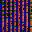

Speed limit (100km/h)::Speed limit (50km/h)


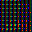

Speed limit (30km/h)::Speed limit (70km/h)


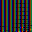

Road work::Speed limit (60km/h)


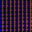

Traffic signals::Right-of-way at the next intersection


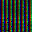

Road work::Traffic signals


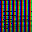

General caution::Speed limit (100km/h)


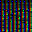

No vehicles::Speed limit (20km/h)


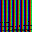

Speed limit (80km/h)::Speed limit (100km/h)


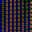

Road work::No entry


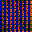

Speed limit (60km/h)::Speed limit (100km/h)


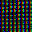

Keep right::Ahead only


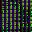

End of no passing by vehicles over 3.5 metric tons::End of no passing


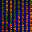

Right-of-way at the next intersection::Bumpy road


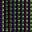

Turn left ahead::Roundabout mandatory


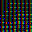

Wild animals crossing::Speed limit (80km/h)


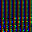

Speed limit (80km/h)::Speed limit (100km/h)


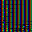

Stop::Speed limit (80km/h)


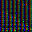

Road work::Speed limit (80km/h)


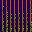

Keep right::Roundabout mandatory


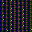

Speed limit (60km/h)::Yield


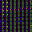

Right-of-way at the next intersection::Dangerous curve to the left


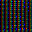

No passing::No vehicles


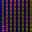

Bumpy road::Children crossing


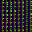

Speed limit (30km/h)::No passing


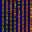

Dangerous curve to the right::Bumpy road


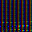

End of speed limit (80km/h)::End of all speed and passing limits


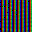

Speed limit (70km/h)::No vehicles


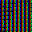

Go straight or left::Speed limit (30km/h)


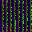

Speed limit (50km/h)::Speed limit (70km/h)


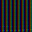

No passing for vehicles over 3.5 metric tons::Vehicles over 3.5 metric tons prohibited


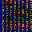

Pedestrians::Slippery road


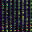

Speed limit (50km/h)::Keep right


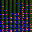

Speed limit (70km/h)::Speed limit (120km/h)


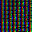

Speed limit (70km/h)::Speed limit (100km/h)


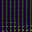

Speed limit (120km/h)::Speed limit (100km/h)


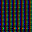

Keep right::Wild animals crossing


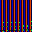

Speed limit (120km/h)::Speed limit (80km/h)


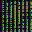

Right-of-way at the next intersection::Double curve


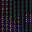

Keep right::Speed limit (30km/h)


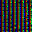

No vehicles::No passing


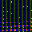

Speed limit (80km/h)::Speed limit (50km/h)


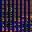

Speed limit (50km/h)::Speed limit (80km/h)


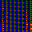

Road narrows on the right::Dangerous curve to the left


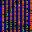

Speed limit (50km/h)::Speed limit (60km/h)


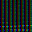

Speed limit (60km/h)::Road work


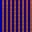

Speed limit (80km/h)::Speed limit (100km/h)


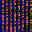

Road narrows on the right::Road work


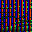

Wild animals crossing::Bicycles crossing


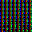

Ahead only::Speed limit (60km/h)


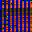

No vehicles::No passing


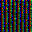

Road narrows on the right::Beware of ice/snow


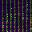

Go straight or right::Keep right


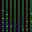

Slippery road::Beware of ice/snow


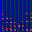

Speed limit (120km/h)::Speed limit (80km/h)


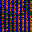

Speed limit (100km/h)::Speed limit (120km/h)


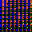

Turn right ahead::Keep right


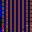

Right-of-way at the next intersection::Slippery road


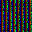

Ahead only::End of all speed and passing limits


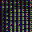

Traffic signals::Priority road


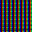

Speed limit (80km/h)::Speed limit (60km/h)


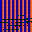

No entry::Speed limit (70km/h)


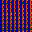

Speed limit (120km/h)::Speed limit (80km/h)


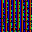

Slippery road::Road narrows on the right


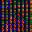

No passing::No vehicles


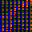

Right-of-way at the next intersection::Beware of ice/snow


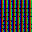

Priority road::Wild animals crossing


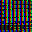

Yield::Wild animals crossing


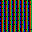

Speed limit (50km/h)::No vehicles


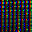

Turn right ahead::Keep right


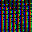

Speed limit (70km/h)::Speed limit (120km/h)


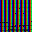

Speed limit (80km/h)::Speed limit (50km/h)


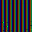

Beware of ice/snow::Bumpy road


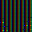

Road work::Slippery road


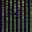

Turn left ahead::Turn right ahead


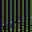

Stop::Speed limit (80km/h)


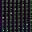

General caution::Right-of-way at the next intersection


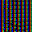

Road work::Dangerous curve to the left


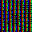

Right-of-way at the next intersection::Road narrows on the right


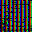

Speed limit (80km/h)::Speed limit (100km/h)


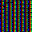

Road work::Right-of-way at the next intersection


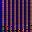

Speed limit (100km/h)::Speed limit (120km/h)


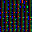

Keep right::No vehicles


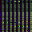

Speed limit (60km/h)::Speed limit (50km/h)


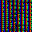

Ahead only::Turn left ahead


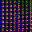

Traffic signals::Pedestrians


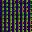

Right-of-way at the next intersection::Road narrows on the right


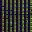

Road work::Speed limit (50km/h)


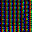

No passing::No vehicles


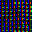

Speed limit (60km/h)::Speed limit (70km/h)


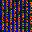

Road narrows on the right::Speed limit (80km/h)


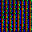

General caution::Traffic signals


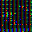

Yield::Speed limit (80km/h)


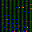

No passing::Speed limit (70km/h)


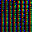

Turn left ahead::Keep right


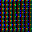

Speed limit (70km/h)::Speed limit (60km/h)


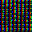

General caution::Road work


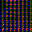

No passing::Vehicles over 3.5 metric tons prohibited


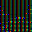

No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


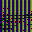

No entry::Speed limit (70km/h)


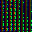

Speed limit (50km/h)::Speed limit (70km/h)


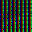

Keep left::Keep right


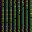

Turn left ahead::Ahead only


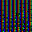

Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


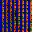

Keep right::Roundabout mandatory


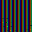

Beware of ice/snow::Road work


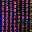

Keep right::Go straight or right


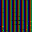

Dangerous curve to the right::Road work


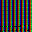

No passing for vehicles over 3.5 metric tons::No vehicles


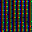

Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


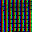

Speed limit (70km/h)::Speed limit (100km/h)


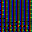

No passing::No passing for vehicles over 3.5 metric tons


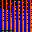

Speed limit (120km/h)::Speed limit (100km/h)


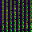

Speed limit (30km/h)::Wild animals crossing


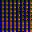

Slippery road::Dangerous curve to the left


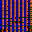

Speed limit (50km/h)::Speed limit (70km/h)


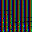

Speed limit (60km/h)::Speed limit (120km/h)


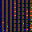

Right-of-way at the next intersection::Road work


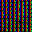

Speed limit (70km/h)::No vehicles


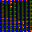

Speed limit (70km/h)::Speed limit (30km/h)


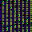

Speed limit (30km/h)::Speed limit (80km/h)


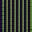

General caution::Dangerous curve to the right


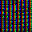

Ahead only::Yield


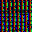

Speed limit (60km/h)::Speed limit (70km/h)


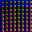

Turn left ahead::General caution


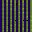

Priority road::Go straight or right


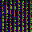

Beware of ice/snow::End of all speed and passing limits


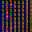

Road work::Pedestrians


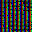

Beware of ice/snow::Speed limit (50km/h)


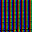

Speed limit (50km/h)::Speed limit (100km/h)


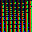

End of no passing::Speed limit (60km/h)


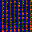

Turn right ahead::Ahead only


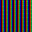

Speed limit (80km/h)::Speed limit (50km/h)


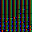

Speed limit (60km/h)::Vehicles over 3.5 metric tons prohibited


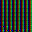

Speed limit (120km/h)::Speed limit (80km/h)


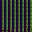

Speed limit (100km/h)::Speed limit (80km/h)


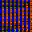

Speed limit (50km/h)::Speed limit (30km/h)


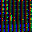

Yield::Speed limit (80km/h)


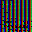

Speed limit (60km/h)::No passing


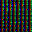

Ahead only::No passing for vehicles over 3.5 metric tons


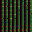

Turn left ahead::Ahead only


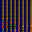

Speed limit (120km/h)::Speed limit (80km/h)


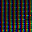

Speed limit (60km/h)::Speed limit (100km/h)


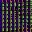

No passing for vehicles over 3.5 metric tons::Speed limit (60km/h)


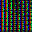

General caution::Slippery road


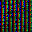

Speed limit (60km/h)::Speed limit (80km/h)


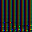

Speed limit (100km/h)::Speed limit (120km/h)


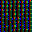

Roundabout mandatory::Priority road


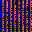

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


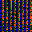

Speed limit (70km/h)::Speed limit (30km/h)


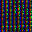

Turn right ahead::Ahead only


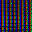

No passing::Turn left ahead


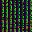

Speed limit (30km/h)::Speed limit (60km/h)


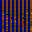

No passing::Speed limit (60km/h)


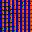

Right-of-way at the next intersection::Double curve


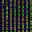

Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


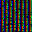

Speed limit (30km/h)::Speed limit (70km/h)


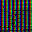

No passing::Speed limit (80km/h)


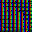

Speed limit (120km/h)::Speed limit (70km/h)


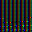

Speed limit (100km/h)::Speed limit (60km/h)


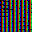

Beware of ice/snow::General caution


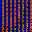

Speed limit (50km/h)::Speed limit (100km/h)


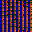

Speed limit (70km/h)::Speed limit (80km/h)


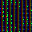

Traffic signals::Road narrows on the right


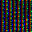

Right-of-way at the next intersection::Bumpy road


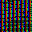

Speed limit (60km/h)::Speed limit (50km/h)


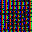

Speed limit (30km/h)::Speed limit (80km/h)


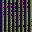

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


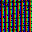

No passing for vehicles over 3.5 metric tons::Vehicles over 3.5 metric tons prohibited


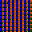

Go straight or left::Keep right


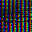

Speed limit (60km/h)::Speed limit (120km/h)


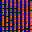

Speed limit (80km/h)::Speed limit (70km/h)


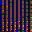

Roundabout mandatory::Speed limit (60km/h)


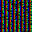

Speed limit (70km/h)::Speed limit (30km/h)


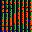

Speed limit (50km/h)::Speed limit (70km/h)


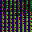

Speed limit (70km/h)::Speed limit (60km/h)


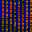

Vehicles over 3.5 metric tons prohibited::Speed limit (60km/h)


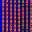

Traffic signals::Children crossing


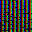

Speed limit (50km/h)::Speed limit (60km/h)


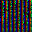

Yield::Ahead only


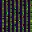

Traffic signals::Right-of-way at the next intersection


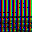

Keep right::Turn left ahead


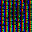

Right-of-way at the next intersection::Dangerous curve to the left


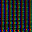

Keep right::Speed limit (50km/h)


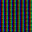

General caution::Slippery road


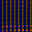

Speed limit (120km/h)::Speed limit (100km/h)


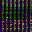

Ahead only::Beware of ice/snow


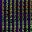

End of no passing by vehicles over 3.5 metric tons::End of speed limit (80km/h)


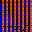

Speed limit (50km/h)::Speed limit (80km/h)


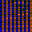

No passing::Speed limit (50km/h)


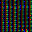

No vehicles::Ahead only


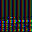

No passing::Speed limit (80km/h)


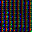

No passing::No vehicles


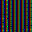

Right-of-way at the next intersection::Road work


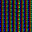

Road work::Bicycles crossing


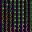

Ahead only::Keep right


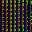

General caution::Keep right


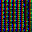

Speed limit (30km/h)::Speed limit (80km/h)


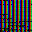

Speed limit (50km/h)::Speed limit (70km/h)


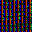

Speed limit (70km/h)::Speed limit (100km/h)


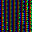

Road work::Bumpy road


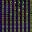

No passing::Speed limit (50km/h)


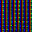

Speed limit (30km/h)::Speed limit (60km/h)


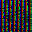

No passing::Speed limit (60km/h)


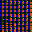

Stop::Speed limit (20km/h)


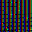

No vehicles::No passing


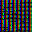

Road work::Children crossing


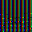

Speed limit (100km/h)::Speed limit (80km/h)


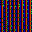

Priority road::Speed limit (80km/h)


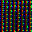

General caution::Ahead only


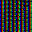

Road work::Bicycles crossing


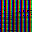

General caution::Speed limit (100km/h)


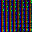

Speed limit (30km/h)::Speed limit (80km/h)


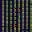

Speed limit (80km/h)::Speed limit (60km/h)


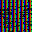

Road narrows on the right::Dangerous curve to the right


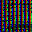

Road work::Dangerous curve to the left


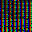

No entry::Stop


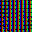

Beware of ice/snow::Speed limit (80km/h)


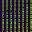

Speed limit (60km/h)::Speed limit (20km/h)


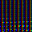

Speed limit (120km/h)::Speed limit (100km/h)


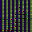

No passing::Speed limit (80km/h)


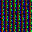

Speed limit (50km/h)::Speed limit (70km/h)


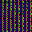

No passing for vehicles over 3.5 metric tons::Roundabout mandatory


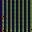

Speed limit (50km/h)::Speed limit (70km/h)


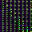

Pedestrians::Wild animals crossing


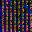

Speed limit (70km/h)::Speed limit (20km/h)


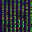

Speed limit (30km/h)::Speed limit (70km/h)


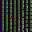

Road work::Bumpy road


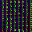

Turn right ahead::Ahead only


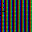

Wild animals crossing::Road work


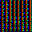

End of no passing by vehicles over 3.5 metric tons::End of no passing


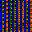

Keep right::Bicycles crossing


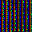

Stop::Speed limit (30km/h)


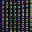

Right-of-way at the next intersection::Children crossing


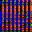

Speed limit (30km/h)::Speed limit (80km/h)


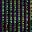

Slippery road::Beware of ice/snow


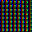

Turn left ahead::General caution


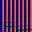

Speed limit (100km/h)::Speed limit (120km/h)


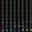

Speed limit (60km/h)::Speed limit (80km/h)


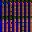

Beware of ice/snow::Speed limit (80km/h)


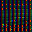

Speed limit (60km/h)::No vehicles


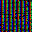

Speed limit (50km/h)::Speed limit (80km/h)


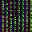

Right-of-way at the next intersection::Beware of ice/snow


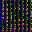

Speed limit (80km/h)::Speed limit (120km/h)


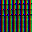

Speed limit (120km/h)::Beware of ice/snow


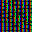

Road work::Road narrows on the right


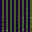

General caution::Slippery road


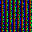

Speed limit (50km/h)::Ahead only


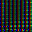

End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


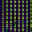

Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


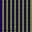

No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


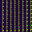

Speed limit (30km/h)::Speed limit (70km/h)


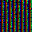

Children crossing::No passing for vehicles over 3.5 metric tons


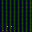

End of no passing::End of all speed and passing limits


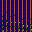

Speed limit (120km/h)::Speed limit (100km/h)


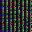

Beware of ice/snow::Right-of-way at the next intersection


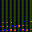

Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


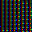

Turn left ahead::Speed limit (80km/h)


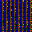

Speed limit (50km/h)::Speed limit (70km/h)


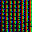

Go straight or right::Ahead only


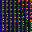

Pedestrians::Road work


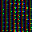

Speed limit (120km/h)::Speed limit (100km/h)


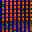

Speed limit (100km/h)::Wild animals crossing


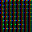

Speed limit (70km/h)::Road narrows on the right


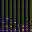

Speed limit (70km/h)::Speed limit (80km/h)


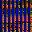

Go straight or left::Turn left ahead


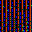

Slippery road::Wild animals crossing


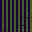

Road work::Slippery road


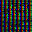

No passing::General caution


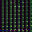

End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


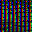

End of no passing::End of all speed and passing limits


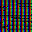

Yield::Speed limit (60km/h)


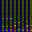

Speed limit (70km/h)::Speed limit (80km/h)


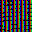

Beware of ice/snow::General caution


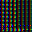

Turn left ahead::Roundabout mandatory


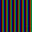

Dangerous curve to the right::Road work


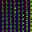

Road narrows on the right::Speed limit (50km/h)


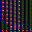

Speed limit (30km/h)::No vehicles


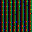

Turn left ahead::Ahead only


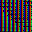

Speed limit (120km/h)::Speed limit (100km/h)


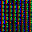

Right-of-way at the next intersection::Speed limit (30km/h)


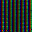

Priority road::Vehicles over 3.5 metric tons prohibited


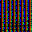

Speed limit (50km/h)::Speed limit (70km/h)


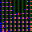

Turn right ahead::Ahead only


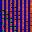

Wild animals crossing::General caution


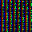

Slippery road::Wild animals crossing


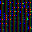

No passing::Priority road


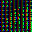

Speed limit (30km/h)::Speed limit (50km/h)


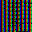

Keep right::Roundabout mandatory


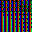

Speed limit (60km/h)::Yield


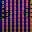

Keep right::Speed limit (100km/h)


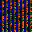

Pedestrians::Slippery road


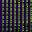

End of speed limit (80km/h)::End of all speed and passing limits


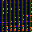

Speed limit (80km/h)::Speed limit (120km/h)


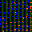

Keep right::No vehicles


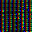

Traffic signals::Dangerous curve to the left


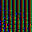

Speed limit (80km/h)::Speed limit (60km/h)


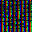

Right-of-way at the next intersection::Bumpy road


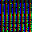

Go straight or left::Turn left ahead


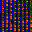

No passing::Speed limit (60km/h)


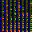

Stop::Speed limit (60km/h)


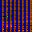

Turn right ahead::Ahead only


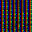

Speed limit (30km/h)::Yield


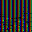

Stop::Speed limit (80km/h)


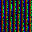

Speed limit (50km/h)::Speed limit (70km/h)


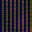

Priority road::Speed limit (50km/h)


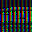

Turn right ahead::Go straight or left


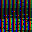

Yield::Speed limit (20km/h)


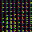

End of no passing::End of all speed and passing limits


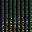

Speed limit (80km/h)::Speed limit (70km/h)


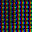

Speed limit (30km/h)::Speed limit (60km/h)


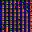

Speed limit (70km/h)::Speed limit (80km/h)


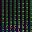

End of speed limit (80km/h)::End of no passing


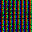

Speed limit (30km/h)::Yield


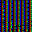

No passing::Speed limit (70km/h)


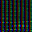

Speed limit (60km/h)::End of speed limit (80km/h)


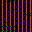

Slippery road::Road narrows on the right


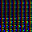

Speed limit (80km/h)::Speed limit (70km/h)


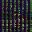

Keep right::End of all speed and passing limits


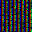

Double curve::Slippery road


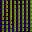

Go straight or right::Speed limit (30km/h)


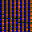

Road work::Wild animals crossing


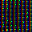

Right-of-way at the next intersection::Pedestrians


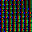

Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


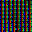

Wild animals crossing::Speed limit (120km/h)


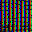

Speed limit (80km/h)::Speed limit (100km/h)


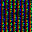

Pedestrians::Double curve


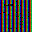

Priority road::Go straight or right


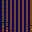

Beware of ice/snow::Speed limit (30km/h)


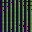

Speed limit (70km/h)::Priority road


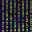

Stop::Speed limit (50km/h)


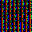

Dangerous curve to the left::Speed limit (70km/h)


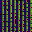

Road work::Wild animals crossing


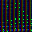

Speed limit (80km/h)::Speed limit (60km/h)


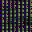

Speed limit (30km/h)::Yield


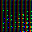

No passing::Vehicles over 3.5 metric tons prohibited


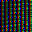

Ahead only::Turn left ahead


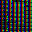

Speed limit (100km/h)::Speed limit (80km/h)


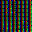

Road work::Pedestrians


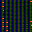

General caution::Wild animals crossing


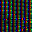

Slippery road::Children crossing


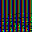

Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


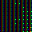

Pedestrians::Bicycles crossing


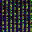

Speed limit (30km/h)::Speed limit (80km/h)


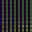

No passing for vehicles over 3.5 metric tons::No passing


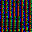

Speed limit (70km/h)::Speed limit (120km/h)


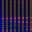

Speed limit (30km/h)::Speed limit (100km/h)


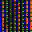

Children crossing::Bumpy road


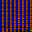

Road work::Speed limit (30km/h)


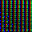

Speed limit (80km/h)::Speed limit (60km/h)


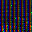

Go straight or right::Keep right


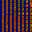

No vehicles::No passing


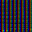

General caution::Wild animals crossing


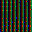

Turn left ahead::Ahead only


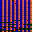

Speed limit (50km/h)::Speed limit (80km/h)


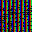

Road narrows on the right::Dangerous curve to the right


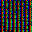

Speed limit (70km/h)::Speed limit (120km/h)


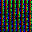

Stop::No entry


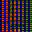

Speed limit (60km/h)::Ahead only


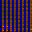

General caution::Speed limit (100km/h)


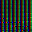

Speed limit (120km/h)::Speed limit (80km/h)


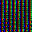

Priority road::End of speed limit (80km/h)


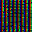

Speed limit (30km/h)::Speed limit (60km/h)


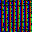

Speed limit (100km/h)::Speed limit (120km/h)


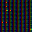

General caution::Yield


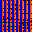

No entry::Priority road


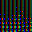

No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


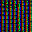

Slippery road::Dangerous curve to the left


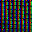

Speed limit (70km/h)::Speed limit (120km/h)


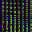

Ahead only::Keep right


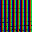

Speed limit (100km/h)::End of all speed and passing limits


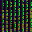

Speed limit (30km/h)::Speed limit (100km/h)


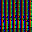

Right-of-way at the next intersection::Speed limit (50km/h)


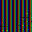

Road work::Slippery road


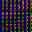

Pedestrians::Bumpy road


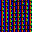

Road work::Bicycles crossing


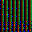

Keep right::Beware of ice/snow


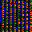

Speed limit (60km/h)::Speed limit (80km/h)


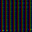

End of no passing::End of all speed and passing limits


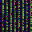

Priority road::Speed limit (60km/h)


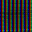

Speed limit (70km/h)::Speed limit (30km/h)


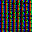

No entry::Priority road


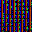

Slippery road::Road narrows on the right


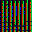

Speed limit (50km/h)::Speed limit (60km/h)


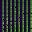

Keep left::Speed limit (60km/h)


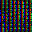

Speed limit (80km/h)::Speed limit (30km/h)


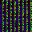

Bicycles crossing::Wild animals crossing


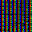

Road work::Road narrows on the right


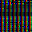

Speed limit (60km/h)::Speed limit (20km/h)


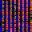

General caution::Wild animals crossing


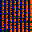

Speed limit (50km/h)::Speed limit (100km/h)


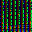

Speed limit (80km/h)::Speed limit (60km/h)


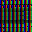

Beware of ice/snow::Speed limit (80km/h)


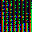

Speed limit (50km/h)::Speed limit (60km/h)


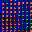

Speed limit (60km/h)::Speed limit (70km/h)


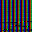

Speed limit (120km/h)::Speed limit (50km/h)


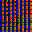

Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


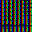

Yield::Road work


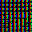

Speed limit (80km/h)::Speed limit (70km/h)


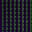

General caution::Yield


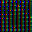

Speed limit (70km/h)::Speed limit (80km/h)


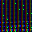

Speed limit (80km/h)::Speed limit (30km/h)


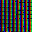

Speed limit (70km/h)::Speed limit (80km/h)


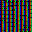

Dangerous curve to the right::Children crossing


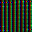

Beware of ice/snow::Dangerous curve to the right


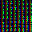

Speed limit (60km/h)::Speed limit (50km/h)


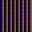

No passing for vehicles over 3.5 metric tons::Wild animals crossing


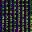

Beware of ice/snow::Road work


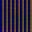

Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


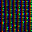

Speed limit (50km/h)::Speed limit (70km/h)


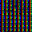

No passing::No vehicles


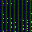

Speed limit (80km/h)::Speed limit (100km/h)


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Priority road::Speed limit (30km/h)


Keep right::Ahead only


Ahead only::Keep right


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (50km/h)::No passing


Speed limit (50km/h)::Speed limit (80km/h)


No entry::Bumpy road


Stop::Speed limit (60km/h)


Keep right::Speed limit (60km/h)


Bicycles crossing::General caution


Keep right::Turn left ahead


Right-of-way at the next intersection::Speed limit (70km/h)


Right-of-way at the next intersection::Bumpy road


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Turn left ahead::Ahead only


Speed limit (30km/h)::Speed limit (80km/h)


Road narrows on the right::Keep right


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Children crossing::Bumpy road


Go straight or right::Keep right


Yield::Go straight or right


Speed limit (80km/h)::Speed limit (120km/h)


Ahead only::Keep right


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (60km/h)::Yield


Speed limit (100km/h)::Wild animals crossing


Priority road::Speed limit (100km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Road work::Right-of-way at the next intersection


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Dangerous curve to the right::Bumpy road


Bumpy road::Pedestrians


Right-of-way at the next intersection::General caution


Keep right::Go straight or right


Road work::Wild animals crossing


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Road work::General caution


Go straight or right::No vehicles


Road narrows on the right::End of all speed and passing limits


Speed limit (60km/h)::Speed limit (100km/h)


Ahead only::Keep right


End of no passing by vehicles over 3.5 metric tons::Speed limit (120km/h)


Ahead only::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (80km/h)


No passing::Vehicles over 3.5 metric tons prohibited


Priority road::Children crossing


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Beware of ice/snow::General caution


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (120km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Go straight or right::Speed limit (50km/h)


Right-of-way at the next intersection::Dangerous curve to the left


Dangerous curve to the right::Bicycles crossing


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Slippery road::Road narrows on the right


Turn left ahead::Keep right


Road narrows on the right::Right-of-way at the next intersection


Keep right::Ahead only


Speed limit (50km/h)::Speed limit (60km/h)


Road narrows on the right::General caution


Road narrows on the right::Right-of-way at the next intersection


Speed limit (50km/h)::Go straight or right


Speed limit (70km/h)::Go straight or right


No vehicles::Speed limit (70km/h)


Right-of-way at the next intersection::Dangerous curve to the right


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Keep right


Dangerous curve to the left::Double curve


Speed limit (80km/h)::Speed limit (30km/h)


Keep right::Speed limit (60km/h)


General caution::Traffic signals


Keep left::Ahead only


Priority road::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Slippery road::General caution


Bumpy road::Children crossing


Pedestrians::Bicycles crossing


Turn left ahead::Speed limit (120km/h)


Priority road::Keep right


Speed limit (70km/h)::Priority road


Ahead only::Roundabout mandatory


No passing::Vehicles over 3.5 metric tons prohibited


Right-of-way at the next intersection::General caution


Speed limit (30km/h)::Speed limit (70km/h)


General caution::Yield


Ahead only::Roundabout mandatory


Speed limit (70km/h)::Roundabout mandatory


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (70km/h)


No passing::Speed limit (50km/h)


General caution::Right-of-way at the next intersection


Speed limit (100km/h)::Speed limit (120km/h)


Right-of-way at the next intersection::Pedestrians


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Stop::Speed limit (80km/h)


Speed limit (100km/h)::Beware of ice/snow


Speed limit (70km/h)::Speed limit (20km/h)


Roundabout mandatory::Turn right ahead


Ahead only::Go straight or left


Speed limit (70km/h)::Ahead only


Speed limit (30km/h)::Speed limit (100km/h)


Road work::Speed limit (50km/h)


Slippery road::Road narrows on the right


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (80km/h)


General caution::Traffic signals


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Go straight or right


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (120km/h)


No passing::Speed limit (60km/h)


Ahead only::No passing


End of all speed and passing limits::End of speed limit (80km/h)


Priority road::Speed limit (80km/h)


Priority road::No passing


Roundabout mandatory::Priority road


No passing::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Turn left ahead::Ahead only


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Road work


Speed limit (50km/h)::Speed limit (70km/h)


Children crossing::No passing for vehicles over 3.5 metric tons


Right-of-way at the next intersection::Road narrows on the right


No passing::No vehicles


Speed limit (60km/h)::Keep right


Children crossing::Double curve


Go straight or right::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Traffic signals::Dangerous curve to the left


Priority road::No passing


No passing::Speed limit (100km/h)


Road work::Yield


Stop::End of speed limit (80km/h)


Stop::No passing for vehicles over 3.5 metric tons


Ahead only::Keep right


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Stop::Road work


General caution::Wild animals crossing


Speed limit (30km/h)::Speed limit (80km/h)


Double curve::Dangerous curve to the left


Road work::General caution


Road work::Dangerous curve to the left


Speed limit (50km/h)::Speed limit (30km/h)


Priority road::No passing


Stop::Road work


Slippery road::Right-of-way at the next intersection


Speed limit (50km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::Children crossing


Road work::General caution


Speed limit (70km/h)::Speed limit (100km/h)


Roundabout mandatory::Turn right ahead


Speed limit (30km/h)::Speed limit (80km/h)


Beware of ice/snow::Speed limit (80km/h)


Keep right::Vehicles over 3.5 metric tons prohibited


Ahead only::End of no passing by vehicles over 3.5 metric tons


No passing::Speed limit (60km/h)


Road narrows on the right::Bicycles crossing


General caution::Wild animals crossing


Stop::Right-of-way at the next intersection


Dangerous curve to the left::Speed limit (70km/h)


Stop::Speed limit (80km/h)


No vehicles::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Keep right::Go straight or left


Yield::Speed limit (30km/h)


Yield::Speed limit (80km/h)


Road work::Children crossing


Priority road::No passing for vehicles over 3.5 metric tons


End of no passing by vehicles over 3.5 metric tons::End of no passing


Priority road::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Traffic signals::Road narrows on the right


Speed limit (100km/h)::Speed limit (120km/h)


Dangerous curve to the right::Road work


Speed limit (80km/h)::Speed limit (30km/h)


Priority road::Ahead only


Keep right::Speed limit (50km/h)


Dangerous curve to the left::General caution


General caution::Slippery road


Road work::Children crossing


Right-of-way at the next intersection::Pedestrians


Road work::Bumpy road


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Beware of ice/snow::Speed limit (80km/h)


Roundabout mandatory::Speed limit (80km/h)


Yield::Speed limit (60km/h)


General caution::Wild animals crossing


Priority road::Keep right


Speed limit (50km/h)::Speed limit (70km/h)


End of no passing::End of no passing by vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Traffic signals::Children crossing


Traffic signals::Pedestrians


Speed limit (60km/h)::Turn right ahead


Speed limit (70km/h)::Speed limit (80km/h)


General caution::Wild animals crossing


Speed limit (30km/h)::Speed limit (100km/h)


Priority road::Keep right


Speed limit (60km/h)::Speed limit (20km/h)


Road work::Bicycles crossing


Right-of-way at the next intersection::Road work


Speed limit (120km/h)::Speed limit (80km/h)


Slippery road::Road work


Road work::Beware of ice/snow


Traffic signals::Road work


Turn right ahead::Speed limit (60km/h)


Double curve::Wild animals crossing


Right-of-way at the next intersection::Bumpy road


Speed limit (60km/h)::No passing


Speed limit (50km/h)::Speed limit (60km/h)


General caution::Wild animals crossing


Ahead only::End of no passing


Go straight or right::Roundabout mandatory


Speed limit (50km/h)::Road narrows on the right


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (50km/h)


Stop::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (120km/h)


Priority road::No passing for vehicles over 3.5 metric tons


Bicycles crossing::General caution


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (30km/h)::No passing


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Bumpy road::Pedestrians


Speed limit (50km/h)::Speed limit (60km/h)


Go straight or right::Turn left ahead


No passing::Vehicles over 3.5 metric tons prohibited


Stop::End of speed limit (80km/h)


Right-of-way at the next intersection::Pedestrians


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Children crossing::Bumpy road


General caution::Bumpy road


Speed limit (30km/h)::Speed limit (80km/h)


No entry::No passing for vehicles over 3.5 metric tons


Traffic signals::Pedestrians


Speed limit (120km/h)::Go straight or right


Ahead only::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (50km/h)::Speed limit (100km/h)


Beware of ice/snow::Traffic signals


Go straight or right::Keep right


Children crossing::Bumpy road


No passing::Wild animals crossing


Priority road::No passing


Keep right::Ahead only


Priority road::Go straight or right


Speed limit (50km/h)::Speed limit (60km/h)


Turn right ahead::Ahead only


Road work::Bicycles crossing


Keep right::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::General caution


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


No vehicles::No passing


No passing::Speed limit (30km/h)


Ahead only::No passing for vehicles over 3.5 metric tons


Yield::Priority road


Road work::Bumpy road


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Wild animals crossing::General caution


Slippery road::Beware of ice/snow


Speed limit (70km/h)::Speed limit (30km/h)


Turn right ahead::Ahead only


Beware of ice/snow::Traffic signals


Road work::Bumpy road


Speed limit (60km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (60km/h)


Priority road::Road work


Yield::Road work


Road work::Children crossing


Road work::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (60km/h)::Speed limit (100km/h)


Priority road::Speed limit (30km/h)


Priority road::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Turn right ahead::Speed limit (50km/h)


No entry::Priority road


Priority road::End of all speed and passing limits


Ahead only::Yield


Stop::No passing for vehicles over 3.5 metric tons


Children crossing::Road work


Speed limit (30km/h)::Speed limit (60km/h)


No vehicles::Priority road


Road work::General caution


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (120km/h)


No passing for vehicles over 3.5 metric tons::Vehicles over 3.5 metric tons prohibited


Speed limit (100km/h)::Speed limit (120km/h)


Dangerous curve to the right::Speed limit (120km/h)


Right-of-way at the next intersection::Dangerous curve to the left


Speed limit (50km/h)::Go straight or right


Speed limit (120km/h)::Speed limit (100km/h)


Dangerous curve to the right::Road work


General caution::Wild animals crossing


Turn left ahead::Speed limit (60km/h)


No passing for vehicles over 3.5 metric tons::No vehicles


Pedestrians::Double curve


End of speed limit (80km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (100km/h)


No passing::Speed limit (70km/h)


Double curve::Slippery road


No vehicles::No entry


Right-of-way at the next intersection::General caution


Speed limit (80km/h)::Speed limit (120km/h)


Turn left ahead::Turn right ahead


Speed limit (60km/h)::Speed limit (20km/h)


Keep right::Ahead only


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Beware of ice/snow::Traffic signals


Speed limit (30km/h)::Speed limit (80km/h)


Wild animals crossing::Speed limit (120km/h)


Road narrows on the right::Ahead only


Go straight or right::Keep right


Speed limit (30km/h)::Bumpy road


Bumpy road::Road work


Slippery road::Road narrows on the right


Speed limit (80km/h)::Speed limit (120km/h)


No passing::Speed limit (80km/h)


No passing::Vehicles over 3.5 metric tons prohibited


End of no passing::Priority road


End of speed limit (80km/h)::End of no passing


Speed limit (30km/h)::Speed limit (70km/h)


Roundabout mandatory::End of no passing


No passing for vehicles over 3.5 metric tons::Speed limit (50km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Yield


Speed limit (100km/h)::Speed limit (120km/h)


Turn right ahead::Ahead only


Speed limit (50km/h)::Speed limit (70km/h)


Dangerous curve to the right::Children crossing


Priority road::No vehicles


No passing::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Beware of ice/snow


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


Ahead only::Speed limit (70km/h)


Turn left ahead::Keep right


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (70km/h)


Keep right::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (50km/h)


End of no passing by vehicles over 3.5 metric tons::Priority road


Turn right ahead::Ahead only


Speed limit (70km/h)::Road narrows on the right


Speed limit (50km/h)::Speed limit (60km/h)


Road work::Speed limit (50km/h)


Keep right::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (50km/h)


Turn left ahead::Keep right


Speed limit (80km/h)::Speed limit (100km/h)


Roundabout mandatory::Speed limit (80km/h)


Roundabout mandatory::Turn right ahead


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (100km/h)::End of all speed and passing limits


Keep right::Ahead only


Bicycles crossing::Road work


Speed limit (50km/h)::Speed limit (100km/h)


Wild animals crossing::No passing for vehicles over 3.5 metric tons


No vehicles::Speed limit (30km/h)


Priority road::No vehicles


Ahead only::Speed limit (120km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::No passing


Speed limit (60km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Ahead only::Go straight or left


Road work::General caution


End of no passing by vehicles over 3.5 metric tons::End of no passing


Speed limit (100km/h)::Speed limit (60km/h)


Right-of-way at the next intersection::Road work


Speed limit (70km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Road work::Children crossing


Beware of ice/snow::Bumpy road


Speed limit (50km/h)::Speed limit (120km/h)


Double curve::Road work


Turn left ahead::Ahead only


Speed limit (50km/h)::Yield


Turn left ahead::Keep right


Speed limit (30km/h)::General caution


Stop::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Keep right::End of no passing


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (60km/h)::General caution


Speed limit (120km/h)::Speed limit (100km/h)


Priority road::Road work


Go straight or right::Keep right


Turn right ahead::Ahead only


Turn right ahead::No vehicles


End of no passing by vehicles over 3.5 metric tons::No passing


Children crossing::No vehicles


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (60km/h)::No passing


No entry::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Slippery road::Pedestrians


Speed limit (50km/h)::Speed limit (70km/h)


End of no passing by vehicles over 3.5 metric tons::Children crossing


Speed limit (30km/h)::Speed limit (80km/h)


Turn right ahead::Turn left ahead


Go straight or left::Keep left


Bumpy road::Wild animals crossing


Speed limit (50km/h)::Speed limit (60km/h)


End of speed limit (80km/h)::End of no passing


Children crossing::General caution


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Priority road::Children crossing


Speed limit (70km/h)::Speed limit (80km/h)


Ahead only::Dangerous curve to the right


Keep right::Go straight or right


Speed limit (70km/h)::Priority road


General caution::Road work


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Road work::No vehicles


Bicycles crossing::Slippery road


Turn right ahead::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Traffic signals::Wild animals crossing


Priority road::Speed limit (30km/h)


End of no passing by vehicles over 3.5 metric tons::Speed limit (20km/h)


No passing::Vehicles over 3.5 metric tons prohibited


No vehicles::Speed limit (70km/h)


Keep right::Speed limit (100km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Road narrows on the right::Dangerous curve to the left


No passing::No passing for vehicles over 3.5 metric tons


End of no passing::End of all speed and passing limits


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


General caution::Traffic signals


Speed limit (80km/h)::Priority road


Speed limit (60km/h)::Speed limit (30km/h)


No vehicles::Speed limit (20km/h)


Slippery road::Dangerous curve to the left


Turn left ahead::Turn right ahead


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Ahead only::Go straight or right


Double curve::Dangerous curve to the left


Traffic signals::Road narrows on the right


Yield::Keep right


Turn right ahead::Ahead only


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Bicycles crossing::General caution


General caution::Dangerous curve to the right


Speed limit (60km/h)::Keep right


Beware of ice/snow::Road work


Speed limit (80km/h)::Speed limit (100km/h)


No vehicles::General caution


Speed limit (30km/h)::No vehicles


Beware of ice/snow::Dangerous curve to the right


No passing for vehicles over 3.5 metric tons::Vehicles over 3.5 metric tons prohibited


General caution::Slippery road


Priority road::Beware of ice/snow


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (100km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::Pedestrians


Keep right::No vehicles


Bicycles crossing::General caution


Slippery road::Double curve


Traffic signals::Wild animals crossing


Priority road::Speed limit (80km/h)


Keep right::Yield


Speed limit (30km/h)::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Keep right::Turn left ahead


No entry::No passing for vehicles over 3.5 metric tons


No passing::Priority road


Speed limit (30km/h)::Speed limit (50km/h)


Stop::Speed limit (60km/h)


Keep right::Turn left ahead


Speed limit (50km/h)::Speed limit (70km/h)


General caution::Pedestrians


No passing::Speed limit (50km/h)


Speed limit (30km/h)::General caution


Road work::Dangerous curve to the left


General caution::Keep right


Keep right::End of all speed and passing limits


Speed limit (100km/h)::Speed limit (120km/h)


Keep right::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (50km/h)::No passing


Speed limit (60km/h)::Speed limit (70km/h)


No passing::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Yield


Speed limit (70km/h)::Speed limit (100km/h)


No passing::Speed limit (60km/h)


Stop::Road work


Keep right::Beware of ice/snow


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Yield


No passing::No vehicles


General caution::Dangerous curve to the right


Priority road::End of speed limit (80km/h)


Right-of-way at the next intersection::General caution


Beware of ice/snow::Wild animals crossing


Dangerous curve to the left::General caution


Priority road::Keep right


Ahead only::Keep right


Speed limit (60km/h)::Speed limit (100km/h)


Ahead only::Keep right


Speed limit (70km/h)::Speed limit (100km/h)


End of no passing by vehicles over 3.5 metric tons::Priority road


Traffic signals::General caution


Speed limit (30km/h)::Speed limit (80km/h)


Priority road::No passing


Speed limit (60km/h)::Speed limit (80km/h)


Turn left ahead::Keep right


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Beware of ice/snow::Bicycles crossing


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


End of speed limit (80km/h)::Speed limit (80km/h)


Children crossing::Bumpy road


Right-of-way at the next intersection::General caution


Children crossing::General caution


Keep right::Go straight or right


No passing for vehicles over 3.5 metric tons::Turn left ahead


Speed limit (80km/h)::No vehicles


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (60km/h)::Keep right


No passing::Speed limit (80km/h)


Keep right::No vehicles


Right-of-way at the next intersection::Wild animals crossing


No entry::Speed limit (60km/h)


Go straight or right::Keep right


Stop::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (50km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Priority road::Speed limit (30km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Traffic signals::End of all speed and passing limits


Turn left ahead::Ahead only


Speed limit (120km/h)::Speed limit (70km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (70km/h)


No vehicles::Speed limit (80km/h)


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Bumpy road::Double curve


Road work::Speed limit (80km/h)


Turn left ahead::Keep right


Right-of-way at the next intersection::Road work


Turn right ahead::Speed limit (60km/h)


Speed limit (70km/h)::No passing


Road work::Dangerous curve to the right


End of all speed and passing limits::End of speed limit (80km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (70km/h)


Bicycles crossing::General caution


Double curve::Road work


Traffic signals::Children crossing


Yield::Speed limit (30km/h)


No passing::Priority road


Keep left::Keep right


General caution::Dangerous curve to the right


Speed limit (50km/h)::Speed limit (100km/h)


Traffic signals::Pedestrians


Priority road::Speed limit (80km/h)


Speed limit (30km/h)::No vehicles


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Go straight or right::End of all speed and passing limits


No passing for vehicles over 3.5 metric tons::General caution


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (30km/h)::No vehicles


End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


Ahead only::Go straight or right


General caution::Road narrows on the right


Speed limit (70km/h)::Speed limit (50km/h)


Road work::Children crossing


Speed limit (120km/h)::Speed limit (70km/h)


Turn left ahead::Speed limit (80km/h)


Right-of-way at the next intersection::Traffic signals


Wild animals crossing::General caution


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (60km/h)::Speed limit (30km/h)


No passing::Speed limit (100km/h)


Go straight or right::Ahead only


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Road narrows on the right::Dangerous curve to the right


Road narrows on the right::No passing


General caution::Road work


Turn right ahead::End of no passing


No passing::Speed limit (70km/h)


No passing::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Road work::Children crossing


Slippery road::Dangerous curve to the left


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (70km/h)


General caution::Wild animals crossing


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Bumpy road::General caution


Speed limit (50km/h)::Speed limit (60km/h)


End of no passing::Speed limit (60km/h)


Speed limit (20km/h)::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Turn left ahead


Speed limit (30km/h)::Speed limit (100km/h)


Dangerous curve to the right::Wild animals crossing


Priority road::Speed limit (60km/h)


End of no passing::End of all speed and passing limits


Turn right ahead::Keep right


Speed limit (120km/h)::Priority road


No passing::No vehicles


Speed limit (60km/h)::Speed limit (80km/h)


General caution::Wild animals crossing


No vehicles::Speed limit (50km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


No vehicles::Speed limit (70km/h)


Priority road::Speed limit (50km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Go straight or right::Ahead only


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Beware of ice/snow::Go straight or left


Speed limit (120km/h)::Speed limit (80km/h)


Road work::Bumpy road


Children crossing::No passing for vehicles over 3.5 metric tons


End of speed limit (80km/h)::Speed limit (80km/h)


Dangerous curve to the right::Wild animals crossing


Speed limit (80km/h)::Speed limit (120km/h)


Ahead only::Keep right


Keep right::Speed limit (70km/h)


Ahead only::End of no passing


No passing::Speed limit (50km/h)


No passing::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Keep right::Turn left ahead


Roundabout mandatory::Right-of-way at the next intersection


Speed limit (50km/h)::Yield


Keep right::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Road narrows on the right::Keep right


Speed limit (30km/h)::Speed limit (120km/h)


Speed limit (20km/h)::Yield


End of speed limit (80km/h)::Speed limit (80km/h)


Road work::General caution


Speed limit (50km/h)::Yield


Road work::Wild animals crossing


Speed limit (50km/h)::Go straight or right


Speed limit (80km/h)::Speed limit (60km/h)


Stop::No passing for vehicles over 3.5 metric tons


Right-of-way at the next intersection::Pedestrians


No vehicles::Speed limit (60km/h)


No vehicles::Yield


End of no passing by vehicles over 3.5 metric tons::End of speed limit (80km/h)


Speed limit (80km/h)::Speed limit (30km/h)


End of speed limit (80km/h)::End of all speed and passing limits


Right-of-way at the next intersection::Road work


Traffic signals::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (80km/h)


No passing::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Children crossing::Dangerous curve to the left


Road work::Speed limit (50km/h)


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (80km/h)


General caution::Traffic signals


Keep right::Ahead only


Speed limit (20km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (70km/h)


End of no passing by vehicles over 3.5 metric tons::Vehicles over 3.5 metric tons prohibited


Speed limit (80km/h)::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Priority road::Road work


Speed limit (100km/h)::Speed limit (80km/h)


Turn right ahead::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Traffic signals::Pedestrians


Road work::Right-of-way at the next intersection


Go straight or right::Keep right


Speed limit (50km/h)::Speed limit (60km/h)


Turn right ahead::Keep right


Turn left ahead::Turn right ahead


Right-of-way at the next intersection::Road work


Speed limit (30km/h)::Speed limit (80km/h)


Pedestrians::Stop


Keep right::Go straight or right


Speed limit (30km/h)::Speed limit (70km/h)


Wild animals crossing::Speed limit (120km/h)


Turn left ahead::Ahead only


Ahead only::Go straight or right


Bicycles crossing::Bumpy road


Speed limit (100km/h)::Bicycles crossing


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Road work::Speed limit (30km/h)


No passing::No passing for vehicles over 3.5 metric tons


Yield::Speed limit (80km/h)


Road work::General caution


Speed limit (70km/h)::Speed limit (100km/h)


No entry::Stop


Turn left ahead::Keep right


Dangerous curve to the right::Pedestrians


No passing for vehicles over 3.5 metric tons::No vehicles


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (100km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Yield


No passing::No passing for vehicles over 3.5 metric tons


Stop::Dangerous curve to the left


No entry::Road work


Right-of-way at the next intersection::General caution


No passing::No vehicles


Speed limit (70km/h)::Speed limit (100km/h)


Bicycles crossing::Slippery road


Go straight or left::Speed limit (70km/h)


Ahead only::Speed limit (120km/h)


Right-of-way at the next intersection::Speed limit (30km/h)


General caution::Dangerous curve to the right


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (50km/h)::Speed limit (120km/h)


Keep right::Roundabout mandatory


Priority road::Vehicles over 3.5 metric tons prohibited


Speed limit (60km/h)::Yield


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Dangerous curve to the left


Speed limit (60km/h)::Keep right


Speed limit (80km/h)::Speed limit (60km/h)


No passing::Vehicles over 3.5 metric tons prohibited


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (50km/h)


Ahead only::Yield


General caution::Children crossing


Speed limit (80km/h)::Speed limit (50km/h)


No entry::Road work


General caution::Children crossing


Speed limit (70km/h)::Speed limit (100km/h)


Slippery road::Road narrows on the right


General caution::Bumpy road


Speed limit (100km/h)::Beware of ice/snow


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Right-of-way at the next intersection::General caution


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (50km/h)


No vehicles::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (100km/h)


No entry::Wild animals crossing


Beware of ice/snow::Wild animals crossing


Speed limit (70km/h)::Keep right


Road work::Bicycles crossing


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (60km/h)::Keep right


Speed limit (50km/h)::Speed limit (80km/h)


Go straight or right::No vehicles


Road work::Children crossing


Slippery road::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Keep right::Roundabout mandatory


Speed limit (50km/h)::Speed limit (70km/h)


Road narrows on the right::Traffic signals


Traffic signals::Pedestrians


Speed limit (50km/h)::Speed limit (30km/h)


Slippery road::General caution


General caution::Yield


Turn right ahead::Keep right


Keep right::End of no passing


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (50km/h)


Stop::Road work


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Priority road::Speed limit (70km/h)


Pedestrians::Bicycles crossing


Speed limit (80km/h)::Wild animals crossing


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Pedestrians::Road work


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Turn right ahead::Speed limit (60km/h)


Beware of ice/snow::Dangerous curve to the left


Keep right::Speed limit (120km/h)


Double curve::Road work


Go straight or left::Turn left ahead


Dangerous curve to the right::Bicycles crossing


Speed limit (120km/h)::Speed limit (70km/h)


Stop::Speed limit (70km/h)


Beware of ice/snow::Speed limit (80km/h)


Priority road::Vehicles over 3.5 metric tons prohibited


Road work::Yield


Road work::General caution


No vehicles::Speed limit (30km/h)


Keep right::Speed limit (20km/h)


Speed limit (70km/h)::End of speed limit (80km/h)


Keep right::Speed limit (100km/h)


Right-of-way at the next intersection::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (20km/h)


Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (30km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::Beware of ice/snow


Road narrows on the right::General caution


Road work::General caution


Beware of ice/snow::Dangerous curve to the left


Keep left::Keep right


Keep right::End of no passing


Speed limit (70km/h)::Speed limit (80km/h)


Ahead only::Turn left ahead


Ahead only::Speed limit (70km/h)


Road work::Speed limit (80km/h)


No vehicles::Priority road


Road work::Dangerous curve to the left


Right-of-way at the next intersection::Beware of ice/snow


Speed limit (80km/h)::Speed limit (70km/h)


Road work::Pedestrians


Speed limit (120km/h)::Speed limit (100km/h)


End of speed limit (80km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (60km/h)


Road work::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Wild animals crossing::Speed limit (80km/h)


Stop::General caution


Speed limit (50km/h)::Speed limit (30km/h)


Turn left ahead::Ahead only


Speed limit (60km/h)::End of all speed and passing limits


Speed limit (50km/h)::Bumpy road


Road narrows on the right::Road work


Speed limit (80km/h)::Speed limit (70km/h)


Ahead only::Priority road


Speed limit (60km/h)::Speed limit (80km/h)


Priority road::Road work


Ahead only::End of no passing


Speed limit (80km/h)::Speed limit (70km/h)


End of speed limit (80km/h)::Speed limit (60km/h)


Road narrows on the right::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Road work::General caution


Slippery road::Right-of-way at the next intersection


Speed limit (60km/h)::Ahead only


General caution::Pedestrians


Ahead only::Go straight or left


Stop::No passing


Right-of-way at the next intersection::General caution


Speed limit (60km/h)::Speed limit (100km/h)


Ahead only::No passing


End of speed limit (80km/h)::Speed limit (60km/h)


General caution::Speed limit (60km/h)


Keep right::Speed limit (80km/h)


Speed limit (60km/h)::Road narrows on the right


Right-of-way at the next intersection::Beware of ice/snow


General caution::Road work


Speed limit (120km/h)::Speed limit (80km/h)


Road work::Speed limit (80km/h)


Right-of-way at the next intersection::Children crossing


Speed limit (50km/h)::Speed limit (60km/h)


Traffic signals::End of all speed and passing limits


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Pedestrians::Stop


Dangerous curve to the right::Children crossing


Stop::Speed limit (80km/h)


Priority road::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Yield::Ahead only


Priority road::Road work


Keep right::General caution


Keep right::Speed limit (50km/h)


Beware of ice/snow::Dangerous curve to the right


Speed limit (50km/h)::Speed limit (80km/h)


Road work::General caution


Dangerous curve to the right::Children crossing


Speed limit (50km/h)::Speed limit (60km/h)


Stop::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Yield


Speed limit (80km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Turn left ahead


Speed limit (50km/h)::Speed limit (20km/h)


Speed limit (30km/h)::Yield


Speed limit (30km/h)::Speed limit (80km/h)


Keep right::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Turn right ahead::Speed limit (60km/h)


General caution::Bumpy road


Speed limit (70km/h)::Speed limit (120km/h)


Road work::Road narrows on the right


Speed limit (100km/h)::Speed limit (80km/h)


Slippery road::Double curve


Speed limit (80km/h)::Speed limit (30km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Turn right ahead::Ahead only


Speed limit (120km/h)::Speed limit (100km/h)


Keep right::Go straight or right


Stop::Speed limit (20km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::General caution


Speed limit (70km/h)::Speed limit (60km/h)


Speed limit (120km/h)::Wild animals crossing


Turn right ahead::Keep right


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Right-of-way at the next intersection::General caution


End of no passing by vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (70km/h)::Yield


Slippery road::Road narrows on the right


Speed limit (30km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Road work


Keep right::Go straight or right


End of no passing by vehicles over 3.5 metric tons::General caution


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Slippery road::Priority road


Speed limit (80km/h)::Speed limit (70km/h)


Slippery road::Wild animals crossing


Yield::End of all speed and passing limits


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Priority road


Traffic signals::Bicycles crossing


Traffic signals::Road narrows on the right


No entry::Speed limit (60km/h)


Stop::Dangerous curve to the left


Speed limit (100km/h)::Roundabout mandatory


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (50km/h)::No passing


Turn left ahead::Ahead only


Right-of-way at the next intersection::Children crossing


Speed limit (80km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (30km/h)


No vehicles::Speed limit (20km/h)


Speed limit (60km/h)::Speed limit (70km/h)


No passing::Priority road


Ahead only::Roundabout mandatory


Turn left ahead::Ahead only


Speed limit (30km/h)::Speed limit (50km/h)


Priority road::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Beware of ice/snow::Speed limit (30km/h)


Traffic signals::General caution


Keep right::Go straight or right


Turn left ahead::No passing for vehicles over 3.5 metric tons


No passing for vehicles over 3.5 metric tons::Speed limit (60km/h)


Speed limit (20km/h)::Yield


Pedestrians::Road work


Priority road::Children crossing


Speed limit (120km/h)::Speed limit (100km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Children crossing::Bumpy road


Keep right::Ahead only


Dangerous curve to the right::Right-of-way at the next intersection


Ahead only::Keep right


No vehicles::No passing for vehicles over 3.5 metric tons


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Pedestrians::No vehicles


Speed limit (70km/h)::Speed limit (120km/h)


Traffic signals::Pedestrians


Speed limit (50km/h)::Speed limit (80km/h)


General caution::Slippery road


Speed limit (30km/h)::Speed limit (100km/h)


Wild animals crossing::Beware of ice/snow


Speed limit (70km/h)::No vehicles


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (100km/h)::Speed limit (60km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Road work::Right-of-way at the next intersection


Roundabout mandatory::Priority road


Keep right::Go straight or right


Speed limit (50km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Roundabout mandatory::Turn right ahead


No passing::No passing for vehicles over 3.5 metric tons


Road work::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (50km/h)


Turn right ahead::Road work


Speed limit (30km/h)::Speed limit (100km/h)


Bicycles crossing::Slippery road


Keep left::Traffic signals


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Yield


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


Ahead only::Speed limit (120km/h)


Ahead only::Yield


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (60km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Road narrows on the right


Right-of-way at the next intersection::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Keep right::Turn left ahead


General caution::Pedestrians


No vehicles::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (50km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Right-of-way at the next intersection::Slippery road


Road work::Children crossing


Turn left ahead::Turn right ahead


No passing::Speed limit (120km/h)


Speed limit (100km/h)::Speed limit (70km/h)


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


Ahead only::Speed limit (70km/h)


Ahead only::Roundabout mandatory


Priority road::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Bicycles crossing::Slippery road


Turn left ahead::Turn right ahead


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::Children crossing


Keep right::General caution


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Road work::General caution


Road work::Speed limit (80km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Yield::Speed limit (50km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Road narrows on the right::Keep right


Speed limit (70km/h)::Speed limit (60km/h)


Right-of-way at the next intersection::Beware of ice/snow


Roundabout mandatory::Road work


Keep right::Priority road


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Ahead only::Go straight or left


Road work::Double curve


Ahead only::No passing


Right-of-way at the next intersection::General caution


No vehicles::Speed limit (20km/h)


Speed limit (50km/h)::Speed limit (70km/h)


End of no passing by vehicles over 3.5 metric tons::General caution


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Keep right::Turn right ahead


Beware of ice/snow::Traffic signals


No passing for vehicles over 3.5 metric tons::General caution


Speed limit (120km/h)::Speed limit (100km/h)


No vehicles::Speed limit (80km/h)


Turn left ahead::Roundabout mandatory


No passing::No vehicles


Slippery road::Priority road


Priority road::Speed limit (70km/h)


Keep right::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Stop::Speed limit (120km/h)


No passing::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (70km/h)


End of no passing by vehicles over 3.5 metric tons::End of no passing


No passing for vehicles over 3.5 metric tons::Speed limit (60km/h)


General caution::Bumpy road


No passing::Double curve


No passing::No passing for vehicles over 3.5 metric tons


Keep right::Priority road


Priority road::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Turn left ahead::Roundabout mandatory


Priority road::Go straight or right


Speed limit (100km/h)::Speed limit (60km/h)


Road narrows on the right::General caution


Right-of-way at the next intersection::Children crossing


Speed limit (30km/h)::Speed limit (100km/h)


Stop::Speed limit (80km/h)


Keep right::Ahead only


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Road work::Speed limit (50km/h)


Priority road::Keep right


Beware of ice/snow::Children crossing


No passing::Speed limit (60km/h)


Road narrows on the right::Road work


Pedestrians::Slippery road


Keep right::Turn left ahead


Keep right::Yield


No entry::Speed limit (60km/h)


Road work::Right-of-way at the next intersection


Traffic signals::Right-of-way at the next intersection


End of speed limit (80km/h)::Speed limit (80km/h)


No entry::Road work


Speed limit (100km/h)::Beware of ice/snow


No passing::Yield


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Double curve::Slippery road


Bumpy road::Road narrows on the right


Ahead only::No vehicles


Turn right ahead::General caution


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Turn right ahead::Keep right


Double curve::Speed limit (80km/h)


Road narrows on the right::Traffic signals


Slippery road::Wild animals crossing


General caution::Traffic signals


No passing for vehicles over 3.5 metric tons::Beware of ice/snow


Keep right::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (120km/h)::Ahead only


Speed limit (60km/h)::Keep right


Stop::Speed limit (60km/h)


Beware of ice/snow::Speed limit (30km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Bumpy road::Bicycles crossing


Speed limit (60km/h)::Dangerous curve to the right


Speed limit (100km/h)::Speed limit (120km/h)


Priority road::No vehicles


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (60km/h)


Children crossing::Road work


Speed limit (50km/h)::Speed limit (60km/h)


No passing::End of speed limit (80km/h)


General caution::Traffic signals


Go straight or left::Speed limit (60km/h)


No passing::Speed limit (80km/h)


No vehicles::No passing


Road work::Dangerous curve to the left


Priority road::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Turn right ahead::Turn left ahead


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Road work::Slippery road


No vehicles::Speed limit (100km/h)


Speed limit (30km/h)::No vehicles


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Children crossing::Dangerous curve to the left


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Traffic signals::Road narrows on the right


Speed limit (70km/h)::Speed limit (100km/h)


Wild animals crossing::Bicycles crossing


Road work::Turn left ahead


Roundabout mandatory::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Road work::Speed limit (80km/h)


Turn left ahead::Ahead only


Speed limit (120km/h)::Speed limit (80km/h)


Beware of ice/snow::Dangerous curve to the right


Road work::Bumpy road


Turn right ahead::Turn left ahead


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (60km/h)::General caution


Go straight or right::Roundabout mandatory


Roundabout mandatory::Priority road


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (70km/h)::No vehicles


General caution::Traffic signals


Pedestrians::Traffic signals


Speed limit (50km/h)::Speed limit (60km/h)


No passing::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Road work::Wild animals crossing


Speed limit (50km/h)::Speed limit (60km/h)


End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


Turn left ahead::Keep right


Ahead only::Turn left ahead


Ahead only::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::General caution


General caution::Bumpy road


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Priority road


Ahead only::Bicycles crossing


General caution::Ahead only


Ahead only::Go straight or right


Road work::Children crossing


Road work::Children crossing


Road work::Bicycles crossing


Priority road::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Dangerous curve to the right


Speed limit (100km/h)::Speed limit (120km/h)


No passing::Speed limit (60km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Keep right::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Stop::Speed limit (60km/h)


Right-of-way at the next intersection::General caution


Speed limit (100km/h)::End of no passing by vehicles over 3.5 metric tons


General caution::Wild animals crossing


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (20km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (60km/h)::Keep right


Keep right::Turn left ahead


Ahead only::Go straight or left


General caution::Dangerous curve to the right


Speed limit (70km/h)::Speed limit (80km/h)


Priority road::Road work


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Road work::Speed limit (80km/h)


Ahead only::Keep right


No passing::Speed limit (80km/h)


Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Double curve::Road work


Road work::Bumpy road


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (120km/h)::Ahead only


Slippery road::Wild animals crossing


Speed limit (50km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::General caution


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (100km/h)::Speed limit (80km/h)


Road work::Bumpy road


Road work::Road narrows on the right


Keep right::Speed limit (50km/h)


End of speed limit (80km/h)::End of no passing by vehicles over 3.5 metric tons


Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


Turn right ahead::Ahead only


Speed limit (120km/h)::Speed limit (50km/h)


Keep right::Turn left ahead


Speed limit (50km/h)::Speed limit (120km/h)


Ahead only::Go straight or right


Speed limit (70km/h)::No passing


Go straight or right::Keep right


Speed limit (70km/h)::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Beware of ice/snow::Bicycles crossing


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Priority road::No entry


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Ahead only::Yield


Speed limit (80km/h)::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::Pedestrians


No passing::No vehicles


No vehicles::No passing for vehicles over 3.5 metric tons


Wild animals crossing::Dangerous curve to the right


Speed limit (30km/h)::No passing


Ahead only::Speed limit (120km/h)


Priority road::Traffic signals


Speed limit (50km/h)::Speed limit (80km/h)


Priority road::Go straight or right


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Go straight or right::Keep right


Wild animals crossing::General caution


Speed limit (50km/h)::Speed limit (30km/h)


Go straight or left::Speed limit (20km/h)


Keep right::Turn left ahead


Right-of-way at the next intersection::General caution


Ahead only::Go straight or right


Roundabout mandatory::No passing for vehicles over 3.5 metric tons


Children crossing::Road work


Stop::Speed limit (60km/h)


Road work::General caution


Priority road::Right-of-way at the next intersection


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (50km/h)


No passing::Speed limit (100km/h)


Go straight or right::Keep right


Speed limit (30km/h)::Speed limit (80km/h)


Priority road::Road work


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Keep right::Speed limit (50km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::General caution


Road work::General caution


Speed limit (80km/h)::Speed limit (60km/h)


Road work::Speed limit (60km/h)


Slippery road::Right-of-way at the next intersection


Beware of ice/snow::Speed limit (30km/h)


Children crossing::Wild animals crossing


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (120km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::Traffic signals


Speed limit (120km/h)::Speed limit (100km/h)


Turn left ahead::Keep right


Keep left::No passing


Keep right::Speed limit (50km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Ahead only::Keep right


General caution::Right-of-way at the next intersection


Stop::Speed limit (60km/h)


Go straight or right::Keep right


Stop::Speed limit (60km/h)


No passing::No passing for vehicles over 3.5 metric tons


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::End of speed limit (80km/h)


Ahead only::Speed limit (70km/h)


Priority road::No passing


Speed limit (120km/h)::Speed limit (100km/h)


Wild animals crossing::General caution


Speed limit (60km/h)::Children crossing


No passing::Yield


Speed limit (50km/h)::Speed limit (60km/h)


Ahead only::Keep right


Beware of ice/snow::Speed limit (80km/h)


No passing::Speed limit (100km/h)


Go straight or right::No vehicles


Beware of ice/snow::Speed limit (80km/h)


Speed limit (30km/h)::Right-of-way at the next intersection


Speed limit (30km/h)::Speed limit (80km/h)


Stop::End of speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Yield


Speed limit (80km/h)::Speed limit (70km/h)


No entry::Speed limit (60km/h)


Right-of-way at the next intersection::Wild animals crossing


Ahead only::Priority road


No entry::Yield


Speed limit (80km/h)::Speed limit (50km/h)


Slippery road::Wild animals crossing


Traffic signals::Dangerous curve to the left


Stop::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (60km/h)


General caution::Yield


Turn left ahead::Keep right


Road narrows on the right::Dangerous curve to the left


Speed limit (30km/h)::Wild animals crossing


Keep right::General caution


Priority road::No passing for vehicles over 3.5 metric tons


General caution::Beware of ice/snow


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


End of no passing by vehicles over 3.5 metric tons::End of speed limit (80km/h)


Speed limit (60km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Road work


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Slippery road::Road narrows on the right


Speed limit (30km/h)::Yield


Double curve::Slippery road


Speed limit (100km/h)::Speed limit (80km/h)


Double curve::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Keep right::General caution


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (60km/h)


End of all speed and passing limits::End of no passing by vehicles over 3.5 metric tons


No passing::Speed limit (50km/h)


Road work::Dangerous curve to the left


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Road work::Speed limit (60km/h)


Keep right::Speed limit (60km/h)


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (50km/h)::Speed limit (100km/h)


Traffic signals::Slippery road


No passing::Speed limit (80km/h)


Double curve::Dangerous curve to the left


Speed limit (60km/h)::No passing


Go straight or left::Priority road


No passing for vehicles over 3.5 metric tons::Dangerous curve to the right


Speed limit (60km/h)::Speed limit (100km/h)


Speed limit (60km/h)::Keep right


No passing for vehicles over 3.5 metric tons::No vehicles


Priority road::Yield


Speed limit (50km/h)::Speed limit (60km/h)


Priority road::General caution


No vehicles::Speed limit (50km/h)


Speed limit (100km/h)::Speed limit (120km/h)


No entry::Speed limit (50km/h)


Speed limit (60km/h)::Priority road


Slippery road::Traffic signals


End of speed limit (80km/h)::Priority road


Yield::Road work


Dangerous curve to the right::Pedestrians


Beware of ice/snow::Dangerous curve to the right


Wild animals crossing::Speed limit (60km/h)


Road narrows on the right::Double curve


Bicycles crossing::General caution


Ahead only::Keep right


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


General caution::Keep right


Speed limit (120km/h)::Speed limit (60km/h)


Turn right ahead::Ahead only


No vehicles::Speed limit (20km/h)


Beware of ice/snow::Traffic signals


Stop::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (20km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Ahead only::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (60km/h)


Stop::Dangerous curve to the left


Children crossing::No passing for vehicles over 3.5 metric tons


Traffic signals::Speed limit (120km/h)


Yield::Speed limit (70km/h)


Ahead only::Beware of ice/snow


Dangerous curve to the right::Right-of-way at the next intersection


Ahead only::Roundabout mandatory


Priority road::No passing


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::Road work


Speed limit (120km/h)::Speed limit (100km/h)


Slippery road::Double curve


Beware of ice/snow::Road work


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (120km/h)


No vehicles::Speed limit (20km/h)


Speed limit (80km/h)::Speed limit (70km/h)


No vehicles::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Pedestrians::Dangerous curve to the left


Speed limit (100km/h)::Beware of ice/snow


Speed limit (50km/h)::Speed limit (80km/h)


Yield::Ahead only


General caution::Slippery road


Children crossing::Double curve


Keep right::Ahead only


Road narrows on the right::Dangerous curve to the left


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



No passing::Speed limit (80km/h)


Keep right::Turn left ahead


Turn right ahead::Go straight or left


Speed limit (30km/h)::Speed limit (50km/h)


Dangerous curve to the right::Bumpy road


Speed limit (70km/h)::Speed limit (80km/h)


Priority road::Go straight or right


No passing::Priority road


Speed limit (60km/h)::Speed limit (30km/h)


Keep right::Beware of ice/snow


Right-of-way at the next intersection::Beware of ice/snow


Speed limit (60km/h)::Speed limit (70km/h)


Priority road::Go straight or right


End of no passing by vehicles over 3.5 metric tons::End of no passing


No vehicles::Yield


Ahead only::Dangerous curve to the right


Wild animals crossing::General caution


Children crossing::No passing for vehicles over 3.5 metric tons


Double curve::Wild animals crossing


Speed limit (60km/h)::Children crossing


General caution::Right-of-way at the next intersection


End of speed limit (80km/h)::Speed limit (80km/h)


Keep right::Go straight or right


Road narrows on the right::Children crossing


End of speed limit (80km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Right-of-way at the next intersection::Road narrows on the right


Slippery road::Road narrows on the right


Keep right::Go straight or right


Speed limit (100km/h)::Speed limit (120km/h)


Ahead only::Keep right


Keep right::Turn left ahead


Wild animals crossing::General caution


End of no passing by vehicles over 3.5 metric tons::End of speed limit (80km/h)


Yield::No vehicles


Speed limit (70km/h)::Speed limit (120km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Speed limit (60km/h)::End of speed limit (80km/h)


Right-of-way at the next intersection::Children crossing


Children crossing::General caution


Road narrows on the right::No passing


No vehicles::Speed limit (30km/h)


Go straight or right::Ahead only


Dangerous curve to the right::Wild animals crossing


Traffic signals::No vehicles


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Bicycles crossing::Slippery road


No entry::Bumpy road


Road narrows on the right::Go straight or right


Speed limit (30km/h)::Speed limit (80km/h)


Children crossing::Bumpy road


Speed limit (120km/h)::Speed limit (100km/h)


Keep right::Speed limit (50km/h)


Bumpy road::Pedestrians


Speed limit (50km/h)::Speed limit (80km/h)


Road narrows on the right::Traffic signals


Dangerous curve to the left::Slippery road


Stop::End of speed limit (80km/h)


Pedestrians::Dangerous curve to the right


Yield::Speed limit (30km/h)


Go straight or right::Speed limit (50km/h)


End of speed limit (80km/h)::Speed limit (80km/h)


Traffic signals::Bicycles crossing


Go straight or right::Speed limit (30km/h)


Speed limit (30km/h)::Speed limit (120km/h)


Priority road::Vehicles over 3.5 metric tons prohibited


Stop::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (120km/h)::Speed limit (60km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Priority road::Speed limit (100km/h)


No vehicles::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (60km/h)


Children crossing::Speed limit (80km/h)


Right-of-way at the next intersection::Pedestrians


Beware of ice/snow::Road work


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Yield::Bumpy road


No vehicles::Speed limit (80km/h)


Children crossing::Bumpy road


End of no passing::End of no passing by vehicles over 3.5 metric tons


End of no passing by vehicles over 3.5 metric tons::Ahead only


Right-of-way at the next intersection::Children crossing


End of speed limit (80km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Wild animals crossing


Keep right::Go straight or left


Slippery road::Children crossing


Speed limit (60km/h)::Speed limit (70km/h)


Keep left::Traffic signals


Speed limit (70km/h)::End of speed limit (80km/h)


Go straight or left::Speed limit (30km/h)


No passing for vehicles over 3.5 metric tons::Turn left ahead


Ahead only::Turn left ahead


Speed limit (80km/h)::Speed limit (70km/h)


Road narrows on the right::Speed limit (60km/h)


No entry::Speed limit (30km/h)


Speed limit (60km/h)::Speed limit (20km/h)


Road work::Double curve


Ahead only::Roundabout mandatory


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


General caution::Children crossing


Dangerous curve to the right::Road work


Beware of ice/snow::Dangerous curve to the right


Speed limit (50km/h)::Go straight or right


Speed limit (70km/h)::Dangerous curve to the left


No vehicles::Keep right


Speed limit (120km/h)::Speed limit (70km/h)


Priority road::Right-of-way at the next intersection


No passing::No passing for vehicles over 3.5 metric tons


No passing::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (100km/h)


General caution::Keep right


Children crossing::Bicycles crossing


Road narrows on the right::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (100km/h)


Dangerous curve to the left::General caution


Turn left ahead::Roundabout mandatory


Ahead only::Keep right


Keep right::General caution


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Wild animals crossing


Road work::Wild animals crossing


Go straight or right::Keep right


Ahead only::Speed limit (50km/h)


Priority road::Keep right


Pedestrians::Bumpy road


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (60km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (30km/h)


Right-of-way at the next intersection::General caution


Priority road::Vehicles over 3.5 metric tons prohibited


Keep right::Priority road


Speed limit (30km/h)::Speed limit (80km/h)


Keep right::Roundabout mandatory


No vehicles::Speed limit (80km/h)


Speed limit (60km/h)::No passing


Speed limit (50km/h)::Go straight or right


Road work::Children crossing


Priority road::No entry


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (60km/h)::Speed limit (100km/h)


Road narrows on the right::General caution


Speed limit (50km/h)::No passing


Turn left ahead::Ahead only


Ahead only::Speed limit (120km/h)


Beware of ice/snow::Dangerous curve to the right


Speed limit (70km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::No vehicles


Speed limit (80km/h)::Speed limit (70km/h)


Dangerous curve to the left::Bicycles crossing


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (20km/h)


Turn right ahead::Speed limit (100km/h)


General caution::Pedestrians


Speed limit (50km/h)::No passing


Slippery road::Wild animals crossing


Beware of ice/snow::Bicycles crossing


End of no passing::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Ahead only::Keep right


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Keep left::Children crossing


Keep right::Speed limit (50km/h)


Dangerous curve to the right::Speed limit (120km/h)


Stop::Speed limit (50km/h)


Road narrows on the right::Speed limit (80km/h)


General caution::Traffic signals


Speed limit (60km/h)::Speed limit (80km/h)


General caution::Wild animals crossing


Speed limit (120km/h)::Speed limit (100km/h)


No vehicles::Speed limit (30km/h)


Wild animals crossing::General caution


Right-of-way at the next intersection::General caution


Speed limit (70km/h)::Speed limit (80km/h)


Go straight or right::End of all speed and passing limits


No entry::Bumpy road


Priority road::Go straight or right


Beware of ice/snow::Speed limit (30km/h)


Speed limit (70km/h)::Slippery road


Turn right ahead::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Dangerous curve to the right::Bicycles crossing


Ahead only::Go straight or right


Right-of-way at the next intersection::Bumpy road


Dangerous curve to the right::Bicycles crossing


Ahead only::Go straight or right


Priority road::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Double curve::Dangerous curve to the left


Ahead only::Speed limit (120km/h)


Turn right ahead::Turn left ahead


Bumpy road::Pedestrians


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (100km/h)


No passing::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (60km/h)


Priority road::Wild animals crossing


Speed limit (50km/h)::Speed limit (60km/h)


No vehicles::Speed limit (30km/h)


Priority road::No vehicles


Priority road::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (50km/h)


No vehicles::General caution


General caution::Slippery road


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (30km/h)


No vehicles::Speed limit (70km/h)


Speed limit (20km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Keep right::Speed limit (60km/h)


Yield::End of all speed and passing limits


Speed limit (60km/h)::Speed limit (50km/h)


No vehicles::Speed limit (70km/h)


Wild animals crossing::General caution


Speed limit (60km/h)::Keep right


Speed limit (60km/h)::Speed limit (70km/h)


End of all speed and passing limits::End of speed limit (80km/h)


Right-of-way at the next intersection::Slippery road


Ahead only::Beware of ice/snow


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (30km/h)


No passing::Yield


Speed limit (30km/h)::Speed limit (60km/h)


Keep right::Turn left ahead


Beware of ice/snow::General caution


Priority road::Children crossing


Speed limit (70km/h)::Speed limit (80km/h)


No passing::Speed limit (50km/h)


Right-of-way at the next intersection::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (100km/h)


No passing::Speed limit (30km/h)


End of no passing::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (60km/h)::Wild animals crossing


Speed limit (100km/h)::Speed limit (120km/h)


Road work::Children crossing


Speed limit (60km/h)::No passing


No passing for vehicles over 3.5 metric tons::No passing


No vehicles::Speed limit (20km/h)


Children crossing::Dangerous curve to the left


Speed limit (20km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (50km/h)


Turn right ahead::Ahead only


Speed limit (70km/h)::Go straight or right


Speed limit (80km/h)::No vehicles


Speed limit (60km/h)::Speed limit (120km/h)


Ahead only::General caution


Speed limit (120km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Turn right ahead::Ahead only


Speed limit (80km/h)::Speed limit (70km/h)


Road work::Road narrows on the right


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (70km/h)::Vehicles over 3.5 metric tons prohibited


Go straight or left::Speed limit (20km/h)


Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


No passing::Speed limit (80km/h)


Children crossing::Wild animals crossing


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (100km/h)::Speed limit (70km/h)


General caution::Wild animals crossing


Pedestrians::Road work


End of all speed and passing limits::End of speed limit (80km/h)


Speed limit (60km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


No passing::Speed limit (80km/h)


Priority road::No passing


Turn left ahead::Speed limit (100km/h)


Speed limit (70km/h)::Speed limit (20km/h)


General caution::Bumpy road


Speed limit (100km/h)::Speed limit (120km/h)


End of no passing by vehicles over 3.5 metric tons::End of speed limit (80km/h)


General caution::Traffic signals


Wild animals crossing::Slippery road


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Slippery road::Dangerous curve to the right


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Stop::Speed limit (60km/h)


Speed limit (60km/h)::Ahead only


Yield::Speed limit (50km/h)


Speed limit (60km/h)::Keep right


Speed limit (100km/h)::Speed limit (70km/h)


Speed limit (80km/h)::General caution


Right-of-way at the next intersection::General caution


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Turn right ahead


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Keep right::Speed limit (80km/h)


Yield::Wild animals crossing


Speed limit (120km/h)::Speed limit (100km/h)


Dangerous curve to the left::General caution


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Yield::No passing for vehicles over 3.5 metric tons


General caution::Traffic signals


Speed limit (80km/h)::Speed limit (120km/h)


Road work::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Turn right ahead::Keep right


Speed limit (60km/h)::Speed limit (120km/h)


Right-of-way at the next intersection::Slippery road


No passing for vehicles over 3.5 metric tons::Road work


End of speed limit (80km/h)::End of all speed and passing limits


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


Road work::Speed limit (50km/h)


End of speed limit (80km/h)::End of all speed and passing limits


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (120km/h)


Right-of-way at the next intersection::General caution


Ahead only::Keep right


Road work::Keep left


Speed limit (30km/h)::Speed limit (80km/h)


Turn left ahead::General caution


Turn left ahead::General caution


Beware of ice/snow::Dangerous curve to the right


Speed limit (60km/h)::Speed limit (50km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (120km/h)::Speed limit (100km/h)


Vehicles over 3.5 metric tons prohibited::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Road narrows on the right::Bicycles crossing


Turn right ahead::Go straight or left


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Priority road::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


No passing::End of no passing


Speed limit (100km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::General caution


Speed limit (80km/h)::Speed limit (70km/h)


Ahead only::Keep right


Right-of-way at the next intersection::General caution


Children crossing::Slippery road


No entry::Bumpy road


Speed limit (120km/h)::Speed limit (80km/h)


Children crossing::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (120km/h)


No entry::Bumpy road


Road work::Speed limit (30km/h)


Road work::Children crossing


Speed limit (50km/h)::Go straight or right


Speed limit (70km/h)::Speed limit (100km/h)


No vehicles::Speed limit (70km/h)


Keep right::Go straight or left


Ahead only::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Double curve::Slippery road


Speed limit (30km/h)::Speed limit (20km/h)


No passing::End of all speed and passing limits


End of no passing by vehicles over 3.5 metric tons::End of no passing


Wild animals crossing::Dangerous curve to the right


Priority road::Yield


Speed limit (70km/h)::Speed limit (30km/h)


Ahead only::Roundabout mandatory


Speed limit (120km/h)::Speed limit (70km/h)


Priority road::Road work


Speed limit (70km/h)::Speed limit (100km/h)


Pedestrians::Traffic signals


Speed limit (70km/h)::Speed limit (120km/h)


Double curve::Slippery road


Speed limit (50km/h)::Speed limit (80km/h)


No entry::Speed limit (60km/h)


Right-of-way at the next intersection::Beware of ice/snow


Turn left ahead::Keep right


End of speed limit (80km/h)::End of all speed and passing limits


Speed limit (50km/h)::Speed limit (30km/h)


General caution::Traffic signals


Road narrows on the right::Priority road


Road narrows on the right::No vehicles


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (120km/h)::End of all speed and passing limits


Speed limit (30km/h)::No vehicles


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Go straight or right


Right-of-way at the next intersection::Pedestrians


Speed limit (50km/h)::Speed limit (80km/h)


No passing::No passing for vehicles over 3.5 metric tons


Road narrows on the right::Dangerous curve to the right


Speed limit (50km/h)::No vehicles


Right-of-way at the next intersection::Beware of ice/snow


Stop::Road work


Priority road::End of speed limit (80km/h)


Speed limit (60km/h)::Speed limit (120km/h)


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Keep right::Go straight or left


Speed limit (30km/h)::Speed limit (50km/h)


Stop::Speed limit (80km/h)


Speed limit (30km/h)::General caution


No entry::Speed limit (60km/h)


Pedestrians::Road narrows on the right


Roundabout mandatory::Priority road


Road work::General caution


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::Double curve


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Beware of ice/snow::Speed limit (80km/h)


General caution::Wild animals crossing


Slippery road::Wild animals crossing


Keep right::Turn left ahead


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Keep right::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Slippery road::Road narrows on the right


Speed limit (60km/h)::Speed limit (80km/h)


General caution::Traffic signals


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Speed limit (120km/h)::Speed limit (50km/h)


Wild animals crossing::General caution


Priority road::No passing for vehicles over 3.5 metric tons


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (100km/h)


General caution::Children crossing


Speed limit (60km/h)::Speed limit (70km/h)


No vehicles::End of speed limit (80km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Wild animals crossing::Speed limit (120km/h)


Right-of-way at the next intersection::Beware of ice/snow


Priority road::Road work


Keep right::Speed limit (50km/h)


Bumpy road::Slippery road


Keep right::Speed limit (100km/h)


Right-of-way at the next intersection::Pedestrians


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Bumpy road::Bicycles crossing


No vehicles::End of speed limit (80km/h)


Right-of-way at the next intersection::General caution


Keep left::Turn right ahead


Yield::Speed limit (30km/h)


General caution::Dangerous curve to the right


Keep right::Ahead only


No passing::Speed limit (120km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Priority road::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


No passing::Speed limit (80km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::No passing


Speed limit (80km/h)::Speed limit (30km/h)


Road work::Speed limit (50km/h)


General caution::Dangerous curve to the left


Speed limit (50km/h)::Speed limit (80km/h)


Dangerous curve to the right::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Keep right::Go straight or right


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (100km/h)::Dangerous curve to the right


Road work::Wild animals crossing


General caution::Wild animals crossing


Priority road::Keep right


Wild animals crossing::General caution


Road work::Speed limit (80km/h)


General caution::Right-of-way at the next intersection


Speed limit (70km/h)::Go straight or right


Turn right ahead::Keep left


Keep right::Turn left ahead


End of no passing by vehicles over 3.5 metric tons::End of no passing


Keep left::Turn right ahead


No entry::Road work


Keep right::Roundabout mandatory


Beware of ice/snow::Dangerous curve to the right


Children crossing::Bumpy road


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (80km/h)


No passing::No passing for vehicles over 3.5 metric tons


Bumpy road::General caution


Traffic signals::Children crossing


Speed limit (100km/h)::Speed limit (60km/h)


Dangerous curve to the right::Pedestrians


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (30km/h)::No passing


Speed limit (50km/h)::Speed limit (30km/h)


No passing::Speed limit (60km/h)


Road work::Speed limit (50km/h)


Children crossing::Road work


Speed limit (50km/h)::Speed limit (100km/h)


Road work::General caution


Right-of-way at the next intersection::Dangerous curve to the left


No passing::Speed limit (50km/h)


No passing for vehicles over 3.5 metric tons::No passing


Speed limit (80km/h)::Speed limit (120km/h)


No passing for vehicles over 3.5 metric tons::General caution


Turn left ahead::Keep right


Children crossing::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Road work::Right-of-way at the next intersection


Speed limit (30km/h)::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Beware of ice/snow


Turn right ahead::No vehicles


Speed limit (50km/h)::Speed limit (80km/h)


Ahead only::Keep right


Speed limit (100km/h)::Speed limit (120km/h)


No vehicles::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::No entry


Stop::Speed limit (80km/h)


Speed limit (80km/h)::Wild animals crossing


Road work::Children crossing


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Stop::Speed limit (20km/h)


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (60km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Speed limit (60km/h)::Slippery road


Speed limit (50km/h)::General caution


End of speed limit (80km/h)::Speed limit (80km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::End of speed limit (80km/h)


Wild animals crossing::Speed limit (80km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::Pedestrians


Speed limit (80km/h)::Speed limit (50km/h)


Speed limit (60km/h)::Keep right


Ahead only::Go straight or left


Speed limit (80km/h)::Bumpy road


Dangerous curve to the right::Children crossing


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Stop::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (120km/h)


No passing::Speed limit (60km/h)


Turn right ahead::Roundabout mandatory


Stop::General caution


Right-of-way at the next intersection::Bumpy road


Speed limit (30km/h)::Speed limit (80km/h)


Slippery road::Dangerous curve to the left


Right-of-way at the next intersection::General caution


Speed limit (60km/h)::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (120km/h)


Road narrows on the right::Go straight or right


General caution::Yield


Dangerous curve to the right::Wild animals crossing


Speed limit (80km/h)::Wild animals crossing


Ahead only::End of no passing


Speed limit (80km/h)::Speed limit (50km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


No passing::No vehicles


Speed limit (80km/h)::Speed limit (70km/h)


No passing::No vehicles


Roundabout mandatory::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Right-of-way at the next intersection::Pedestrians


No vehicles::Speed limit (30km/h)


Beware of ice/snow::Speed limit (80km/h)


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Go straight or left::Speed limit (70km/h)


No passing::Speed limit (100km/h)


Stop::Speed limit (80km/h)


Turn left ahead::General caution


Speed limit (50km/h)::Speed limit (30km/h)


Right-of-way at the next intersection::Road work


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (60km/h)


Keep right::Ahead only


Speed limit (70km/h)::Priority road


Speed limit (30km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Bumpy road::Pedestrians


Road narrows on the right::Road work


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Go straight or right


Speed limit (60km/h)::Speed limit (80km/h)


Turn right ahead::Speed limit (50km/h)


Speed limit (50km/h)::No passing


Priority road::Children crossing


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Traffic signals::Pedestrians


Speed limit (70km/h)::Speed limit (80km/h)


Go straight or right::Ahead only


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (30km/h)


Children crossing::Road work


Traffic signals::Children crossing


End of no passing by vehicles over 3.5 metric tons::Priority road


Priority road::No entry


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Bicycles crossing::General caution


Bumpy road::Road narrows on the right


Slippery road::Wild animals crossing


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No vehicles::Speed limit (80km/h)


Right-of-way at the next intersection::Bumpy road


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (120km/h)


General caution::Dangerous curve to the right


No passing::Speed limit (60km/h)


End of no passing by vehicles over 3.5 metric tons::Speed limit (80km/h)


Traffic signals::Pedestrians


Speed limit (80km/h)::Speed limit (60km/h)


Priority road::Road work


Slippery road::Dangerous curve to the right


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (60km/h)


Road work::Dangerous curve to the left


Speed limit (30km/h)::Speed limit (50km/h)


Children crossing::Traffic signals


Road work::Road narrows on the right


Turn right ahead::Ahead only


Speed limit (80km/h)::Vehicles over 3.5 metric tons prohibited


General caution::Bumpy road


Speed limit (100km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Yield::Wild animals crossing


General caution::Pedestrians


Ahead only::No passing


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


No entry::Priority road


Speed limit (100km/h)::Speed limit (80km/h)


General caution::Children crossing


Right-of-way at the next intersection::General caution


Ahead only::Turn left ahead


Right-of-way at the next intersection::Speed limit (30km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (50km/h)


Road work::General caution


Speed limit (30km/h)::Speed limit (20km/h)


Roundabout mandatory::Turn right ahead


No passing::Speed limit (70km/h)


End of speed limit (80km/h)::Speed limit (100km/h)


No passing::No passing for vehicles over 3.5 metric tons


No vehicles::Speed limit (70km/h)


Ahead only::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Wild animals crossing::General caution


General caution::Wild animals crossing


Road work::Children crossing


Speed limit (20km/h)::Speed limit (80km/h)


Ahead only::Keep right


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Turn left ahead::Keep right


Right-of-way at the next intersection::Children crossing


Speed limit (30km/h)::Priority road


Speed limit (60km/h)::Turn left ahead


No passing::Speed limit (100km/h)


Speed limit (70km/h)::Go straight or right


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Beware of ice/snow::Right-of-way at the next intersection


Ahead only::General caution


Road work::Dangerous curve to the left


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Wild animals crossing::Road work


Wild animals crossing::General caution


Wild animals crossing::Dangerous curve to the right


Speed limit (60km/h)::Priority road


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Speed limit (80km/h)


General caution::Dangerous curve to the right


Priority road::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (60km/h)


Right-of-way at the next intersection::Wild animals crossing


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Keep right::Speed limit (100km/h)


Speed limit (50km/h)::Go straight or right


Road work::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Go straight or right


Speed limit (50km/h)::No vehicles


Speed limit (50km/h)::Go straight or right


Road work::Slippery road


Priority road::No entry


Speed limit (80km/h)::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::No vehicles


General caution::Keep right


Yield::No vehicles


Speed limit (100km/h)::Speed limit (120km/h)


No vehicles::Speed limit (100km/h)


No entry::Speed limit (70km/h)


General caution::No passing


Speed limit (120km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (70km/h)


No vehicles::No passing for vehicles over 3.5 metric tons


Dangerous curve to the left::General caution


Keep right::Roundabout mandatory


Speed limit (50km/h)::Speed limit (80km/h)


Yield::No vehicles


Yield::Dangerous curve to the left


Right-of-way at the next intersection::General caution


No passing for vehicles over 3.5 metric tons::Turn left ahead


Speed limit (80km/h)::Speed limit (60km/h)


Traffic signals::Speed limit (30km/h)


Speed limit (120km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Ahead only


Keep right::Go straight or right


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Keep right::Roundabout mandatory


Speed limit (30km/h)::Speed limit (80km/h)


Slippery road::Road narrows on the right


Wild animals crossing::General caution


Pedestrians::Right-of-way at the next intersection


Speed limit (50km/h)::Speed limit (20km/h)


Road work::Children crossing


Speed limit (100km/h)::Yield


Speed limit (100km/h)::Speed limit (120km/h)


Road narrows on the right::Dangerous curve to the right


Ahead only::Turn left ahead


Slippery road::Dangerous curve to the left


Ahead only::Roundabout mandatory


Keep right::No passing for vehicles over 3.5 metric tons


Priority road::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Keep right::Turn left ahead


Ahead only::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Priority road


Speed limit (70km/h)::Speed limit (100km/h)


Yield::Keep right


Speed limit (50km/h)::Speed limit (60km/h)


Priority road::End of all speed and passing limits


Speed limit (120km/h)::Speed limit (100km/h)


Priority road::Ahead only


Speed limit (120km/h)::Speed limit (100km/h)


Pedestrians::Traffic signals


Speed limit (60km/h)::Speed limit (120km/h)


Keep right::Roundabout mandatory


Ahead only::Go straight or left


Road work::Speed limit (80km/h)


No passing::Speed limit (60km/h)


Keep right::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (80km/h)::Priority road


Go straight or right::Keep right


No vehicles::Speed limit (100km/h)


Ahead only::Go straight or right


Speed limit (30km/h)::Speed limit (100km/h)


Traffic signals::Speed limit (100km/h)


Right-of-way at the next intersection::Bumpy road


Speed limit (60km/h)::Speed limit (30km/h)


General caution::Dangerous curve to the left


Vehicles over 3.5 metric tons prohibited::Speed limit (80km/h)


General caution::Wild animals crossing


Road work::Wild animals crossing


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (70km/h)::Speed limit (60km/h)


Turn right ahead::Keep left


Speed limit (60km/h)::Speed limit (80km/h)


End of speed limit (80km/h)::No vehicles


Wild animals crossing::Road work


Speed limit (120km/h)::Speed limit (100km/h)


Ahead only::Priority road


Road work::General caution


Yield::Wild animals crossing


No vehicles::Speed limit (80km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Wild animals crossing::Dangerous curve to the left


Priority road::Go straight or right


Speed limit (50km/h)::Speed limit (70km/h)


Traffic signals::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (60km/h)


Dangerous curve to the left::Speed limit (70km/h)


Road work::Wild animals crossing


Speed limit (70km/h)::Speed limit (100km/h)


Double curve::Road work


Bumpy road::Pedestrians


Keep right::Roundabout mandatory


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (120km/h)


Right-of-way at the next intersection::General caution


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (60km/h)::No passing


Ahead only::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (60km/h)


No passing::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Road work::Children crossing


Bicycles crossing::General caution


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (50km/h)::End of all speed and passing limits


Speed limit (70km/h)::Speed limit (100km/h)


Keep right::Go straight or right


Speed limit (80km/h)::Speed limit (70km/h)


Slippery road::No passing for vehicles over 3.5 metric tons


No passing::Speed limit (70km/h)


Right-of-way at the next intersection::Road work


Speed limit (100km/h)::Speed limit (80km/h)


Turn left ahead::Keep right


Road narrows on the right::Road work


No passing for vehicles over 3.5 metric tons::Wild animals crossing


Speed limit (100km/h)::Speed limit (70km/h)


Roundabout mandatory::Ahead only


Go straight or left::Speed limit (20km/h)


Bicycles crossing::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Dangerous curve to the left


Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (60km/h)::No passing


Turn left ahead::Ahead only


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Priority road::No entry


No passing::Speed limit (60km/h)


No passing::Speed limit (80km/h)


End of no passing::End of all speed and passing limits


Go straight or right::Turn left ahead


Speed limit (60km/h)::Speed limit (20km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Road work::Children crossing


Speed limit (20km/h)::Speed limit (30km/h)


Speed limit (70km/h)::No vehicles


No passing for vehicles over 3.5 metric tons::End of speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::No passing


Speed limit (70km/h)::Speed limit (80km/h)


No passing::Speed limit (30km/h)


Beware of ice/snow::Right-of-way at the next intersection


Speed limit (70km/h)::Speed limit (80km/h)


Priority road::Speed limit (30km/h)


No passing::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Ahead only::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Dangerous curve to the right::Road work


Speed limit (60km/h)::Speed limit (100km/h)


No vehicles::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Priority road::End of all speed and passing limits


Double curve::Wild animals crossing


General caution::Speed limit (100km/h)


Slippery road::Right-of-way at the next intersection


Stop::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Right-of-way at the next intersection::Pedestrians


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Stop::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (100km/h)::Speed limit (30km/h)


Speed limit (30km/h)::Go straight or right


General caution::Bumpy road


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (20km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::Slippery road


No passing for vehicles over 3.5 metric tons::Turn right ahead


Speed limit (60km/h)::Speed limit (70km/h)


Road work::General caution


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Road work::Speed limit (30km/h)


Keep right::Turn left ahead


Speed limit (30km/h)::No vehicles


Speed limit (80km/h)::No passing


Wild animals crossing::Speed limit (80km/h)


Right-of-way at the next intersection::Road work


Dangerous curve to the right::Children crossing


Dangerous curve to the right::Dangerous curve to the left


Right-of-way at the next intersection::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Slippery road::Road narrows on the right


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Wild animals crossing::Beware of ice/snow


Traffic signals::Pedestrians


Children crossing::No passing for vehicles over 3.5 metric tons


Bumpy road::Slippery road


Speed limit (60km/h)::Road work


Road work::Bumpy road


Speed limit (100km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Roundabout mandatory::Speed limit (100km/h)


Priority road::No vehicles


Beware of ice/snow::End of all speed and passing limits


Stop::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (50km/h)


Keep right::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Beware of ice/snow::Speed limit (80km/h)


Traffic signals::Road narrows on the right


Speed limit (50km/h)::Speed limit (30km/h)


Double curve::Dangerous curve to the left


Roundabout mandatory::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (20km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Keep right::General caution


Turn left ahead::Ahead only


Yield::Speed limit (80km/h)


No passing::Priority road


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Stop::Speed limit (20km/h)


Speed limit (30km/h)::Speed limit (100km/h)


General caution::Speed limit (80km/h)


Stop::No entry


No vehicles::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (70km/h)


Stop::No entry


Keep right::Children crossing


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Ahead only::End of all speed and passing limits


No passing::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Dangerous curve to the left::General caution


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (120km/h)


Bicycles crossing::General caution


Children crossing::Beware of ice/snow


Go straight or right::Yield


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (70km/h)::Go straight or right


Children crossing::Double curve


Speed limit (100km/h)::General caution


Bumpy road::Pedestrians


Speed limit (60km/h)::Speed limit (100km/h)


Keep right::Turn left ahead


Keep right::Go straight or right


Priority road::Road work


Speed limit (50km/h)::Speed limit (70km/h)


General caution::Beware of ice/snow


Wild animals crossing::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (60km/h)


Speed limit (100km/h)::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (60km/h)


Speed limit (120km/h)::No passing


Keep right::End of no passing


Speed limit (50km/h)::Speed limit (70km/h)


Priority road::Speed limit (30km/h)


Speed limit (30km/h)::Speed limit (80km/h)


General caution::Bumpy road


Speed limit (60km/h)::Speed limit (50km/h)


Bicycles crossing::Wild animals crossing


Speed limit (80km/h)::Speed limit (60km/h)


Road work::Slippery road


End of all speed and passing limits::End of speed limit (80km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Turn right ahead::Speed limit (20km/h)


Right-of-way at the next intersection::Beware of ice/snow


Stop::Speed limit (50km/h)


Traffic signals::Wild animals crossing


No passing::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Road work::Children crossing


Beware of ice/snow::Traffic signals


No passing::Speed limit (80km/h)


Children crossing::Bumpy road


Ahead only::Beware of ice/snow


Yield::Speed limit (20km/h)


No vehicles::General caution


Speed limit (120km/h)::Vehicles over 3.5 metric tons prohibited


Go straight or right::Keep right


Priority road::End of all speed and passing limits


Children crossing::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (70km/h)


Double curve::Slippery road


Ahead only::Priority road


Speed limit (70km/h)::Speed limit (30km/h)


Keep right::Go straight or right


Traffic signals::General caution


Bumpy road::Children crossing


Keep right::Beware of ice/snow


Double curve::Wild animals crossing


Speed limit (50km/h)::Speed limit (70km/h)


No vehicles::Keep right


Turn right ahead::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (20km/h)::Speed limit (50km/h)


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (80km/h)


No passing::Speed limit (80km/h)


Priority road::Go straight or right


Speed limit (60km/h)::Slippery road


Ahead only::Turn left ahead


Speed limit (30km/h)::Wild animals crossing


Children crossing::Bumpy road


Speed limit (30km/h)::Speed limit (70km/h)


Turn right ahead::Ahead only


Right-of-way at the next intersection::Slippery road


Speed limit (120km/h)::Speed limit (70km/h)


Road work::General caution


Keep right::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Stop::Speed limit (50km/h)


Turn right ahead::Ahead only


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (20km/h)::Yield


Ahead only::Keep right


Beware of ice/snow::Dangerous curve to the left


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Turn right ahead


Speed limit (70km/h)::Speed limit (30km/h)


Slippery road::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (120km/h)


End of speed limit (80km/h)::End of all speed and passing limits


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (100km/h)


No vehicles::Speed limit (80km/h)


Children crossing::No passing


Stop::Speed limit (60km/h)


Priority road::Beware of ice/snow


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (50km/h)


Road work::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Keep right::Roundabout mandatory


Speed limit (80km/h)::Speed limit (70km/h)


No passing::Speed limit (60km/h)


Road work::Dangerous curve to the left


Speed limit (70km/h)::Speed limit (60km/h)


Road work::General caution


No passing::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (60km/h)


General caution::Bumpy road


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (100km/h)


End of no passing by vehicles over 3.5 metric tons::End of no passing


Right-of-way at the next intersection::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


Road work::No vehicles


No passing::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Road work::Road narrows on the right


Slippery road::General caution


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (120km/h)


Children crossing::Bumpy road


Speed limit (50km/h)::No vehicles


No entry::Wild animals crossing


Speed limit (50km/h)::Speed limit (120km/h)


General caution::Slippery road


Speed limit (70km/h)::Speed limit (80km/h)


Road work::Children crossing


Speed limit (70km/h)::Yield


Speed limit (120km/h)::Speed limit (80km/h)


No passing::Speed limit (60km/h)


No vehicles::Speed limit (30km/h)


No passing::Speed limit (60km/h)


End of speed limit (80km/h)::Speed limit (80km/h)


Speed limit (30km/h)::No vehicles


Keep right::Turn left ahead


Keep right::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::Speed limit (50km/h)


Priority road::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (60km/h)::End of speed limit (80km/h)


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Priority road


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Right-of-way at the next intersection::General caution


Speed limit (50km/h)::Speed limit (80km/h)


Yield::Speed limit (30km/h)


Priority road::Go straight or right


End of no passing by vehicles over 3.5 metric tons::End of speed limit (80km/h)


Turn left ahead::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Wild animals crossing::Road work


Speed limit (120km/h)::Speed limit (100km/h)


Road work::General caution


Keep right::Turn left ahead


Dangerous curve to the right::Road work


Ahead only::Beware of ice/snow


Slippery road::Bicycles crossing


Pedestrians::Speed limit (100km/h)


Go straight or right::Keep right


General caution::Wild animals crossing


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (100km/h)


Keep right::End of no passing


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Go straight or right::Dangerous curve to the right


Priority road::Vehicles over 3.5 metric tons prohibited


Bicycles crossing::General caution


Road work::Speed limit (50km/h)


Speed limit (100km/h)::No vehicles


Right-of-way at the next intersection::General caution


Right-of-way at the next intersection::Pedestrians


Slippery road::Dangerous curve to the left


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (60km/h)::Vehicles over 3.5 metric tons prohibited


Traffic signals::Speed limit (80km/h)


Keep right::Speed limit (100km/h)


Traffic signals::Pedestrians


Road narrows on the right::Dangerous curve to the right


Bicycles crossing::Speed limit (80km/h)


Road narrows on the right::Ahead only


Road work::Children crossing


Priority road::Speed limit (20km/h)


Right-of-way at the next intersection::General caution


Speed limit (30km/h)::Speed limit (50km/h)


Stop::Speed limit (20km/h)


Turn left ahead::Ahead only


Speed limit (70km/h)::Priority road


Double curve::Dangerous curve to the left


Speed limit (30km/h)::Speed limit (100km/h)


Stop::No passing for vehicles over 3.5 metric tons


Road work::Beware of ice/snow


Priority road::Beware of ice/snow


General caution::Right-of-way at the next intersection


Speed limit (80km/h)::Speed limit (30km/h)


Go straight or right::Speed limit (30km/h)


Dangerous curve to the right::Bicycles crossing


Road work::Speed limit (60km/h)


Ahead only::Keep right


End of speed limit (80km/h)::End of all speed and passing limits


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Bumpy road::Pedestrians


Ahead only::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (20km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Keep right::Turn left ahead


Keep right::Turn left ahead


Speed limit (30km/h)::Speed limit (120km/h)


Double curve::Dangerous curve to the left


Turn left ahead::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (80km/h)


No passing::No passing for vehicles over 3.5 metric tons


Stop::No passing for vehicles over 3.5 metric tons


Bicycles crossing::General caution


No passing for vehicles over 3.5 metric tons::Vehicles over 3.5 metric tons prohibited


No vehicles::No passing


Speed limit (70km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::Beware of ice/snow


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Dangerous curve to the right::Slippery road


Wild animals crossing::Speed limit (120km/h)


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Road narrows on the right::Dangerous curve to the left


No passing::Vehicles over 3.5 metric tons prohibited


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (30km/h)


General caution::Road work


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Yield::No vehicles


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Go straight or right


Speed limit (80km/h)::Speed limit (30km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Keep right::Priority road


Double curve::Dangerous curve to the left


Stop::Speed limit (50km/h)


Yield::Priority road


Speed limit (50km/h)::Speed limit (60km/h)


Keep right::Turn left ahead


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (50km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


End of speed limit (80km/h)::End of no passing


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Children crossing


Double curve::Slippery road


Speed limit (50km/h)::Speed limit (30km/h)


General caution::Children crossing


No passing::Speed limit (50km/h)


Children crossing::No vehicles


Turn right ahead::Turn left ahead


Roundabout mandatory::Ahead only


End of no passing by vehicles over 3.5 metric tons::End of speed limit (80km/h)


Road work::Children crossing


Ahead only::Turn right ahead


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Road work::Dangerous curve to the left


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Priority road::Go straight or right


Keep right::Turn left ahead


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Children crossing::Dangerous curve to the left


Ahead only::End of no passing


Double curve::General caution


No passing::Vehicles over 3.5 metric tons prohibited


No passing::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Yield


Children crossing::Keep right


Stop::Speed limit (80km/h)


Dangerous curve to the right::Children crossing


Ahead only::No passing for vehicles over 3.5 metric tons


Children crossing::Bumpy road


Speed limit (50km/h)::Speed limit (60km/h)


Go straight or left::Turn left ahead


Right-of-way at the next intersection::Wild animals crossing


Children crossing::Traffic signals


End of speed limit (80km/h)::Speed limit (60km/h)


Keep left::Beware of ice/snow


Speed limit (70km/h)::Speed limit (120km/h)


Traffic signals::Dangerous curve to the left


Road narrows on the right::Slippery road


Road work::Children crossing


No vehicles::Speed limit (70km/h)


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (50km/h)


Bumpy road::No entry


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Priority road::Go straight or right


Keep right::Turn left ahead


Pedestrians::Slippery road


No passing::Speed limit (30km/h)


No vehicles::Speed limit (80km/h)


Go straight or left::Speed limit (20km/h)


No passing::Speed limit (50km/h)


Road narrows on the right::General caution


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Stop::Road work


Speed limit (120km/h)::Speed limit (100km/h)


Double curve::Traffic signals


Road narrows on the right::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


General caution::Wild animals crossing


No entry::Speed limit (60km/h)


Speed limit (100km/h)::Yield


Turn right ahead::Go straight or left


Dangerous curve to the right::Bumpy road


Right-of-way at the next intersection::General caution


Priority road::Go straight or right


Turn right ahead::Go straight or right


Bicycles crossing::General caution


Ahead only::End of no passing


Traffic signals::Right-of-way at the next intersection


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Road work::General caution


Yield::Speed limit (30km/h)


Speed limit (50km/h)::Go straight or right


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (60km/h)::No passing


Double curve::Dangerous curve to the left


No passing::Speed limit (70km/h)


Speed limit (30km/h)::No passing


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Children crossing::Bumpy road


Speed limit (30km/h)::Speed limit (50km/h)


Priority road::Speed limit (100km/h)


Ahead only::Speed limit (80km/h)


Stop::Speed limit (70km/h)


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (20km/h)


Slippery road::Road narrows on the right


Right-of-way at the next intersection::General caution


Speed limit (30km/h)::Speed limit (20km/h)


Slippery road::Speed limit (60km/h)


No passing::No passing for vehicles over 3.5 metric tons


General caution::Dangerous curve to the right


Speed limit (70km/h)::Speed limit (120km/h)


Beware of ice/snow::Bumpy road


General caution::Bumpy road


Bumpy road::General caution


Keep right::Turn left ahead


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Priority road::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Right-of-way at the next intersection::Children crossing


No vehicles::No passing


Priority road::No passing


Yield::Ahead only


Right-of-way at the next intersection::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::No vehicles


General caution::Wild animals crossing


Keep right::Roundabout mandatory


Speed limit (70km/h)::Dangerous curve to the left


No passing::No passing for vehicles over 3.5 metric tons


Beware of ice/snow::Children crossing


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (100km/h)


No passing::Yield


Turn left ahead::Ahead only


Stop::Speed limit (50km/h)


Wild animals crossing::Traffic signals


Speed limit (50km/h)::Go straight or right


Speed limit (60km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Road work::General caution


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Keep right


Speed limit (120km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::No passing


Speed limit (50km/h)::Speed limit (80km/h)


Keep right::End of no passing


Speed limit (30km/h)::Keep right


Wild animals crossing::General caution


Dangerous curve to the right::Right-of-way at the next intersection


No passing for vehicles over 3.5 metric tons::Wild animals crossing


Keep right::Priority road


Road narrows on the right::Speed limit (120km/h)


Speed limit (30km/h)::No vehicles


End of speed limit (80km/h)::End of all speed and passing limits


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


Dangerous curve to the right::Slippery road


No passing for vehicles over 3.5 metric tons::General caution


Bicycles crossing::General caution


Speed limit (50km/h)::Speed limit (20km/h)


Speed limit (60km/h)::No vehicles


Ahead only::Speed limit (120km/h)


Traffic signals::Pedestrians


Road work::Slippery road


Speed limit (100km/h)::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Wild animals crossing


Go straight or right::Keep right


Road work::Traffic signals


Speed limit (30km/h)::Speed limit (60km/h)


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (120km/h)::Speed limit (100km/h)


Priority road::Speed limit (50km/h)


Road narrows on the right::General caution


Keep right::Ahead only


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Ahead only::End of no passing


Keep right::Beware of ice/snow


Speed limit (50km/h)::Speed limit (30km/h)


Double curve::Slippery road


Speed limit (30km/h)::Speed limit (20km/h)


No entry::Speed limit (70km/h)


Turn right ahead::Ahead only


Stop::Road work


Turn left ahead::Keep right


Priority road::Right-of-way at the next intersection


Children crossing::Priority road


Speed limit (30km/h)::No vehicles


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Priority road::Speed limit (60km/h)


Right-of-way at the next intersection::Pedestrians


Turn right ahead::General caution


Speed limit (50km/h)::Go straight or right


Road work::Wild animals crossing


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (100km/h)


End of no passing::End of all speed and passing limits


Speed limit (80km/h)::Speed limit (100km/h)


Road work::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No entry::Speed limit (70km/h)


Road work::General caution


Speed limit (100km/h)::Double curve


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Children crossing::Wild animals crossing


Speed limit (30km/h)::Speed limit (50km/h)


Road work::Road narrows on the right


Dangerous curve to the left::Speed limit (70km/h)


Speed limit (30km/h)::No vehicles


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (60km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Children crossing::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Ahead only::Speed limit (60km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (30km/h)::Speed limit (50km/h)


No passing::Speed limit (50km/h)


Right-of-way at the next intersection::Road work


Right-of-way at the next intersection::Slippery road


Dangerous curve to the right::General caution


Speed limit (70km/h)::No passing for vehicles over 3.5 metric tons


No entry::Priority road


Priority road::Speed limit (120km/h)


Road work::Right-of-way at the next intersection


Beware of ice/snow::Dangerous curve to the left


Keep right::General caution


Speed limit (60km/h)::Ahead only


Speed limit (50km/h)::Speed limit (60km/h)


No entry::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (60km/h)


No passing for vehicles over 3.5 metric tons::Roundabout mandatory


Keep right::Turn left ahead


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (60km/h)


Priority road::Vehicles over 3.5 metric tons prohibited


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Wild animals crossing


Go straight or right::Keep right


Priority road::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (80km/h)


No passing::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (120km/h)::Ahead only


Dangerous curve to the right::Road work


Slippery road::Keep right


Speed limit (30km/h)::Speed limit (70km/h)


Children crossing::Wild animals crossing


No vehicles::General caution


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (70km/h)::No vehicles


Speed limit (70km/h)::Speed limit (100km/h)


Traffic signals::Pedestrians


No vehicles::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::Traffic signals


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Road work::Bumpy road


Speed limit (100km/h)::Speed limit (30km/h)


Road work::General caution


Road work::Road narrows on the right


Speed limit (20km/h)::Yield


Speed limit (30km/h)::Speed limit (50km/h)


Ahead only::Priority road


Speed limit (50km/h)::No passing


Speed limit (80km/h)::Speed limit (60km/h)


No vehicles::End of all speed and passing limits


Priority road::Go straight or right


Wild animals crossing::General caution


General caution::Wild animals crossing


Road work::Wild animals crossing


Speed limit (60km/h)::Speed limit (70km/h)


Ahead only::End of no passing


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Beware of ice/snow::Dangerous curve to the right


Speed limit (30km/h)::Bicycles crossing


Ahead only::Dangerous curve to the right


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Speed limit (80km/h)::Speed limit (120km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (60km/h)


Traffic signals::Pedestrians


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Priority road::Road work


Speed limit (30km/h)::Speed limit (60km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (50km/h)


Beware of ice/snow::General caution


Right-of-way at the next intersection::Traffic signals


Speed limit (70km/h)::Speed limit (60km/h)


Road work::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (60km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Priority road::Speed limit (70km/h)


Turn right ahead::Ahead only


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No entry::Speed limit (70km/h)


No entry::Speed limit (70km/h)


Speed limit (120km/h)::Beware of ice/snow


Slippery road::End of no passing


Priority road::Go straight or left


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (120km/h)::Speed limit (50km/h)


Keep right::End of all speed and passing limits


Speed limit (50km/h)::Ahead only


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Go straight or right


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (120km/h)


Keep right::Speed limit (50km/h)


End of all speed and passing limits::End of speed limit (80km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Yield


Wild animals crossing::General caution


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (120km/h)


General caution::Slippery road


Traffic signals::Pedestrians


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (50km/h)


Road narrows on the right::No passing for vehicles over 3.5 metric tons


Ahead only::Keep right


Beware of ice/snow::Wild animals crossing


Children crossing::Bumpy road


Speed limit (50km/h)::Speed limit (60km/h)


Right-of-way at the next intersection::Slippery road


Double curve::Road work


Speed limit (50km/h)::Yield


Speed limit (120km/h)::Speed limit (60km/h)


No passing::No vehicles


Speed limit (70km/h)::Speed limit (30km/h)


End of speed limit (80km/h)::Speed limit (80km/h)


General caution::Dangerous curve to the right


General caution::Road narrows on the right


Speed limit (30km/h)::Speed limit (70km/h)


Keep right::Speed limit (100km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Road work::Children crossing


Speed limit (50km/h)::Speed limit (60km/h)


Slippery road::Road work


No passing for vehicles over 3.5 metric tons::No vehicles


Speed limit (60km/h)::No passing


Bumpy road::No entry


Speed limit (60km/h)::End of no passing by vehicles over 3.5 metric tons


Speed limit (70km/h)::Priority road


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


General caution::Pedestrians


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Yield::Speed limit (30km/h)


End of no passing::End of all speed and passing limits


Children crossing::Go straight or right


Speed limit (30km/h)::Speed limit (50km/h)


Turn left ahead::Ahead only


Wild animals crossing::Dangerous curve to the right


Priority road::Road work


Priority road::Vehicles over 3.5 metric tons prohibited


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


General caution::Dangerous curve to the right


General caution::Pedestrians


No vehicles::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (60km/h)::No passing


Road work::Speed limit (50km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Stop::No passing for vehicles over 3.5 metric tons


No passing for vehicles over 3.5 metric tons::No passing


Speed limit (120km/h)::Speed limit (80km/h)


Beware of ice/snow::Dangerous curve to the right


No entry::Keep right


Road work::Slippery road


Road work::General caution


Wild animals crossing::Dangerous curve to the right


Speed limit (30km/h)::No vehicles


Keep right::Speed limit (60km/h)


Speed limit (30km/h)::Wild animals crossing


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Speed limit (100km/h)::Speed limit (120km/h)


No vehicles::Speed limit (70km/h)


Road work::Slippery road


Right-of-way at the next intersection::Children crossing


Speed limit (80km/h)::Speed limit (120km/h)


Roundabout mandatory::Speed limit (60km/h)


No passing::Vehicles over 3.5 metric tons prohibited


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


Traffic signals::End of all speed and passing limits


Ahead only::Yield


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Priority road


Speed limit (50km/h)::Speed limit (20km/h)


Right-of-way at the next intersection::Road work


Right-of-way at the next intersection::Road work


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (60km/h)


Slippery road::Right-of-way at the next intersection


No entry::Wild animals crossing


Slippery road::No passing for vehicles over 3.5 metric tons


Ahead only::Speed limit (120km/h)


Traffic signals::Dangerous curve to the right


Keep right::End of no passing


Beware of ice/snow::Traffic signals


Road work::Beware of ice/snow


Speed limit (80km/h)::Speed limit (100km/h)


Priority road::Speed limit (30km/h)


Dangerous curve to the right::Road work


Stop::Speed limit (60km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (100km/h)::Dangerous curve to the right


Speed limit (70km/h)::Speed limit (100km/h)


General caution::Dangerous curve to the left


Speed limit (30km/h)::No vehicles


Speed limit (50km/h)::No passing


Priority road::No vehicles


Speed limit (60km/h)::Speed limit (80km/h)


General caution::Wild animals crossing


Keep right::No vehicles


Right-of-way at the next intersection::Priority road


Speed limit (30km/h)::Speed limit (70km/h)


End of speed limit (80km/h)::Speed limit (60km/h)


Turn left ahead::Ahead only


Speed limit (30km/h)::Speed limit (60km/h)


Go straight or right::Turn left ahead


Keep right::Go straight or right


Ahead only::Vehicles over 3.5 metric tons prohibited


Priority road::Vehicles over 3.5 metric tons prohibited


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Go straight or right::Dangerous curve to the right


Speed limit (60km/h)::Speed limit (120km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Priority road::No passing for vehicles over 3.5 metric tons


Priority road::Yield


Bumpy road::Double curve


Keep right::Roundabout mandatory


Go straight or left::Speed limit (60km/h)


Roundabout mandatory::End of all speed and passing limits


Keep right::Speed limit (80km/h)


Wild animals crossing::Dangerous curve to the right


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (20km/h)::Speed limit (100km/h)


Turn right ahead::Ahead only


No passing for vehicles over 3.5 metric tons::Beware of ice/snow


Dangerous curve to the left::Road work


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Keep right::Go straight or right


Speed limit (50km/h)::Speed limit (60km/h)


Right-of-way at the next intersection::Children crossing


Stop::Turn right ahead


Speed limit (50km/h)::Speed limit (30km/h)


Traffic signals::Children crossing


Keep right::Speed limit (50km/h)


Keep right::Go straight or right


Speed limit (70km/h)::Speed limit (80km/h)


Children crossing::Road work


Right-of-way at the next intersection::Beware of ice/snow


Right-of-way at the next intersection::General caution


No vehicles::No passing


Speed limit (30km/h)::Speed limit (100km/h)


End of no passing by vehicles over 3.5 metric tons::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Speed limit (100km/h)::Dangerous curve to the right


Slippery road::No passing for vehicles over 3.5 metric tons


Speed limit (100km/h)::Speed limit (120km/h)


Priority road::Speed limit (70km/h)


End of no passing by vehicles over 3.5 metric tons::End of no passing


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::Road work


No entry::Bumpy road


Speed limit (50km/h)::Speed limit (60km/h)


Road work::Children crossing


Right-of-way at the next intersection::Double curve


Stop::Speed limit (70km/h)


Speed limit (50km/h)::General caution


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Right-of-way at the next intersection::Bumpy road


Speed limit (50km/h)::Speed limit (30km/h)


Right-of-way at the next intersection::Speed limit (50km/h)


No passing for vehicles over 3.5 metric tons::No passing


No passing::No passing for vehicles over 3.5 metric tons


Beware of ice/snow::Road work


No vehicles::Speed limit (120km/h)


Dangerous curve to the left::Speed limit (70km/h)


Bicycles crossing::General caution


Speed limit (80km/h)::Speed limit (70km/h)


Ahead only::Go straight or right


No passing::Speed limit (30km/h)


Yield::Speed limit (80km/h)


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Speed limit (80km/h)


Right-of-way at the next intersection::General caution


General caution::Slippery road


Go straight or right::Yield


Keep right::Ahead only


Double curve::Wild animals crossing


Speed limit (30km/h)::Yield


Keep right::Turn left ahead


Ahead only::Go straight or right


Ahead only::Go straight or left


No entry::Wild animals crossing


No passing for vehicles over 3.5 metric tons::Road work


No vehicles::Speed limit (100km/h)


Beware of ice/snow::Speed limit (30km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Turn left ahead::Ahead only


Speed limit (120km/h)::No vehicles


Speed limit (120km/h)::Speed limit (100km/h)


Yield::End of all speed and passing limits


No passing::Speed limit (80km/h)


No entry::Speed limit (60km/h)


Road narrows on the right::Bumpy road


Speed limit (30km/h)::Ahead only


Ahead only::Turn left ahead


Speed limit (60km/h)::Speed limit (80km/h)


Road work::Children crossing


No passing::Speed limit (50km/h)


Children crossing::Right-of-way at the next intersection


No passing::No passing for vehicles over 3.5 metric tons


Keep right::Turn left ahead


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Wild animals crossing::General caution


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


No passing::No passing for vehicles over 3.5 metric tons


Keep right::Turn left ahead


Speed limit (80km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (60km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (60km/h)


Turn right ahead::Ahead only


General caution::Right-of-way at the next intersection


Double curve::Wild animals crossing


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (60km/h)::Vehicles over 3.5 metric tons prohibited


Right-of-way at the next intersection::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Turn left ahead


Dangerous curve to the left::Double curve


No passing for vehicles over 3.5 metric tons::Speed limit (50km/h)


Keep right::End of no passing


Slippery road::Road narrows on the right


Keep right::Ahead only


Right-of-way at the next intersection::Bumpy road


Speed limit (60km/h)::No vehicles


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Priority road::Yield


Speed limit (30km/h)::Speed limit (80km/h)


Keep left::Ahead only


Turn left ahead::Keep right


Ahead only::Go straight or left


Priority road::Speed limit (60km/h)


General caution::Wild animals crossing


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Road narrows on the right::Bicycles crossing


Road work::Speed limit (60km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


No vehicles::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (100km/h)


Speed limit (100km/h)::Wild animals crossing


End of no passing::End of all speed and passing limits


Go straight or left::Speed limit (30km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Traffic signals


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Priority road::Traffic signals


Speed limit (50km/h)::Wild animals crossing


Wild animals crossing::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Priority road::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Dangerous curve to the right::Children crossing


Speed limit (50km/h)::Go straight or right


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Keep left::Beware of ice/snow


No passing for vehicles over 3.5 metric tons::Turn left ahead


Turn left ahead::Keep right


Ahead only::Keep right


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Yield::Speed limit (80km/h)


Road work::Slippery road


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (50km/h)::Go straight or right


Pedestrians::Wild animals crossing


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Vehicles over 3.5 metric tons prohibited


Right-of-way at the next intersection::Slippery road


Speed limit (30km/h)::Speed limit (80km/h)


Priority road::No vehicles


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::General caution


Speed limit (60km/h)::Speed limit (20km/h)


Traffic signals::Bumpy road


Double curve::Dangerous curve to the left


Priority road::Road work


Priority road::Speed limit (60km/h)


General caution::Wild animals crossing


Right-of-way at the next intersection::Pedestrians


Road work::Slippery road


Dangerous curve to the left::Slippery road


Speed limit (50km/h)::Go straight or right


End of no passing::End of no passing by vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (70km/h)


End of all speed and passing limits::End of speed limit (80km/h)


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


No passing::Speed limit (30km/h)


General caution::Bumpy road


Priority road::Traffic signals


Keep right::Speed limit (60km/h)


Speed limit (30km/h)::Bumpy road


Speed limit (30km/h)::Priority road


Speed limit (30km/h)::Speed limit (20km/h)


Speed limit (70km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Vehicles over 3.5 metric tons prohibited::Speed limit (80km/h)


No vehicles::No passing


Keep left::Keep right


Speed limit (30km/h)::No passing


Speed limit (50km/h)::Go straight or right


Speed limit (60km/h)::Speed limit (70km/h)


Turn left ahead::Right-of-way at the next intersection


Turn left ahead::Turn right ahead


Speed limit (100km/h)::Speed limit (60km/h)


Beware of ice/snow::Bicycles crossing


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (70km/h)


No passing::Priority road


Speed limit (120km/h)::No passing


Speed limit (30km/h)::Speed limit (50km/h)


Beware of ice/snow::General caution


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No passing::No vehicles


No passing for vehicles over 3.5 metric tons::Road work


Go straight or right::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Slippery road::Children crossing


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Right-of-way at the next intersection::Beware of ice/snow


Speed limit (30km/h)::Speed limit (70km/h)


Ahead only::Roundabout mandatory


Turn right ahead::Keep right


Speed limit (80km/h)::Speed limit (50km/h)


Slippery road::General caution


No entry::Priority road


Children crossing::Wild animals crossing


Stop::Speed limit (80km/h)


Go straight or left::Speed limit (30km/h)


Right-of-way at the next intersection::Traffic signals


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Turn left ahead::Ahead only


Go straight or right::Ahead only


Speed limit (80km/h)::Speed limit (60km/h)


No passing for vehicles over 3.5 metric tons::No vehicles


Roundabout mandatory::Speed limit (70km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Priority road::Road work


Ahead only::Speed limit (120km/h)


Speed limit (60km/h)::End of speed limit (80km/h)


Double curve::Dangerous curve to the left


Speed limit (80km/h)::Speed limit (120km/h)


Road work::Speed limit (80km/h)


Turn right ahead::Go straight or right


Road work::Children crossing


End of no passing by vehicles over 3.5 metric tons::End of all speed and passing limits


No vehicles::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Traffic signals::Children crossing


Road narrows on the right::Right-of-way at the next intersection


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (30km/h)


No passing for vehicles over 3.5 metric tons::Turn left ahead


Beware of ice/snow::Bumpy road


Speed limit (120km/h)::Traffic signals


Speed limit (80km/h)::Vehicles over 3.5 metric tons prohibited


Children crossing::Bumpy road


Road work::Double curve


Pedestrians::Slippery road


Ahead only::Keep right


Speed limit (80km/h)::Speed limit (100km/h)


Right-of-way at the next intersection::Children crossing


End of speed limit (80km/h)::Speed limit (80km/h)


Traffic signals::Wild animals crossing


Priority road::Traffic signals


Dangerous curve to the right::Speed limit (120km/h)


Speed limit (80km/h)::No vehicles


Speed limit (30km/h)::No vehicles


Speed limit (80km/h)::No vehicles


Slippery road::Children crossing


Speed limit (70km/h)::Speed limit (20km/h)


Turn left ahead::Keep right


Right-of-way at the next intersection::General caution


General caution::Yield


Traffic signals::Children crossing


No vehicles::No passing for vehicles over 3.5 metric tons


Slippery road::Road narrows on the right


Right-of-way at the next intersection::Beware of ice/snow


No vehicles::End of speed limit (80km/h)


Slippery road::Wild animals crossing


No entry::Go straight or right


Keep right::Go straight or right


Speed limit (100km/h)::Speed limit (80km/h)


No passing::Vehicles over 3.5 metric tons prohibited


Right-of-way at the next intersection::Dangerous curve to the left


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Road work::Bicycles crossing


Road narrows on the right::Bicycles crossing


Right-of-way at the next intersection::Bumpy road


General caution::Slippery road


Speed limit (60km/h)::Yield


Speed limit (50km/h)::Speed limit (60km/h)


Yield::Speed limit (80km/h)


Speed limit (30km/h)::No passing


Speed limit (50km/h)::Speed limit (30km/h)


Children crossing::Keep right


Speed limit (100km/h)::Stop


No vehicles::Speed limit (20km/h)


Priority road::Wild animals crossing


Turn right ahead::Keep right


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


No passing::Yield


Speed limit (50km/h)::Speed limit (30km/h)


Right-of-way at the next intersection::General caution


No entry::Speed limit (60km/h)


Keep right::Roundabout mandatory


Bumpy road::Slippery road


Ahead only::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


General caution::Wild animals crossing


Right-of-way at the next intersection::General caution


General caution::Speed limit (60km/h)


Pedestrians::Bicycles crossing


Speed limit (70km/h)::Speed limit (60km/h)


Beware of ice/snow::Dangerous curve to the right


No passing::Speed limit (60km/h)


Keep right::Priority road


Road work::Speed limit (80km/h)


Speed limit (30km/h)::No passing


Speed limit (80km/h)::Speed limit (120km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (100km/h)


No passing::Speed limit (60km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Right-of-way at the next intersection::Road work


Speed limit (60km/h)::Speed limit (70km/h)


Stop::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Go straight or right::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Keep right::Speed limit (120km/h)


Road work::General caution


General caution::Wild animals crossing


Turn right ahead::End of all speed and passing limits


End of speed limit (80km/h)::Speed limit (80km/h)


Bicycles crossing::General caution


Keep right::Turn left ahead


Turn right ahead::Speed limit (60km/h)


Ahead only::Go straight or left


Priority road::Vehicles over 3.5 metric tons prohibited


End of no passing by vehicles over 3.5 metric tons::End of no passing


Children crossing::Bumpy road


Right-of-way at the next intersection::General caution


Speed limit (50km/h)::Speed limit (60km/h)


No entry::Speed limit (70km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Keep right::Go straight or right


Speed limit (80km/h)::Speed limit (20km/h)


Children crossing::End of all speed and passing limits


Speed limit (80km/h)::Speed limit (70km/h)


General caution::Wild animals crossing


Right-of-way at the next intersection::Traffic signals


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (60km/h)::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::General caution


Road narrows on the right::No entry


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


No passing::Speed limit (60km/h)


Keep right::General caution


Road work::Wild animals crossing


Speed limit (70km/h)::Speed limit (80km/h)


Dangerous curve to the left::General caution


Keep right::Go straight or right


Speed limit (30km/h)::General caution


Stop::Children crossing


Dangerous curve to the right::Road work


Speed limit (80km/h)::Speed limit (120km/h)


General caution::Pedestrians


Speed limit (120km/h)::Speed limit (50km/h)


Road work::Children crossing


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Speed limit (120km/h)


Stop::Speed limit (20km/h)


Speed limit (20km/h)::Speed limit (30km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No passing::End of all speed and passing limits


Dangerous curve to the left::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Ahead only


Vehicles over 3.5 metric tons prohibited::Speed limit (60km/h)


No vehicles::Speed limit (20km/h)


Traffic signals::Bicycles crossing


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (60km/h)


End of no passing::End of no passing by vehicles over 3.5 metric tons


Right-of-way at the next intersection::Dangerous curve to the left


Speed limit (50km/h)::Speed limit (100km/h)


End of speed limit (80km/h)::Speed limit (80km/h)


General caution::Road work


Bumpy road::General caution


Speed limit (80km/h)::Speed limit (50km/h)


Priority road::Speed limit (70km/h)


Speed limit (60km/h)::Speed limit (30km/h)


Right-of-way at the next intersection::Slippery road


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (50km/h)


Yield::Speed limit (80km/h)


Traffic signals::Dangerous curve to the right


No passing for vehicles over 3.5 metric tons::Wild animals crossing


Keep right::End of all speed and passing limits


Ahead only::End of no passing


Road work::Double curve


Road work::Dangerous curve to the left


Traffic signals::Pedestrians


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Bumpy road::Slippery road


Speed limit (30km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::Pedestrians


Speed limit (70km/h)::Speed limit (60km/h)


Pedestrians::No vehicles


Keep left::Keep right


Road work::General caution


Go straight or right::No vehicles


Priority road::Road work


Traffic signals::Speed limit (20km/h)


No entry::Wild animals crossing


Bicycles crossing::Road work


Speed limit (60km/h)::No vehicles


Beware of ice/snow::Dangerous curve to the right


Road work::Dangerous curve to the left


Turn left ahead::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Stop::Speed limit (50km/h)


Speed limit (60km/h)::Keep right


Traffic signals::Double curve


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Bicycles crossing::Children crossing


Right-of-way at the next intersection::General caution


Speed limit (60km/h)::Speed limit (80km/h)


Keep right::Turn left ahead


Speed limit (50km/h)::Speed limit (60km/h)


No passing::No passing for vehicles over 3.5 metric tons


No passing::Keep right


Priority road::Go straight or right


Speed limit (50km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


General caution::Speed limit (100km/h)


Keep right::Ahead only


Speed limit (50km/h)::Wild animals crossing


Priority road::Speed limit (50km/h)


Speed limit (70km/h)::Speed limit (120km/h)


Children crossing::No passing


Priority road::Beware of ice/snow


Speed limit (70km/h)::Speed limit (120km/h)


Bicycles crossing::Road work


Stop::Speed limit (80km/h)


Priority road::End of all speed and passing limits


General caution::Dangerous curve to the right


Right-of-way at the next intersection::Dangerous curve to the left


Speed limit (50km/h)::Speed limit (70km/h)


Dangerous curve to the right::Pedestrians


Traffic signals::Pedestrians


Wild animals crossing::Dangerous curve to the right


Yield::Keep right


Speed limit (60km/h)::Yield


End of speed limit (80km/h)::Speed limit (80km/h)


Keep right::End of no passing


Speed limit (50km/h)::Speed limit (100km/h)


Priority road::Ahead only


Right-of-way at the next intersection::General caution


No passing::No passing for vehicles over 3.5 metric tons


Priority road::Speed limit (60km/h)


Double curve::General caution


No entry::Speed limit (60km/h)


Ahead only::Go straight or right


Yield::Priority road


No entry::End of all speed and passing limits


Speed limit (50km/h)::Speed limit (70km/h)


General caution::No entry


Speed limit (50km/h)::Speed limit (120km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Road work::Bicycles crossing


Speed limit (60km/h)::Speed limit (120km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Children crossing::General caution


Dangerous curve to the right::Children crossing


General caution::Dangerous curve to the right


End of speed limit (80km/h)::End of all speed and passing limits


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Keep right::No vehicles


Speed limit (50km/h)::Speed limit (60km/h)


Turn left ahead::Keep right


Roundabout mandatory::Turn left ahead


Traffic signals::End of all speed and passing limits


Speed limit (50km/h)::Turn right ahead


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Priority road::Speed limit (120km/h)


Slippery road::Beware of ice/snow


Speed limit (70km/h)::Roundabout mandatory


Speed limit (60km/h)::Speed limit (20km/h)


Road narrows on the right::Bumpy road


Priority road::Road work


Speed limit (120km/h)::Speed limit (100km/h)


End of speed limit (80km/h)::Speed limit (60km/h)


Vehicles over 3.5 metric tons prohibited::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Roundabout mandatory::Speed limit (70km/h)


No entry::Speed limit (70km/h)


Beware of ice/snow::Dangerous curve to the right


Traffic signals::Bumpy road


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (30km/h)::Priority road


Ahead only::Keep right


Priority road::Go straight or right


Yield::No vehicles


Traffic signals::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (100km/h)


End of speed limit (80km/h)::End of all speed and passing limits


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Priority road::Speed limit (50km/h)


Ahead only::Go straight or right


Road work::Wild animals crossing


Speed limit (60km/h)::Speed limit (120km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Double curve::Dangerous curve to the left


Speed limit (60km/h)::Speed limit (100km/h)


Yield::Speed limit (50km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Speed limit (80km/h)


Ahead only::Keep right


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


No passing::Speed limit (100km/h)


General caution::Priority road


Go straight or left::General caution


Road work::Speed limit (50km/h)


Priority road::Go straight or right


Speed limit (100km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (60km/h)


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (30km/h)::Yield


No passing::Speed limit (60km/h)


Slippery road::Dangerous curve to the left


General caution::Traffic signals


Turn right ahead::Priority road


Go straight or right::Keep right


Keep right::Go straight or right


End of no passing::End of all speed and passing limits


No passing::Speed limit (50km/h)


Children crossing::Speed limit (30km/h)


Traffic signals::Children crossing


General caution::Slippery road


No passing::Speed limit (80km/h)


Right-of-way at the next intersection::Beware of ice/snow


Double curve::Slippery road


Speed limit (50km/h)::Speed limit (30km/h)


General caution::Speed limit (50km/h)


Bicycles crossing::General caution


Road work::Speed limit (50km/h)


No entry::Speed limit (70km/h)


Yield::Speed limit (30km/h)


General caution::Dangerous curve to the left


Speed limit (50km/h)::Speed limit (20km/h)


End of no passing by vehicles over 3.5 metric tons::End of speed limit (80km/h)


End of no passing::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Turn right ahead::General caution


Road narrows on the right::No passing


Pedestrians::Traffic signals


Traffic signals::Pedestrians


Speed limit (50km/h)::Speed limit (70km/h)


No passing::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Keep right::Speed limit (70km/h)


Beware of ice/snow::Dangerous curve to the right


Speed limit (100km/h)::Speed limit (120km/h)


Keep right::Roundabout mandatory


Keep right::Turn left ahead


Speed limit (70km/h)::Speed limit (50km/h)


No passing::Vehicles over 3.5 metric tons prohibited


Traffic signals::Priority road


Yield::Speed limit (20km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (20km/h)::Speed limit (30km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (80km/h)::No passing


Ahead only::Speed limit (120km/h)


Bumpy road::Slippery road


Bicycles crossing::Road narrows on the right


Road work::No entry


No passing::No passing for vehicles over 3.5 metric tons


General caution::Dangerous curve to the left


Speed limit (60km/h)::Dangerous curve to the right


Children crossing::Wild animals crossing


Speed limit (70km/h)::Speed limit (30km/h)


General caution::Right-of-way at the next intersection


No passing for vehicles over 3.5 metric tons::No vehicles


Keep right::Go straight or right


No vehicles::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (120km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Go straight or right::Keep right


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (120km/h)::Speed limit (70km/h)


Stop::No passing for vehicles over 3.5 metric tons


Pedestrians::Road work


Speed limit (70km/h)::Speed limit (20km/h)


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


No vehicles::No passing for vehicles over 3.5 metric tons


General caution::Dangerous curve to the right


Right-of-way at the next intersection::Road narrows on the right


Speed limit (70km/h)::Priority road


Right-of-way at the next intersection::Slippery road


Speed limit (120km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Go straight or right


Beware of ice/snow::Dangerous curve to the right


No passing for vehicles over 3.5 metric tons::Wild animals crossing


Stop::Road work


Turn right ahead::No passing for vehicles over 3.5 metric tons


Road work::Wild animals crossing


Keep right::Speed limit (100km/h)


No passing for vehicles over 3.5 metric tons::No passing


Priority road::Speed limit (100km/h)


Slippery road::Speed limit (80km/h)


Road work::Beware of ice/snow


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Dangerous curve to the right::Road work


Speed limit (30km/h)::Speed limit (20km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (60km/h)


No passing::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::General caution


Bicycles crossing::Speed limit (80km/h)


Keep right::General caution


Double curve::Wild animals crossing


Right-of-way at the next intersection::Road work


General caution::Keep right


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (100km/h)


End of no passing::End of all speed and passing limits


Speed limit (70km/h)::Speed limit (80km/h)


Road work::Road narrows on the right


Wild animals crossing::Road work


Speed limit (80km/h)::Speed limit (70km/h)


Stop::Speed limit (50km/h)


No passing::No vehicles


Speed limit (50km/h)::Go straight or right


No passing::Wild animals crossing


Turn right ahead::Go straight or right


Priority road::General caution


Wild animals crossing::Speed limit (60km/h)


Speed limit (50km/h)::Speed limit (60km/h)


End of speed limit (80km/h)::No vehicles


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (80km/h)


No passing::Speed limit (70km/h)


General caution::Wild animals crossing


Double curve::Wild animals crossing


Double curve::Wild animals crossing


Road work::Slippery road


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (70km/h)::Right-of-way at the next intersection


No passing::Keep right


Speed limit (80km/h)::Speed limit (100km/h)


Speed limit (120km/h)::Speed limit (80km/h)


Speed limit (120km/h)::No passing for vehicles over 3.5 metric tons


Right-of-way at the next intersection::General caution


Turn right ahead::Speed limit (100km/h)


Traffic signals::End of all speed and passing limits


No passing::Speed limit (80km/h)


Bicycles crossing::Wild animals crossing


Speed limit (70km/h)::Speed limit (80km/h)


Speed limit (20km/h)::Speed limit (50km/h)


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Priority road::Vehicles over 3.5 metric tons prohibited


Speed limit (100km/h)::Priority road


Speed limit (100km/h)::Speed limit (120km/h)


General caution::Slippery road


Speed limit (60km/h)::Speed limit (70km/h)


Beware of ice/snow::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Beware of ice/snow::Traffic signals


Bumpy road::General caution


Road work::Road narrows on the right


Bumpy road::General caution


Traffic signals::Pedestrians


Keep right::Yield


Priority road::Children crossing


Speed limit (30km/h)::Speed limit (120km/h)


No vehicles::No passing


End of speed limit (80km/h)::Priority road


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Priority road::Beware of ice/snow


Wild animals crossing::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Ahead only::Go straight or right


Speed limit (60km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Road work::General caution


Ahead only::Go straight or right


Yield::No vehicles


Priority road::Speed limit (30km/h)


End of no passing by vehicles over 3.5 metric tons::Speed limit (60km/h)


Road work::Traffic signals


General caution::Ahead only


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (100km/h)


No vehicles::No passing for vehicles over 3.5 metric tons


End of speed limit (80km/h)::End of no passing


Speed limit (70km/h)::Speed limit (100km/h)


No vehicles::Speed limit (20km/h)


Beware of ice/snow::Dangerous curve to the left


Ahead only::Keep right


Double curve::Wild animals crossing


Bicycles crossing::General caution


General caution::Wild animals crossing


Speed limit (50km/h)::Speed limit (70km/h)


Double curve::Dangerous curve to the left


Traffic signals::Right-of-way at the next intersection


Turn right ahead::Turn left ahead


Speed limit (50km/h)::Speed limit (70km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


Road narrows on the right::Right-of-way at the next intersection


Priority road::Speed limit (60km/h)


Beware of ice/snow::Wild animals crossing


Speed limit (100km/h)::Speed limit (120km/h)


Priority road::No entry


Road work::Dangerous curve to the left


Road work::General caution


No passing::Yield


Speed limit (50km/h)::Speed limit (80km/h)


Double curve::Slippery road


Speed limit (30km/h)::No vehicles


Ahead only::Keep right


Traffic signals::Speed limit (50km/h)


Roundabout mandatory::Speed limit (80km/h)


Traffic signals::General caution


Speed limit (50km/h)::Speed limit (120km/h)


No passing::Speed limit (60km/h)


Wild animals crossing::Speed limit (80km/h)


Priority road::Speed limit (50km/h)


Traffic signals::Road narrows on the right


Beware of ice/snow::Dangerous curve to the right


No passing::Speed limit (70km/h)


Turn right ahead::Speed limit (50km/h)


Priority road::Road work


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (60km/h)


Ahead only::Turn left ahead


Keep left::Dangerous curve to the right


Keep right::Speed limit (50km/h)


No entry::Speed limit (70km/h)


Speed limit (70km/h)::Go straight or right


No passing::Speed limit (60km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (100km/h)::General caution


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Right-of-way at the next intersection::General caution


Speed limit (120km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Yield::Speed limit (50km/h)


Turn left ahead::Speed limit (80km/h)


Slippery road::Wild animals crossing


General caution::Traffic signals


Keep right::End of all speed and passing limits


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


No passing for vehicles over 3.5 metric tons::General caution


Children crossing::Speed limit (70km/h)


Speed limit (120km/h)::Keep right


Keep left::Ahead only


Dangerous curve to the right::Road work


Bumpy road::Wild animals crossing


Road work::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Turn right ahead::No vehicles


Speed limit (80km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (30km/h)


Traffic signals::Wild animals crossing


Slippery road::Beware of ice/snow


Speed limit (50km/h)::Speed limit (20km/h)


No passing::Speed limit (50km/h)


Slippery road::Speed limit (80km/h)


Vehicles over 3.5 metric tons prohibited::End of all speed and passing limits


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (100km/h)::No passing for vehicles over 3.5 metric tons


Speed limit (20km/h)::Keep right


Vehicles over 3.5 metric tons prohibited::Speed limit (80km/h)


Speed limit (80km/h)::Speed limit (50km/h)


Children crossing::No passing for vehicles over 3.5 metric tons


Priority road::Go straight or right


Keep right::Turn left ahead


Ahead only::Speed limit (120km/h)


Speed limit (30km/h)::Speed limit (60km/h)


Priority road::No passing for vehicles over 3.5 metric tons


Right-of-way at the next intersection::Bicycles crossing


Speed limit (60km/h)::Speed limit (30km/h)


Speed limit (50km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Go straight or right


Speed limit (120km/h)::Speed limit (50km/h)


No passing::Speed limit (30km/h)


Speed limit (30km/h)::Speed limit (100km/h)


Speed limit (60km/h)::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No passing::Speed limit (80km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (50km/h)::Speed limit (30km/h)


General caution::Traffic signals


Speed limit (70km/h)::End of speed limit (80km/h)


Beware of ice/snow::Bumpy road


Speed limit (120km/h)::Speed limit (100km/h)


Go straight or right::Turn right ahead


Priority road::Road work


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (100km/h)


No vehicles::Speed limit (100km/h)


Yield::Speed limit (50km/h)


Turn right ahead::Ahead only


Turn left ahead::Ahead only


Speed limit (30km/h)::Speed limit (50km/h)


Children crossing::Bumpy road


Speed limit (60km/h)::Speed limit (30km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


No passing::Speed limit (80km/h)


Speed limit (70km/h)::Yield


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (70km/h)::Speed limit (100km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Speed limit (30km/h)::No passing for vehicles over 3.5 metric tons


Bicycles crossing::General caution


Speed limit (100km/h)::Beware of ice/snow


Stop::End of speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Vehicles over 3.5 metric tons prohibited


Speed limit (100km/h)::Speed limit (120km/h)


No vehicles::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (70km/h)


No passing::No vehicles


Turn left ahead::Keep right


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (30km/h)


Keep right::Roundabout mandatory


Speed limit (120km/h)::Priority road


Turn left ahead::Keep right


No vehicles::Speed limit (60km/h)


Double curve::Wild animals crossing


Speed limit (30km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (30km/h)


Wild animals crossing::General caution


Road work::Speed limit (30km/h)


Children crossing::No passing


Speed limit (100km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (50km/h)::Speed limit (70km/h)


Stop::Speed limit (70km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (50km/h)


Pedestrians::Dangerous curve to the right


No passing for vehicles over 3.5 metric tons::Priority road


Speed limit (30km/h)::Speed limit (100km/h)


Double curve::Wild animals crossing


No vehicles::Speed limit (70km/h)


Speed limit (30km/h)::Speed limit (80km/h)


Speed limit (30km/h)::No passing


Beware of ice/snow::Slippery road


Stop::Speed limit (60km/h)


Speed limit (70km/h)::Speed limit (60km/h)


Bicycles crossing::Speed limit (80km/h)


No passing::Keep right


Ahead only::Speed limit (50km/h)


Roundabout mandatory::Speed limit (80km/h)


Keep right::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (80km/h)


No vehicles::Speed limit (20km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (80km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (60km/h)::Speed limit (50km/h)


Speed limit (20km/h)::Speed limit (100km/h)


Keep right::Speed limit (50km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (120km/h)


No passing::Speed limit (60km/h)


Stop::Wild animals crossing


Speed limit (70km/h)::Speed limit (120km/h)


Road work::Children crossing


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Go straight or right


Ahead only::Yield


Speed limit (20km/h)::Speed limit (50km/h)


Right-of-way at the next intersection::Children crossing


Speed limit (60km/h)::Speed limit (30km/h)


General caution::Speed limit (100km/h)


End of no passing by vehicles over 3.5 metric tons::End of no passing


Speed limit (120km/h)::Ahead only


Road work::Traffic signals


Wild animals crossing::General caution


Beware of ice/snow::Dangerous curve to the right


Bicycles crossing::Children crossing


Speed limit (50km/h)::No vehicles


No passing::Traffic signals


Speed limit (60km/h)::No vehicles


Speed limit (50km/h)::Speed limit (30km/h)


No passing::Speed limit (50km/h)


Ahead only::Keep right


Speed limit (80km/h)::Speed limit (70km/h)


Keep right::Ahead only


No vehicles::Speed limit (30km/h)


Speed limit (60km/h)::Speed limit (120km/h)


Speed limit (80km/h)::Speed limit (100km/h)


Turn right ahead::Ahead only


Speed limit (30km/h)::Speed limit (70km/h)


Children crossing::Go straight or right


Speed limit (70km/h)::Speed limit (80km/h)


Ahead only::Go straight or left


Road narrows on the right::Bumpy road


Speed limit (80km/h)::Speed limit (30km/h)


Ahead only::Turn left ahead


General caution::Bumpy road


Speed limit (30km/h)::Speed limit (70km/h)


Children crossing::Bumpy road


Speed limit (120km/h)::Vehicles over 3.5 metric tons prohibited


Speed limit (30km/h)::No passing


Bumpy road::General caution


Keep right::Speed limit (50km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Traffic signals::Pedestrians


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (70km/h)::Speed limit (30km/h)


Right-of-way at the next intersection::Pedestrians


General caution::Slippery road


General caution::Slippery road


Speed limit (80km/h)::Speed limit (60km/h)


Speed limit (80km/h)::Speed limit (70km/h)


Right-of-way at the next intersection::Pedestrians


Speed limit (50km/h)::No passing for vehicles over 3.5 metric tons


No entry::Keep right


Children crossing::Wild animals crossing


Road narrows on the right::Bicycles crossing


Speed limit (100km/h)::Speed limit (80km/h)


Yield::Wild animals crossing


No passing::Speed limit (70km/h)


No passing::No passing for vehicles over 3.5 metric tons


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (60km/h)::No passing


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Beware of ice/snow::Keep right


End of no passing by vehicles over 3.5 metric tons::End of no passing


Keep right::Ahead only


Right-of-way at the next intersection::General caution


Speed limit (70km/h)::Speed limit (60km/h)


Turn right ahead::Keep right


Turn right ahead::Keep left


Right-of-way at the next intersection::Wild animals crossing


Speed limit (70km/h)::Speed limit (100km/h)


Priority road::Roundabout mandatory


Speed limit (60km/h)::No passing for vehicles over 3.5 metric tons


No vehicles::Speed limit (30km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (70km/h)


Roundabout mandatory::Speed limit (70km/h)


General caution::Right-of-way at the next intersection


Turn right ahead::Speed limit (50km/h)


Slippery road::General caution


Turn right ahead::Go straight or right


Slippery road::Double curve


Children crossing::Bumpy road


Speed limit (30km/h)::Speed limit (20km/h)


Speed limit (50km/h)::Speed limit (60km/h)


Traffic signals::Pedestrians


Yield::Speed limit (80km/h)


Keep right::Go straight or right


Bumpy road::Road work


Ahead only::Vehicles over 3.5 metric tons prohibited


No passing::Speed limit (50km/h)


Road work::Children crossing


Ahead only::Speed limit (60km/h)


Wild animals crossing::Dangerous curve to the right


No entry::Priority road


Children crossing::No vehicles


Speed limit (50km/h)::Speed limit (70km/h)


Speed limit (100km/h)::Speed limit (50km/h)


Pedestrians::Wild animals crossing


Speed limit (30km/h)::Speed limit (50km/h)


Road work::Children crossing


Speed limit (60km/h)::Speed limit (100km/h)


Speed limit (50km/h)::Speed limit (70km/h)


General caution::Slippery road


Speed limit (30km/h)::No passing


Speed limit (80km/h)::Speed limit (120km/h)


Stop::Speed limit (20km/h)


Speed limit (70km/h)::Speed limit (80km/h)


Dangerous curve to the right::Bicycles crossing


Right-of-way at the next intersection::Children crossing


Right-of-way at the next intersection::Children crossing


Ahead only::Yield


Stop::Speed limit (50km/h)


General caution::Road narrows on the right


Speed limit (80km/h)::Speed limit (70km/h)


Speed limit (60km/h)::No passing


No passing::Speed limit (60km/h)


Right-of-way at the next intersection::Beware of ice/snow


Children crossing::Go straight or right


Road work::Road narrows on the right


No passing::Yield


Road work::Dangerous curve to the left


Speed limit (100km/h)::Speed limit (60km/h)


Traffic signals::Dangerous curve to the left


Speed limit (50km/h)::Speed limit (60km/h)


Wild animals crossing::Speed limit (80km/h)


Speed limit (50km/h)::Speed limit (20km/h)


No passing::Yield


Right-of-way at the next intersection::Children crossing


General caution::Vehicles over 3.5 metric tons prohibited


Road work::Wild animals crossing


Speed limit (60km/h)::No passing


Priority road::Yield


Speed limit (100km/h)::Speed limit (80km/h)


Beware of ice/snow::Speed limit (80km/h)


Stop::Speed limit (20km/h)


Speed limit (100km/h)::Speed limit (80km/h)


General caution::Slippery road


Speed limit (50km/h)::End of all speed and passing limits


Speed limit (100km/h)::Speed limit (60km/h)


Speed limit (100km/h)::Speed limit (80km/h)


Speed limit (60km/h)::No passing


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (30km/h)


No passing::Vehicles over 3.5 metric tons prohibited


No passing for vehicles over 3.5 metric tons::Speed limit (80km/h)


Speed limit (60km/h)::Speed limit (120km/h)


Speed limit (60km/h)::Speed limit (80km/h)


Road work::Slippery road


Speed limit (70km/h)::Speed limit (30km/h)


Dangerous curve to the right::Slippery road


Speed limit (80km/h)::Wild animals crossing


Dangerous curve to the right::Pedestrians


Speed limit (70km/h)::Speed limit (80km/h)


No vehicles::Speed limit (80km/h)


Turn right ahead::Speed limit (50km/h)


Yield::Wild animals crossing


Speed limit (60km/h)::Speed limit (100km/h)


Go straight or left::No passing


Speed limit (60km/h)::Speed limit (70km/h)


Speed limit (50km/h)::Speed limit (80km/h)


Speed limit (30km/h)::Speed limit (120km/h)


Go straight or right::Keep right


Ahead only::Go straight or right


No vehicles::No passing


End of speed limit (80km/h)::Speed limit (80km/h)


No passing for vehicles over 3.5 metric tons::Speed limit (50km/h)


Speed limit (80km/h)::No vehicles


Beware of ice/snow::General caution


Speed limit (30km/h)::Speed limit (70km/h)


Traffic signals::Road narrows on the right


Speed limit (70km/h)::Speed limit (120km/h)


Speed limit (120km/h)::Speed limit (50km/h)


Priority road::Speed limit (100km/h)


Turn left ahead::Ahead only


In [18]:
for i in range(0, len(predictions)):
    if predictions[i] != y_test[i]:
        si.show_img(x_test, y_test, meta, i, label_fn=pred_label_fn)

In [30]:
predictions = nbrs.predict(x_valid)

# calculate accuracy and plot wrong predictions
total = 0
correct = 0
for i in range(len(predictions)):
    total += 1
    if predictions[i] == y_test[i]:
        correct += 1
        continue
    si.show_img(x_valid, y_valid, meta, i, label_fn=pred_label_fn)
print('The valid accuracy is ', correct/total)

TypeError: unhashable type: 'numpy.ndarray'